In [1]:
import os
import numpy as np
import requests
import math
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
import sys
import timeit
import copy

import tensorflow as tf
from tensorflow.keras import layers, Model, backend
from tensorflow.keras import applications
from tensorflow.keras.models import *
from tensorflow.keras.layers import *

import pyQEDA as pq
import sys
sys.path.append("/Users/chenjie/pyQEDA/pyscripts")
import pyQEDA_function_cj as pf
import pyQEDA_potential_CTK as pqp
import normalization_function as nf
import makeUniqueUgVector_cj as mu
import makeUniqueUgVector_3D_cj as mu_3D

In [2]:
# calculate_R function: used to calculate the value of R_factor
def calculate_R(I_exp, I_sim):
    return np.sum(np.abs(I_sim - I_exp)) / np.sum(I_exp)

In [3]:
# divere_Ug_t function: used to diverse the origin Ug or t
def diverse_Ug_t(origin_Ug_t, scale_Ug=0.01, scale_t=0.001):
    '''
    origin_Ug_t: Input
    scale_Ug: the scale used to diverse the Structure factors
    scale_t: the scale used to diverse the Thickness   
    '''
    
    Ug_t_diverse = copy.deepcopy(origin_Ug_t)
    
    if scale_t:
        offset_t = (np.random.random()*2-1)*scale_t
        print('The offset applied on thickness: {}\n'.format(offset_t))
        Ug_t_diverse[-1] += offset_t
        
    if scale_Ug:
        offset_Ug = (np.random.random()*2-1)*scale_Ug
        print('The offset applied on Ug: {}\n'.format(offset_Ug))
        
        for j in range(len(Ug_t_diverse)-1):            
            # for real part of Ug    
            if j%2 == 0:
                # the offset if propotional to the magnitude of the Ug
                Ug_t_diverse[j] += offset_Ug*(Ug_t_diverse[j]**2 + Ug_t_diverse[j+1]**2)
            # for imag part of Ug
            else:
                Ug_t_diverse[j] += offset_Ug*(Ug_t_diverse[j-1]**2 + Ug_t_diverse[j]**2)
    
    return Ug_t_diverse    

-------------------------------------------------------------------------------------------------------------------

# I. Load Data

1. random datasets

(-0.14292649544519181-0.019966400854506156j)  real: -0.14292649544519181  imag: -0.019966400854506156
5


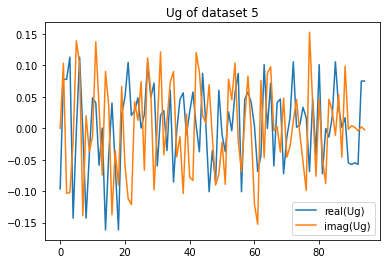

In [4]:
# load the structure vector Ug:
name = "ZnO_001_Th500A_T30mrad_r8_maxg_0_5_100kV"
File = "ZnO_001_Th500A_T30mrad_r8_maxg_0_5_100kV"
Nx = 70
thickness = 0.5
save_name = "ZnO_01"

Ug_origin = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/My_labels_" + name + ".csv", dtype=complex) 

dataset = 5
print(Ug_origin[dataset,4],' real:',np.real(Ug_origin[dataset,4]),' imag:',np.imag(Ug_origin[dataset,4]))
re = np.real(Ug_origin[dataset,:])
im = np.imag(Ug_origin[dataset,:])

plt.plot(re,label='real(Ug)')
plt.plot(im,label='imag(Ug)')
plt.legend()
plt.title('Ug of dataset '+str(dataset))
np.imag(Ug_origin[dataset,:])-np.imag(Ug_origin[dataset+1,:])
print(dataset)

thickness of dataset 5: 851.0


Text(0.5, 1.0, 'thickness')

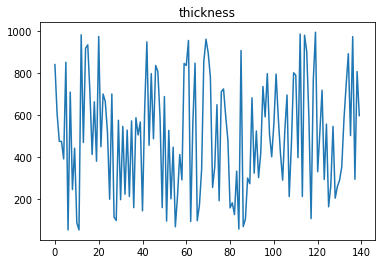

In [5]:
# load the thickness t:
t = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/My_thickness_" + name + ".csv", dtype=float) 
print('thickness of dataset '+str(dataset)+':', t[dataset])
plt.plot(t)
plt.title('thickness')

shape of the diffraction pattern:  (4900,)
X.max()=  0.9869074806573929


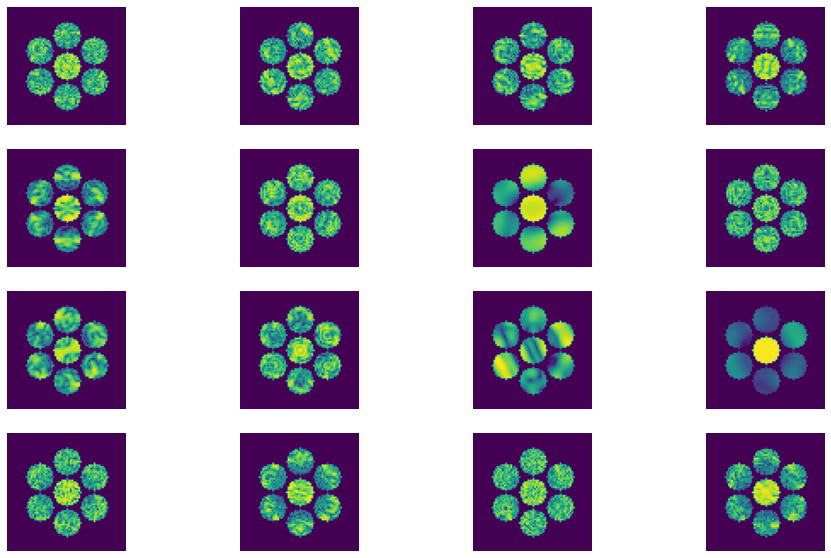

In [6]:
# load the diffraction Pattern X:
X = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/random_diffs_" + name + ".csv", dtype=float) 
print('shape of the diffraction pattern: ', X[dataset].shape)

# reshape the Pixels Array(for that they were saved as flatten array):
X = X.reshape(len(X),Nx,Nx,1)

def nlogf(x):
    return np.log(1+1000*x)
nlog = np.vectorize(nlogf)

nlogf_X = nlogf(X)

# plot first few Diffraction Pattern:
Ncol = 4
Nrow = 4
fig,ax=plt.subplots(Nrow,Ncol,figsize=(16,10))
for j in range(Ncol*Nrow):
    plt.subplot(Nrow,Ncol,j+1)
    plt.imshow(nlogf_X[j])
    plt.axis('off')
    
print("X.max()= ", X.max())

2. Data processing:

In [7]:
makeUniqueUgVector = True
beam1, beam2, beam3 = 4, 10, 50

In [8]:
if makeUniqueUgVector == True:
    Ug_unique = []
    for i in range(len(Ug_origin)):
        print('>>> processing the {}. Ug set...'.format(i))
        UgUnique, r0 = mu_3D.makeUniqueUgVector(Ug_origin[i],beam1=beam1,beam2=beam2,beam3=beam3,phase1=0,phase2=0,phase3=0,file=File)
        Ug_unique = np.append(Ug_unique, UgUnique)
        
    Ug_unique = Ug_unique.reshape(Ug_origin.shape)

>>> processing the 0. Ug set...
Applied shift of unit cell origin (fractional coordinates): 0.15452828975138924 -0.04348306188097729 0.16877699227936477
Ug[ 0 ]: 0.07172 0.0  =>  0.07172 0.0
Ug[ 1 ]: 0.10448 1.15433  =>  0.10448 2.21479
Ug[ 2 ]: 0.10448 -1.15433  =>  0.10448 -2.21479
Ug[ 3 ]: 0.10494 -2.85299  =>  0.10494 -3.1262
Ug[ 4 ]: 0.13733 -0.78724  =>  0.13733 0.0
Ug[ 5 ]: 0.16189 -1.60275  =>  0.16189 -2.93642
Ug[ 6 ]: 0.10494 2.85299  =>  0.10494 3.1262
Ug[ 7 ]: 0.16189 1.60275  =>  0.16189 2.93642
Ug[ 8 ]: 0.13733 0.78724  =>  0.13733 0.0
Ug[ 9 ]: 0.0571 1.29073  =>  0.0571 2.26166
Ug[ 10 ]: 0.04109 -2.03139  =>  0.04109 0.0
Ug[ 11 ]: 0.05073 -0.95065  =>  0.05073 -1.04018
Ug[ 12 ]: 0.13426 -1.59188  =>  0.13426 -0.34774
Ug[ 13 ]: 0.1309 0.3932  =>  0.1309 2.6978
Ug[ 14 ]: 0.13873 1.17691  =>  0.13873 1.3606
Ug[ 15 ]: 0.0571 -1.29073  =>  0.0571 -2.26166
Ug[ 16 ]: 0.05073 0.95065  =>  0.05073 1.04018
Ug[ 17 ]: 0.13426 1.59188  =>  0.13426 0.34774
Ug[ 18 ]: 0.13873 -1.17691  

Ug[ 81 ]: 0.06493 -0.60787  =>  0.06493 -2.87547
Ug[ 82 ]: 0.17175 0.73742  =>  0.17175 -1.08213
Ug[ 83 ]: 0.09596 1.80277  =>  0.09596 1.09534
Ug[ 84 ]: 0.06233 -1.43642  =>  0.06233 -3.03195
Ug[ 85 ]: 0.06236 2.30328  =>  0.06236 -0.62839
Ug[ 86 ]: 0.08707 2.92425  =>  0.08707 -0.23145
Ug[ 87 ]: 0.12103 -2.38089  =>  0.12103 1.19464
Ug[ 88 ]: 0.01998 1.58068  =>  0.01998 -0.90294
Ug[ 89 ]: 0.1111 -1.90702  =>  0.1111 0.58461
Ug[ 90 ]: 0.02923 -1.32716  =>  0.02923 2.05257
Ug[ 91 ]: 0.1111 1.90702  =>  0.1111 -0.58461
Ug[ 92 ]: 0.02923 1.32716  =>  0.02923 -2.05257
Ug[ 93 ]: 0.10165 -3.02472  =>  0.10165 -1.42119
Ug[ 94 ]: 0.10165 3.02472  =>  0.10165 1.42119
>>> processing the 2. Ug set...
Applied shift of unit cell origin (fractional coordinates): 0.5438411582448843 -0.12166914792658401 -0.3590557299097776
Ug[ 0 ]: 0.02349 3.14159  =>  0.02349 3.14159
Ug[ 1 ]: 0.11061 2.27745  =>  0.11061 0.02144
Ug[ 2 ]: 0.11061 -2.27745  =>  0.11061 -0.02144
Ug[ 3 ]: 0.02167 2.34653  =>  0.02167 1

Ug[ 44 ]: 0.08841 -2.37515  =>  0.08841 1.34629
Ug[ 45 ]: 0.01723 2.36898  =>  0.01723 -0.46732
Ug[ 46 ]: 0.01436 0.73153  =>  0.01436 -2.21236
Ug[ 47 ]: 0.099 -2.35065  =>  0.099 2.61919
Ug[ 48 ]: 0.03346 2.2055  =>  0.03346 -1.04539
Ug[ 49 ]: 0.14871 -2.95042  =>  0.14871 -2.32622
Ug[ 50 ]: 0.05548 0.93121  =>  0.05548 0.0
Ug[ 51 ]: 0.04529 0.83343  =>  0.04529 -2.03533
Ug[ 52 ]: 0.05326 -0.50511  =>  0.05326 0.50123
Ug[ 53 ]: 0.06351 -1.18056  =>  0.06351 -2.21937
Ug[ 54 ]: 0.09375 1.28508  =>  0.09375 -1.69128
Ug[ 55 ]: 0.08841 2.37515  =>  0.08841 -1.34629
Ug[ 56 ]: 0.01436 -0.73153  =>  0.01436 2.21236
Ug[ 57 ]: 0.08186 -0.9329  =>  0.08186 -0.03416
Ug[ 58 ]: 0.10465 0.95634  =>  0.10465 2.05108
Ug[ 59 ]: 0.09293 1.10103  =>  0.09293 2.5779
Ug[ 60 ]: 0.13175 3.05324  =>  0.13175 -1.86067
Ug[ 61 ]: 0.09523 -2.72048  =>  0.09523 -2.17141
Ug[ 62 ]: 0.08941 2.29174  =>  0.08941 0.90326
Ug[ 63 ]: 0.15404 3.01994  =>  0.15404 2.91235
Ug[ 64 ]: 0.07355 -0.59444  =>  0.07355 -2.63959
Ug[

Ug[ 35 ]: 0.04356 -2.09324  =>  0.04356 1.61357
Ug[ 36 ]: 0.06541 2.81785  =>  0.06541 2.28892
Ug[ 37 ]: 0.11933 2.36324  =>  0.11933 -1.8204
Ug[ 38 ]: 0.07395 -1.43637  =>  0.07395 1.68941
Ug[ 39 ]: 0.05085 -0.60707  =>  0.05085 -0.0
Ug[ 40 ]: 0.09476 1.57867  =>  0.09476 -1.46898
Ug[ 41 ]: 0.09027 0.05678  =>  0.09027 1.13511
Ug[ 42 ]: 0.11632 -0.20836  =>  0.11632 0.28894
Ug[ 43 ]: 0.06707 -2.60358  =>  0.06707 1.6582
Ug[ 44 ]: 0.05484 1.9495  =>  0.05484 0.97535
Ug[ 45 ]: 0.1179 2.22109  =>  0.1179 0.66591
Ug[ 46 ]: 0.00522 -1.54733  =>  0.00522 -1.96651
Ug[ 47 ]: 0.06821 -0.83774  =>  0.06821 -0.88983
Ug[ 48 ]: 0.04356 2.09324  =>  0.04356 -1.61357
Ug[ 49 ]: 0.05874 -0.56215  =>  0.05874 3.04047
Ug[ 50 ]: 0.05085 0.60707  =>  0.05085 0.0
Ug[ 51 ]: 0.06707 2.60358  =>  0.06707 -1.6582
Ug[ 52 ]: 0.09476 -1.57867  =>  0.09476 1.46898
Ug[ 53 ]: 0.06541 -2.81785  =>  0.06541 -2.28892
Ug[ 54 ]: 0.07395 1.43637  =>  0.07395 -1.68941
Ug[ 55 ]: 0.05484 -1.9495  =>  0.05484 -0.97535
Ug[ 56 

Applied shift of unit cell origin (fractional coordinates): -0.4314506308246689 0.03625863916745299 0.4083233117834211
Ug[ 0 ]: 0.09736 0.0  =>  0.09736 0.0
Ug[ 1 ]: 0.11643 1.61989  =>  0.11643 -2.09773
Ug[ 2 ]: 0.11643 -1.61989  =>  0.11643 2.09773
Ug[ 3 ]: 0.02114 0.65577  =>  0.02114 0.88359
Ug[ 4 ]: 0.01312 -2.79339  =>  0.01312 -0.0
Ug[ 5 ]: 0.10918 -0.41901  =>  0.10918 -2.75676
Ug[ 6 ]: 0.02114 -0.65577  =>  0.02114 -0.88359
Ug[ 7 ]: 0.10918 0.41901  =>  0.10918 2.75676
Ug[ 8 ]: 0.01312 2.79339  =>  0.01312 0.0
Ug[ 9 ]: 0.06087 3.12223  =>  0.06087 0.41134
Ug[ 10 ]: 0.12496 0.14531  =>  0.12496 0.0
Ug[ 11 ]: 0.02197 -2.24164  =>  0.02197 -1.23491
Ug[ 12 ]: 0.14448 -0.77395  =>  0.14448 2.57053
Ug[ 13 ]: 0.08087 2.77404  =>  0.08087 2.40091
Ug[ 14 ]: 0.07441 0.02993  =>  0.07441 0.80884
Ug[ 15 ]: 0.06087 -3.12223  =>  0.06087 -0.41134
Ug[ 16 ]: 0.02197 2.24164  =>  0.02197 1.23491
Ug[ 17 ]: 0.14448 0.77395  =>  0.14448 -2.57053
Ug[ 18 ]: 0.07441 -0.02993  =>  0.07441 -0.80884
Ug

Ug[ 91 ]: 0.13274 -0.19734  =>  0.13274 2.07648
Ug[ 92 ]: 0.0581 -0.05131  =>  0.0581 -3.04799
Ug[ 93 ]: 0.12765 0.26324  =>  0.12765 -0.9979
Ug[ 94 ]: 0.12765 -0.26324  =>  0.12765 0.9979
>>> processing the 13. Ug set...
Applied shift of unit cell origin (fractional coordinates): 0.5818907578630746 -0.14890589729844064 -0.14181426687867718
Ug[ 0 ]: 0.18352 0.0  =>  0.18352 0.0
Ug[ 1 ]: 0.09016 0.51135  =>  0.09016 -0.37969
Ug[ 2 ]: 0.09016 -0.51135  =>  0.09016 0.37969
Ug[ 3 ]: 0.02867 -0.65932  =>  0.02867 -1.59493
Ug[ 4 ]: 0.09439 1.82665  =>  0.09439 0.0
Ug[ 5 ]: 0.097 -0.78194  =>  0.097 -0.8265
Ug[ 6 ]: 0.02867 0.65932  =>  0.02867 1.59493
Ug[ 7 ]: 0.097 0.78194  =>  0.097 0.8265
Ug[ 8 ]: 0.09439 -1.82665  =>  0.09439 0.0
Ug[ 9 ]: 0.11124 -2.13949  =>  0.11124 1.51663
Ug[ 10 ]: 0.05287 -2.76508  =>  0.05287 0.0
Ug[ 11 ]: 0.15915 0.05195  =>  0.15915 -1.68406
Ug[ 12 ]: 0.06602 -2.30205  =>  0.06602 2.28969
Ug[ 13 ]: 0.1327 -1.9261  =>  0.1327 1.77458
Ug[ 14 ]: 0.04096 0.27656  => 

Applied shift of unit cell origin (fractional coordinates): 0.5542918153464701 -0.29187255679093194 -0.16396021834730704
Ug[ 0 ]: 0.04806 0.0  =>  0.04806 0.0
Ug[ 1 ]: 0.12973 -2.43594  =>  0.12973 2.81705
Ug[ 2 ]: 0.12973 2.43594  =>  0.12973 -2.81705
Ug[ 3 ]: 0.10936 2.41203  =>  0.10936 0.57814
Ug[ 4 ]: 0.07663 2.86408  =>  0.07663 -0.0
Ug[ 5 ]: 0.01042 -0.61726  =>  0.01042 -1.42096
Ug[ 6 ]: 0.10936 -2.41203  =>  0.10936 -0.57814
Ug[ 7 ]: 0.01042 0.61726  =>  0.01042 1.42096
Ug[ 8 ]: 0.07663 -2.86408  =>  0.07663 0.0
Ug[ 9 ]: 0.0993 2.40006  =>  0.0993 -0.40041
Ug[ 10 ]: 0.07302 -2.45253  =>  0.07302 0.0
Ug[ 11 ]: 0.06737 0.54153  =>  0.06737 -1.22874
Ug[ 12 ]: 0.17971 -0.36161  =>  0.17971 -1.32819
Ug[ 13 ]: 0.05603 -1.3427  =>  0.05603 2.94372
Ug[ 14 ]: 0.15588 -1.59305  =>  0.15588 -1.52943
Ug[ 15 ]: 0.0993 -2.40006  =>  0.0993 0.40041
Ug[ 16 ]: 0.06737 -0.54153  =>  0.06737 1.22874
Ug[ 17 ]: 0.17971 0.36161  =>  0.17971 1.32819
Ug[ 18 ]: 0.15588 1.59305  =>  0.15588 1.52943
Ug[

Ug[ 80 ]: 0.15658 -2.93387  =>  0.15658 1.20751
Ug[ 81 ]: 0.05823 -2.9587  =>  0.05823 -2.80246
Ug[ 82 ]: 0.03877 2.94546  =>  0.03877 -1.49438
Ug[ 83 ]: 0.0743 2.44387  =>  0.0743 2.80716
Ug[ 84 ]: 0.10459 3.02307  =>  0.10459 2.56838
Ug[ 85 ]: 0.06653 0.42413  =>  0.06653 -2.53567
Ug[ 86 ]: 0.09278 -1.95036  =>  0.09278 -2.61212
Ug[ 87 ]: 0.11043 -1.20069  =>  0.11043 -0.17534
Ug[ 88 ]: 0.02806 1.3533  =>  0.02806 0.08061
Ug[ 89 ]: 0.17384 0.62236  =>  0.17384 -1.83191
Ug[ 90 ]: 0.09181 1.26672  =>  0.09181 -0.36956
Ug[ 91 ]: 0.17384 -0.62236  =>  0.17384 1.83191
Ug[ 92 ]: 0.09181 -1.26672  =>  0.09181 0.36956
Ug[ 93 ]: 0.01887 0.84354  =>  0.01887 -2.42872
Ug[ 94 ]: 0.01887 -0.84354  =>  0.01887 2.42872
>>> processing the 19. Ug set...
Applied shift of unit cell origin (fractional coordinates): 0.13287699590757657 0.29043214624483116 -0.4502581528770168
Ug[ 0 ]: 0.16705 0.0  =>  0.16705 0.0
Ug[ 1 ]: 0.12113 0.77455  =>  0.12113 -2.05451
Ug[ 2 ]: 0.12113 -0.77455  =>  0.12113 2.05451

Ug[ 9 ]: 0.21345 2.34982  =>  0.21345 0.36565
Ug[ 10 ]: 0.18704 -0.28292  =>  0.18704 0.0
Ug[ 11 ]: 0.10419 -1.86586  =>  0.10419 0.16607
Ug[ 12 ]: 0.11672 0.387  =>  0.11672 -1.32022
Ug[ 13 ]: 0.10963 1.74748  =>  0.10963 2.30736
Ug[ 14 ]: 0.12965 0.92844  =>  0.12965 -3.04586
Ug[ 15 ]: 0.21345 -2.34982  =>  0.21345 -0.36565
Ug[ 16 ]: 0.10419 1.86586  =>  0.10419 -0.16607
Ug[ 17 ]: 0.11672 -0.387  =>  0.11672 1.32022
Ug[ 18 ]: 0.12965 -0.92844  =>  0.12965 3.04586
Ug[ 19 ]: 0.10974 -1.65746  =>  0.10974 0.09154
Ug[ 20 ]: 0.06401 0.00265  =>  0.06401 1.4747
Ug[ 21 ]: 0.15233 0.38047  =>  0.15233 2.40643
Ug[ 22 ]: 0.071 -0.90905  =>  0.071 -1.14421
Ug[ 23 ]: 0.01814 -0.49555  =>  0.01814 -0.45376
Ug[ 24 ]: 0.18704 0.28292  =>  0.18704 -0.0
Ug[ 25 ]: 0.10963 -1.74748  =>  0.10963 -2.30736
Ug[ 26 ]: 0.10974 1.65746  =>  0.10974 -0.09154
Ug[ 27 ]: 0.15233 -0.38047  =>  0.15233 -2.40643
Ug[ 28 ]: 0.06401 -0.00265  =>  0.06401 -1.4747
Ug[ 29 ]: 0.08917 2.85934  =>  0.08917 -0.87383
Ug[ 30 ]:

Applied shift of unit cell origin (fractional coordinates): -0.10871093469101283 -0.0667209730563908 0.1576541232983179
Ug[ 0 ]: 0.061 0.0  =>  0.061 0.0
Ug[ 1 ]: 0.02944 1.67246  =>  0.02944 2.66303
Ug[ 2 ]: 0.02944 -1.67246  =>  0.02944 -2.66303
Ug[ 3 ]: 0.15137 -0.77053  =>  0.15137 -1.18975
Ug[ 4 ]: 0.02081 -0.57135  =>  0.02081 0.0
Ug[ 5 ]: 0.10847 2.51359  =>  0.10847 1.1038
Ug[ 6 ]: 0.15137 0.77053  =>  0.15137 1.18975
Ug[ 7 ]: 0.10847 -2.51359  =>  0.10847 -1.1038
Ug[ 8 ]: 0.02081 0.57135  =>  0.02081 -0.0
Ug[ 9 ]: 0.07622 -0.30741  =>  0.07622 -0.99046
Ug[ 10 ]: 0.02804 -0.30752  =>  0.02804 0.0
Ug[ 11 ]: 0.06165 0.74321  =>  0.06165 -0.93041
Ug[ 12 ]: 0.10361 1.37838  =>  0.10361 1.11455
Ug[ 13 ]: 0.10742 -0.27745  =>  0.10742 0.44928
Ug[ 14 ]: 0.11385 -2.53517  =>  0.11385 2.49362
Ug[ 15 ]: 0.07622 0.30741  =>  0.07622 0.99046
Ug[ 16 ]: 0.06165 -0.74321  =>  0.06165 0.93041
Ug[ 17 ]: 0.10361 -1.37838  =>  0.10361 -1.11455
Ug[ 18 ]: 0.11385 2.53517  =>  0.11385 -2.49362
Ug[ 1

Ug[ 94 ]: 0.10115 2.70199  =>  0.10115 1.50903
>>> processing the 28. Ug set...
Applied shift of unit cell origin (fractional coordinates): -0.06419322823807239 -0.005221389570294561 -0.11368213333016049
Ug[ 0 ]: 0.14765 3.14159  =>  0.14765 3.14159
Ug[ 1 ]: 0.07239 2.33714  =>  0.07239 1.62286
Ug[ 2 ]: 0.07239 -2.33714  =>  0.07239 -1.62286
Ug[ 3 ]: 0.11725 -2.94385  =>  0.11725 -2.97666
Ug[ 4 ]: 0.0551 0.74709  =>  0.0551 -0.0
Ug[ 5 ]: 0.1297 -1.9303  =>  0.1297 -1.24882
Ug[ 6 ]: 0.11725 2.94385  =>  0.11725 2.97666
Ug[ 7 ]: 0.1297 1.9303  =>  0.1297 1.24882
Ug[ 8 ]: 0.0551 -0.74709  =>  0.0551 0.0
Ug[ 9 ]: 0.10487 1.58959  =>  0.10487 1.18625
Ug[ 10 ]: 0.10467 1.11762  =>  0.10467 0.0
Ug[ 11 ]: 0.01736 -2.3079  =>  0.01736 -1.99695
Ug[ 12 ]: 0.06733 0.38443  =>  0.06733 0.0139
Ug[ 13 ]: 0.07592 1.0556  =>  0.07592 -0.02922
Ug[ 14 ]: 0.07974 0.05061  =>  0.07974 0.39437
Ug[ 15 ]: 0.10487 -1.58959  =>  0.10487 -1.18625
Ug[ 16 ]: 0.01736 2.3079  =>  0.01736 1.99695
Ug[ 17 ]: 0.06733 -0

Applied shift of unit cell origin (fractional coordinates): 0.023007003602524483 0.012021804077687633 0.1310968213151114
Ug[ 0 ]: 0.16271 3.14159  =>  0.16271 3.14159
Ug[ 1 ]: 0.05992 2.53971  =>  0.05992 -2.91976
Ug[ 2 ]: 0.05992 -2.53971  =>  0.05992 2.91976
Ug[ 3 ]: 0.05685 -0.76983  =>  0.05685 -0.69429
Ug[ 4 ]: 0.18353 -0.89924  =>  0.18353 -0.0
Ug[ 5 ]: 0.05622 2.63383  =>  0.05622 1.88566
Ug[ 6 ]: 0.05685 0.76983  =>  0.05685 0.69429
Ug[ 7 ]: 0.05622 -2.63383  =>  0.05622 -1.88566
Ug[ 8 ]: 0.18353 0.89924  =>  0.18353 0.0
Ug[ 9 ]: 0.08013 0.36303  =>  0.08013 0.50758
Ug[ 10 ]: 0.15325 -0.96826  =>  0.15325 -0.0
Ug[ 11 ]: 0.18912 0.62112  =>  0.18912 -0.05803
Ug[ 12 ]: 0.11449 1.78163  =>  0.11449 1.85066
Ug[ 13 ]: 0.09408 0.04496  =>  0.09408 0.93769
Ug[ 14 ]: 0.11176 -1.71017  =>  0.11176 -2.46485
Ug[ 15 ]: 0.08013 -0.36303  =>  0.08013 -0.50758
Ug[ 16 ]: 0.18912 -0.62112  =>  0.18912 0.05803
Ug[ 17 ]: 0.11449 -1.78163  =>  0.11449 -1.85066
Ug[ 18 ]: 0.11176 1.71017  =>  0.1117

Ug[ 82 ]: 0.1091 -0.70625  =>  0.1091 -0.0948
Ug[ 83 ]: 0.07785 2.28473  =>  0.07785 0.30242
Ug[ 84 ]: 0.1228 -1.84581  =>  0.1228 -3.09954
Ug[ 85 ]: 0.06628 1.97448  =>  0.06628 -1.10349
Ug[ 86 ]: 0.1123 2.60717  =>  0.1123 1.39438
Ug[ 87 ]: 0.13061 -0.66163  =>  0.13061 0.67839
Ug[ 88 ]: 0.138 1.74937  =>  0.138 1.22421
Ug[ 89 ]: 0.045 2.23268  =>  0.045 2.30886
Ug[ 90 ]: 0.02088 1.03356  =>  0.02088 0.38117
Ug[ 91 ]: 0.045 -2.23268  =>  0.045 -2.30886
Ug[ 92 ]: 0.02088 -1.03356  =>  0.02088 -0.38117
Ug[ 93 ]: 0.04752 -2.16019  =>  0.04752 -1.35544
Ug[ 94 ]: 0.04752 2.16019  =>  0.04752 1.35544
>>> processing the 34. Ug set...
Applied shift of unit cell origin (fractional coordinates): 0.05331274344656662 -0.11703811535414103 -0.06816915291142124
Ug[ 0 ]: 0.13691 3.14159  =>  0.13691 3.14159
Ug[ 1 ]: 0.14199 -1.71038  =>  0.14199 -2.1387
Ug[ 2 ]: 0.14199 1.71038  =>  0.14199 2.1387
Ug[ 3 ]: 0.09757 -1.67285  =>  0.09757 -2.40823
Ug[ 4 ]: 0.16364 1.16369  =>  0.16364 0.0
Ug[ 5 ]: 0.13

Applied shift of unit cell origin (fractional coordinates): 0.02636710519118106 -0.3987468803909008 0.25380085061378077
Ug[ 0 ]: 0.07929 3.14159  =>  0.07929 3.14159
Ug[ 1 ]: 0.11306 0.06602  =>  0.11306 1.6607
Ug[ 2 ]: 0.11306 -0.06602  =>  0.11306 -1.6607
Ug[ 3 ]: 0.17568 1.1459  =>  0.17568 -1.3595
Ug[ 4 ]: 0.00454 0.91072  =>  0.00454 -0.0
Ug[ 5 ]: 0.09476 0.08922  =>  0.09476 2.27233
Ug[ 6 ]: 0.17568 -1.1459  =>  0.17568 1.3595
Ug[ 7 ]: 0.09476 -0.08922  =>  0.09476 -2.27233
Ug[ 8 ]: 0.00454 -0.91072  =>  0.00454 0.0
Ug[ 9 ]: 0.17453 1.33613  =>  0.17453 1.5018
Ug[ 10 ]: 0.11237 -1.76035  =>  0.11237 0.0
Ug[ 11 ]: 0.13982 0.57511  =>  0.13982 -0.85389
Ug[ 12 ]: 0.17986 -0.85175  =>  0.17986 1.81932
Ug[ 13 ]: 0.14745 3.02595  =>  0.14745 1.00851
Ug[ 14 ]: 0.16723 -0.1414  =>  0.16723 0.93499
Ug[ 15 ]: 0.17453 -1.33613  =>  0.17453 -1.5018
Ug[ 16 ]: 0.13982 -0.57511  =>  0.13982 0.85389
Ug[ 17 ]: 0.17986 0.85175  =>  0.17986 -1.81932
Ug[ 18 ]: 0.16723 0.1414  =>  0.16723 -0.93499
Ug

Ug[ 71 ]: 0.09496 2.70842  =>  0.09496 -1.24718
Ug[ 72 ]: 0.083 -1.3281  =>  0.083 0.64975
Ug[ 73 ]: 0.03547 -3.02161  =>  0.03547 -1.12862
Ug[ 74 ]: 0.05682 -3.02459  =>  0.05682 0.7562
Ug[ 75 ]: 0.07085 -0.02175  =>  0.07085 2.04096
Ug[ 76 ]: 0.04132 -2.62306  =>  0.04132 -0.81492
Ug[ 77 ]: 0.04186 -2.9557  =>  0.04186 0.31075
Ug[ 78 ]: 0.09383 -1.89307  =>  0.09383 1.28853
Ug[ 79 ]: 0.02643 0.37491  =>  0.02643 -2.55697
Ug[ 80 ]: 0.12976 0.1907  =>  0.12976 -2.3066
Ug[ 81 ]: 0.05368 1.57316  =>  0.05368 -1.00899
Ug[ 82 ]: 0.03172 0.81306  =>  0.03172 -1.59937
Ug[ 83 ]: 0.07031 -1.66769  =>  0.07031 1.76848
Ug[ 84 ]: 0.09496 -2.70842  =>  0.09496 1.24718
Ug[ 85 ]: 0.083 1.3281  =>  0.083 -0.64975
Ug[ 86 ]: 0.07085 0.02175  =>  0.07085 -2.04096
Ug[ 87 ]: 0.03547 3.02161  =>  0.03547 1.12862
Ug[ 88 ]: 0.04132 2.62306  =>  0.04132 0.81492
Ug[ 89 ]: 0.1028 2.74478  =>  0.1028 -0.8714
Ug[ 90 ]: 0.12881 0.85195  =>  0.12881 2.99952
Ug[ 91 ]: 0.1028 -2.74478  =>  0.1028 0.8714
Ug[ 92 ]: 0.1

>>> processing the 43. Ug set...
Applied shift of unit cell origin (fractional coordinates): 0.14653467463559372 -0.35679187267322376 0.297442541883857
Ug[ 0 ]: 0.00757 0.0  =>  0.00757 0.0
Ug[ 1 ]: 0.165 -0.05524  =>  0.165 1.81365
Ug[ 2 ]: 0.165 0.05524  =>  0.165 -1.81365
Ug[ 3 ]: 0.11085 0.12154  =>  0.11085 -2.12025
Ug[ 4 ]: 0.07904 0.3729  =>  0.07904 0.0
Ug[ 5 ]: 0.13588 -1.37611  =>  0.13588 0.7964
Ug[ 6 ]: 0.11085 -0.12154  =>  0.11085 2.12025
Ug[ 7 ]: 0.13588 1.37611  =>  0.13588 -0.7964
Ug[ 8 ]: 0.07904 -0.3729  =>  0.07904 -0.0
Ug[ 9 ]: 0.10873 -1.57704  =>  0.10873 -0.65633
Ug[ 10 ]: 0.04365 -2.78959  =>  0.04365 -0.0
Ug[ 11 ]: 0.05222 -1.48843  =>  0.05222 -2.43661
Ug[ 12 ]: 0.14466 -2.67621  =>  0.14466 0.48628
Ug[ 13 ]: 0.08522 -2.33605  =>  0.08522 2.69534
Ug[ 14 ]: 0.08523 -3.01115  =>  0.08523 -1.71754
Ug[ 15 ]: 0.10873 1.57704  =>  0.10873 0.65633
Ug[ 16 ]: 0.05222 1.48843  =>  0.05222 2.43661
Ug[ 17 ]: 0.14466 2.67621  =>  0.14466 -0.48628
Ug[ 18 ]: 0.08523 3.01115

Ug[ 46 ]: 0.05414 -1.82484  =>  0.05414 -1.03708
Ug[ 47 ]: 0.13455 -2.19866  =>  0.13455 3.10668
Ug[ 48 ]: 0.03738 -2.69453  =>  0.03738 2.9117
Ug[ 49 ]: 0.06281 -1.90004  =>  0.06281 3.10441
Ug[ 50 ]: 0.02308 0.18597  =>  0.02308 0.0
Ug[ 51 ]: 0.17162 -0.86909  =>  0.17162 -0.75417
Ug[ 52 ]: 0.05206 0.08632  =>  0.05206 -0.40055
Ug[ 53 ]: 0.05637 -1.44179  =>  0.05637 -2.72259
Ug[ 54 ]: 0.11083 1.36327  =>  0.11083 0.38337
Ug[ 55 ]: 0.11504 1.65775  =>  0.11504 0.07812
Ug[ 56 ]: 0.05414 1.82484  =>  0.05414 1.03708
Ug[ 57 ]: 0.01452 -2.83973  =>  0.01452 1.86177
Ug[ 58 ]: 0.04007 1.20487  =>  0.04007 0.82881
Ug[ 59 ]: 0.08395 -0.65751  =>  0.08395 -0.24169
Ug[ 60 ]: 0.11903 0.28602  =>  0.11903 -0.39299
Ug[ 61 ]: 0.15492 0.5483  =>  0.15492 -0.0576
Ug[ 62 ]: 0.13932 1.58387  =>  0.13932 1.27886
Ug[ 63 ]: 0.09635 -2.5751  =>  0.09635 2.61326
Ug[ 64 ]: 0.06759 -1.49085  =>  0.06759 -2.28479
Ug[ 65 ]: 0.19608 2.29074  =>  0.19608 1.386
Ug[ 66 ]: 0.01902 -0.16595  =>  0.01902 -1.55961
Ug[

Ug[ 53 ]: 0.10864 -0.35544  =>  0.10864 0.18887
Ug[ 54 ]: 0.08212 1.48357  =>  0.08212 -0.77395
Ug[ 55 ]: 0.16488 0.89648  =>  0.16488 1.30249
Ug[ 56 ]: 0.05098 2.50678  =>  0.05098 2.91125
Ug[ 57 ]: 0.09777 2.45114  =>  0.09777 -0.48591
Ug[ 58 ]: 0.13057 2.14865  =>  0.13057 -2.36945
Ug[ 59 ]: 0.05155 2.28006  =>  0.05155 -2.23959
Ug[ 60 ]: 0.02577 0.48464  =>  0.02577 1.70848
Ug[ 61 ]: 0.08323 -0.75115  =>  0.08323 -1.83362
Ug[ 62 ]: 0.05355 -2.84974  =>  0.05355 -0.45086
Ug[ 63 ]: 0.05329 -2.24718  =>  0.05329 -2.78688
Ug[ 64 ]: 0.01585 0.83702  =>  0.01585 -2.5045
Ug[ 65 ]: 0.11168 -2.60918  =>  0.11168 2.45324
Ug[ 66 ]: 0.15566 0.45117  =>  0.15566 -0.22682
Ug[ 67 ]: 0.05155 -2.28006  =>  0.05155 2.23959
Ug[ 68 ]: 0.01489 -2.71865  =>  0.01489 -0.9993
Ug[ 69 ]: 0.15639 2.25774  =>  0.15639 -1.76331
Ug[ 70 ]: 0.05449 -0.31764  =>  0.05449 -0.72058
Ug[ 71 ]: 0.06005 2.77025  =>  0.06005 2.91009
Ug[ 72 ]: 0.06559 -1.37435  =>  0.06559 -1.37128
Ug[ 73 ]: 0.0661 -0.27268  =>  0.0661 -3

Ug[ 45 ]: 0.06176 1.19298  =>  0.06176 -0.51234
Ug[ 46 ]: 0.07043 -1.43067  =>  0.07043 -1.76133
Ug[ 47 ]: 0.07104 0.35462  =>  0.07104 -1.64795
Ug[ 48 ]: 0.02 2.0722  =>  0.02 -1.97571
Ug[ 49 ]: 0.14038 2.0308  =>  0.14038 2.07359
Ug[ 50 ]: 0.11352 -2.52314  =>  0.11352 -0.0
Ug[ 51 ]: 0.12026 1.81204  =>  0.12026 2.28983
Ug[ 52 ]: 0.08872 1.06075  =>  0.08872 -0.65394
Ug[ 53 ]: 0.09973 -0.50735  =>  0.09973 -2.89274
Ug[ 54 ]: 0.07938 0.93429  =>  0.07938 2.78673
Ug[ 55 ]: 0.10934 2.53994  =>  0.10934 -1.6551
Ug[ 56 ]: 0.07043 1.43067  =>  0.07043 1.76133
Ug[ 57 ]: 0.08093 -0.85352  =>  0.08093 -1.19355
Ug[ 58 ]: 0.04563 -2.55175  =>  0.04563 -2.36184
Ug[ 59 ]: 0.02434 -3.00929  =>  0.02434 1.70633
Ug[ 60 ]: 0.09777 -1.05547  =>  0.09777 -1.24838
Ug[ 61 ]: 0.13309 2.56325  =>  0.13309 1.7976
Ug[ 62 ]: 0.11003 -1.40325  =>  0.11003 2.06893
Ug[ 63 ]: 0.14701 1.96959  =>  0.14701 -2.93893
Ug[ 64 ]: 0.03252 -1.22451  =>  0.03252 -1.8952
Ug[ 65 ]: 0.08011 1.7007  =>  0.08011 -0.87461
Ug[ 66

Ug[ 51 ]: 0.09547 1.93199  =>  0.09547 -2.14935
Ug[ 52 ]: 0.03422 -2.91705  =>  0.03422 1.42377
Ug[ 53 ]: 0.07132 -1.65651  =>  0.07132 1.89885
Ug[ 54 ]: 0.16703 -1.02136  =>  0.16703 -1.67708
Ug[ 55 ]: 0.08464 2.95941  =>  0.08464 -2.91686
Ug[ 56 ]: 0.0789 -1.43004  =>  0.0789 0.83867
Ug[ 57 ]: 0.14112 -2.33791  =>  0.14112 -0.85466
Ug[ 58 ]: 0.09269 3.04884  =>  0.09269 -0.82219
Ug[ 59 ]: 0.03255 2.81226  =>  0.03255 0.80303
Ug[ 60 ]: 0.12711 1.45762  =>  0.12711 2.87401
Ug[ 61 ]: 0.00502 1.19964  =>  0.00502 -0.7919
Ug[ 62 ]: 0.11374 2.92299  =>  0.11374 3.00355
Ug[ 63 ]: 0.03169 -2.91208  =>  0.03169 0.51353
Ug[ 64 ]: 0.09271 0.07618  =>  0.09271 -0.70928
Ug[ 65 ]: 0.10622 -2.46438  =>  0.10622 -1.32119
Ug[ 66 ]: 0.03342 -1.53274  =>  0.03342 -1.25557
Ug[ 67 ]: 0.03255 -2.81226  =>  0.03255 -0.80303
Ug[ 68 ]: 0.10397 -1.56266  =>  0.10397 0.65688
Ug[ 69 ]: 0.12066 0.36527  =>  0.12066 1.71877
Ug[ 70 ]: 0.10612 2.041  =>  0.10612 -2.08951
Ug[ 71 ]: 0.02543 -2.67436  =>  0.02543 -1.3

Ug[ 5 ]: 0.02146 -2.50482  =>  0.02146 2.69718
Ug[ 6 ]: 0.02952 -3.01422  =>  0.02952 1.83935
Ug[ 7 ]: 0.02146 2.50482  =>  0.02146 -2.69718
Ug[ 8 ]: 0.11145 -2.34276  =>  0.11145 0.0
Ug[ 9 ]: 0.14978 -0.38153  =>  0.14978 0.25533
Ug[ 10 ]: 0.12251 3.13551  =>  0.12251 -0.0
Ug[ 11 ]: 0.17502 -1.99949  =>  0.17502 2.40975
Ug[ 12 ]: 0.08536 -3.04649  =>  0.08536 2.44394
Ug[ 13 ]: 0.12797 -1.9913  =>  0.12797 -0.27324
Ug[ 14 ]: 0.1477 -0.17673  =>  0.1477 2.8029
Ug[ 15 ]: 0.14978 0.38153  =>  0.14978 -0.25533
Ug[ 16 ]: 0.17502 1.99949  =>  0.17502 -2.40975
Ug[ 17 ]: 0.08536 3.04649  =>  0.08536 -2.44394
Ug[ 18 ]: 0.1477 0.17673  =>  0.1477 -2.8029
Ug[ 19 ]: 0.14404 3.08971  =>  0.14404 -1.9319
Ug[ 20 ]: 0.06237 3.10744  =>  0.06237 -0.48456
Ug[ 21 ]: 0.08324 -0.511  =>  0.08324 -0.67904
Ug[ 22 ]: 0.1178 1.61273  =>  0.1178 -2.77201
Ug[ 23 ]: 0.1019 -2.37009  =>  0.1019 -1.90127
Ug[ 24 ]: 0.12251 -3.13551  =>  0.12251 0.0
Ug[ 25 ]: 0.12797 1.9913  =>  0.12797 0.27324
Ug[ 26 ]: 0.14404 -3.0

Applied shift of unit cell origin (fractional coordinates): 0.5371856625872113 -0.08642385263817753 -0.0956550242919312
Ug[ 0 ]: 0.0542 0.0  =>  0.0542 0.0
Ug[ 1 ]: 0.20222 1.2112  =>  0.20222 0.61018
Ug[ 2 ]: 0.20222 -1.2112  =>  0.20222 -0.61018
Ug[ 3 ]: 0.13145 2.38572  =>  0.13145 1.84271
Ug[ 4 ]: 0.035 1.14404  =>  0.035 -0.0
Ug[ 5 ]: 0.18725 -2.28902  =>  0.18725 -2.23102
Ug[ 6 ]: 0.13145 -2.38572  =>  0.13145 -1.84271
Ug[ 7 ]: 0.18725 2.28902  =>  0.18725 2.23102
Ug[ 8 ]: 0.035 -1.14404  =>  0.035 0.0
Ug[ 9 ]: 0.0852 -1.19863  =>  0.0852 2.17661
Ug[ 10 ]: 0.15454 -2.77422  =>  0.15454 0.0
Ug[ 11 ]: 0.1736 -2.10808  =>  0.1736 1.86817
Ug[ 12 ]: 0.15718 -0.61147  =>  0.15718 -2.9764
Ug[ 13 ]: 0.11402 2.59704  =>  0.11402 -0.36891
Ug[ 14 ]: 0.06495 0.38709  =>  0.06495 -1.37682
Ug[ 15 ]: 0.0852 1.19863  =>  0.0852 -2.17661
Ug[ 16 ]: 0.1736 2.10808  =>  0.1736 -1.86817
Ug[ 17 ]: 0.15718 0.61147  =>  0.15718 2.9764
Ug[ 18 ]: 0.06495 -0.38709  =>  0.06495 1.37682
Ug[ 19 ]: 0.04529 -3.

Ug[ 67 ]: 0.09084 -2.06678  =>  0.09084 2.5002
Ug[ 68 ]: 0.07812 2.72898  =>  0.07812 -1.84383
Ug[ 69 ]: 0.12806 -2.42598  =>  0.12806 1.34211
Ug[ 70 ]: 0.0493 -0.55648  =>  0.0493 2.18128
Ug[ 71 ]: 0.06383 -0.09069  =>  0.06383 -1.57842
Ug[ 72 ]: 0.08931 2.69756  =>  0.08931 2.58262
Ug[ 73 ]: 0.13555 2.62162  =>  0.13555 2.84914
Ug[ 74 ]: 0.1145 0.6783  =>  0.1145 -1.14798
Ug[ 75 ]: 0.07467 -0.46951  =>  0.07467 -0.9269
Ug[ 76 ]: 0.13723 0.26506  =>  0.13723 0.83504
Ug[ 77 ]: 0.07564 -2.90261  =>  0.07564 1.32774
Ug[ 78 ]: 0.07812 -2.72898  =>  0.07812 1.84383
Ug[ 79 ]: 0.10623 -1.16378  =>  0.10623 2.72411
Ug[ 80 ]: 0.12629 -2.5576  =>  0.12629 -0.38496
Ug[ 81 ]: 0.12806 2.42598  =>  0.12806 -1.34211
Ug[ 82 ]: 0.08321 -1.64664  =>  0.08321 0.18354
Ug[ 83 ]: 0.0493 0.55648  =>  0.0493 -2.18128
Ug[ 84 ]: 0.06383 0.09069  =>  0.06383 1.57842
Ug[ 85 ]: 0.08931 -2.69756  =>  0.08931 -2.58262
Ug[ 86 ]: 0.07467 0.46951  =>  0.07467 0.9269
Ug[ 87 ]: 0.13555 -2.62162  =>  0.13555 -2.84914
Ug[

Ug[ 83 ]: 0.04013 -0.63379  =>  0.04013 -0.06633
Ug[ 84 ]: 0.10943 0.68093  =>  0.10943 1.97335
Ug[ 85 ]: 0.05445 2.12424  =>  0.05445 1.78679
Ug[ 86 ]: 0.07798 0.82274  =>  0.07798 -0.69212
Ug[ 87 ]: 0.01621 0.31177  =>  0.01621 1.15174
Ug[ 88 ]: 0.04205 0.04052  =>  0.04205 2.0579
Ug[ 89 ]: 0.06053 -1.87639  =>  0.06053 1.54084
Ug[ 90 ]: 0.04939 -1.44549  =>  0.04939 1.24678
Ug[ 91 ]: 0.06053 1.87639  =>  0.06053 -1.54084
Ug[ 92 ]: 0.04939 1.44549  =>  0.04939 -1.24678
Ug[ 93 ]: 0.17349 -2.15413  =>  0.17349 1.98806
Ug[ 94 ]: 0.17349 2.15413  =>  0.17349 -1.98806
>>> processing the 66. Ug set...
Applied shift of unit cell origin (fractional coordinates): 0.4029346054475805 -0.5346182088292416 0.044592882825736986
Ug[ 0 ]: 0.09904 0.0  =>  0.09904 0.0
Ug[ 1 ]: 0.11491 1.61363  =>  0.11491 1.89382
Ug[ 2 ]: 0.11491 -1.61363  =>  0.11491 -1.89382
Ug[ 3 ]: 0.10649 -2.95124  =>  0.10649 -0.02716
Ug[ 4 ]: 0.07736 3.07892  =>  0.07736 0.0
Ug[ 5 ]: 0.02566 -2.79739  =>  0.02566 -0.1535
Ug[ 6 

Ug[ 77 ]: 0.07642 -0.06977  =>  0.07642 1.54504
Ug[ 78 ]: 0.10575 1.6006  =>  0.10575 -1.016
Ug[ 79 ]: 0.02821 0.51917  =>  0.02821 0.08222
Ug[ 80 ]: 0.08222 0.60947  =>  0.08222 2.9301
Ug[ 81 ]: 0.0156 -0.32502  =>  0.0156 -2.23581
Ug[ 82 ]: 0.11949 -2.27758  =>  0.11949 -2.00871
Ug[ 83 ]: 0.174 -0.79094  =>  0.174 3.00353
Ug[ 84 ]: 0.0763 2.4835  =>  0.0763 0.7006
Ug[ 85 ]: 0.01209 1.22662  =>  0.01209 -2.03011
Ug[ 86 ]: 0.06265 2.59368  =>  0.06265 1.38871
Ug[ 87 ]: 0.06719 2.86234  =>  0.06719 -2.44616
Ug[ 88 ]: 0.15249 -2.65389  =>  0.15249 2.55222
Ug[ 89 ]: 0.09972 3.07198  =>  0.09972 2.931
Ug[ 90 ]: 0.06009 0.85404  =>  0.06009 0.00724
Ug[ 91 ]: 0.09972 -3.07198  =>  0.09972 -2.931
Ug[ 92 ]: 0.06009 -0.85404  =>  0.06009 -0.00724
Ug[ 93 ]: 0.1244 2.33407  =>  0.1244 2.89891
Ug[ 94 ]: 0.1244 -2.33407  =>  0.1244 -2.89891
>>> processing the 69. Ug set...
Applied shift of unit cell origin (fractional coordinates): -0.4833726029290828 0.051582175780025996 0.07923334120941501
Ug[ 0 

Ug[ 76 ]: 0.01841 -2.10569  =>  0.01841 1.18655
Ug[ 77 ]: 0.07748 -0.13563  =>  0.07748 -1.38022
Ug[ 78 ]: 0.0541 0.86878  =>  0.0541 -0.92787
Ug[ 79 ]: 0.17375 -2.38834  =>  0.17375 -3.08087
Ug[ 80 ]: 0.04552 -2.0009  =>  0.04552 -1.67978
Ug[ 81 ]: 0.04841 -2.42727  =>  0.04841 -2.65821
Ug[ 82 ]: 0.12485 -0.91015  =>  0.12485 -0.03697
Ug[ 83 ]: 0.07122 -1.47444  =>  0.07122 -1.61491
Ug[ 84 ]: 0.14492 -2.98052  =>  0.14492 -1.55528
Ug[ 85 ]: 0.06329 -0.46109  =>  0.06329 1.42574
Ug[ 86 ]: 0.11007 -0.93651  =>  0.11007 0.39826
Ug[ 87 ]: 0.15938 1.05323  =>  0.15938 -2.79107
Ug[ 88 ]: 0.01841 2.10569  =>  0.01841 -1.18655
Ug[ 89 ]: 0.00471 1.91162  =>  0.00471 2.69462
Ug[ 90 ]: 0.07077 -1.79359  =>  0.07077 -2.57631
Ug[ 91 ]: 0.00471 -1.91162  =>  0.00471 -2.69462
Ug[ 92 ]: 0.07077 1.79359  =>  0.07077 2.57631
Ug[ 93 ]: 0.04253 0.5863  =>  0.04253 2.93501
Ug[ 94 ]: 0.04253 -0.5863  =>  0.04253 -2.93501
>>> processing the 72. Ug set...
Applied shift of unit cell origin (fractional coordin

>>> processing the 75. Ug set...
Applied shift of unit cell origin (fractional coordinates): -0.15536881914622463 0.16102607979415404 0.15620633549134805
Ug[ 0 ]: 0.19595 0.0  =>  0.19595 0.0
Ug[ 1 ]: 0.12847 2.40179  =>  0.12847 -2.89992
Ug[ 2 ]: 0.12847 -2.40179  =>  0.12847 2.89992
Ug[ 3 ]: 0.068 0.75239  =>  0.068 1.76414
Ug[ 4 ]: 0.12008 -1.99323  =>  0.12008 -0.0
Ug[ 5 ]: 0.04394 0.85531  =>  0.04394 0.8856
Ug[ 6 ]: 0.068 -0.75239  =>  0.068 -1.76414
Ug[ 7 ]: 0.04394 -0.85531  =>  0.04394 -0.8856
Ug[ 8 ]: 0.12008 1.99323  =>  0.12008 0.0
Ug[ 9 ]: 0.07773 3.12198  =>  0.07773 2.14577
Ug[ 10 ]: 0.15774 -0.00526  =>  0.15774 0.0
Ug[ 11 ]: 0.15906 2.74412  =>  0.15906 0.78643
Ug[ 12 ]: 0.04713 -2.97282  =>  0.04713 1.32239
Ug[ 13 ]: 0.03294 -2.46475  =>  0.03294 2.81194
Ug[ 14 ]: 0.06226 2.98264  =>  0.06226 0.0132
Ug[ 15 ]: 0.07773 -3.12198  =>  0.07773 -2.14577
Ug[ 16 ]: 0.15906 -2.74412  =>  0.15906 -0.78643
Ug[ 17 ]: 0.04713 2.97282  =>  0.04713 -1.32239
Ug[ 18 ]: 0.06226 -2.9826

Ug[ 72 ]: 0.08942 -2.75402  =>  0.08942 0.30012
Ug[ 73 ]: 0.00989 -0.26293  =>  0.00989 0.06772
Ug[ 74 ]: 0.04393 0.54644  =>  0.04393 -3.13646
Ug[ 75 ]: 0.07046 -2.32748  =>  0.07046 -2.83305
Ug[ 76 ]: 0.02288 0.5686  =>  0.02288 -1.82423
Ug[ 77 ]: 0.03104 -0.74917  =>  0.03104 0.01557
Ug[ 78 ]: 0.03861 1.95311  =>  0.03861 -0.00563
Ug[ 79 ]: 0.01384 3.13258  =>  0.01384 0.33762
Ug[ 80 ]: 0.1092 2.74262  =>  0.1092 1.59792
Ug[ 81 ]: 0.09383 -2.58491  =>  0.09383 -0.1699
Ug[ 82 ]: 0.07544 2.94798  =>  0.07544 -1.75641
Ug[ 83 ]: 0.06589 -2.81762  =>  0.06589 -2.88909
Ug[ 84 ]: 0.04087 -0.14581  =>  0.04087 -2.12672
Ug[ 85 ]: 0.08942 2.75402  =>  0.08942 -0.30012
Ug[ 86 ]: 0.07046 2.32748  =>  0.07046 2.83305
Ug[ 87 ]: 0.00989 0.26293  =>  0.00989 -0.06772
Ug[ 88 ]: 0.02288 -0.5686  =>  0.02288 1.82423
Ug[ 89 ]: 0.13986 0.80048  =>  0.13986 1.10897
Ug[ 90 ]: 0.12879 -1.75807  =>  0.12879 0.45985
Ug[ 91 ]: 0.13986 -0.80048  =>  0.13986 -1.10897
Ug[ 92 ]: 0.12879 1.75807  =>  0.12879 -0.45

Ug[ 86 ]: 0.03112 3.00938  =>  0.03112 2.97418
Ug[ 87 ]: 0.06193 0.21894  =>  0.06193 -1.72021
Ug[ 88 ]: 0.12245 -2.59134  =>  0.12245 0.80072
Ug[ 89 ]: 0.12791 -0.40858  =>  0.12791 -2.93791
Ug[ 90 ]: 0.05249 1.62791  =>  0.05249 0.71114
Ug[ 91 ]: 0.12791 0.40858  =>  0.12791 2.93791
Ug[ 92 ]: 0.05249 -1.62791  =>  0.05249 -0.71114
Ug[ 93 ]: 0.05286 -2.23346  =>  0.05286 -0.09217
Ug[ 94 ]: 0.05286 2.23346  =>  0.05286 0.09217
>>> processing the 81. Ug set...
Applied shift of unit cell origin (fractional coordinates): -0.3118431088575731 -0.13510165533972437 0.010818292308425402
Ug[ 0 ]: 0.01404 3.14159  =>  0.01404 3.14159
Ug[ 1 ]: 0.09717 0.23095  =>  0.09717 0.29892
Ug[ 2 ]: 0.09717 -0.23095  =>  0.09717 -0.29892
Ug[ 3 ]: 0.10038 1.45858  =>  0.10038 0.60971
Ug[ 4 ]: 0.07924 0.7809  =>  0.07924 0.0
Ug[ 5 ]: 0.06207 0.37469  =>  0.06207 -0.54215
Ug[ 6 ]: 0.10038 -1.45858  =>  0.10038 -0.60971
Ug[ 7 ]: 0.06207 -0.37469  =>  0.06207 0.54215
Ug[ 8 ]: 0.07924 -0.7809  =>  0.07924 0.0
Ug[

Ug[ 58 ]: 0.04611 -2.62944  =>  0.04611 -1.96713
Ug[ 59 ]: 0.05738 -0.2677  =>  0.05738 -2.06585
Ug[ 60 ]: 0.09051 1.11227  =>  0.09051 -0.32086
Ug[ 61 ]: 0.14325 -1.69542  =>  0.14325 0.39691
Ug[ 62 ]: 0.09609 -2.62519  =>  0.09609 -1.61601
Ug[ 63 ]: 0.17359 -0.79465  =>  0.17359 -0.42962
Ug[ 64 ]: 0.13399 1.23317  =>  0.13399 0.51506
Ug[ 65 ]: 0.06873 -2.96421  =>  0.06873 -2.89336
Ug[ 66 ]: 0.06261 -0.21714  =>  0.06261 -1.87359
Ug[ 67 ]: 0.05738 0.2677  =>  0.05738 2.06585
Ug[ 68 ]: 0.06883 1.68112  =>  0.06883 -1.42661
Ug[ 69 ]: 0.09518 -0.0705  =>  0.09518 1.37766
Ug[ 70 ]: 0.05684 1.42959  =>  0.05684 1.35563
Ug[ 71 ]: 0.11771 0.06461  =>  0.11771 -1.73665
Ug[ 72 ]: 0.05533 3.11023  =>  0.05533 1.74795
Ug[ 73 ]: 0.08185 0.56134  =>  0.08185 -1.88408
Ug[ 74 ]: 0.08988 -0.79326  =>  0.08988 2.10618
Ug[ 75 ]: 0.15721 -1.4304  =>  0.15721 -1.70954
Ug[ 76 ]: 0.1456 2.39654  =>  0.1456 -1.13202
Ug[ 77 ]: 0.14325 1.69542  =>  0.14325 -0.39691
Ug[ 78 ]: 0.06883 -1.68112  =>  0.06883 1.4

Ug[ 35 ]: 0.01593 1.71849  =>  0.01593 0.5431
Ug[ 36 ]: 0.02593 -0.26213  =>  0.02593 -0.87296
Ug[ 37 ]: 0.11492 1.63486  =>  0.11492 3.01894
Ug[ 38 ]: 0.10653 -0.1558  =>  0.10653 -2.76153
Ug[ 39 ]: 0.05972 -1.84011  =>  0.05972 -0.0
Ug[ 40 ]: 0.09018 -1.53483  =>  0.09018 2.30019
Ug[ 41 ]: 0.03309 2.59322  =>  0.03309 -0.57708
Ug[ 42 ]: 0.09063 -2.85707  =>  0.09063 -1.17453
Ug[ 43 ]: 0.07865 0.9942  =>  0.07865 0.8394
Ug[ 44 ]: 0.12002 1.49716  =>  0.12002 0.02332
Ug[ 45 ]: 0.05013 -0.61889  =>  0.05013 2.7601
Ug[ 46 ]: 0.05496 1.4887  =>  0.05496 1.03544
Ug[ 47 ]: 0.10148 1.25774  =>  0.10148 0.43822
Ug[ 48 ]: 0.01593 -1.71849  =>  0.01593 -0.5431
Ug[ 49 ]: 0.03719 -1.85232  =>  0.03719 1.61644
Ug[ 50 ]: 0.05972 1.84011  =>  0.05972 0.0
Ug[ 51 ]: 0.07865 -0.9942  =>  0.07865 -0.8394
Ug[ 52 ]: 0.09018 1.53483  =>  0.09018 -2.30019
Ug[ 53 ]: 0.02593 0.26213  =>  0.02593 0.87296
Ug[ 54 ]: 0.10653 0.1558  =>  0.10653 2.76153
Ug[ 55 ]: 0.12002 -1.49716  =>  0.12002 -0.02332
Ug[ 56 ]: 0.

Ug[ 8 ]: 0.11518 0.27934  =>  0.11518 -0.0
Ug[ 9 ]: 0.03616 -2.34797  =>  0.03616 -2.25018
Ug[ 10 ]: 0.12022 -0.361  =>  0.12022 -0.0
Ug[ 11 ]: 0.12006 -2.76282  =>  0.12006 -2.92824
Ug[ 12 ]: 0.14081 1.2682  =>  0.14081 1.34987
Ug[ 13 ]: 0.10958 1.85966  =>  0.10958 2.20453
Ug[ 14 ]: 0.02867 1.0626  =>  0.02867 0.88105
Ug[ 15 ]: 0.03616 2.34797  =>  0.03616 2.25018
Ug[ 16 ]: 0.12006 2.76282  =>  0.12006 2.92824
Ug[ 17 ]: 0.14081 -1.2682  =>  0.14081 -1.34987
Ug[ 18 ]: 0.02867 -1.0626  =>  0.02867 -0.88105
Ug[ 19 ]: 0.18075 -0.73166  =>  0.18075 -1.25809
Ug[ 20 ]: 0.11169 -0.80484  =>  0.11169 -1.31514
Ug[ 21 ]: 0.09178 1.58548  =>  0.09178 1.04293
Ug[ 22 ]: 0.10409 1.15575  =>  0.10409 0.72712
Ug[ 23 ]: 0.12203 3.03376  =>  0.12203 2.589
Ug[ 24 ]: 0.12022 0.361  =>  0.12022 0.0
Ug[ 25 ]: 0.10958 -1.85966  =>  0.10958 -2.20453
Ug[ 26 ]: 0.18075 0.73166  =>  0.18075 1.25809
Ug[ 27 ]: 0.09178 -1.58548  =>  0.09178 -1.04293
Ug[ 28 ]: 0.11169 0.80484  =>  0.11169 1.31514
Ug[ 29 ]: 0.04922 

Ug[ 34 ]: 0.04597 1.23394  =>  0.04597 0.12353
Ug[ 35 ]: 0.04819 -1.85689  =>  0.04819 0.12309
Ug[ 36 ]: 0.14012 1.45941  =>  0.14012 -1.73904
Ug[ 37 ]: 0.05898 -0.85287  =>  0.05898 0.68667
Ug[ 38 ]: 0.01435 -0.31794  =>  0.01435 -1.97119
Ug[ 39 ]: 0.06359 2.43256  =>  0.06359 0.0
Ug[ 40 ]: 0.04743 -2.34772  =>  0.04743 -0.04229
Ug[ 41 ]: 0.07692 -0.00157  =>  0.07692 -2.75958
Ug[ 42 ]: 0.12351 -0.56773  =>  0.12351 -0.67579
Ug[ 43 ]: 0.13181 -1.66415  =>  0.13181 -2.55152
Ug[ 44 ]: 0.14323 -2.49304  =>  0.14323 1.13454
Ug[ 45 ]: 0.03727 -2.07959  =>  0.03727 -2.08524
Ug[ 46 ]: 0.14773 -1.08665  =>  0.14773 -0.32641
Ug[ 47 ]: 0.12722 -1.07178  =>  0.12722 -1.50656
Ug[ 48 ]: 0.04819 1.85689  =>  0.04819 -0.12309
Ug[ 49 ]: 0.04597 -1.23394  =>  0.04597 -0.12353
Ug[ 50 ]: 0.06359 -2.43256  =>  0.06359 -0.0
Ug[ 51 ]: 0.13181 1.66415  =>  0.13181 2.55152
Ug[ 52 ]: 0.04743 2.34772  =>  0.04743 0.04229
Ug[ 53 ]: 0.14012 -1.45941  =>  0.14012 1.73904
Ug[ 54 ]: 0.01435 0.31794  =>  0.01435 1.9

Ug[ 92 ]: 0.06993 0.32492  =>  0.06993 3.02388
Ug[ 93 ]: 0.08979 -1.00071  =>  0.08979 2.12312
Ug[ 94 ]: 0.08979 1.00071  =>  0.08979 -2.12312
>>> processing the 94. Ug set...
Applied shift of unit cell origin (fractional coordinates): -0.25175709194590246 0.3030780878996554 -0.10939404318560209
Ug[ 0 ]: 0.10652 0.0  =>  0.10652 0.0
Ug[ 1 ]: 0.127 2.98929  =>  0.127 2.30195
Ug[ 2 ]: 0.127 -2.98929  =>  0.127 -2.30195
Ug[ 3 ]: 0.17225 -2.96803  =>  0.17225 -1.06373
Ug[ 4 ]: 0.08193 -1.21695  =>  0.08193 -0.0
Ug[ 5 ]: 0.08665 -2.32926  =>  0.08665 0.26237
Ug[ 6 ]: 0.17225 2.96803  =>  0.17225 1.06373
Ug[ 7 ]: 0.08665 2.32926  =>  0.08665 -0.26237
Ug[ 8 ]: 0.08193 1.21695  =>  0.08193 0.0
Ug[ 9 ]: 0.16491 -1.94891  =>  0.16491 2.75244
Ug[ 10 ]: 0.06908 2.26918  =>  0.06908 -0.0
Ug[ 11 ]: 0.10461 0.02016  =>  0.10461 -0.87433
Ug[ 12 ]: 0.06945 -2.03165  =>  0.06945 0.76541
Ug[ 13 ]: 0.16349 1.06396  =>  0.16349 -3.10952
Ug[ 14 ]: 0.14588 -1.53777  =>  0.14588 1.94663
Ug[ 15 ]: 0.16491 1.94

Ug[ 55 ]: 0.05381 -0.05564  =>  0.05381 0.33574
Ug[ 56 ]: 0.11953 2.17568  =>  0.11953 -0.73656
Ug[ 57 ]: 0.09019 -3.0088  =>  0.09019 0.49052
Ug[ 58 ]: 0.11855 -1.04241  =>  0.11855 -1.54321
Ug[ 59 ]: 0.10352 2.53159  =>  0.10352 -1.27284
Ug[ 60 ]: 0.14506 -0.7925  =>  0.14506 0.46688
Ug[ 61 ]: 0.04995 -1.55781  =>  0.04995 1.96255
Ug[ 62 ]: 0.14155 -0.27211  =>  0.14155 -1.68718
Ug[ 63 ]: 0.10536 -0.75981  =>  0.10536 -1.97919
Ug[ 64 ]: 0.05084 0.80159  =>  0.05084 0.92997
Ug[ 65 ]: 0.07003 -3.06926  =>  0.07003 2.27861
Ug[ 66 ]: 0.05896 2.234  =>  0.05896 2.84213
Ug[ 67 ]: 0.10352 -2.53159  =>  0.10352 1.27284
Ug[ 68 ]: 0.16966 0.65711  =>  0.16966 2.82973
Ug[ 69 ]: 0.18142 2.12924  =>  0.18142 -0.43789
Ug[ 70 ]: 0.02197 -2.3624  =>  0.02197 -2.42972
Ug[ 71 ]: 0.13193 -0.99787  =>  0.13193 0.47826
Ug[ 72 ]: 0.15568 0.29586  =>  0.15568 0.61993
Ug[ 73 ]: 0.07154 2.3317  =>  0.07154 -2.27967
Ug[ 74 ]: 0.04777 -0.27764  =>  0.04777 1.87393
Ug[ 75 ]: 0.1189 -2.31796  =>  0.1189 2.94155


Ug[ 18 ]: 0.09084 -0.44426  =>  0.09084 1.98511
Ug[ 19 ]: 0.12618 0.02182  =>  0.12618 -0.0088
Ug[ 20 ]: 0.06802 -0.53174  =>  0.06802 -1.69911
Ug[ 21 ]: 0.07685 0.91068  =>  0.07685 2.0168
Ug[ 22 ]: 0.13443 1.32073  =>  0.13443 -2.2607
Ug[ 23 ]: 0.11465 1.80372  =>  0.11465 -0.64097
Ug[ 24 ]: 0.03644 2.74769  =>  0.03644 0.0
Ug[ 25 ]: 0.06091 2.54804  =>  0.06091 -1.33639
Ug[ 26 ]: 0.12618 -0.02182  =>  0.12618 0.0088
Ug[ 27 ]: 0.07685 -0.91068  =>  0.07685 -2.0168
Ug[ 28 ]: 0.06802 0.53174  =>  0.06802 1.69911
Ug[ 29 ]: 0.10737 -0.53944  =>  0.10737 2.22357
Ug[ 30 ]: 0.09298 1.31372  =>  0.09298 -1.06972
Ug[ 31 ]: 0.13443 -1.32073  =>  0.13443 2.2607
Ug[ 32 ]: 0.11465 -1.80372  =>  0.11465 0.64097
Ug[ 33 ]: 0.10047 1.95232  =>  0.10047 -2.05738
Ug[ 34 ]: 0.13247 -0.63576  =>  0.13247 1.65304
Ug[ 35 ]: 0.03117 -1.72959  =>  0.03117 0.52858
Ug[ 36 ]: 0.11501 -2.70735  =>  0.11501 2.29851
Ug[ 37 ]: 0.06396 -1.82164  =>  0.06396 -3.08364
Ug[ 38 ]: 0.06148 1.71901  =>  0.06148 0.42638
Ug[

Applied shift of unit cell origin (fractional coordinates): 0.14779219241926803 -0.06586172378685541 0.3141954189104356
Ug[ 0 ]: 0.03986 0.0  =>  0.03986 0.0
Ug[ 1 ]: 0.19376 -2.82733  =>  0.19376 -0.85318
Ug[ 2 ]: 0.19376 2.82733  =>  0.19376 0.85318
Ug[ 3 ]: 0.12213 -2.64716  =>  0.12213 -3.06098
Ug[ 4 ]: 0.09514 -1.56033  =>  0.09514 0.0
Ug[ 5 ]: 0.00498 1.83072  =>  0.00498 -0.55725
Ug[ 6 ]: 0.12213 2.64716  =>  0.12213 3.06098
Ug[ 7 ]: 0.00498 -1.83072  =>  0.00498 0.55725
Ug[ 8 ]: 0.09514 1.56033  =>  0.09514 -0.0
Ug[ 9 ]: 0.03225 1.33914  =>  0.03225 2.26775
Ug[ 10 ]: 0.12899 -2.90275  =>  0.12899 0.0
Ug[ 11 ]: 0.12028 -2.75106  =>  0.12028 2.48659
Ug[ 12 ]: 0.02894 -0.98843  =>  0.02894 0.35399
Ug[ 13 ]: 0.10599 1.5828  =>  0.10599 -1.38381
Ug[ 14 ]: 0.1241 -0.05102  =>  0.1241 -0.68274
Ug[ 15 ]: 0.03225 -1.33914  =>  0.03225 -2.26775
Ug[ 16 ]: 0.12028 2.75106  =>  0.12028 -2.48659
Ug[ 17 ]: 0.02894 0.98843  =>  0.02894 -0.35399
Ug[ 18 ]: 0.1241 0.05102  =>  0.1241 0.68274
Ug[ 

Applied shift of unit cell origin (fractional coordinates): -0.310451587228503 0.37013895796379115 0.0622467329766152
Ug[ 0 ]: 0.06841 0.0  =>  0.06841 0.0
Ug[ 1 ]: 0.10478 1.35063  =>  0.10478 1.74173
Ug[ 2 ]: 0.10478 -1.35063  =>  0.10478 -1.74173
Ug[ 3 ]: 0.12124 1.89388  =>  0.12124 -2.06366
Ug[ 4 ]: 0.1543 -2.71676  =>  0.1543 0.0
Ug[ 5 ]: 0.09317 -2.44931  =>  0.09317 -0.51476
Ug[ 6 ]: 0.12124 -1.89388  =>  0.12124 2.06366
Ug[ 7 ]: 0.09317 2.44931  =>  0.09317 0.51476
Ug[ 8 ]: 0.1543 2.71676  =>  0.1543 -0.0
Ug[ 9 ]: 0.08219 -1.45254  =>  0.08219 2.88002
Ug[ 10 ]: 0.11467 1.55952  =>  0.11467 0.0
Ug[ 11 ]: 0.11877 2.15486  =>  0.11877 -0.18687
Ug[ 12 ]: 0.11429 -0.37299  =>  0.11429 1.63392
Ug[ 13 ]: 0.04661 0.506  =>  0.04661 2.90401
Ug[ 14 ]: 0.16632 1.27255  =>  0.16632 2.88835
Ug[ 15 ]: 0.08219 1.45254  =>  0.08219 -2.88002
Ug[ 16 ]: 0.11877 -2.15486  =>  0.11877 0.18687
Ug[ 17 ]: 0.11429 0.37299  =>  0.11429 -1.63392
Ug[ 18 ]: 0.16632 -1.27255  =>  0.16632 -2.88835
Ug[ 19 ]:

Ug[ 57 ]: 0.09763 -2.50166  =>  0.09763 1.86573
Ug[ 58 ]: 0.05824 -0.58011  =>  0.05824 0.35099
Ug[ 59 ]: 0.06584 2.44497  =>  0.06584 -0.81797
Ug[ 60 ]: 0.11595 -0.75837  =>  0.11595 -0.66505
Ug[ 61 ]: 0.02869 -2.48742  =>  0.02869 2.12019
Ug[ 62 ]: 0.08818 -1.88084  =>  0.08818 1.30208
Ug[ 63 ]: 0.13005 -2.38503  =>  0.13005 0.97123
Ug[ 64 ]: 0.01965 0.38702  =>  0.01965 2.3186
Ug[ 65 ]: 0.15873 1.2924  =>  0.15873 -2.97919
Ug[ 66 ]: 0.11205 -1.25316  =>  0.11205 -0.49291
Ug[ 67 ]: 0.06584 -2.44497  =>  0.06584 0.81797
Ug[ 68 ]: 0.05196 2.66876  =>  0.05196 2.41788
Ug[ 69 ]: 0.15002 2.84928  =>  0.15002 1.34705
Ug[ 70 ]: 0.12348 -0.32166  =>  0.12348 1.43657
Ug[ 71 ]: 0.103 -2.0241  =>  0.103 -1.51721
Ug[ 72 ]: 0.1303 -2.1236  =>  0.1303 -0.01868
Ug[ 73 ]: 0.05409 -1.85743  =>  0.05409 -1.1772
Ug[ 74 ]: 0.11368 1.38789  =>  0.11368 0.89678
Ug[ 75 ]: 0.07023 -2.98342  =>  0.07023 0.54619
Ug[ 76 ]: 0.08963 -1.29984  =>  0.08963 -2.04431
Ug[ 77 ]: 0.02869 2.48742  =>  0.02869 -2.12019
U

Ug[ 28 ]: 0.03703 0.61583  =>  0.03703 -0.32747
Ug[ 29 ]: 0.05105 2.17657  =>  0.05105 -0.64382
Ug[ 30 ]: 0.05931 0.81299  =>  0.05931 0.3775
Ug[ 31 ]: 0.11692 0.29387  =>  0.11692 2.74103
Ug[ 32 ]: 0.01797 2.36352  =>  0.01797 2.42578
Ug[ 33 ]: 0.09122 2.44538  =>  0.09122 0.932
Ug[ 34 ]: 0.09075 -1.90791  =>  0.09075 -1.9438
Ug[ 35 ]: 0.03679 1.18617  =>  0.03679 -1.8047
Ug[ 36 ]: 0.06734 2.87629  =>  0.06734 1.87072
Ug[ 37 ]: 0.06377 -0.30976  =>  0.06377 0.16216
Ug[ 38 ]: 0.06509 -1.21068  =>  0.06509 2.58945
Ug[ 39 ]: 0.00597 -1.87709  =>  0.00597 -0.0
Ug[ 40 ]: 0.09015 -0.15686  =>  0.09015 -3.08547
Ug[ 41 ]: 0.07286 -2.66166  =>  0.07286 -0.84684
Ug[ 42 ]: 0.11148 1.35261  =>  0.11148 -2.60794
Ug[ 43 ]: 0.14808 1.89968  =>  0.14808 2.29929
Ug[ 44 ]: 0.1425 2.45991  =>  0.1425 -2.38167
Ug[ 45 ]: 0.02092 -1.28653  =>  0.02092 0.66288
Ug[ 46 ]: 0.09886 2.58985  =>  0.09886 1.13873
Ug[ 47 ]: 0.09122 -2.44538  =>  0.09122 -0.932
Ug[ 48 ]: 0.03679 -1.18617  =>  0.03679 1.8047
Ug[ 49 ]

Ug[ 1 ]: 0.02321 2.82964  =>  0.02321 1.44955
Ug[ 2 ]: 0.02321 -2.82964  =>  0.02321 -1.44955
Ug[ 3 ]: 0.11874 -2.29024  =>  0.11874 -0.12827
Ug[ 4 ]: 0.0964 -0.78188  =>  0.0964 0.0
Ug[ 5 ]: 0.12974 2.21127  =>  0.12974 -0.52985
Ug[ 6 ]: 0.11874 2.29024  =>  0.11874 0.12827
Ug[ 7 ]: 0.12974 -2.21127  =>  0.12974 0.52985
Ug[ 8 ]: 0.0964 0.78188  =>  0.0964 -0.0
Ug[ 9 ]: 0.1537 -2.99014  =>  0.1537 2.59693
Ug[ 10 ]: 0.05222 2.07622  =>  0.05222 0.0
Ug[ 11 ]: 0.08541 -1.27456  =>  0.08541 -0.59059
Ug[ 12 ]: 0.09765 0.76673  =>  0.09765 -2.09137
Ug[ 13 ]: 0.11066 1.6247  =>  0.11066 -2.61349
Ug[ 14 ]: 0.09405 1.06313  =>  0.09405 -0.41487
Ug[ 15 ]: 0.1537 2.99014  =>  0.1537 -2.59693
Ug[ 16 ]: 0.08541 1.27456  =>  0.08541 0.59059
Ug[ 17 ]: 0.09765 -0.76673  =>  0.09765 2.09137
Ug[ 18 ]: 0.09405 -1.06313  =>  0.09405 0.41487
Ug[ 19 ]: 0.06944 -0.89119  =>  0.06944 1.869
Ug[ 20 ]: 0.12808 0.93581  =>  0.12808 -0.42521
Ug[ 21 ]: 0.0487 2.40539  =>  0.0487 3.00361
Ug[ 22 ]: 0.15912 0.04245  =

Applied shift of unit cell origin (fractional coordinates): -0.08823668740270008 0.03612221652830498 -0.35745081696695524
Ug[ 0 ]: 0.10744 0.0  =>  0.10744 0.0
Ug[ 1 ]: 0.06506 -0.43707  =>  0.06506 -2.683
Ug[ 2 ]: 0.06506 0.43707  =>  0.06506 2.683
Ug[ 3 ]: 0.13548 -1.13095  =>  0.13548 -0.90399
Ug[ 4 ]: 0.14719 2.01897  =>  0.14719 0.0
Ug[ 5 ]: 0.05958 0.34485  =>  0.05958 2.81774
Ug[ 6 ]: 0.13548 1.13095  =>  0.13548 0.90399
Ug[ 7 ]: 0.05958 -0.34485  =>  0.05958 -2.81774
Ug[ 8 ]: 0.14719 -2.01897  =>  0.14719 -0.0
Ug[ 9 ]: 0.12632 2.68356  =>  0.12632 2.12915
Ug[ 10 ]: 0.05709 2.80034  =>  0.05709 0.0
Ug[ 11 ]: 0.14948 2.03367  =>  0.14948 -2.55799
Ug[ 12 ]: 0.15418 2.1691  =>  0.15418 1.38773
Ug[ 13 ]: 0.03299 0.25431  =>  0.03299 -2.77299
Ug[ 14 ]: 0.02388 3.09965  =>  0.02388 -1.71898
Ug[ 15 ]: 0.12632 -2.68356  =>  0.12632 -2.12915
Ug[ 16 ]: 0.14948 -2.03367  =>  0.14948 2.55799
Ug[ 17 ]: 0.15418 -2.1691  =>  0.15418 -1.38773
Ug[ 18 ]: 0.02388 -3.09965  =>  0.02388 1.71898
Ug[ 

Ug[ 75 ]: 0.049 0.17202  =>  0.049 2.19519
Ug[ 76 ]: 0.07154 0.35645  =>  0.07154 -2.26516
Ug[ 77 ]: 0.10326 -2.79502  =>  0.10326 1.78182
Ug[ 78 ]: 0.07528 -1.07668  =>  0.07528 1.9519
Ug[ 79 ]: 0.04903 2.92752  =>  0.04903 2.76945
Ug[ 80 ]: 0.14776 -2.58669  =>  0.14776 -0.53572
Ug[ 81 ]: 0.0554 -0.7143  =>  0.0554 -0.2116
Ug[ 82 ]: 0.15021 -1.57402  =>  0.15021 2.02521
Ug[ 83 ]: 0.03711 0.14671  =>  0.03711 1.53689
Ug[ 84 ]: 0.12193 1.55752  =>  0.12193 0.42182
Ug[ 85 ]: 0.05629 2.90598  =>  0.05629 2.43106
Ug[ 86 ]: 0.049 -0.17202  =>  0.049 -2.19519
Ug[ 87 ]: 0.06096 -1.80061  =>  0.06096 -0.72726
Ug[ 88 ]: 0.07154 -0.35645  =>  0.07154 2.26516
Ug[ 89 ]: 0.14271 -1.08559  =>  0.14271 -0.04003
Ug[ 90 ]: 0.06255 -0.01635  =>  0.06255 -2.7281
Ug[ 91 ]: 0.14271 1.08559  =>  0.14271 0.04003
Ug[ 92 ]: 0.06255 0.01635  =>  0.06255 2.7281
Ug[ 93 ]: 0.08869 1.58846  =>  0.08869 0.10814
Ug[ 94 ]: 0.08869 -1.58846  =>  0.08869 -0.10814
>>> processing the 119. Ug set...
Applied shift of unit 

Applied shift of unit cell origin (fractional coordinates): 0.26455505999136536 -0.03806983817721022 -0.3169220687810298
Ug[ 0 ]: 0.19342 3.14159  =>  0.19342 3.14159
Ug[ 1 ]: 0.09102 -0.5784  =>  0.09102 -2.56968
Ug[ 2 ]: 0.09102 0.5784  =>  0.09102 2.56968
Ug[ 3 ]: 0.06595 -2.15843  =>  0.06595 -2.39763
Ug[ 4 ]: 0.08331 2.23048  =>  0.08331 0.0
Ug[ 5 ]: 0.06582 -1.61427  =>  0.06582 0.13781
Ug[ 6 ]: 0.06595 2.15843  =>  0.06595 2.39763
Ug[ 7 ]: 0.06582 1.61427  =>  0.06582 -0.13781
Ug[ 8 ]: 0.08331 -2.23048  =>  0.08331 -0.0
Ug[ 9 ]: 0.04775 0.43204  =>  0.04775 2.09428
Ug[ 10 ]: 0.10841 0.32903  =>  0.10841 0.0
Ug[ 11 ]: 0.06439 -0.69317  =>  0.06439 2.96036
Ug[ 12 ]: 0.08942 0.03067  =>  0.08942 1.93212
Ug[ 13 ]: 0.03183 -2.92069  =>  0.03183 -3.01052
Ug[ 14 ]: 0.1599 -2.68727  =>  0.1599 1.20545
Ug[ 15 ]: 0.04775 -0.43204  =>  0.04775 -2.09428
Ug[ 16 ]: 0.06439 0.69317  =>  0.06439 -2.96036
Ug[ 17 ]: 0.08942 -0.03067  =>  0.08942 -1.93212
Ug[ 18 ]: 0.1599 2.68727  =>  0.1599 -1.20

Ug[ 79 ]: 0.04175 -1.35566  =>  0.04175 -0.69542
Ug[ 80 ]: 0.08064 -0.73108  =>  0.08064 0.23314
Ug[ 81 ]: 0.15518 1.361  =>  0.15518 2.76027
Ug[ 82 ]: 0.07569 -2.99897  =>  0.07569 -2.46982
Ug[ 83 ]: 0.04217 2.68376  =>  0.04217 2.90895
Ug[ 84 ]: 0.0761 -1.23448  =>  0.0761 -1.14038
Ug[ 85 ]: 0.1226 1.82871  =>  0.1226 2.66184
Ug[ 86 ]: 0.10668 0.03881  =>  0.10668 1.30699
Ug[ 87 ]: 0.09502 1.80143  =>  0.09502 2.1995
Ug[ 88 ]: 0.06658 -2.8163  =>  0.06658 -2.85329
Ug[ 89 ]: 0.00346 -2.13529  =>  0.00346 2.31357
Ug[ 90 ]: 0.04294 1.4914  =>  0.04294 -0.21183
Ug[ 91 ]: 0.00346 2.13529  =>  0.00346 -2.31357
Ug[ 92 ]: 0.04294 -1.4914  =>  0.04294 0.21183
Ug[ 93 ]: 0.1148 1.46225  =>  0.1148 -0.50316
Ug[ 94 ]: 0.1148 -1.46225  =>  0.1148 0.50316
>>> processing the 125. Ug set...
Applied shift of unit cell origin (fractional coordinates): 0.26135369370385797 0.09535172546699269 -0.0019139394422272651
Ug[ 0 ]: 0.16078 3.14159  =>  0.16078 3.14159
Ug[ 1 ]: 0.02446 -0.94418  =>  0.02446 -0.95

Ug[ 86 ]: 0.0506 0.6018  =>  0.0506 -0.26187
Ug[ 87 ]: 0.06081 1.59892  =>  0.06081 -2.61561
Ug[ 88 ]: 0.0441 2.30622  =>  0.0441 -0.44214
Ug[ 89 ]: 0.10111 -1.24435  =>  0.10111 -1.00796
Ug[ 90 ]: 0.03491 -0.23617  =>  0.03491 2.09365
Ug[ 91 ]: 0.10111 1.24435  =>  0.10111 1.00796
Ug[ 92 ]: 0.03491 0.23617  =>  0.03491 -2.09365
Ug[ 93 ]: 0.09407 2.60436  =>  0.09407 0.74731
Ug[ 94 ]: 0.09407 -2.60436  =>  0.09407 -0.74731
>>> processing the 128. Ug set...
Applied shift of unit cell origin (fractional coordinates): -0.12249084927446968 -0.2746947417789378 0.3470050902247938
Ug[ 0 ]: 0.03155 0.0  =>  0.03155 0.0
Ug[ 1 ]: 0.03801 -2.57879  =>  0.03801 -0.39849
Ug[ 2 ]: 0.03801 2.57879  =>  0.03801 0.39849
Ug[ 3 ]: 0.05578 0.32524  =>  0.05578 -1.40071
Ug[ 4 ]: 0.1136 -0.45434  =>  0.1136 -0.0
Ug[ 5 ]: 0.05132 1.59867  =>  0.05132 -2.30758
Ug[ 6 ]: 0.05578 -0.32524  =>  0.05578 1.40071
Ug[ 7 ]: 0.05132 -1.59867  =>  0.05132 2.30758
Ug[ 8 ]: 0.1136 0.45434  =>  0.1136 0.0
Ug[ 9 ]: 0.02711 

Ug[ 81 ]: 0.08279 -0.1496  =>  0.08279 0.54619
Ug[ 82 ]: 0.02262 -0.30706  =>  0.02262 2.77402
Ug[ 83 ]: 0.07702 0.0669  =>  0.07702 1.0988
Ug[ 84 ]: 0.08556 -0.55036  =>  0.08556 0.58177
Ug[ 85 ]: 0.0372 1.0622  =>  0.0372 -0.09073
Ug[ 86 ]: 0.06694 -2.50085  =>  0.06694 -1.70484
Ug[ 87 ]: 0.09237 -1.99748  =>  0.09237 1.18383
Ug[ 88 ]: 0.05966 -0.64658  =>  0.05966 0.58578
Ug[ 89 ]: 0.13887 -0.04529  =>  0.13887 -2.69003
Ug[ 90 ]: 0.11343 -1.9659  =>  0.11343 1.57232
Ug[ 91 ]: 0.13887 0.04529  =>  0.13887 2.69003
Ug[ 92 ]: 0.11343 1.9659  =>  0.11343 -1.57232
Ug[ 93 ]: 0.04749 0.53587  =>  0.04749 -2.00864
Ug[ 94 ]: 0.04749 -0.53587  =>  0.04749 2.00864
>>> processing the 131. Ug set...
Applied shift of unit cell origin (fractional coordinates): 0.21079213915719394 -0.5659959335675829 0.20338308414321124
Ug[ 0 ]: 0.13209 0.0  =>  0.13209 0.0
Ug[ 1 ]: 0.08008 -2.58919  =>  0.08008 -1.31129
Ug[ 2 ]: 0.08008 2.58919  =>  0.08008 1.31129
Ug[ 3 ]: 0.16615 -0.26155  =>  0.16615 2.46538
Ug[

Ug[ 73 ]: 0.07732 1.13211  =>  0.07732 -1.95167
Ug[ 74 ]: 0.12309 -1.09833  =>  0.12309 -2.24163
Ug[ 75 ]: 0.10069 -1.28466  =>  0.10069 -0.78215
Ug[ 76 ]: 0.13054 -0.63651  =>  0.13054 -2.37184
Ug[ 77 ]: 0.09836 -0.69285  =>  0.09836 -1.28756
Ug[ 78 ]: 0.03412 -0.60541  =>  0.03412 0.14833
Ug[ 79 ]: 0.052 3.00984  =>  0.052 1.06669
Ug[ 80 ]: 0.17 2.24886  =>  0.17 -2.11557
Ug[ 81 ]: 0.13197 2.12348  =>  0.13197 -0.89249
Ug[ 82 ]: 0.0639 1.84804  =>  0.0639 2.41835
Ug[ 83 ]: 0.05112 -2.93994  =>  0.05112 0.05164
Ug[ 84 ]: 0.12682 -0.97552  =>  0.12682 -1.75365
Ug[ 85 ]: 0.1242 -2.02421  =>  0.1242 2.40803
Ug[ 86 ]: 0.10069 1.28466  =>  0.10069 0.78215
Ug[ 87 ]: 0.07732 -1.13211  =>  0.07732 1.95167
Ug[ 88 ]: 0.13054 0.63651  =>  0.13054 2.37184
Ug[ 89 ]: 0.06206 -2.08722  =>  0.06206 -0.4197
Ug[ 90 ]: 0.11321 -0.17824  =>  0.11321 -1.02418
Ug[ 91 ]: 0.06206 2.08722  =>  0.06206 0.4197
Ug[ 92 ]: 0.11321 0.17824  =>  0.11321 1.02418
Ug[ 93 ]: 0.15487 -2.16327  =>  0.15487 2.01773
Ug[ 94 

Ug[ 75 ]: 0.05595 -1.5658  =>  0.05595 -0.30345
Ug[ 76 ]: 0.06549 1.11715  =>  0.06549 1.32858
Ug[ 77 ]: 0.05757 0.80022  =>  0.05757 -1.65858
Ug[ 78 ]: 0.11424 2.40556  =>  0.11424 1.69084
Ug[ 79 ]: 0.18468 2.41891  =>  0.18468 -1.78399
Ug[ 80 ]: 0.06371 2.21282  =>  0.06371 -0.5198
Ug[ 81 ]: 0.16315 -2.34169  =>  0.16315 2.95296
Ug[ 82 ]: 0.06605 -0.40047  =>  0.06605 1.40601
Ug[ 83 ]: 0.0341 -1.66547  =>  0.0341 -1.32927
Ug[ 84 ]: 0.10492 -0.48549  =>  0.10492 -0.4231
Ug[ 85 ]: 0.06591 3.00103  =>  0.06591 -0.00541
Ug[ 86 ]: 0.05595 1.5658  =>  0.05595 0.30345
Ug[ 87 ]: 0.13536 -0.78482  =>  0.13536 0.74784
Ug[ 88 ]: 0.06549 -1.11715  =>  0.06549 -1.32858
Ug[ 89 ]: 0.14831 1.22328  =>  0.14831 0.46773
Ug[ 90 ]: 0.11817 -0.92893  =>  0.11817 -1.41067
Ug[ 91 ]: 0.14831 -1.22328  =>  0.14831 -0.46773
Ug[ 92 ]: 0.11817 0.92893  =>  0.11817 1.41067
Ug[ 93 ]: 0.0278 1.87578  =>  0.0278 0.84641
Ug[ 94 ]: 0.0278 -1.87578  =>  0.0278 -0.84641
>>> processing the 137. Ug set...
Applied shift o

Ug[ 66 ]: 0.07167 -1.3323  =>  0.07167 0.6846
Ug[ 67 ]: 0.09117 0.83907  =>  0.09117 -1.84195
Ug[ 68 ]: 0.08854 0.21793  =>  0.08854 -0.07229
Ug[ 69 ]: 0.10043 2.71975  =>  0.10043 -1.50468
Ug[ 70 ]: 0.1401 -2.31668  =>  0.1401 -2.23299
Ug[ 71 ]: 0.04203 2.11263  =>  0.04203 -1.7379
Ug[ 72 ]: 0.09293 -3.03032  =>  0.09293 1.50204
Ug[ 73 ]: 0.12911 -1.65862  =>  0.12911 2.99837
Ug[ 74 ]: 0.08766 2.93456  =>  0.08766 1.01725
Ug[ 75 ]: 0.07844 -0.07987  =>  0.07844 -1.95534
Ug[ 76 ]: 0.06544 1.93523  =>  0.06544 0.43367
Ug[ 77 ]: 0.0389 0.90029  =>  0.0389 1.06587
Ug[ 78 ]: 0.08854 -0.21793  =>  0.08854 0.07229
Ug[ 79 ]: 0.10967 -2.32417  =>  0.10967 -2.28323
Ug[ 80 ]: 0.05928 1.09566  =>  0.05928 -1.08772
Ug[ 81 ]: 0.10043 -2.71975  =>  0.10043 1.50468
Ug[ 82 ]: 0.02694 0.96671  =>  0.02694 -1.34131
Ug[ 83 ]: 0.1401 2.31668  =>  0.1401 2.23299
Ug[ 84 ]: 0.04203 -2.11263  =>  0.04203 1.7379
Ug[ 85 ]: 0.09293 3.03032  =>  0.09293 -1.50204
Ug[ 86 ]: 0.07844 0.07987  =>  0.07844 1.95534
Ug[ 

shape of Ug_2real: (140, 95, 2)


Text(0.5, 1.0, 'first 2 sets of imag.parts of the Ug')

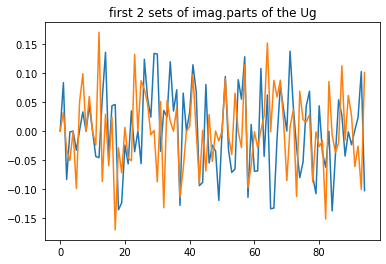

In [9]:
# convert complex Ug to real
if makeUniqueUgVector == True:
    Ug = Ug_unique
else:
    Ug = Ug_origin

Ug_2real =[]
for i in range(0,len(Ug)):
    Ug_2real.append(np.concatenate((np.array(Ug[i].real,ndmin=2).T, np.array(Ug[i].imag,ndmin=2).T),axis=1))    
Ug_2real = np.asarray(Ug_2real)

numUg = Ug_2real.shape[1]
print('shape of Ug_2real:', Ug_2real.shape)

# Plot the first 2 sets of imaginary parts of the structure factors:
plt.plot(Ug_2real[0,:,1])
plt.plot(Ug_2real[1,:,1])
plt.title('first 2 sets of imag.parts of the Ug')

shape of Ug_2real: (140, 190)


Text(0.5, 1.0, 'Ug of dataset 5')

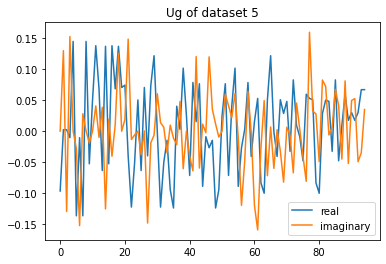

In [10]:
# combine real and imaginary numbers into one row:
# This interlaces real and imaginary numbers. 
Ug_2real = Ug_2real.reshape(-1,2*numUg)
print('shape of Ug_2real:',Ug_2real.shape)

plt.plot(Ug_2real[dataset,0:2*numUg:2],label='real')
plt.plot(Ug_2real[dataset,1:2*numUg:2],label='imaginary')
plt.legend()
plt.title('Ug of dataset '+str(dataset))

In [11]:
# normalize the thickness
t = t.astype('float32')
t = t/1000
t = t.reshape(len(t),1)

print('thickness of dataset' +str(dataset) + ':', t[dataset])

thickness of dataset5: [0.851]


In [12]:
# join Ug and t into Output(Y):
Y = np.append(Ug_2real,t,axis=1)
print('Dataset size: \n Input X:',X.shape,'Output Y:',Y.shape)

Dataset size: 
 Input X: (140, 70, 70, 1) Output Y: (140, 191)


3. define the size of training set and testing set:

In [13]:
trainsize = 100
testsize = 40
X_train = nlogf_X[:trainsize,]
X_test = nlogf_X[trainsize:trainsize+testsize,]
Y_train = Y[:trainsize,]
Y_test = Y[trainsize:trainsize+testsize,]

4. load the experimental Data:

the shape of the experimental pattern:  (1, 70, 70, 1)
0.9742559258987338


Text(0.5, 1.0, 'experimental Pattern')

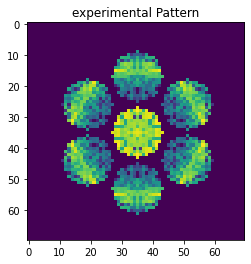

In [14]:
X_exp = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/diff_pattern_" + name + ".csv", dtype=float) 
X_exp = X_exp.reshape(1,Nx,Nx,1)
print('the shape of the experimental pattern: ',X_exp.shape)
print(X_exp.max())

nlogf_X_exp = nlogf(X_exp)
plt.imshow(nlogf_X_exp[0])
plt.title('experimental Pattern')

---------------------------------------------------------------------------------------------------------------

# II. Build the neural network

In [15]:
backend.clear_session()

num_of_features = 2*numUg+1

# invert the Input to the form which can be used in the ResNet50 Model
target_size = X_train.shape[1:3]
input_size = (*target_size, 3)

# insert ResNet50 Model
base_model = applications.ResNet50(include_top=False, weights='imagenet', input_shape=input_size)  

# combine the ResNet50 model with my model
x = Flatten()(base_model.output)
x = Dense(num_of_features*16, activation='tanh')(x)
x = Dense(num_of_features*4, activation='tanh')(x)
x = Dense(num_of_features, activation='tanh')(x)
x = Dense(num_of_features, activation='tanh')(x)
model = Model(inputs=base_model.input, outputs=x)

# remove the output layer and replaced it with the regression output layer we want in ResNet50
# keep the weights of the first 49 layers of the ResNet50 model unchanged during the training process 
for layer in base_model.layers[:-1]:
    layer.trainable = False

model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 70, 70, 3)]  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 76, 76, 3)    0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 35, 35, 64)   9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 35, 35, 64)   256         conv1_conv[0][0]                 
______________________________________________________________________________________________

In [16]:
opt = tf.keras.optimizers.Adam(lr=0.001) 
model.compile(loss='mse', optimizer=opt, metrics='acc')

#save the model
model.save(name + ".h5")

_____________________________________________________________________________________________________________

# III. Initial Training

initial training to have a check:
1) check the performance of this NN to ensure that the training loss is decreasing gradually;

2) check the simulation pattern of the predicted Ug and the one of unique predicted Ug to ensure they are same

Epoch 1/20
5/5 [==============================] - 11s 1s/step - loss: 0.2962 - acc: 0.0000e+00 - val_loss: 0.1545 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 3s 653ms/step - loss: 0.1009 - acc: 0.0000e+00 - val_loss: 0.0521 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 3s 648ms/step - loss: 0.0413 - acc: 0.3200 - val_loss: 0.0368 - val_acc: 0.9500
Epoch 4/20
5/5 [==============================] - 3s 636ms/step - loss: 0.0307 - acc: 0.3500 - val_loss: 0.0215 - val_acc: 0.9500
Epoch 5/20
5/5 [==============================] - 3s 668ms/step - loss: 0.0164 - acc: 0.8100 - val_loss: 0.0129 - val_acc: 0.9500
Epoch 6/20
5/5 [==============================] - 3s 735ms/step - loss: 0.0129 - acc: 0.8100 - val_loss: 0.0114 - val_acc: 0.9500
Epoch 7/20
5/5 [==============================] - 3s 718ms/step - loss: 0.0098 - acc: 0.8100 - val_loss: 0.0080 - val_acc: 0.9500
Epoch 8/20
5/5 [==============================] - 3s 686ms/step - loss: 0.00

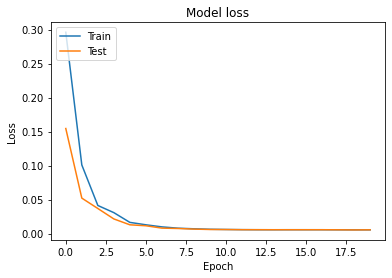

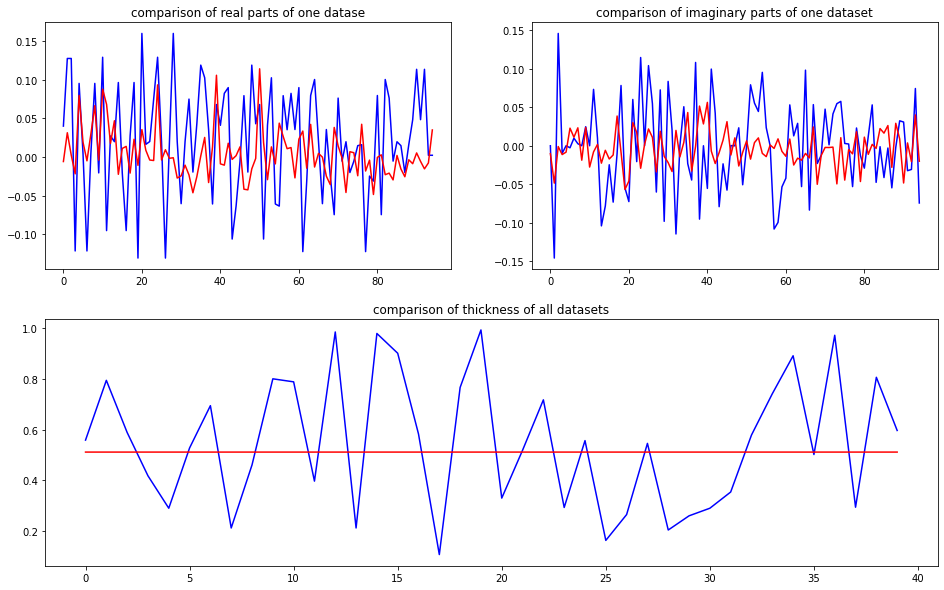

predicted thickness: 0.51167136


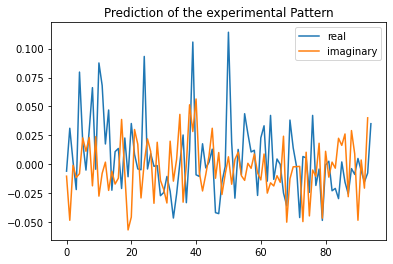

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//ZnO_001_Th500A_T30mrad_r8_maxg_0_5_100kV/ZnO_001_Th500A_T30mrad_r8_maxg_0_5_100kV/ZnO_001_Th500A_T30mrad_r8_maxg_0_5_100kV.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=511.67136430740356
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-6.01050491e-03+0.j          1.67399242e-02-0.02375132j
  1.67399242e-02+0.02375132j -1.35056868e-02-0.0

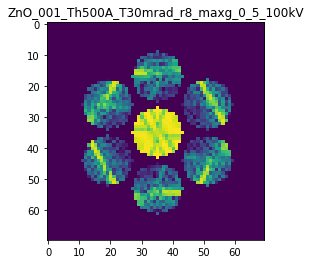

X_sim1.max():  0.9866793764588259
nlogf_X_sim1.max():  6.895358127326362
Time:  88.036497873


In [17]:
start = timeit.default_timer()

# load and compile the model
model = load_model(name + ".h5")


# invert the 1 channel image Array to 3 Channel, to use ResNet50
X_train_3C = np.concatenate((X_train,X_train,X_train),axis=3) #same value for every channel
X_test_3C = np.concatenate((X_test,X_test,X_test),axis=3)

# train the model
model.fit(X_train_3C, Y_train, validation_data=(X_test_3C, Y_test), batch_size=20, epochs=20)

# plot the model loss
plt.plot(model.history.history['loss'])
plt.plot(model.history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()
plt.close()
    

# Prediction of the testing set
Y_test_pred = model.predict(X_test_3C)    
Ug_test_pred_complex = Y_test_pred[:,:2*numUg].reshape(-1,numUg,2)
Ug_test_complex = Y_test[:,:2*numUg].reshape(-1,numUg,2)    
t_test_pred = Y_test_pred[:,2*numUg]
t_test = Y_test[:,2*numUg]
    
# plot the comparison of imaginary parts, real parts and thickness
gs = gridspec.GridSpec(2, 2)
fig = plt.figure(figsize=(16,10))
    
ax1 = fig.add_subplot(gs[0, 0]) 
ax1.plot(Ug_test_complex[2,:,0],'b')
ax1.plot(Ug_test_pred_complex[2,:,0],'r')
ax1.set_title('comparison of real parts of one datase')
    
ax2 = fig.add_subplot(gs[0, 1]) 
ax2.plot(Ug_test_complex[2,:,1],'b')
ax2.plot(Ug_test_pred_complex[2,:,1],'r')
ax2.set_title('comparison of imaginary parts of one dataset')
    
ax3 = fig.add_subplot(gs[1, :])
ax3.plot(t_test[:],'b')
ax3.plot(t_test_pred[:],'r')
ax3.set_title('comparison of thickness of all datasets')
plt.show()
plt.close()
    
    
# Prediction of the experimental Pattern
X_exp_3C = np.concatenate((X_exp,X_exp,X_exp),axis=3)
Y_exp_pred = model.predict(X_exp_3C) 
    
Ug_t_exp_pred = Y_exp_pred[0,:] 
Ug_exp_pred = Ug_t_exp_pred[0:2*numUg] 
t_exp_pred = Ug_t_exp_pred[2*numUg]
print("predicted thickness:", t_exp_pred)
    

# plot the results
plt.plot(Ug_exp_pred[0:-1:2],label='real')
plt.plot(Ug_exp_pred[1:-1:2],label='imaginary')
plt.legend()
plt.title('Prediction of the experimental Pattern')
plt.show()
plt.close()
    
# normalization
Ug_pred = np.array(range( np.int((Ug_t_exp_pred.size - 1)/2) ), dtype=complex)
Ug_pred.real = Ug_t_exp_pred[0:-1:2]
Ug_pred.imag = Ug_t_exp_pred[1:-1:2]

Ug_pred_normalized = nf.normalization(file=File, origin_Ug=Ug_pred)
Ug_pred_normalized = np.asarray(Ug_pred_normalized)

# reshape
Ug_pred_normalized_2real = np.concatenate((np.array(Ug_pred_normalized.real,ndmin=2).T, np.array(Ug_pred_normalized.imag,ndmin=2).T),axis=1)  
Ug_pred_normalized_2real = np.asarray(Ug_pred_normalized_2real)
Ug_t_pred_normalized_2real = np.append(Ug_pred_normalized_2real.reshape(numUg*2), Ug_t_exp_pred[-1])

# Compute the LARBED pattern: X_sim, from the predicted {Ug,t}: Y_exp_pred
file = File+".qed"
X_sim1 = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=Ug_t_pred_normalized_2real, InputUgdoFlip=False)
X_sim1 = X_sim1.reshape(Nx,Nx,1)
nlogf_X_sim1 = nlogf(X_sim1)
print("X_sim1.max(): ", X_sim1.max())
print("nlogf_X_sim1.max(): ", nlogf_X_sim1.max())

    
stop = timeit.default_timer()
print('Time: ', stop - start)

Applied shift of unit cell origin (fractional coordinates): 0.026362154605100604 -0.01058365384929002 -0.0008551178390371092
Ug[ 0 ]: 0.00601 3.14159  =>  0.00601 3.14159
Ug[ 1 ]: 0.02906 -0.95686  =>  0.02906 -0.96223
Ug[ 2 ]: 0.02906 0.95686  =>  0.02906 0.96223
Ug[ 3 ]: 0.01762 -2.44408  =>  0.01762 -2.51058
Ug[ 4 ]: 0.07317 0.07187  =>  0.07317 0.0
Ug[ 5 ]: 0.02427 -0.0068  =>  0.02427 -0.06792
Ug[ 6 ]: 0.01762 2.44408  =>  0.01762 2.51058
Ug[ 7 ]: 0.02427 0.0068  =>  0.02427 0.06792
Ug[ 8 ]: 0.07317 -0.07187  =>  0.07317 -0.0
Ug[ 9 ]: 0.02073 1.41176  =>  0.02073 1.5774
Ug[ 10 ]: 0.09159 -0.16027  =>  0.09159 -0.0
Ug[ 11 ]: 0.04092 0.05101  =>  0.04092 0.22202
Ug[ 12 ]: 0.01855 -1.66502  =>  0.01855 -1.43288
Ug[ 13 ]: 0.03088 -0.8054  =>  0.03088 -0.57863
Ug[ 14 ]: 0.00113 1.48627  =>  0.00113 1.72378
Ug[ 15 ]: 0.02073 -1.41176  =>  0.02073 -1.5774
Ug[ 16 ]: 0.04092 -0.05101  =>  0.04092 -0.22202
Ug[ 17 ]: 0.01855 1.66502  =>  0.01855 1.43288
Ug[ 18 ]: 0.00113 -1.48627  =>  0.0011

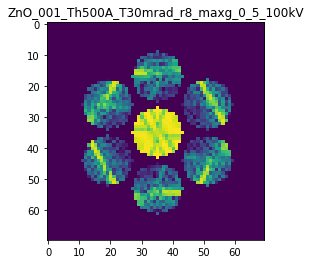

X_sim2.max():  0.9866793764588266
nlogf_X_sim2.max():  6.895358127326363


In [18]:
# make unique Ug
UgUnique, r0 = mu_3D.makeUniqueUgVector(Ug_pred_normalized,beam1,beam2,beam3,file = File)

# reshape
UgUnique_2real = np.concatenate((np.array(UgUnique.real,ndmin=2).T, np.array(UgUnique.imag,ndmin=2).T),axis=1)  
UgUnique_2real = np.asarray(UgUnique_2real)
UgUnique_t_2real = np.append(UgUnique_2real.reshape(numUg*2), Ug_t_exp_pred[-1])

# Compute the LARBED pattern: X_sim, from the predicted {Ug,t}: Y_exp_pred
X_sim2 = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=UgUnique_t_2real, InputUgdoFlip=False)
X_sim2 = X_sim2.reshape(Nx,Nx,1)
nlogf_X_sim2 = nlogf(X_sim2)
print("X_sim2.max(): ", X_sim2.max())
print("nlogf_X_sim2.max(): ", nlogf_X_sim2.max())

In [19]:
R = calculate_R(X_sim1, X_sim2)
print(R)

1.428830193873199e-15


In [20]:
print('the ture thickness: 500')
print('the predicted thickness:',Ug_t_exp_pred[-1]*1000)

the ture thickness: 500
the predicted thickness: 511.67136430740356


In [21]:
simulation_pattern = np.asarray(X_sim2)
print('the shape of the simulated pattern', X_sim2.shape)
print('the shape of the experimental pattern', X_exp.shape)

the shape of the simulated pattern (70, 70, 1)
the shape of the experimental pattern (1, 70, 70, 1)


Text(0.5, 1.0, 'experimental Pattern')

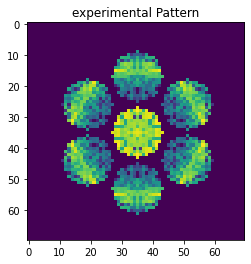

In [22]:
# plot the experimental Pattern:
plt.imshow(nlogf_X_exp[0])
plt.title('experimental Pattern')

Text(0.5, 1.0, 'simulation pattern')

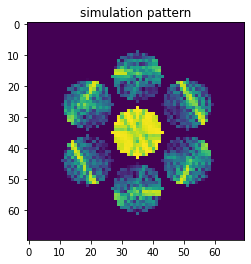

In [23]:
# plot the final simulated Pattern:
plt.imshow(nlogf_X_sim2)
plt.title("simulation pattern")

R-factor:  0.7080696927726562


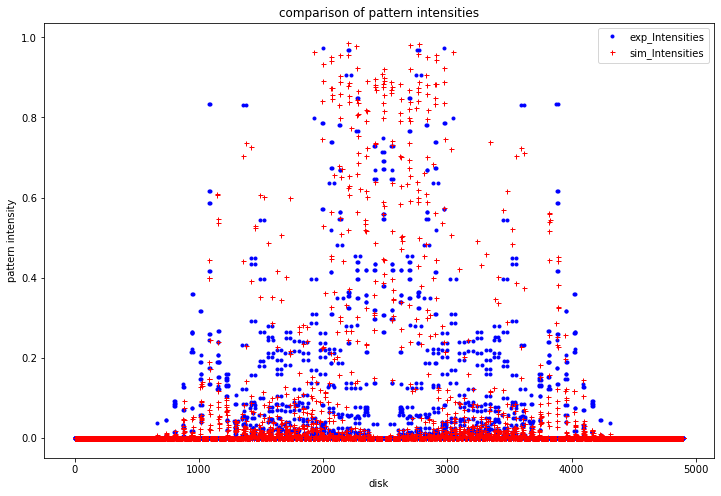

In [24]:
exp_Intensities = X_exp[0].reshape(Nx*Nx)
sim_Intensities = X_sim2.reshape(Nx*Nx)
R = calculate_R(exp_Intensities, sim_Intensities)
print("R-factor: ", R)    
plt.figure(figsize=(12,8))
plt.plot(exp_Intensities, "bo", markersize=3, label="exp_Intensities")
plt.plot(sim_Intensities, "r+", markersize=5, label="sim_Intensities")
plt.legend()
plt.xlabel("disk")
plt.ylabel("pattern intensity")
plt.title("comparison of pattern intensities")
plt.show()

-------------------------------------------------------------------------------------------------------------------

# IV. Replace the initial training set with new training set

>>>train the initial training set:
Epoch 1/20
5/5 [==============================] - 11s 1s/step - loss: 0.2960 - acc: 0.0000e+00 - val_loss: 0.1619 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 3s 678ms/step - loss: 0.1045 - acc: 0.0000e+00 - val_loss: 0.0483 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 4s 758ms/step - loss: 0.0421 - acc: 0.0000e+00 - val_loss: 0.0381 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 4s 949ms/step - loss: 0.0333 - acc: 0.6500 - val_loss: 0.0240 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 3s 696ms/step - loss: 0.0189 - acc: 0.6400 - val_loss: 0.0150 - val_acc: 0.9500
Epoch 6/20
5/5 [==============================] - 4s 838ms/step - loss: 0.0133 - acc: 0.8100 - val_loss: 0.0107 - val_acc: 0.9500
Epoch 7/20
5/5 [==============================] - 3s 671ms/step - loss: 0.0101 - acc: 0.8100 - val_loss: 0.0086 - val_acc: 0.9500
Epoch 8/20
5/5 [=============

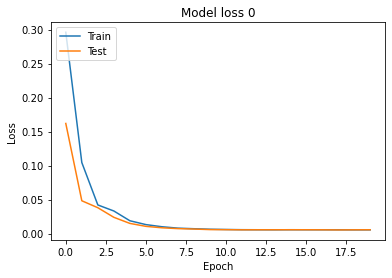

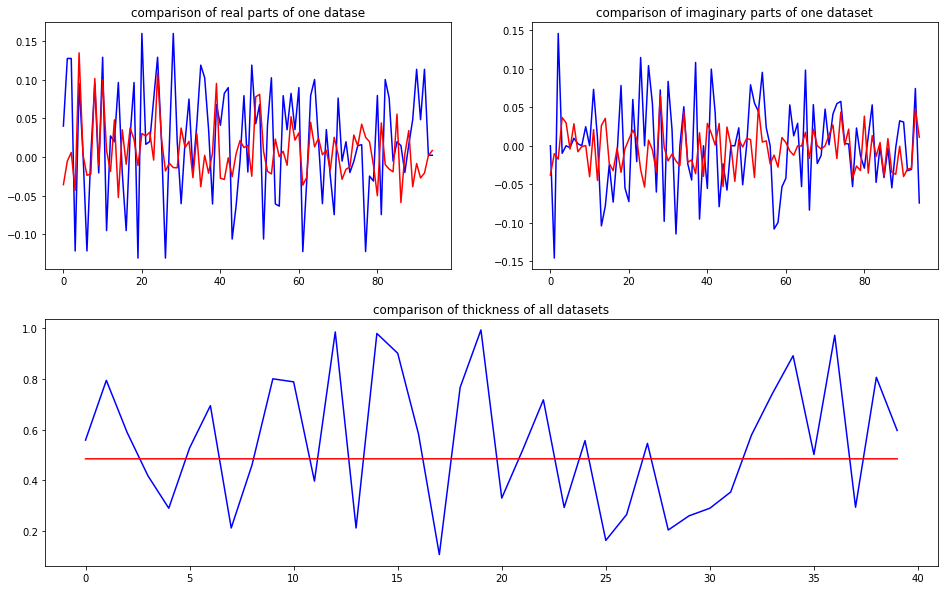

predicted thickness: 0.48507592


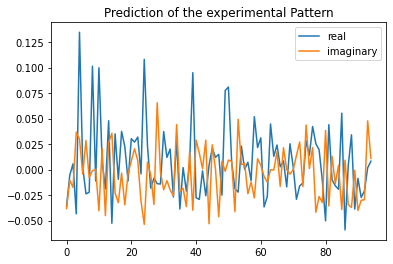

The offset applied on thickness: -0.00016180002022698448

The offset applied on Ug: 4.723479746764002

Applied shift of unit cell origin (fractional coordinates): 0.03933206602801235 -0.04065374597263949 -0.026174066509454887
Ug[ 0 ]: 0.02293 3.14159  =>  0.02293 3.14159
Ug[ 1 ]: 0.00327 1.17311  =>  0.00327 1.00865
Ug[ 2 ]: 0.00327 -1.17311  =>  0.00327 -1.00865
Ug[ 3 ]: 0.02359 2.86303  =>  0.02359 2.60759
Ug[ 4 ]: 0.20514 0.41989  =>  0.20514 0.0
Ug[ 5 ]: 0.00846 3.0518  =>  0.00846 2.96082
Ug[ 6 ]: 0.02359 -2.86303  =>  0.02359 -2.60759
Ug[ 7 ]: 0.00846 -3.0518  =>  0.00846 -2.96082
Ug[ 8 ]: 0.20514 -0.41989  =>  0.20514 0.0
Ug[ 9 ]: 0.01753 0.36175  =>  0.01753 0.60888
Ug[ 10 ]: 0.16637 -0.08267  =>  0.16637 0.0
Ug[ 11 ]: 0.02565 1.44705  =>  0.02565 1.85864
Ug[ 12 ]: 0.02753 -0.84295  =>  0.02753 -0.34038
Ug[ 13 ]: 0.04772 0.39878  =>  0.04772 0.73688
Ug[ 14 ]: 0.03577 1.61133  =>  0.03577 2.27835
Ug[ 15 ]: 0.01753 -0.36175  =>  0.01753 -0.60888
Ug[ 16 ]: 0.02565 -1.44705  =>  0.

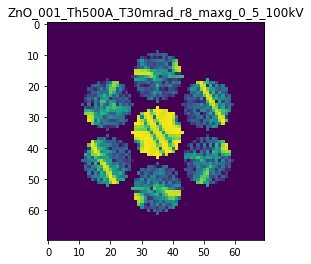

X_sim.max(): 0.9943976973512403
>>>replaced the 1. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 955ms/step - loss: 0.0056 - acc: 0.8100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 630ms/step - loss: 0.0055 - acc: 0.8100 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 633ms/step - loss: 0.0056 - acc: 0.8100 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 904ms/step - loss: 0.0055 - acc: 0.8100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 768ms/step - loss: 0.0054 - acc: 0.8100 - val_loss: 0.0055 - val_acc: 0.9500


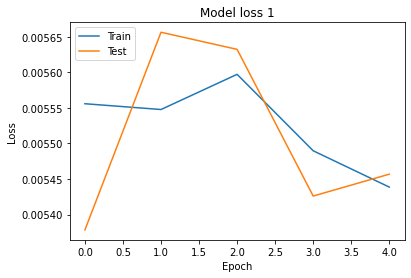

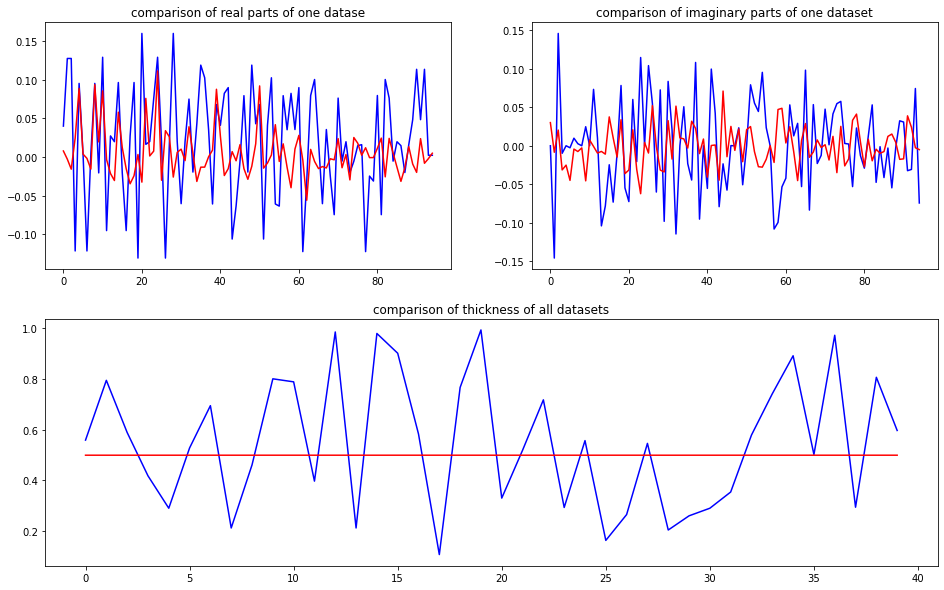

predicted thickness: 0.4993383


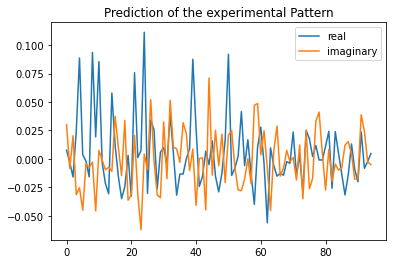

The offset applied on thickness: 0.0006300437194211967

The offset applied on Ug: -3.6601671391092503

Applied shift of unit cell origin (fractional coordinates): -0.026594390580124104 0.012110676413981064 0.018279143338700468
Ug[ 0 ]: 0.00414 0.0  =>  0.00414 0.0
Ug[ 1 ]: 0.01703 -2.25447  =>  0.01703 -2.13962
Ug[ 2 ]: 0.01703 2.25447  =>  0.01703 2.13962
Ug[ 3 ]: 0.01798 -1.08771  =>  0.01798 -1.01162
Ug[ 4 ]: 0.06063 -0.19094  =>  0.06063 0.0
Ug[ 5 ]: 0.02418 -2.01203  =>  0.02418 -2.05078
Ug[ 6 ]: 0.01798 1.08771  =>  0.01798 1.01162
Ug[ 7 ]: 0.02418 2.01203  =>  0.02418 2.05078
Ug[ 8 ]: 0.06063 0.19094  =>  0.06063 0.0
Ug[ 9 ]: 0.04374 -1.37833  =>  0.04374 -1.54542
Ug[ 10 ]: 0.06229 0.05225  =>  0.06229 0.0
Ug[ 11 ]: 0.01114 -2.68196  =>  0.01114 -2.96391
Ug[ 12 ]: 0.03214 2.99333  =>  0.03214 2.75014
Ug[ 13 ]: 0.03404 3.11032  =>  0.03404 2.98198
Ug[ 14 ]: 0.02364 -1.25826  =>  0.02364 -1.61631
Ug[ 15 ]: 0.04374 1.37833  =>  0.04374 1.54542
Ug[ 16 ]: 0.01114 2.68196  =>  0.01114

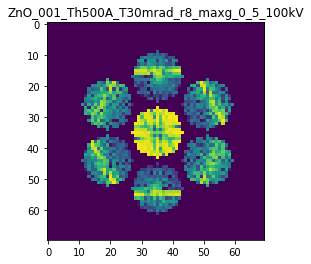

X_sim.max(): 0.9876008698299854
>>>replaced the 2. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 935ms/step - loss: 0.0054 - acc: 0.8100 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 615ms/step - loss: 0.0055 - acc: 0.8100 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 625ms/step - loss: 0.0055 - acc: 0.8100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 750ms/step - loss: 0.0054 - acc: 0.8100 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 3s 641ms/step - loss: 0.0056 - acc: 0.8100 - val_loss: 0.0057 - val_acc: 0.9500


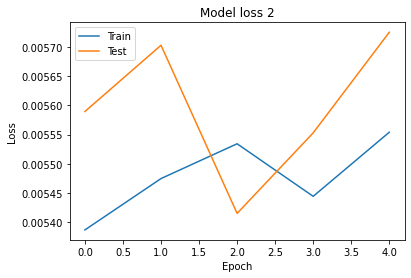

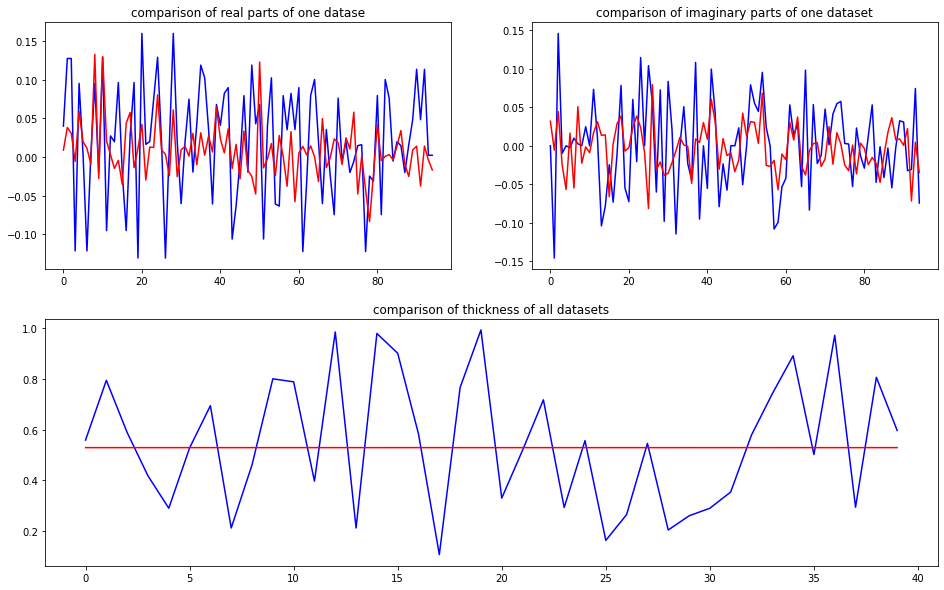

predicted thickness: 0.5292838


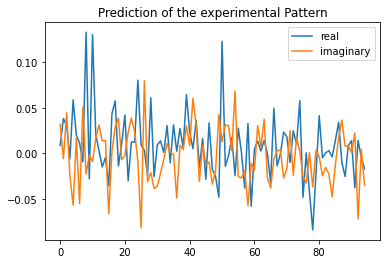

The offset applied on thickness: 0.0006028488904014771

The offset applied on Ug: 3.5377121484853404

Applied shift of unit cell origin (fractional coordinates): -0.0800297959511625 0.0402164950265481 0.03280405055540779
Ug[ 0 ]: 0.0126 0.0  =>  0.0126 0.0
Ug[ 1 ]: 0.05063 -0.59014  =>  0.05063 -0.38402
Ug[ 2 ]: 0.05063 0.59014  =>  0.05063 0.38402
Ug[ 3 ]: 0.01363 0.8198  =>  0.01363 1.07249
Ug[ 4 ]: 0.15558 -0.4588  =>  0.15558 0.0
Ug[ 5 ]: 0.02325 -1.06965  =>  0.02325 -1.02307
Ug[ 6 ]: 0.01363 -0.8198  =>  0.01363 -1.07249
Ug[ 7 ]: 0.02325 1.06965  =>  0.02325 1.02307
Ug[ 8 ]: 0.15558 0.4588  =>  0.15558 0.0
Ug[ 9 ]: 0.03243 2.24953  =>  0.03243 1.74669
Ug[ 10 ]: 0.15337 0.29673  =>  0.15337 0.0
Ug[ 11 ]: 0.03689 0.10668  =>  0.03689 -0.60228
Ug[ 12 ]: 0.04001 -0.1934  =>  0.04001 -0.94893
Ug[ 13 ]: 0.03593 1.29523  =>  0.03593 0.74582
Ug[ 14 ]: 0.01572 -1.95181  =>  0.01572 -2.91346
Ug[ 15 ]: 0.03243 -2.24953  =>  0.03243 -1.74669
Ug[ 16 ]: 0.03689 -0.10668  =>  0.03689 0.60228
Ug

Residual error after kinematic rocking curve fit: 0.030493983259512143



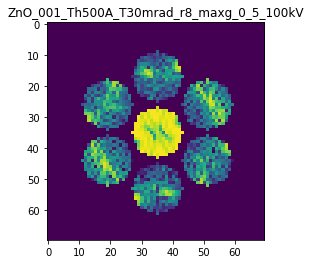

X_sim.max(): 0.9878897587432632
>>>replaced the 3. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 1s/step - loss: 0.0056 - acc: 0.8100 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 874ms/step - loss: 0.0055 - acc: 0.8100 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0056 - acc: 0.8100 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0055 - acc: 0.8100 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 704ms/step - loss: 0.0055 - acc: 0.8100 - val_loss: 0.0056 - val_acc: 0.9500


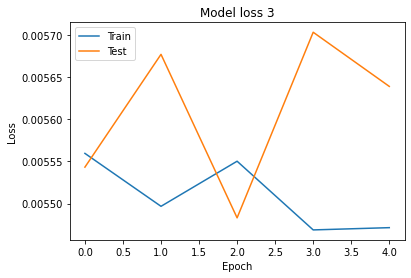

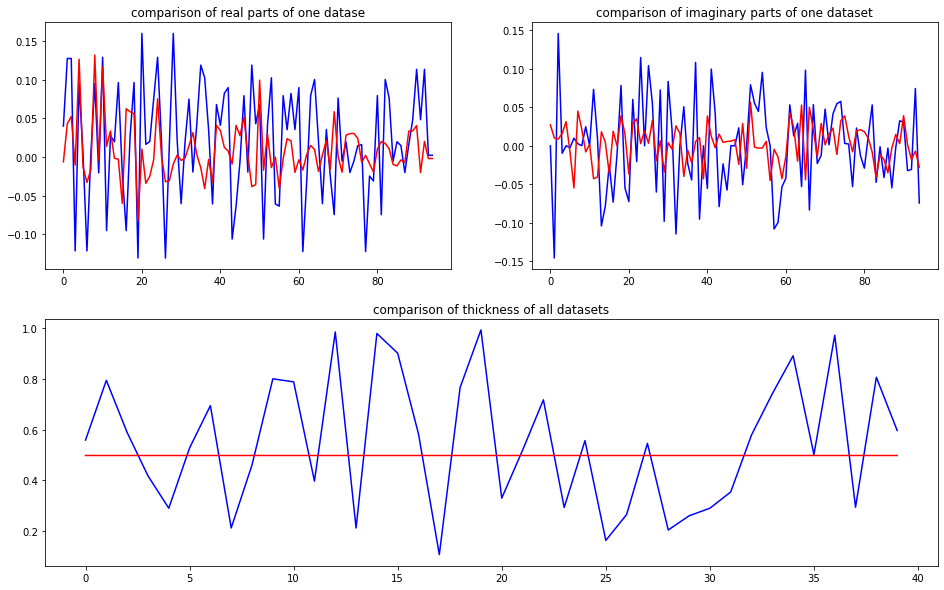

predicted thickness: 0.49822745


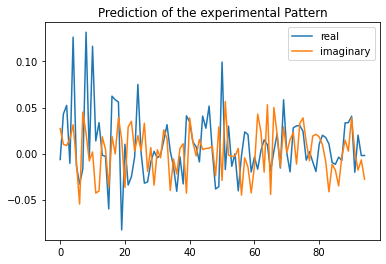

The offset applied on thickness: 0.0009567341974228732

The offset applied on Ug: -0.20194121620330438

Applied shift of unit cell origin (fractional coordinates): 0.004027969007819183 -0.0183444382965138 0.012145784790805135
Ug[ 0 ]: 0.00657 3.14159  =>  0.00657 3.14159
Ug[ 1 ]: 0.0472 0.01615  =>  0.0472 0.09246
Ug[ 2 ]: 0.0472 -0.01615  =>  0.0472 -0.09246
Ug[ 3 ]: 0.0421 2.12841  =>  0.0421 2.01315
Ug[ 4 ]: 0.12567 0.03895  =>  0.12567 0.0
Ug[ 5 ]: 0.03039 -2.08471  =>  0.03039 -2.27628
Ug[ 6 ]: 0.0421 -2.12841  =>  0.0421 -2.01315
Ug[ 7 ]: 0.03039 2.08471  =>  0.03039 2.27628
Ug[ 8 ]: 0.12567 -0.03895  =>  0.12567 -0.0
Ug[ 9 ]: 0.03588 2.7206  =>  0.03588 2.74591
Ug[ 10 ]: 0.09434 -0.10162  =>  0.09434 0.0
Ug[ 11 ]: 0.04835 -0.68593  =>  0.04835 -0.73693
Ug[ 12 ]: 0.04964 -0.41677  =>  0.04964 -0.2762
Ug[ 13 ]: 0.00747 1.64501  =>  0.00747 1.86189
Ug[ 14 ]: 0.03098 -0.57299  =>  0.03098 -0.50874
Ug[ 15 ]: 0.03588 -2.7206  =>  0.03588 -2.74591
Ug[ 16 ]: 0.04835 0.68593  =>  0.04835

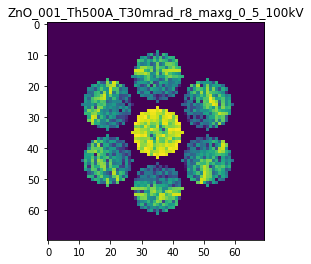

X_sim.max(): 0.9344015685276608
>>>replaced the 4. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 936ms/step - loss: 0.0055 - acc: 0.8100 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 611ms/step - loss: 0.0054 - acc: 0.8100 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 637ms/step - loss: 0.0055 - acc: 0.8100 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 658ms/step - loss: 0.0054 - acc: 0.8100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0053 - acc: 0.8100 - val_loss: 0.0054 - val_acc: 0.9500


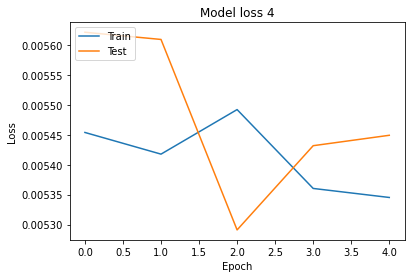

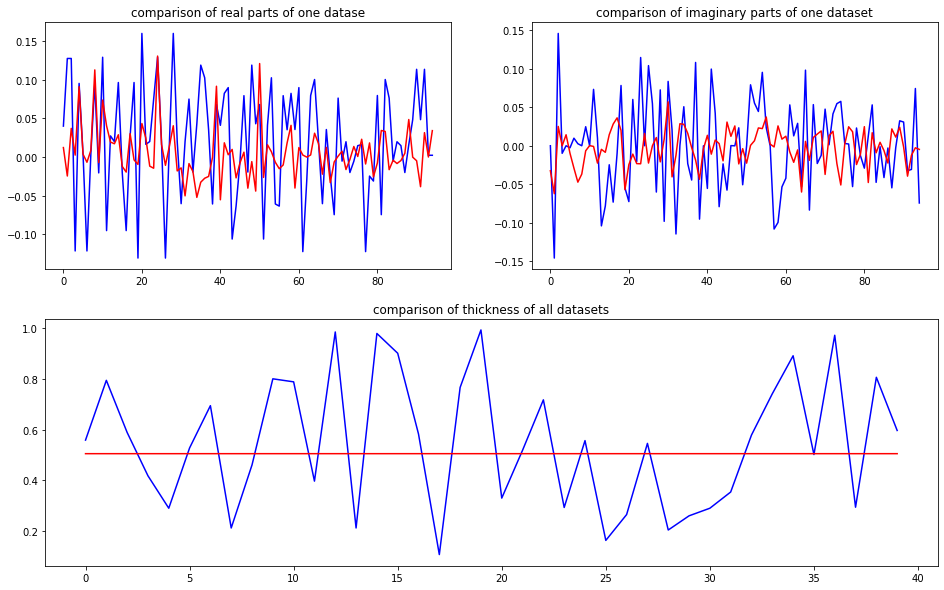

predicted thickness: 0.50537443


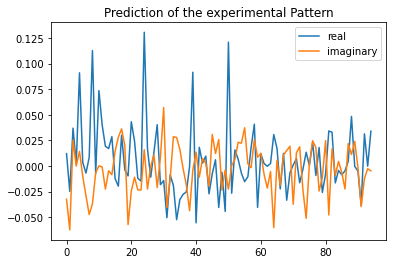

The offset applied on thickness: 0.0004593792297631341

The offset applied on Ug: -2.766240971462551

Applied shift of unit cell origin (fractional coordinates): 0.04645666651263434 -0.02064668434132514 -0.04013875288855771
Ug[ 0 ]: 0.00876 0.0  =>  0.00876 0.0
Ug[ 1 ]: 0.04885 -1.62946  =>  0.04885 -1.88165
Ug[ 2 ]: 0.04885 1.62946  =>  0.04885 1.88165
Ug[ 3 ]: 0.01618 1.79122  =>  0.01618 1.6615
Ug[ 4 ]: 0.07612 0.38193  =>  0.07612 0.0
Ug[ 5 ]: 0.02185 1.44867  =>  0.02185 1.57114
Ug[ 6 ]: 0.01618 -1.79122  =>  0.01618 -1.6615
Ug[ 7 ]: 0.02185 -1.44867  =>  0.02185 -1.57114
Ug[ 8 ]: 0.07612 -0.38193  =>  0.07612 0.0
Ug[ 9 ]: 0.01453 -2.37498  =>  0.01453 -2.08308
Ug[ 10 ]: 0.07071 -0.0397  =>  0.07071 0.0
Ug[ 11 ]: 0.01582 -1.1543  =>  0.01582 -0.61021
Ug[ 12 ]: 0.0345 -0.94018  =>  0.0345 -0.51856
Ug[ 13 ]: 0.0179 0.55861  =>  0.0179 0.72804
Ug[ 14 ]: 0.01812 -0.94504  =>  0.01812 -0.27121
Ug[ 15 ]: 0.01453 2.37498  =>  0.01453 2.08308
Ug[ 16 ]: 0.01582 1.1543  =>  0.01582 0.61021


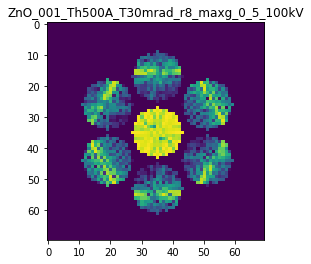

X_sim.max(): 0.9837393766186335
>>>replaced the 5. dataset and train: 
Epoch 1/5
5/5 [==============================] - 10s 1s/step - loss: 0.0053 - acc: 0.8100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0052 - acc: 0.8100 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 4s 806ms/step - loss: 0.0052 - acc: 0.8100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0053 - acc: 0.8100 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0054 - acc: 0.8100 - val_loss: 0.0056 - val_acc: 0.9500


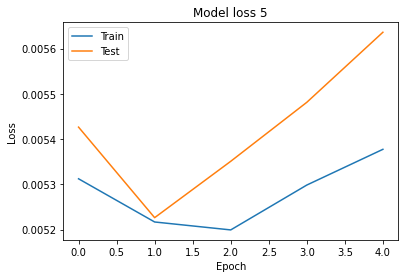

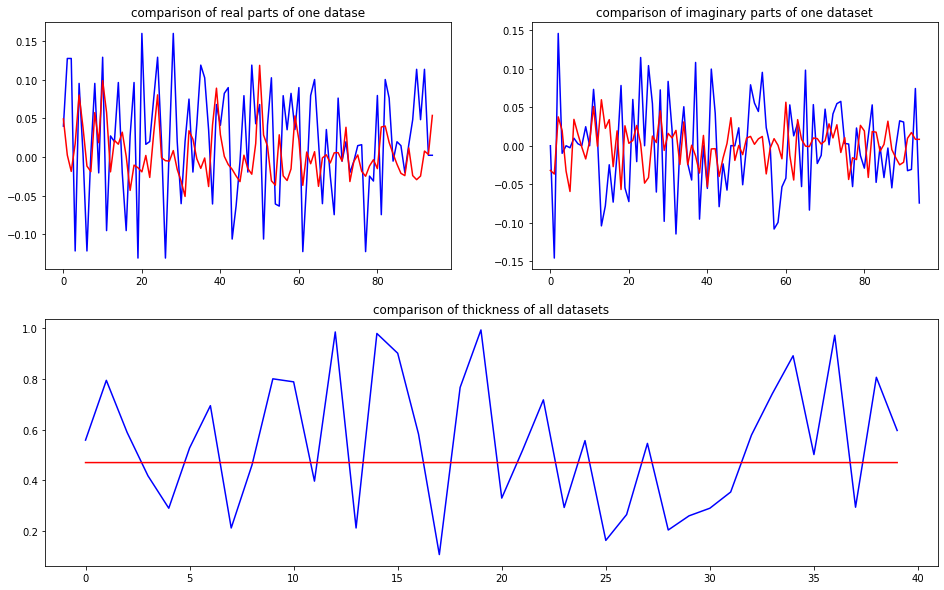

predicted thickness: 0.47023478


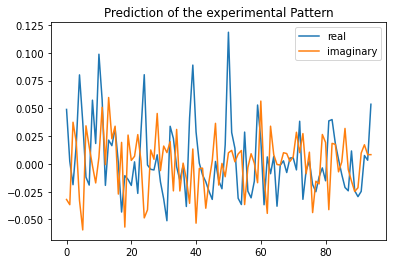

The offset applied on thickness: -0.0007416242370156902

The offset applied on Ug: 3.4922852312790282

Applied shift of unit cell origin (fractional coordinates): -0.03574792651549279 0.009855638916335235 -0.005688372466940417
Ug[ 0 ]: 0.06102 0.0  =>  0.06102 0.0
Ug[ 1 ]: 0.03752 -1.64547  =>  0.03752 -1.68121
Ug[ 2 ]: 0.03752 1.64547  =>  0.03752 1.68121
Ug[ 3 ]: 0.01018 -0.92891  =>  0.01018 -0.86699
Ug[ 4 ]: 0.08764 -0.02618  =>  0.08764 0.0
Ug[ 5 ]: 0.03298 -0.94994  =>  0.03298 -0.85228
Ug[ 6 ]: 0.01018 0.92891  =>  0.01018 0.86699
Ug[ 7 ]: 0.03298 0.94994  =>  0.03298 0.85228
Ug[ 8 ]: 0.08764 0.02618  =>  0.08764 0.0
Ug[ 9 ]: 0.0418 -0.76765  =>  0.0418 -0.99226
Ug[ 10 ]: 0.12623 0.26035  =>  0.12623 -0.0
Ug[ 11 ]: 0.06687 0.91405  =>  0.06687 0.72518
Ug[ 12 ]: 0.02943 -2.71129  =>  0.02943 -2.99783
Ug[ 13 ]: 0.05952 1.22402  =>  0.05952 0.90175
Ug[ 14 ]: 0.03705 1.29429  =>  0.03705 1.0435
Ug[ 15 ]: 0.0418 0.76765  =>  0.0418 0.99226
Ug[ 16 ]: 0.06687 -0.91405  =>  0.06687 -0.7

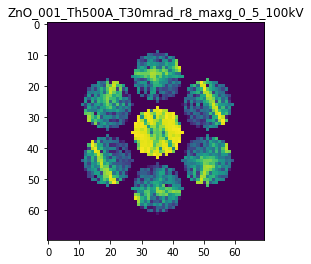

X_sim.max(): 0.9879607596500584
>>>replaced the 6. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0053 - acc: 0.8100 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0053 - acc: 0.8100 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0052 - acc: 0.8100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0053 - acc: 0.8100 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 874ms/step - loss: 0.0053 - acc: 0.8100 - val_loss: 0.0055 - val_acc: 0.9500


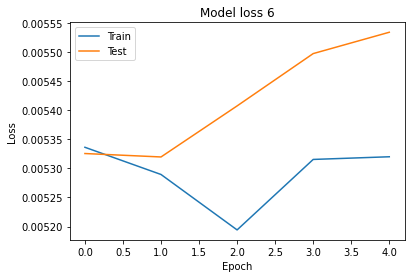

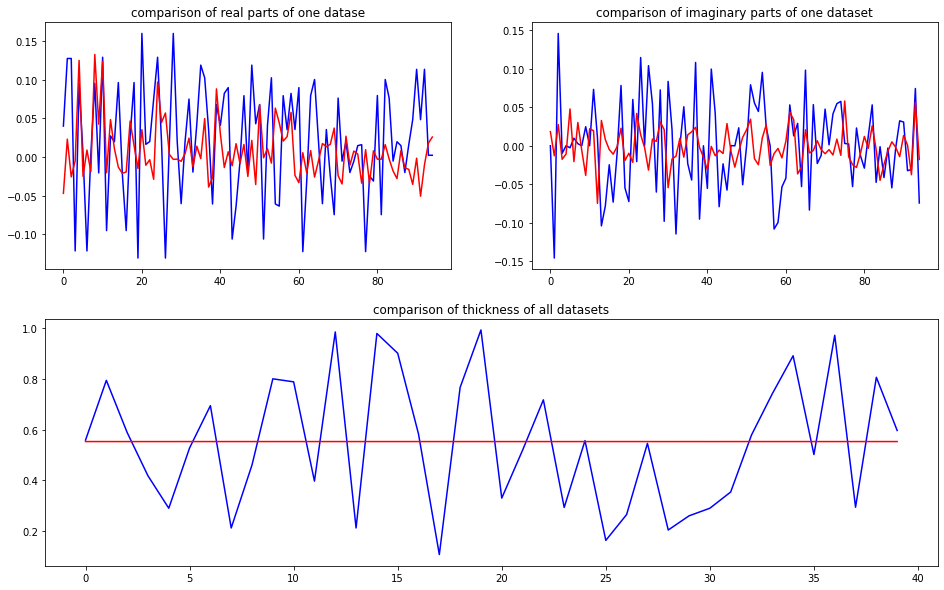

predicted thickness: 0.55320555


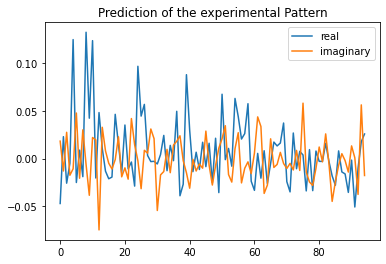

The offset applied on thickness: -0.0008436844913322448

The offset applied on Ug: -3.179900677031125

Applied shift of unit cell origin (fractional coordinates): -0.039540106211812115 -0.013005125415416739 0.017158153541831814
Ug[ 0 ]: 0.05533 3.14159  =>  0.05533 3.14159
Ug[ 1 ]: 0.01921 -1.82507  =>  0.01921 -1.71727
Ug[ 2 ]: 0.01921 1.82507  =>  0.01921 1.71727
Ug[ 3 ]: 0.00184 1.27033  =>  0.00184 1.18862
Ug[ 4 ]: 0.07577 -0.02609  =>  0.07577 0.0
Ug[ 5 ]: 0.02929 2.94934  =>  0.02929 2.75982
Ug[ 6 ]: 0.00184 -1.27033  =>  0.00184 -1.18862
Ug[ 7 ]: 0.02929 -2.94934  =>  0.02929 -2.75982
Ug[ 8 ]: 0.07577 0.02609  =>  0.07577 -0.0
Ug[ 9 ]: 0.02048 -1.34389  =>  0.02048 -1.59232
Ug[ 10 ]: 0.07096 0.14063  =>  0.07096 -0.0
Ug[ 11 ]: 0.02646 2.55204  =>  0.02646 2.19579
Ug[ 12 ]: 0.05414 -0.95438  =>  0.05414 -1.12111
Ug[ 13 ]: 0.03993 1.01891  =>  0.03993 0.95999
Ug[ 14 ]: 0.00678 -1.68201  =>  0.00678 -1.95655
Ug[ 15 ]: 0.02048 1.34389  =>  0.02048 1.59232
Ug[ 16 ]: 0.02646 -2.55204 

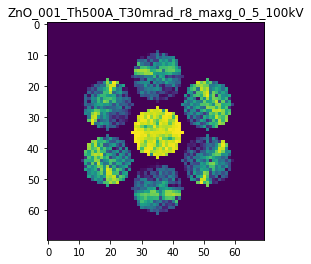

X_sim.max(): 0.9593966441839366
>>>replaced the 7. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0052 - acc: 0.8200 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 948ms/step - loss: 0.0053 - acc: 0.8200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0052 - acc: 0.8200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 974ms/step - loss: 0.0051 - acc: 0.8200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 759ms/step - loss: 0.0052 - acc: 0.8200 - val_loss: 0.0055 - val_acc: 0.9500


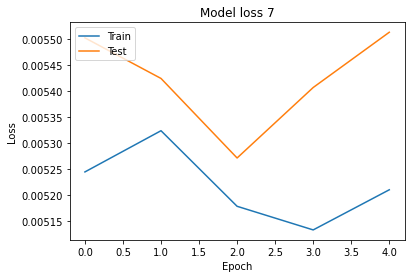

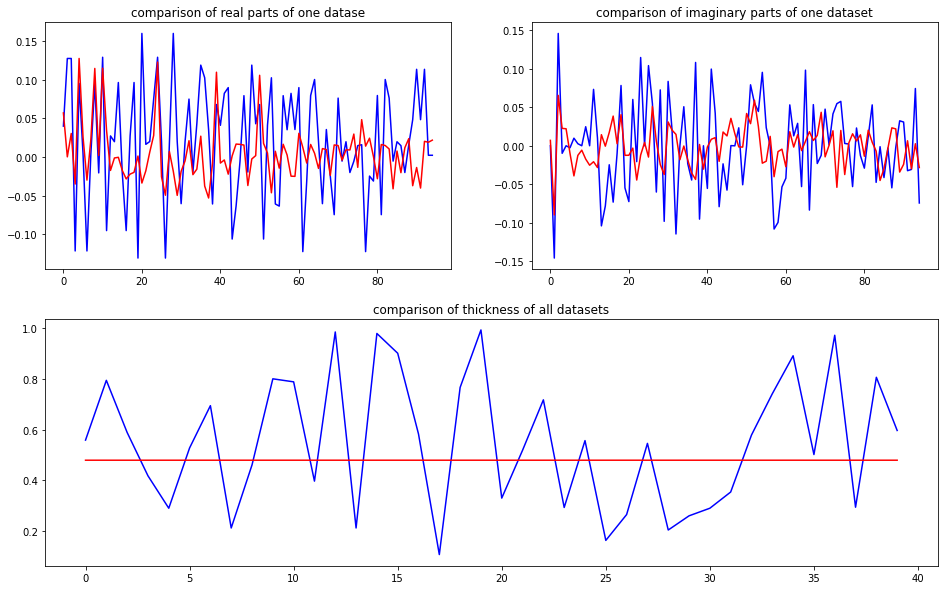

predicted thickness: 0.47958797


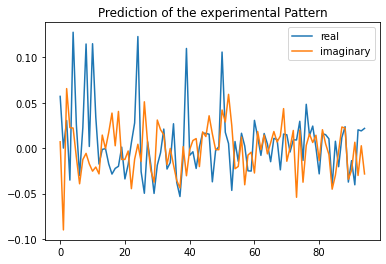

The offset applied on thickness: 0.0009929720335499694

The offset applied on Ug: -4.569882832800282

Applied shift of unit cell origin (fractional coordinates): -0.006556784541094398 -0.09304972236520752 0.05257820639105554
Ug[ 0 ]: 0.04188 0.0  =>  0.04188 0.0
Ug[ 1 ]: 0.09064 -1.73879  =>  0.09064 -1.40843
Ug[ 2 ]: 0.09064 1.73879  =>  0.09064 1.40843
Ug[ 3 ]: 0.05342 2.47931  =>  0.05342 1.89466
Ug[ 4 ]: 0.05447 0.25429  =>  0.05447 0.0
Ug[ 5 ]: 0.02094 0.05488  =>  0.02094 -0.86013
Ug[ 6 ]: 0.05342 -2.47931  =>  0.05342 -1.89466
Ug[ 7 ]: 0.02094 -0.05488  =>  0.02094 0.86013
Ug[ 8 ]: 0.05447 -0.25429  =>  0.05447 0.0
Ug[ 9 ]: 0.01914 -2.11229  =>  0.01914 -2.15349
Ug[ 10 ]: 0.05502 -0.28916  =>  0.05502 -0.0
Ug[ 11 ]: 0.02614 -1.80676  =>  0.02614 -2.17832
Ug[ 12 ]: 0.02909 -2.51487  =>  0.02909 -1.97142
Ug[ 13 ]: 0.02314 2.34215  =>  0.02314 -3.06723
Ug[ 14 ]: 0.02096 -2.35913  =>  0.02096 -2.14603
Ug[ 15 ]: 0.01914 2.11229  =>  0.01914 2.15349
Ug[ 16 ]: 0.02614 1.80676  =>  0.02

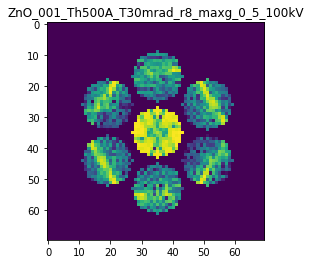

X_sim.max(): 0.9461382955079826
>>>replaced the 8. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 936ms/step - loss: 0.0052 - acc: 0.8200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 606ms/step - loss: 0.0051 - acc: 0.8200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 709ms/step - loss: 0.0051 - acc: 0.8200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0051 - acc: 0.8200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0051 - acc: 0.8200 - val_loss: 0.0053 - val_acc: 0.9500


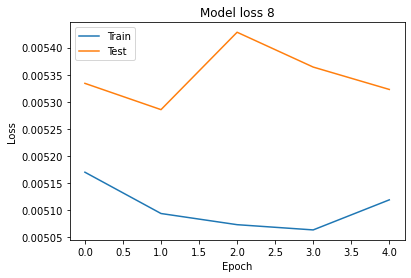

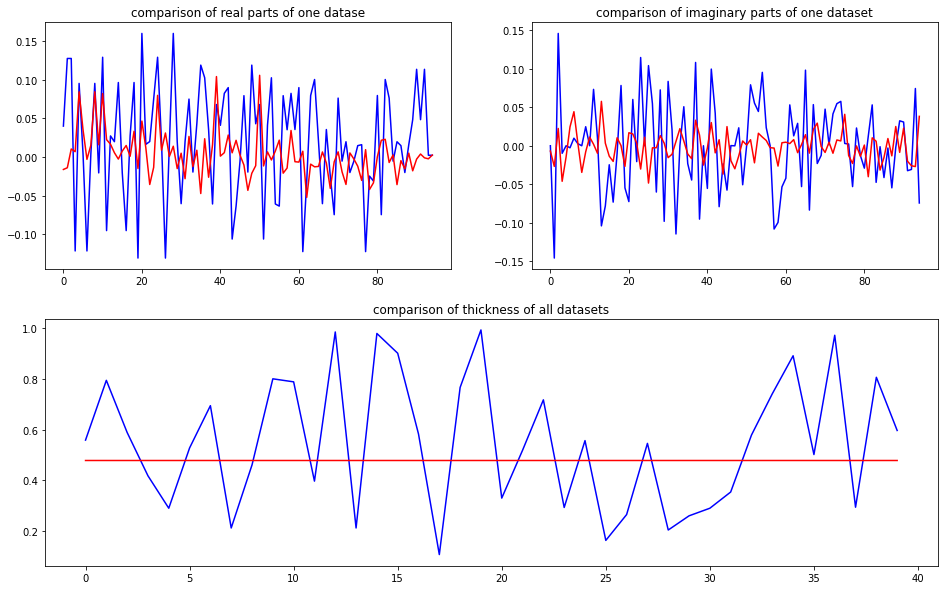

predicted thickness: 0.47847816


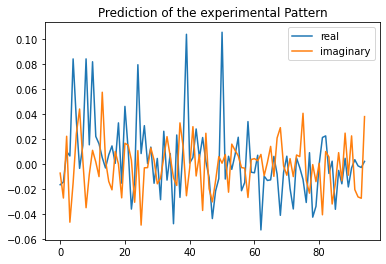

The offset applied on thickness: 0.0009314472317502132

The offset applied on Ug: 3.382881840007721

Applied shift of unit cell origin (fractional coordinates): -0.0028511394767572443 -0.010769216434837062 0.0006841576392396846
Ug[ 0 ]: 0.0152 3.14159  =>  0.0152 3.14159
Ug[ 1 ]: 0.02437 -1.54231  =>  0.02437 -1.53801
Ug[ 2 ]: 0.02437 1.54231  =>  0.02437 1.53801
Ug[ 3 ]: 0.04546 -1.37594  =>  0.04546 -1.44361
Ug[ 4 ]: 0.11097 0.06337  =>  0.11097 -0.0
Ug[ 5 ]: 0.03196 0.45512  =>  0.03196 0.38316
Ug[ 6 ]: 0.04546 1.37594  =>  0.04546 1.44361
Ug[ 7 ]: 0.03196 -0.45512  =>  0.03196 -0.38316
Ug[ 8 ]: 0.11097 -0.06337  =>  0.11097 0.0
Ug[ 9 ]: 0.01292 0.23489  =>  0.01292 0.21698
Ug[ 10 ]: 0.10338 0.01362  =>  0.10338 0.0
Ug[ 11 ]: 0.02322 0.49054  =>  0.02322 0.46833
Ug[ 12 ]: 0.01342 -0.79018  =>  0.01342 -0.74043
Ug[ 13 ]: 0.05725 1.27246  =>  0.05725 1.32651
Ug[ 14 ]: 0.01709 -0.04072  =>  0.01709 0.00473
Ug[ 15 ]: 0.01292 -0.23489  =>  0.01292 -0.21698
Ug[ 16 ]: 0.02322 -0.49054  => 

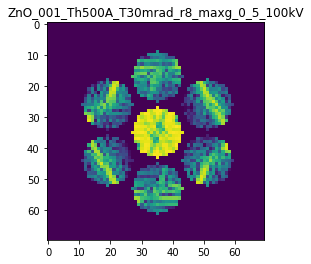

X_sim.max(): 0.9768932777160236
>>>replaced the 9. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0051 - acc: 0.8200 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 636ms/step - loss: 0.0051 - acc: 0.8200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 4s 874ms/step - loss: 0.0051 - acc: 0.8200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0051 - acc: 0.8200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 978ms/step - loss: 0.0051 - acc: 0.8200 - val_loss: 0.0054 - val_acc: 0.9500


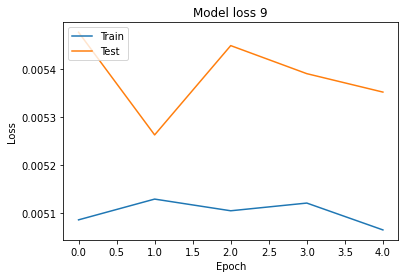

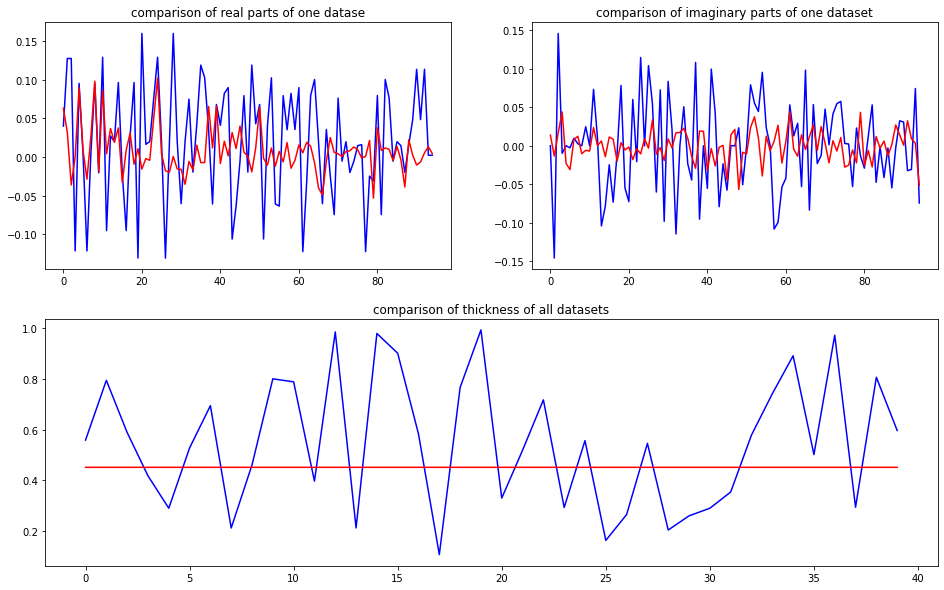

predicted thickness: 0.45151225


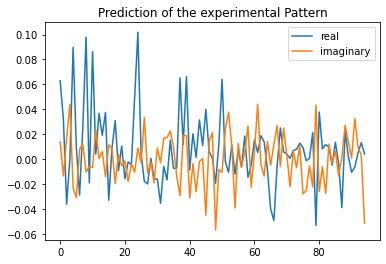

The offset applied on thickness: 0.00022643422398492508

The offset applied on Ug: -3.3437185645648144

Applied shift of unit cell origin (fractional coordinates): 0.0224450653949395 0.021281012918504753 -0.006073724128430022
Ug[ 0 ]: 0.04903 0.0  =>  0.04903 0.0
Ug[ 1 ]: 0.01513 -2.05044  =>  0.01513 -2.08861
Ug[ 2 ]: 0.01513 2.05044  =>  0.01513 2.08861
Ug[ 3 ]: 0.02521 2.43082  =>  0.02521 2.56453
Ug[ 4 ]: 0.06354 -0.09555  =>  0.06354 0.0
Ug[ 5 ]: 0.02636 -0.99852  =>  0.02636 -0.82665
Ug[ 6 ]: 0.02521 -2.43082  =>  0.02521 -2.56453
Ug[ 7 ]: 0.02636 0.99852  =>  0.02636 0.82665
Ug[ 8 ]: 0.06354 0.09555  =>  0.06354 -0.0
Ug[ 9 ]: 0.02958 -2.90646  =>  0.02958 -2.76544
Ug[ 10 ]: 0.06441 -0.10286  =>  0.06441 0.0
Ug[ 11 ]: 0.00858 0.92436  =>  0.00858 1.10355
Ug[ 12 ]: 0.03104 0.33222  =>  0.03104 0.33953
Ug[ 13 ]: 0.01153 0.35865  =>  0.01153 0.3278
Ug[ 14 ]: 0.01569 -0.77761  =>  0.01569 -0.73213
Ug[ 15 ]: 0.02958 2.90646  =>  0.02958 2.76544
Ug[ 16 ]: 0.00858 -0.92436  =>  0.00858 

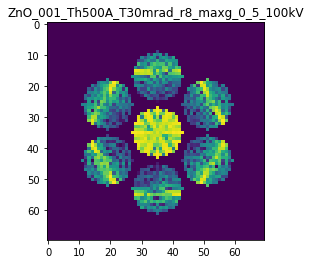

X_sim.max(): 0.9550109127825253
>>>replaced the 10. dataset and train: 
Epoch 1/5
5/5 [==============================] - 11s 2s/step - loss: 0.0050 - acc: 0.8200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0050 - acc: 0.8200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0050 - acc: 0.8200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0051 - acc: 0.8200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0050 - acc: 0.8200 - val_loss: 0.0054 - val_acc: 0.9500


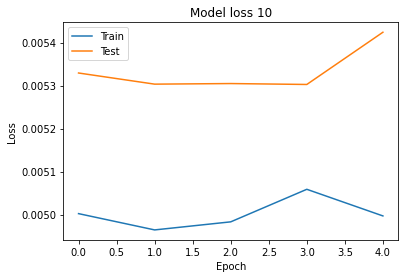

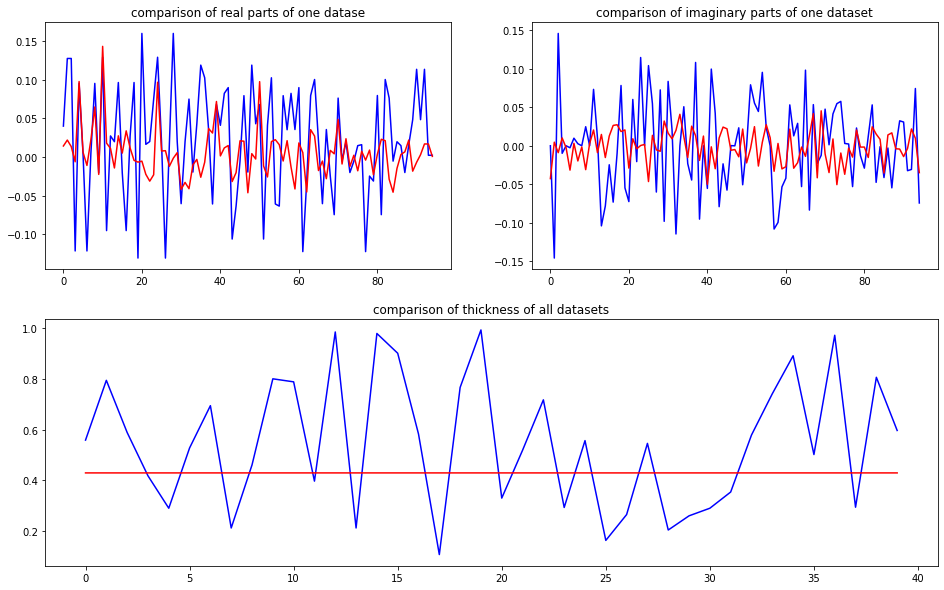

predicted thickness: 0.42944175


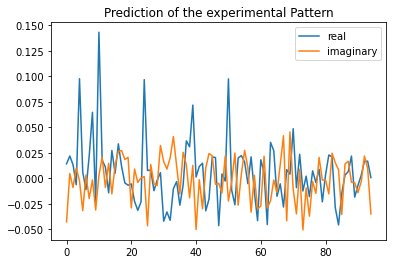

The offset applied on thickness: -0.00010754516828285365

The offset applied on Ug: -0.8448409818630329

Applied shift of unit cell origin (fractional coordinates): 0.018620380650795174 0.019364206905926138 -0.014509688684383739
Ug[ 0 ]: 0.01244 0.0  =>  0.01244 0.0
Ug[ 1 ]: 0.01852 0.3705  =>  0.01852 0.27933
Ug[ 2 ]: 0.01852 -0.3705  =>  0.01852 -0.27933
Ug[ 3 ]: 0.00947 2.76578  =>  0.00947 2.88745
Ug[ 4 ]: 0.07535 -0.0305  =>  0.07535 -0.0
Ug[ 5 ]: 0.01449 -0.42989  =>  0.01449 -0.21705
Ug[ 6 ]: 0.00947 -2.76578  =>  0.00947 -2.88745
Ug[ 7 ]: 0.01449 0.42989  =>  0.01449 0.21705
Ug[ 8 ]: 0.07535 0.0305  =>  0.07535 0.0
Ug[ 9 ]: 0.02436 -1.97332  =>  0.02436 -1.85632
Ug[ 10 ]: 0.10731 -0.02583  =>  0.10731 0.0
Ug[ 11 ]: 0.02481 -0.10218  =>  0.02481 0.10599
Ug[ 12 ]: 0.02086 -1.02487  =>  0.02086 -1.02954
Ug[ 13 ]: 0.03167 1.71234  =>  0.03167 1.6165
Ug[ 14 ]: 0.02027 -1.00686  =>  0.02027 -0.92036
Ug[ 15 ]: 0.02436 1.97332  =>  0.02436 1.85632
Ug[ 16 ]: 0.02481 0.10218  =>  0.02481

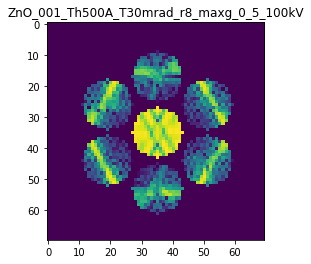

X_sim.max(): 0.980853079191893
>>>replaced the 11. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 1s/step - loss: 0.0049 - acc: 0.8300 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 801ms/step - loss: 0.0050 - acc: 0.8300 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0050 - acc: 0.8300 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 6s 1s/step - loss: 0.0051 - acc: 0.8300 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 6s 1s/step - loss: 0.0050 - acc: 0.8300 - val_loss: 0.0055 - val_acc: 0.9500


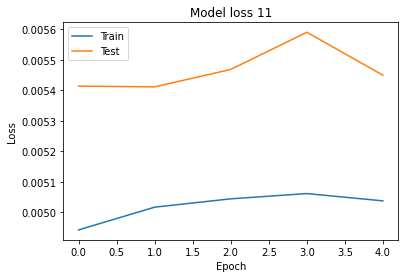

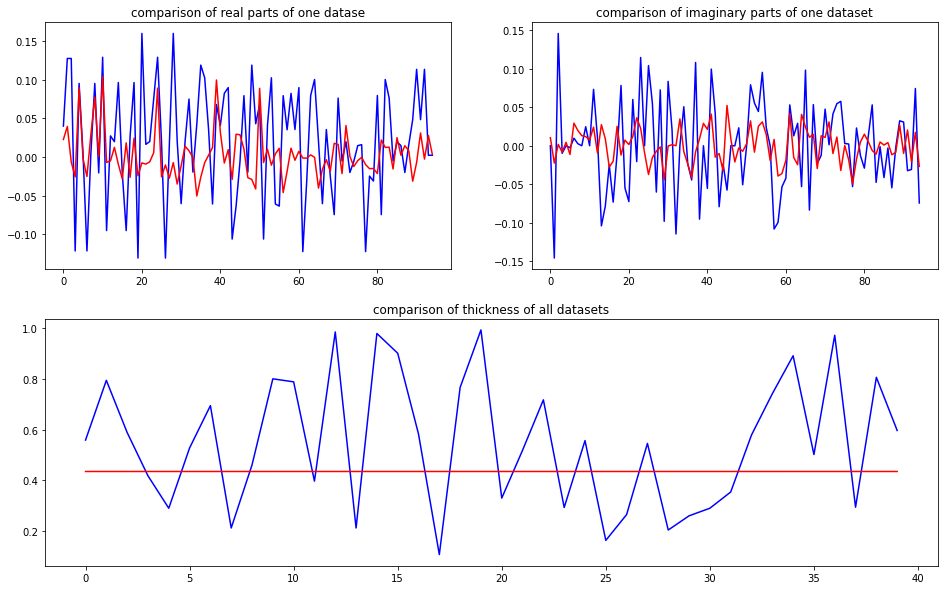

predicted thickness: 0.43506584


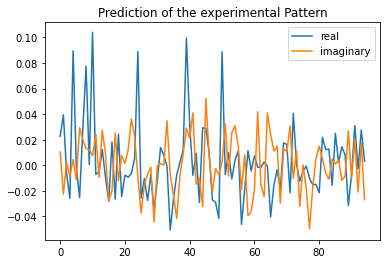

The offset applied on thickness: -0.0007260832623611966

The offset applied on Ug: -1.1710161120669709

Applied shift of unit cell origin (fractional coordinates): -0.0006532754892246607 0.023523668804332067 -0.012735272199609638
Ug[ 0 ]: 0.02185 0.0  =>  0.02185 0.0
Ug[ 1 ]: 0.02017 -0.71854  =>  0.02017 -0.79856
Ug[ 2 ]: 0.02017 0.71854  =>  0.02017 0.79856
Ug[ 3 ]: 0.03266 -2.54147  =>  0.03266 -2.39366
Ug[ 4 ]: 0.07531 -0.06779  =>  0.07531 0.0
Ug[ 5 ]: 0.01951 -0.87659  =>  0.01951 -0.64877
Ug[ 6 ]: 0.03266 2.54147  =>  0.03266 2.39366
Ug[ 7 ]: 0.01951 0.87659  =>  0.01951 0.64877
Ug[ 8 ]: 0.07531 0.06779  =>  0.07531 0.0
Ug[ 9 ]: 0.02547 2.19404  =>  0.02547 2.18994
Ug[ 10 ]: 0.08577 0.08412  =>  0.08577 -0.0
Ug[ 11 ]: 0.02274 1.36139  =>  0.02274 1.4373
Ug[ 12 ]: 0.02343 -2.35675  =>  0.02343 -2.50866
Ug[ 13 ]: 0.0342 1.81898  =>  0.0342 1.58706
Ug[ 14 ]: 0.01282 1.01262  =>  0.01282 0.94073
Ug[ 15 ]: 0.02547 -2.19404  =>  0.02547 -2.18994
Ug[ 16 ]: 0.02274 -1.36139  =>  0.02274

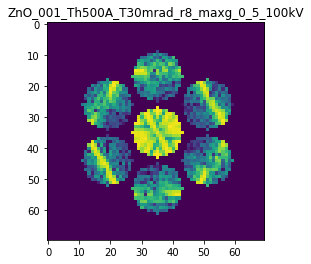

X_sim.max(): 0.9370832931726513
>>>replaced the 12. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 990ms/step - loss: 0.0049 - acc: 0.8400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 637ms/step - loss: 0.0049 - acc: 0.8400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 639ms/step - loss: 0.0050 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 645ms/step - loss: 0.0050 - acc: 0.8400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 830ms/step - loss: 0.0049 - acc: 0.8400 - val_loss: 0.0053 - val_acc: 0.9500


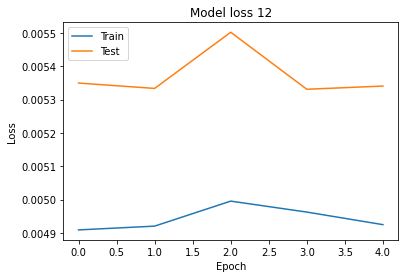

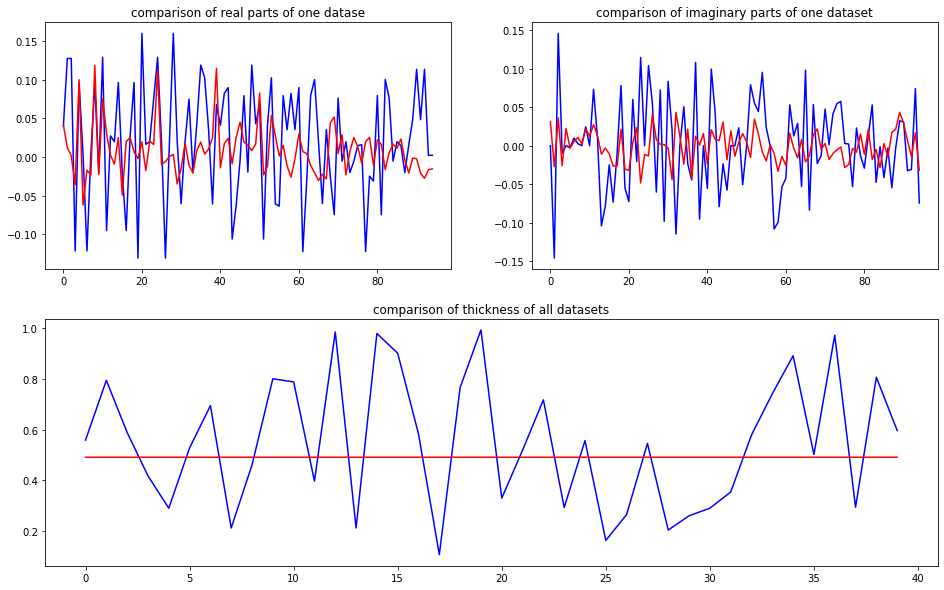

predicted thickness: 0.49139413


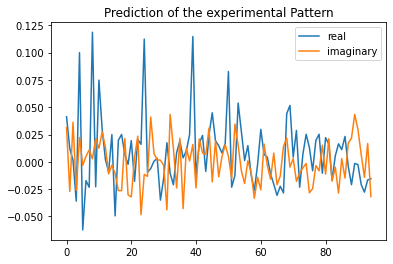

The offset applied on thickness: -0.00072936736382153

The offset applied on Ug: 2.346439859512732

Applied shift of unit cell origin (fractional coordinates): 0.0151395869755005 0.009697892415183061 -0.011533757982799544
Ug[ 0 ]: 0.04758 0.0  =>  0.04758 0.0
Ug[ 1 ]: 0.0335 -1.28655  =>  0.0335 -1.35902
Ug[ 2 ]: 0.0335 1.28655  =>  0.0335 1.35902
Ug[ 3 ]: 0.02767 -2.60994  =>  0.02767 -2.54901
Ug[ 4 ]: 0.13815 0.01154  =>  0.13815 0.0
Ug[ 5 ]: 0.03768 -3.02386  =>  0.03768 -2.89046
Ug[ 6 ]: 0.02767 2.60994  =>  0.02767 2.54901
Ug[ 7 ]: 0.03768 3.02386  =>  0.03768 2.89046
Ug[ 8 ]: 0.13815 -0.01154  =>  0.13815 -0.0
Ug[ 9 ]: 0.03519 2.71215  =>  0.03519 2.80728
Ug[ 10 ]: 0.11534 -0.02266  =>  0.11534 0.0
Ug[ 11 ]: 0.03941 0.78014  =>  0.03941 0.94774
Ug[ 12 ]: 0.02396 0.87093  =>  0.02396 0.90512
Ug[ 13 ]: 0.0089 3.02426  =>  0.0089 2.98599
Ug[ 14 ]: 0.02088 -0.61111  =>  0.02088 -0.50445
Ug[ 15 ]: 0.03519 -2.71215  =>  0.03519 -2.80728
Ug[ 16 ]: 0.03941 -0.78014  =>  0.03941 -0.94774


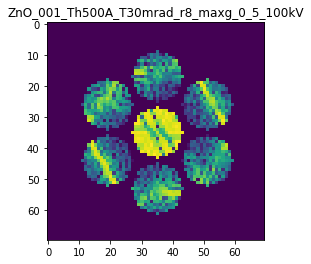

X_sim.max(): 0.9806678621463714
>>>replaced the 13. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 0.0049 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 631ms/step - loss: 0.0049 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 632ms/step - loss: 0.0050 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 643ms/step - loss: 0.0050 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 846ms/step - loss: 0.0050 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500


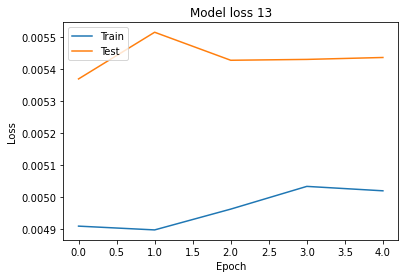

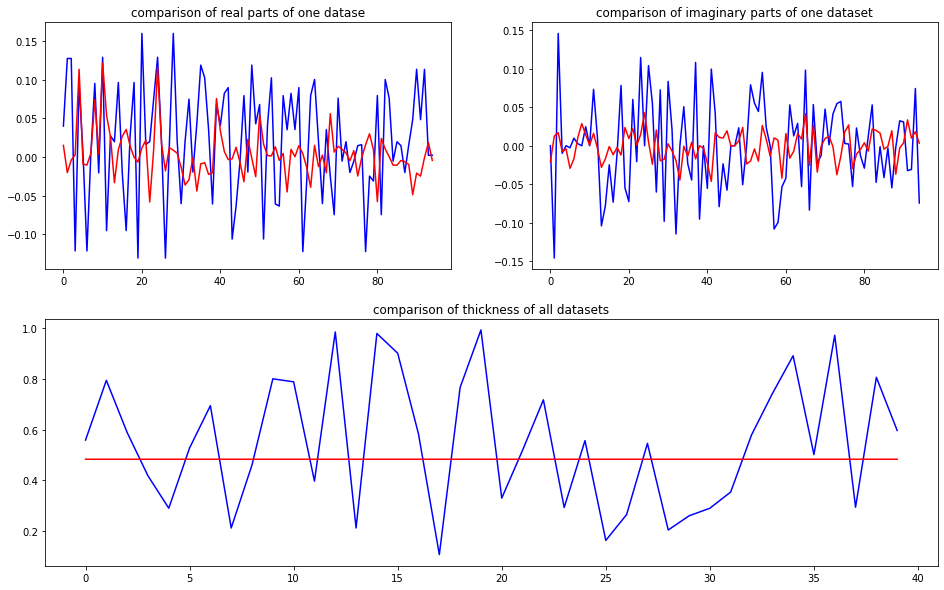

predicted thickness: 0.48350748


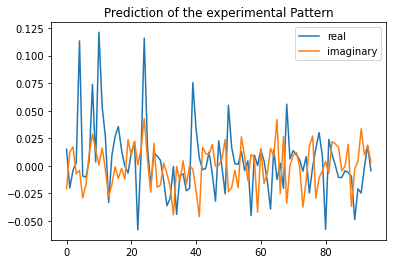

The offset applied on thickness: -0.0009746872554322595

The offset applied on Ug: -3.4157863690167196

Applied shift of unit cell origin (fractional coordinates): 0.01325584245651672 0.015452049950813854 0.03185873339403153
Ug[ 0 ]: 0.01268 0.0  =>  0.01268 0.0
Ug[ 1 ]: 0.01399 -2.93855  =>  0.01399 -2.73838
Ug[ 2 ]: 0.01399 2.93855  =>  0.01399 2.73838
Ug[ 3 ]: 0.00712 2.27798  =>  0.00712 2.37507
Ug[ 4 ]: 0.06369 -0.29726  =>  0.06369 0.0
Ug[ 5 ]: 0.02201 -1.76271  =>  0.02201 -1.8658
Ug[ 6 ]: 0.00712 -2.27798  =>  0.00712 -2.37507
Ug[ 7 ]: 0.02201 1.76271  =>  0.02201 1.8658
Ug[ 8 ]: 0.06369 0.29726  =>  0.06369 0.0
Ug[ 9 ]: 0.01583 0.55152  =>  0.01583 0.63481
Ug[ 10 ]: 0.07018 -0.28346  =>  0.07018 0.0
Ug[ 11 ]: 0.03885 0.31854  =>  0.03885 0.20166
Ug[ 12 ]: 0.01858 -0.07151  =>  0.01858 -0.08531
Ug[ 13 ]: 0.02358 -2.10393  =>  0.02358 -1.91756
Ug[ 14 ]: 0.00463 -0.67555  =>  0.00463 -0.88952
Ug[ 15 ]: 0.01583 -0.55152  =>  0.01583 -0.63481
Ug[ 16 ]: 0.03885 -0.31854  =>  0.03885

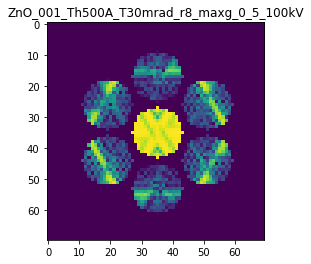

X_sim.max(): 0.9961818235079702
>>>replaced the 14. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0049 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 709ms/step - loss: 0.0050 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 4s 864ms/step - loss: 0.0049 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0049 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 839ms/step - loss: 0.0048 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500


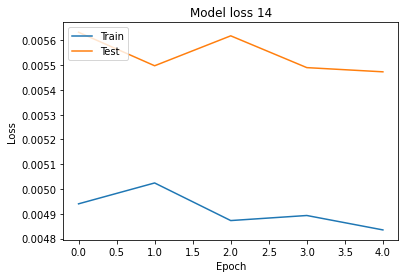

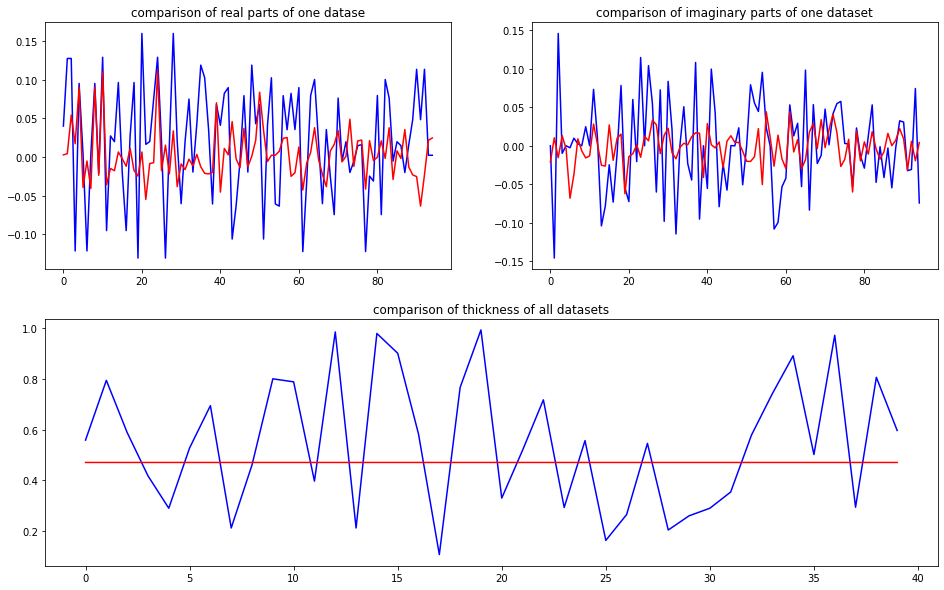

predicted thickness: 0.4707111


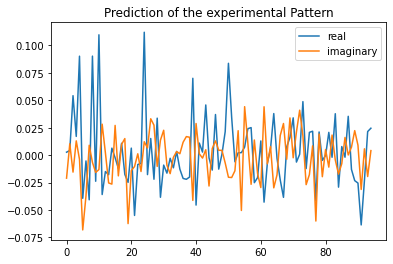

The offset applied on thickness: 0.00028344881217693785

The offset applied on Ug: -3.080304567969448

Applied shift of unit cell origin (fractional coordinates): 0.00026867252443890855 -0.03052601544322145 0.026991201133166907
Ug[ 0 ]: 0.00128 0.0  =>  0.00128 0.0
Ug[ 1 ]: 0.029 0.58937  =>  0.029 0.75896
Ug[ 2 ]: 0.029 -0.58937  =>  0.029 -0.75896
Ug[ 3 ]: 0.02697 1.46044  =>  0.02697 1.26864
Ug[ 4 ]: 0.06507 0.02221  =>  0.06507 -0.0
Ug[ 5 ]: 0.0707 -2.40284  =>  0.0707 -2.76424
Ug[ 6 ]: 0.02697 -1.46044  =>  0.02697 -1.26864
Ug[ 7 ]: 0.0707 2.40284  =>  0.0707 2.76424
Ug[ 8 ]: 0.06507 -0.02221  =>  0.06507 0.0
Ug[ 9 ]: 0.02669 -2.19091  =>  0.02669 -2.18922
Ug[ 10 ]: 0.07357 -0.17128  =>  0.07357 -0.0
Ug[ 11 ]: 0.03463 2.51166  =>  0.03463 2.34375
Ug[ 12 ]: 0.00482 -2.18935  =>  0.00482 -1.99586
Ug[ 13 ]: 0.02613 -2.43349  =>  0.02613 -2.07041
Ug[ 14 ]: 0.02227 -1.9183  =>  0.02227 -1.8944
Ug[ 15 ]: 0.02669 2.19091  =>  0.02669 2.18922
Ug[ 16 ]: 0.03463 -2.51166  =>  0.03463 -2.343

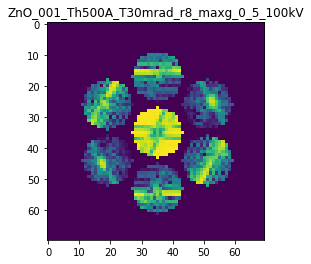

X_sim.max(): 0.9878262256155083
>>>replaced the 15. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 961ms/step - loss: 0.0048 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 631ms/step - loss: 0.0048 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 4s 780ms/step - loss: 0.0048 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 877ms/step - loss: 0.0048 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 3s 646ms/step - loss: 0.0048 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500


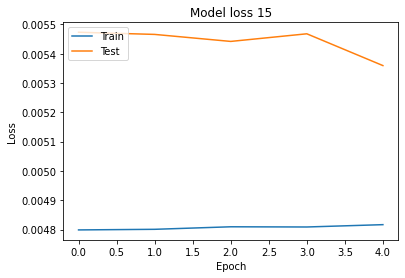

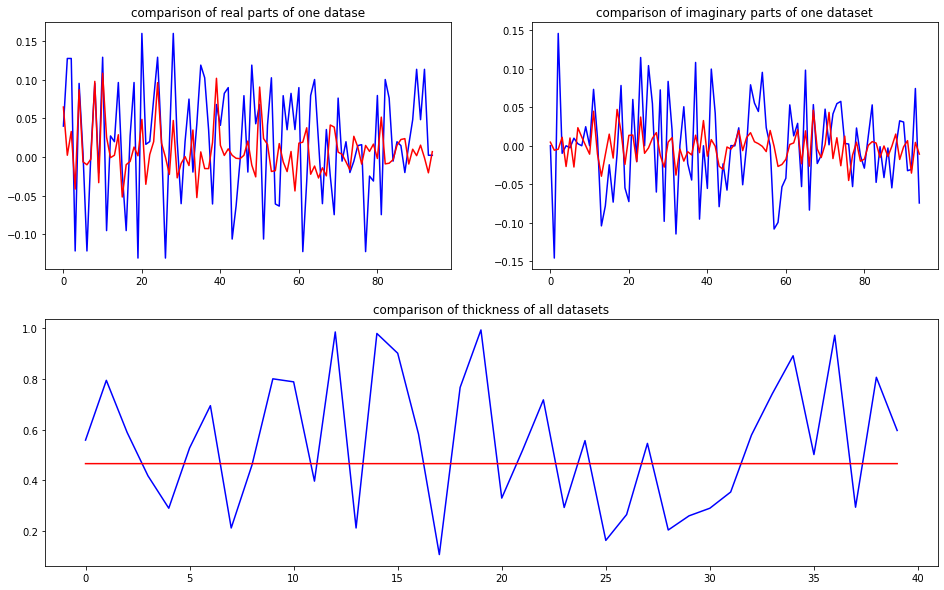

predicted thickness: 0.4660739


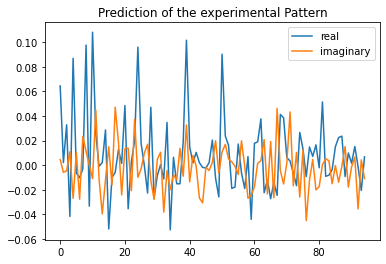

The offset applied on thickness: 0.0007967086552580421

The offset applied on Ug: 4.068735827826303

Applied shift of unit cell origin (fractional coordinates): -0.007867999404480817 0.03822000591337498 -0.005939822186404399
Ug[ 0 ]: 0.08156 0.0  =>  0.08156 0.0
Ug[ 1 ]: 0.02014 -0.17145  =>  0.02014 -0.20877
Ug[ 2 ]: 0.02014 0.17145  =>  0.02014 0.20877
Ug[ 3 ]: 0.02876 2.35902  =>  0.02876 2.59916
Ug[ 4 ]: 0.13167 -0.20282  =>  0.13167 0.0
Ug[ 5 ]: 0.00816 -1.97241  =>  0.00816 -1.69495
Ug[ 6 ]: 0.02876 -2.35902  =>  0.02876 -2.59916
Ug[ 7 ]: 0.00816 1.97241  =>  0.00816 1.69495
Ug[ 8 ]: 0.13167 0.20282  =>  0.13167 0.0
Ug[ 9 ]: 0.03572 -2.87126  =>  0.03572 -2.92069
Ug[ 10 ]: 0.14578 0.08676  =>  0.14578 0.0
Ug[ 11 ]: 0.03908 1.20756  =>  0.03908 1.19544
Ug[ 12 ]: 0.03338 -1.52771  =>  0.03338 -1.81729
Ug[ 13 ]: 0.02101 -0.85192  =>  0.02101 -1.17882
Ug[ 14 ]: 0.02748 -0.53081  =>  0.02748 -0.78307
Ug[ 15 ]: 0.03572 2.87126  =>  0.03572 2.92069
Ug[ 16 ]: 0.03908 -1.20756  =>  0.0390

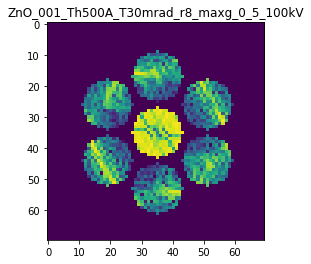

X_sim.max(): 0.9542158671356024
>>>replaced the 16. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 955ms/step - loss: 0.0048 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 663ms/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 4s 861ms/step - loss: 0.0046 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0053 - val_acc: 0.9500


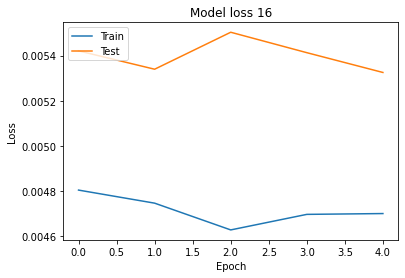

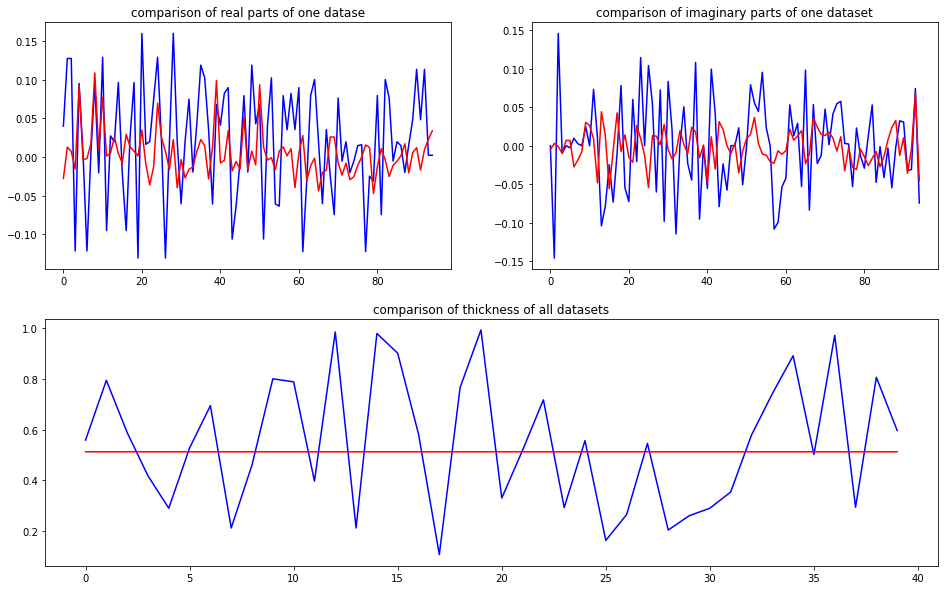

predicted thickness: 0.5129019


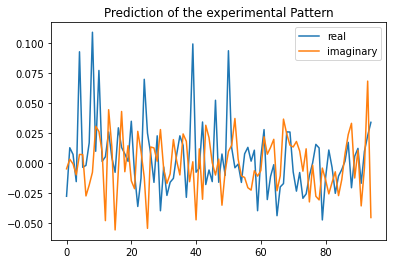

The offset applied on thickness: -0.0005774141791479986

The offset applied on Ug: 0.49234273986957405

Applied shift of unit cell origin (fractional coordinates): -0.018389257374595108 0.012005422170020815 -0.0217687047763979
Ug[ 0 ]: 0.02746 3.14159  =>  0.02746 3.14159
Ug[ 1 ]: 0.01007 0.19644  =>  0.01007 0.05967
Ug[ 2 ]: 0.01007 -0.19644  =>  0.01007 -0.05967
Ug[ 3 ]: 0.01222 2.35272  =>  0.01222 2.42815
Ug[ 4 ]: 0.10588 0.06134  =>  0.10588 -0.0
Ug[ 5 ]: 0.01416 1.08367  =>  0.01416 1.29588
Ug[ 6 ]: 0.01222 -2.35272  =>  0.01222 -2.42815
Ug[ 7 ]: 0.01416 -1.08367  =>  0.01416 -1.29588
Ug[ 8 ]: 0.10588 -0.06134  =>  0.10588 0.0
Ug[ 9 ]: 0.0427 1.52602  =>  0.0427 1.41048
Ug[ 10 ]: 0.0786 0.25232  =>  0.0786 0.0
Ug[ 11 ]: 0.01716 0.45235  =>  0.01716 0.47358
Ug[ 12 ]: 0.04646 -1.35382  =>  0.04646 -1.54479
Ug[ 13 ]: 0.05596 1.07245  =>  0.05596 0.7447
Ug[ 14 ]: 0.01194 1.04722  =>  0.01194 0.99302
Ug[ 15 ]: 0.0427 -1.52602  =>  0.0427 -1.41048
Ug[ 16 ]: 0.01716 -0.45235  =>  0.0171

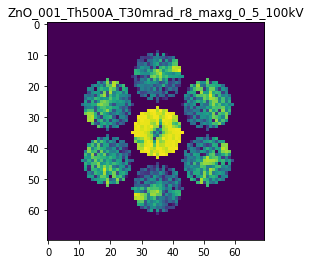

X_sim.max(): 0.9927641046146626
>>>replaced the 17. dataset and train: 
Epoch 1/5
5/5 [==============================] - 10s 1s/step - loss: 0.0046 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 625ms/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 670ms/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 913ms/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500


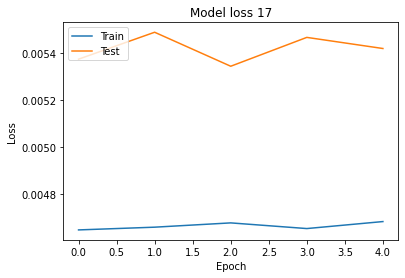

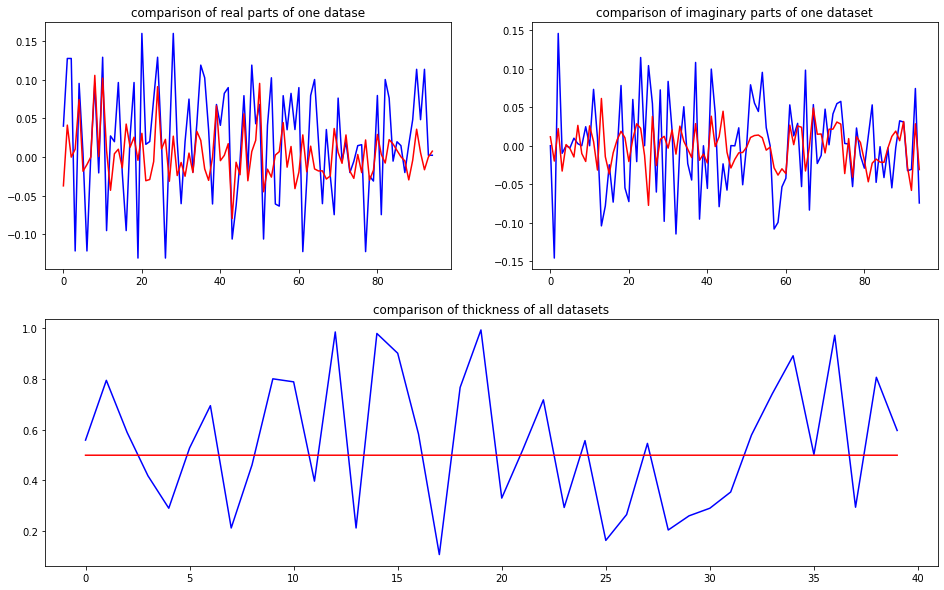

predicted thickness: 0.49932045


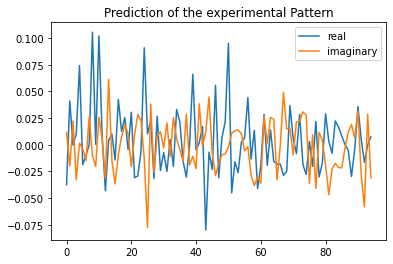

The offset applied on thickness: 0.0005689785607497813

The offset applied on Ug: -2.9680403631304593

Applied shift of unit cell origin (fractional coordinates): -0.012410144378359212 0.007492136955614706 -0.02872120353641843
Ug[ 0 ]: 0.04204 3.14159  =>  0.04204 3.14159
Ug[ 1 ]: 0.02818 -0.9403  =>  0.02818 -1.12076
Ug[ 2 ]: 0.02818 0.9403  =>  0.02818 1.12076
Ug[ 3 ]: 0.01057 -1.77929  =>  0.01057 -1.73222
Ug[ 4 ]: 0.0656 0.13339  =>  0.0656 0.0
Ug[ 5 ]: 0.01821 -2.20847  =>  0.01821 -1.98093
Ug[ 6 ]: 0.01057 1.77929  =>  0.01057 1.73222
Ug[ 7 ]: 0.01821 2.20847  =>  0.01821 1.98093
Ug[ 8 ]: 0.0656 -0.13339  =>  0.0656 0.0
Ug[ 9 ]: 0.01401 2.34347  =>  0.01401 2.2655
Ug[ 10 ]: 0.06984 0.25844  =>  0.06984 -0.0
Ug[ 11 ]: 0.02426 0.3971  =>  0.02426 0.49959
Ug[ 12 ]: 0.03173 -2.24788  =>  0.03173 -2.37293
Ug[ 13 ]: 0.07316 1.6734  =>  0.07316 1.36789
Ug[ 14 ]: 0.02225 -0.78076  =>  0.02225 -0.72535
Ug[ 15 ]: 0.01401 -2.34347  =>  0.01401 -2.2655
Ug[ 16 ]: 0.02426 -0.3971  =>  0.02426 

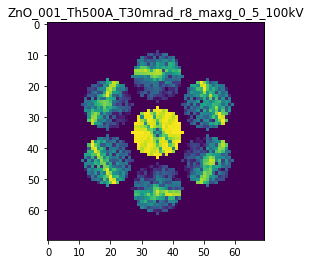

X_sim.max(): 0.9769364157320855
>>>replaced the 18. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 778ms/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 4s 798ms/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 958ms/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 861ms/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500


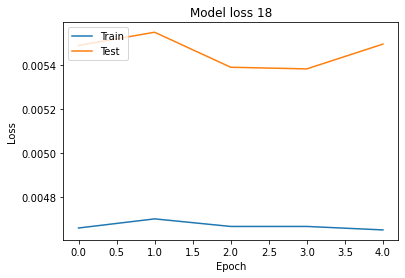

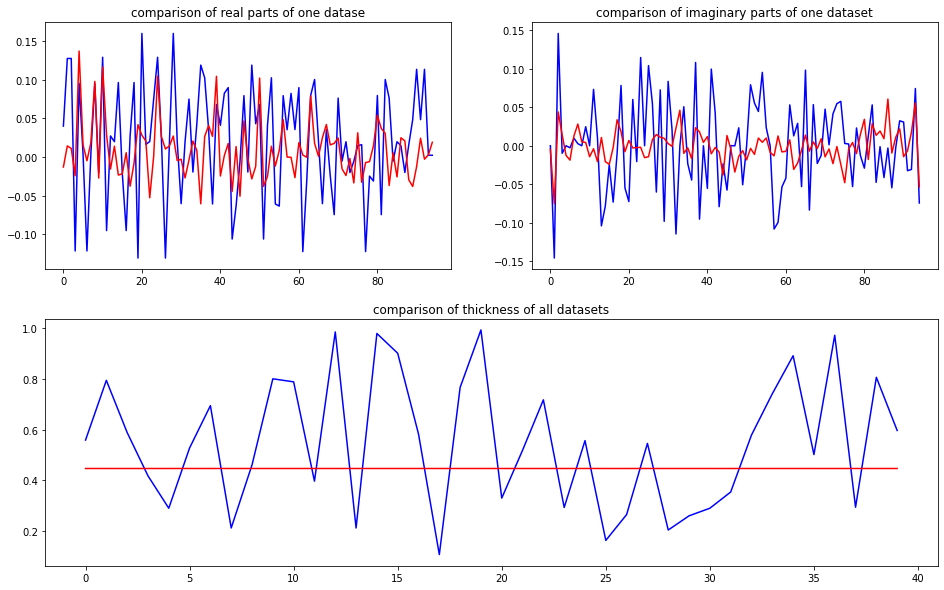

predicted thickness: 0.44689688


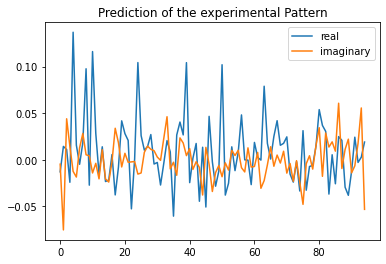

The offset applied on thickness: 0.0002212354366868492

The offset applied on Ug: 1.1844361946746498

Applied shift of unit cell origin (fractional coordinates): 0.005574906980513479 0.010117398570573548 -0.009125003318666903
Ug[ 0 ]: 0.01285 3.14159  =>  0.01285 3.14159
Ug[ 1 ]: 0.05989 -1.27772  =>  0.05989 -1.33505
Ug[ 2 ]: 0.05989 1.27772  =>  0.05989 1.33505
Ug[ 3 ]: 0.0141 3.06373  =>  0.0141 3.1273
Ug[ 4 ]: 0.13424 -0.00624  =>  0.13424 0.0
Ug[ 5 ]: 0.02982 -0.92263  =>  0.02982 -0.80173
Ug[ 6 ]: 0.0141 -3.06373  =>  0.0141 -3.1273
Ug[ 7 ]: 0.02982 0.92263  =>  0.02982 0.80173
Ug[ 8 ]: 0.13424 0.00624  =>  0.13424 -0.0
Ug[ 9 ]: 0.02741 2.60706  =>  0.02741 2.64209
Ug[ 10 ]: 0.12505 0.02231  =>  0.12505 0.0
Ug[ 11 ]: 0.01733 -0.01829  =>  0.01733 0.07408
Ug[ 12 ]: 0.03763 -2.29429  =>  0.03763 -2.32283
Ug[ 13 ]: 0.02389 0.53327  =>  0.02389 0.4474
Ug[ 14 ]: 0.02426 -2.23411  =>  0.02426 -2.20532
Ug[ 15 ]: 0.02741 -2.60706  =>  0.02741 -2.64209
Ug[ 16 ]: 0.01733 0.01829  =>  0.017

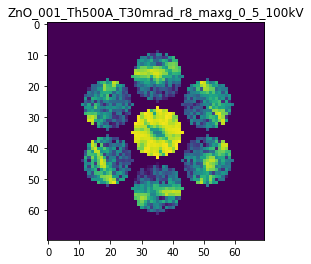

X_sim.max(): 0.9783608843139205
>>>replaced the 19. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 980ms/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 640ms/step - loss: 0.0046 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 653ms/step - loss: 0.0046 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 866ms/step - loss: 0.0046 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0046 - acc: 0.8400 - val_loss: 0.0053 - val_acc: 0.9500


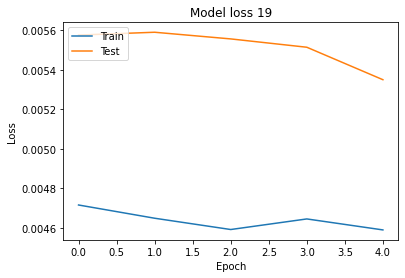

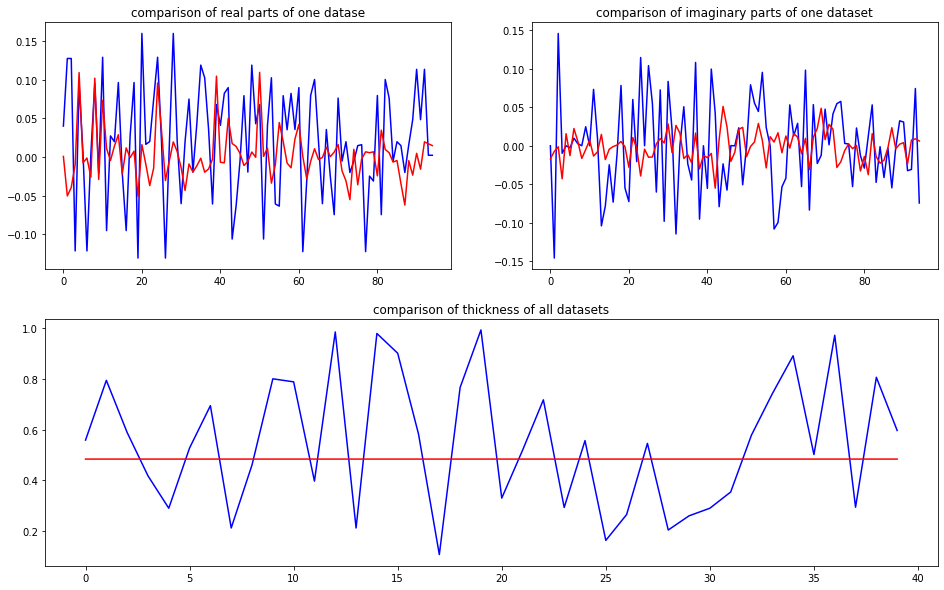

predicted thickness: 0.48405722


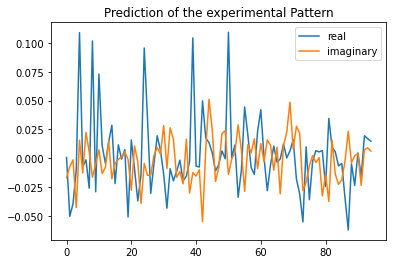

The offset applied on thickness: -0.0008521109670892874

The offset applied on Ug: 1.1803416520539671

Applied shift of unit cell origin (fractional coordinates): 0.00894755924286572 -0.009082682148685439 -0.013951391283475138
Ug[ 0 ]: 0.00092 0.0  =>  0.00092 0.0
Ug[ 1 ]: 0.04262 -3.08422  =>  0.04262 3.1113
Ug[ 2 ]: 0.04262 3.08422  =>  0.04262 -3.1113
Ug[ 3 ]: 0.03211 -1.70503  =>  0.03211 -1.7621
Ug[ 4 ]: 0.12023 0.14473  =>  0.12023 0.0
Ug[ 5 ]: 0.01884 -2.61596  =>  0.01884 -2.58537
Ug[ 6 ]: 0.03211 1.70503  =>  0.03211 1.7621
Ug[ 7 ]: 0.01884 2.61596  =>  0.01884 2.58537
Ug[ 8 ]: 0.12023 -0.14473  =>  0.12023 0.0
Ug[ 9 ]: 0.02479 -3.13936  =>  0.02479 -3.08314
Ug[ 10 ]: 0.09305 0.03144  =>  0.09305 0.0
Ug[ 11 ]: 0.013 -0.48632  =>  0.013 -0.34244
Ug[ 12 ]: 0.00513 -2.10969  =>  0.00513 -1.99641
Ug[ 13 ]: 0.02893 0.51278  =>  0.02893 0.53841
Ug[ 14 ]: 0.02183 -0.53409  =>  0.02183 -0.33314
Ug[ 15 ]: 0.02479 3.13936  =>  0.02479 3.08314
Ug[ 16 ]: 0.013 0.48632  =>  0.013 0.34244
U

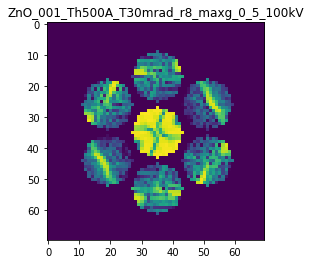

X_sim.max(): 0.9958008707048877
>>>replaced the 20. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 1s/step - loss: 0.0045 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 887ms/step - loss: 0.0047 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0046 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0046 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0046 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500


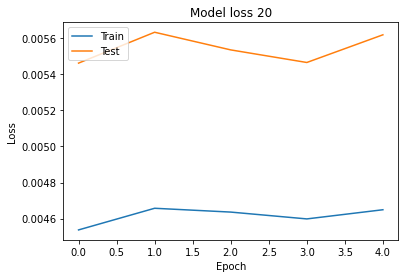

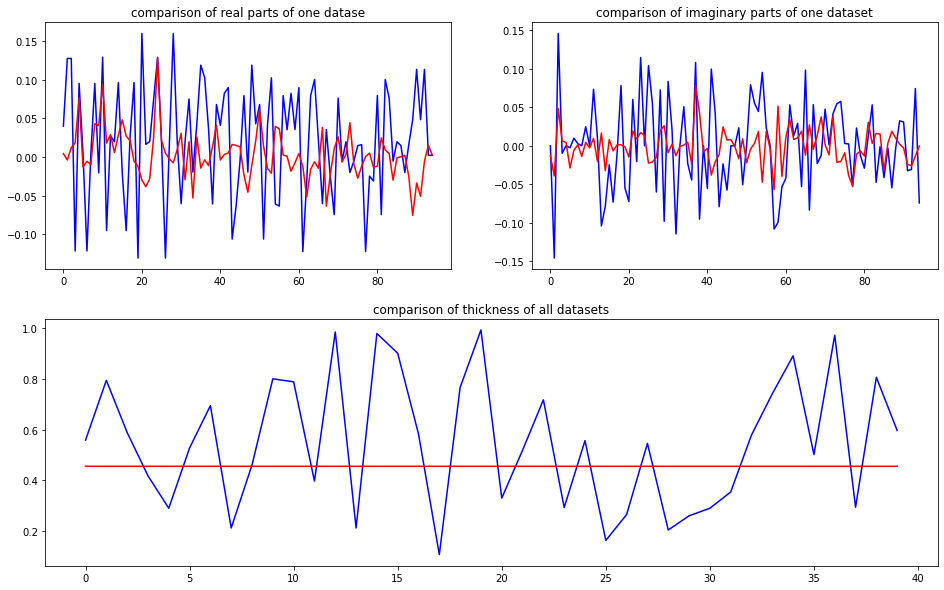

predicted thickness: 0.45572114


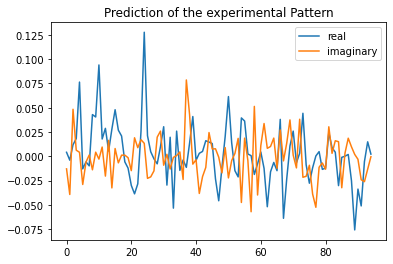

The offset applied on thickness: -0.0006692222725033685

The offset applied on Ug: -3.198562463988157

Applied shift of unit cell origin (fractional coordinates): 0.03446886151321806 0.0009750259499539455 -0.021469210010339718
Ug[ 0 ]: 0.00361 0.0  =>  0.00361 0.0
Ug[ 1 ]: 0.04271 -1.6279  =>  0.04271 -1.7628
Ug[ 2 ]: 0.04271 1.6279  =>  0.04271 1.7628
Ug[ 3 ]: 0.008 0.79505  =>  0.008 0.80117
Ug[ 4 ]: 0.04749 0.12877  =>  0.04749 0.0
Ug[ 5 ]: 0.02124 -2.23413  =>  0.02124 -2.09311
Ug[ 6 ]: 0.008 -0.79505  =>  0.008 -0.80117
Ug[ 7 ]: 0.02124 2.23413  =>  0.02124 2.09311
Ug[ 8 ]: 0.04749 -0.12877  =>  0.04749 0.0
Ug[ 9 ]: 0.03783 -0.03087  =>  0.03783 0.1857
Ug[ 10 ]: 0.07059 -0.08168  =>  0.07059 -0.0
Ug[ 11 ]: 0.02224 0.3956  =>  0.02224 0.74707
Ug[ 12 ]: 0.02512 -0.48904  =>  0.02512 -0.27859
Ug[ 13 ]: 0.0234 1.06324  =>  0.0234 1.13879
Ug[ 14 ]: 0.02094 -1.16942  =>  0.02094 -0.82408
Ug[ 15 ]: 0.03783 0.03087  =>  0.03783 -0.1857
Ug[ 16 ]: 0.02224 -0.3956  =>  0.02224 -0.74707
Ug[ 1

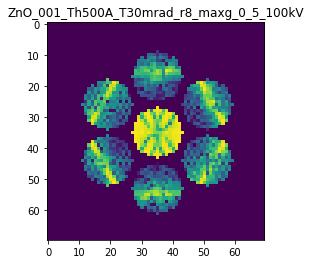

X_sim.max(): 0.9493550116775227
>>>replaced the 21. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0046 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 638ms/step - loss: 0.0046 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 665ms/step - loss: 0.0045 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 665ms/step - loss: 0.0045 - acc: 0.8400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 997ms/step - loss: 0.0045 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500


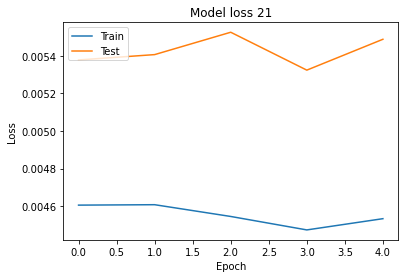

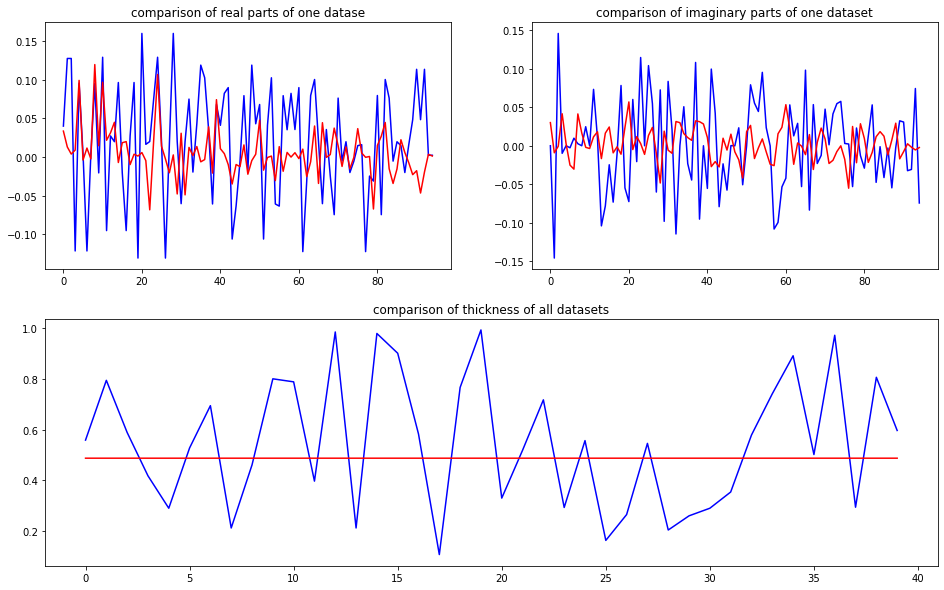

predicted thickness: 0.48757485


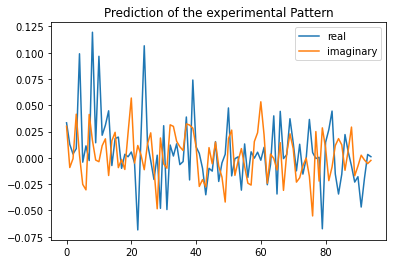

The offset applied on thickness: 0.00032044484349979553

The offset applied on Ug: 1.856987994135871

Applied shift of unit cell origin (fractional coordinates): 0.0020975078014065025 0.020118775790639983 -0.0028414682927973087
Ug[ 0 ]: 0.03713 0.0  =>  0.03713 0.0
Ug[ 1 ]: 0.00941 -0.43837  =>  0.00941 -0.45623
Ug[ 2 ]: 0.00941 0.43837  =>  0.00941 0.45623
Ug[ 3 ]: 0.03887 1.23548  =>  0.03887 1.36189
Ug[ 4 ]: 0.1327 -0.10856  =>  0.1327 0.0
Ug[ 5 ]: 0.03427 -1.6028  =>  0.03427 -1.45853
Ug[ 6 ]: 0.03887 -1.23548  =>  0.03887 -1.36189
Ug[ 7 ]: 0.03427 1.6028  =>  0.03427 1.45853
Ug[ 8 ]: 0.1327 0.10856  =>  0.1327 -0.0
Ug[ 9 ]: 0.02232 -0.67372  =>  0.02232 -0.66054
Ug[ 10 ]: 0.121 0.00467  =>  0.121 -0.0
Ug[ 11 ]: 0.02411 0.45273  =>  0.02411 0.48376
Ug[ 12 ]: 0.01622 0.74772  =>  0.01622 0.63449
Ug[ 13 ]: 0.03432 -0.386  =>  0.03432 -0.51708
Ug[ 14 ]: 0.01392 1.67706  =>  0.01392 1.58168
Ug[ 15 ]: 0.02232 0.67372  =>  0.02232 0.66054
Ug[ 16 ]: 0.02411 -0.45273  =>  0.02411 -0.48376


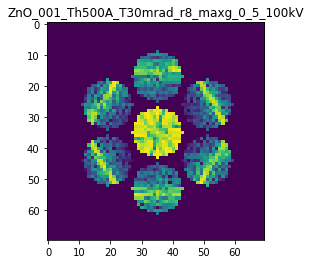

X_sim.max(): 0.9851930285075687
>>>replaced the 22. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 957ms/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 641ms/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0045 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0046 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500


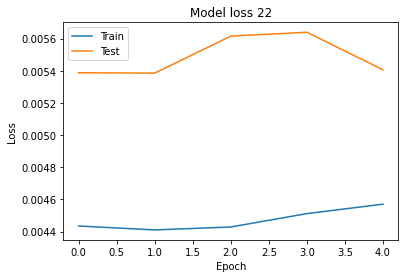

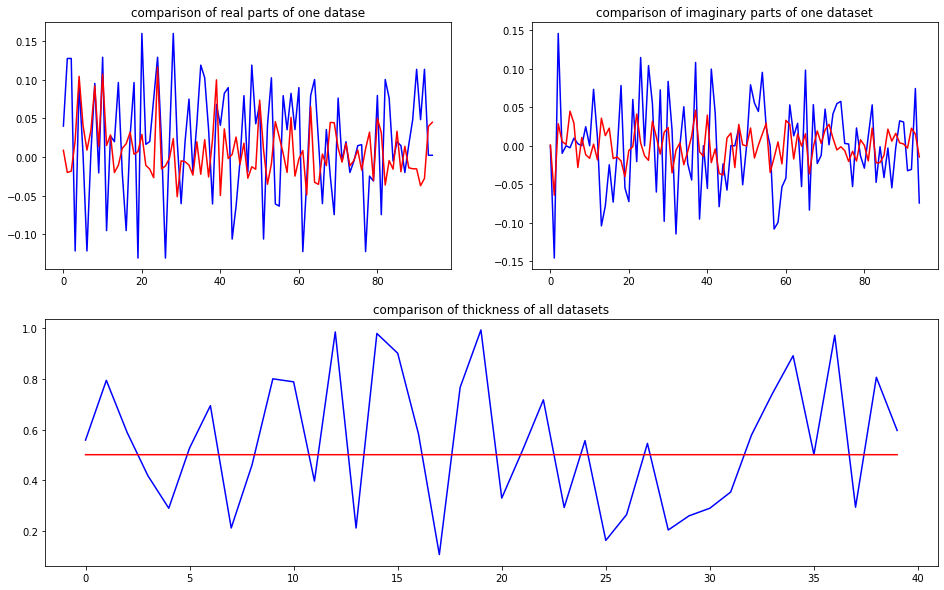

predicted thickness: 0.50139564


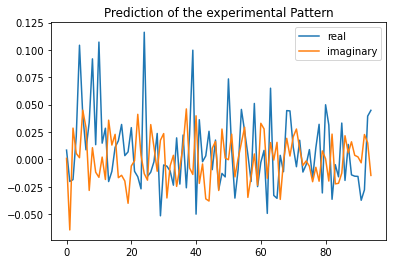

The offset applied on thickness: -0.000348156547471135

The offset applied on Ug: 1.147541305567585

Applied shift of unit cell origin (fractional coordinates): -0.002585632187491039 -0.0026530230245269786 0.006627621156495507
Ug[ 0 ]: 0.00858 0.0  =>  0.00858 0.0
Ug[ 1 ]: 0.0474 -1.91566  =>  0.0474 -1.87402
Ug[ 2 ]: 0.0474 1.91566  =>  0.0474 1.87402
Ug[ 3 ]: 0.01989 -0.65734  =>  0.01989 -0.67401
Ug[ 4 ]: 0.10921 -0.02497  =>  0.10921 0.0
Ug[ 5 ]: 0.05548 0.74846  =>  0.05548 0.69015
Ug[ 6 ]: 0.01989 0.65734  =>  0.01989 0.67401
Ug[ 7 ]: 0.05548 -0.74846  =>  0.05548 -0.69015
Ug[ 8 ]: 0.10921 0.02497  =>  0.10921 0.0
Ug[ 9 ]: 0.02166 -0.93842  =>  0.02166 -0.95467
Ug[ 10 ]: 0.12623 -0.0254  =>  0.12623 0.0
Ug[ 11 ]: 0.01879 0.51117  =>  0.01879 0.45328
Ug[ 12 ]: 0.03162 -0.06252  =>  0.03162 -0.0621
Ug[ 13 ]: 0.03251 2.10527  =>  0.03251 2.14733
Ug[ 14 ]: 0.01669 1.77051  =>  0.01669 1.72929
Ug[ 15 ]: 0.02166 0.93842  =>  0.02166 0.95467
Ug[ 16 ]: 0.01879 -0.51117  =>  0.01879 -0.45

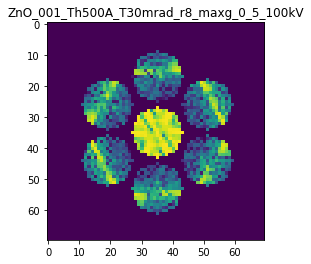

X_sim.max(): 0.9808071383581599
>>>replaced the 23. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 709ms/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 691ms/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500


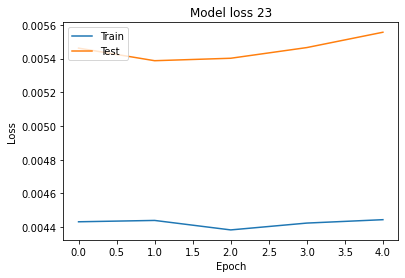

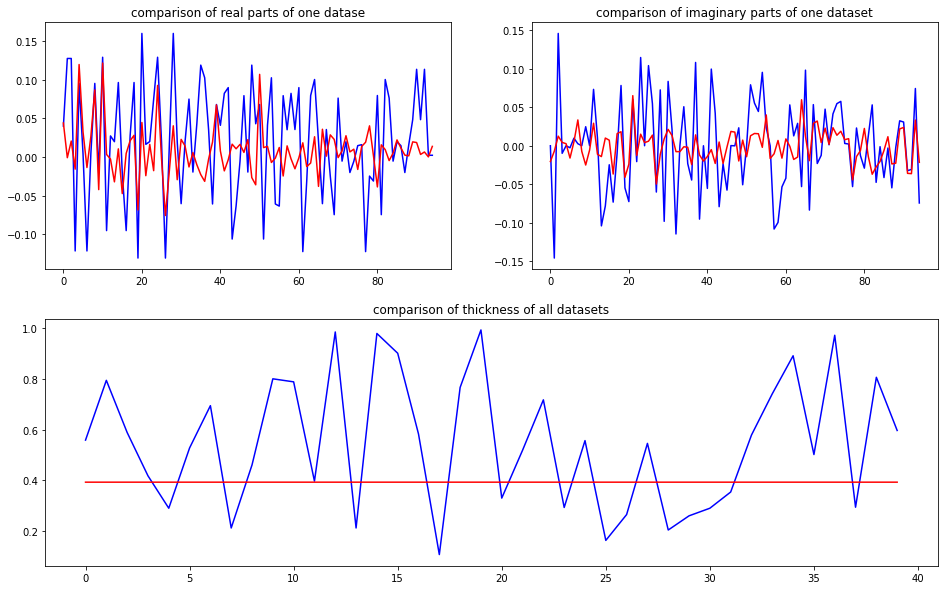

predicted thickness: 0.39288756


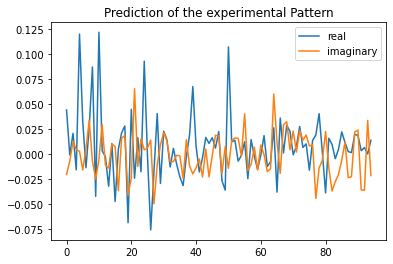

The offset applied on thickness: -0.00035110674891885484

The offset applied on Ug: -0.7114795789725283

Applied shift of unit cell origin (fractional coordinates): 0.006954074932416064 -0.008695630512725927 0.0035121769051879048
Ug[ 0 ]: 0.0422 0.0  =>  0.0422 0.0
Ug[ 1 ]: 0.01352 -0.7891  =>  0.01352 -0.76704
Ug[ 2 ]: 0.01352 0.7891  =>  0.01352 0.76704
Ug[ 3 ]: 0.01496 -3.11878  =>  0.01496 3.10977
Ug[ 4 ]: 0.09543 0.03257  =>  0.09543 -0.0
Ug[ 5 ]: 0.0375 -0.71465  =>  0.0375 -0.79135
Ug[ 6 ]: 0.01496 3.11878  =>  0.01496 -3.10977
Ug[ 7 ]: 0.0375 0.71465  =>  0.0375 0.79135
Ug[ 8 ]: 0.09543 -0.03257  =>  0.09543 0.0
Ug[ 9 ]: 0.0493 -2.80753  =>  0.0493 -2.76384
Ug[ 10 ]: 0.0989 -0.06576  =>  0.0989 0.0
Ug[ 11 ]: 0.03334 1.47803  =>  0.03334 1.49965
Ug[ 12 ]: 0.0159 -0.9851  =>  0.0159 -0.88677
Ug[ 13 ]: 0.02056 -2.60921  =>  0.02056 -2.48881
Ug[ 14 ]: 0.01909 -0.20048  =>  0.01909 -0.12422
Ug[ 15 ]: 0.0493 2.80753  =>  0.0493 2.76384
Ug[ 16 ]: 0.03334 -1.47803  =>  0.03334 -1.49965

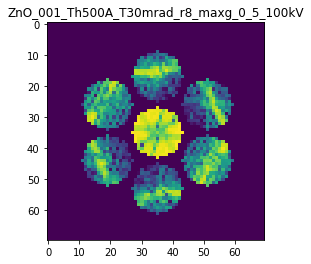

X_sim.max(): 0.9260125125964711
>>>replaced the 24. dataset and train: 
Epoch 1/5
5/5 [==============================] - 11s 2s/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0058 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 6s 1s/step - loss: 0.0045 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0045 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500


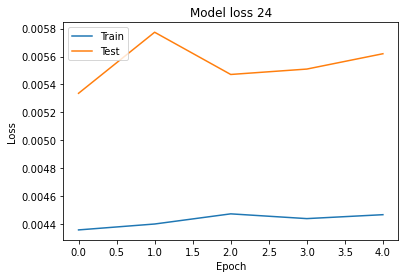

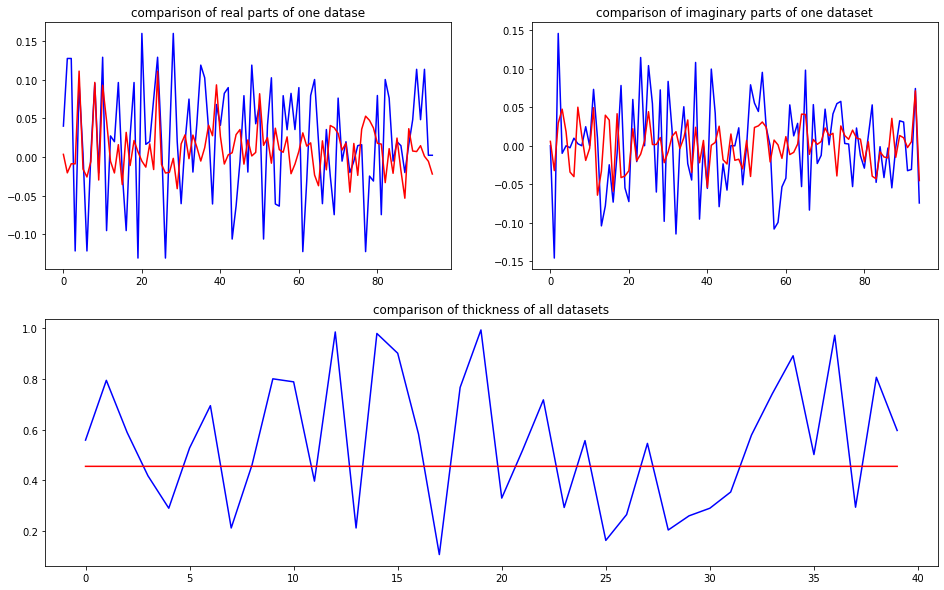

predicted thickness: 0.45538145


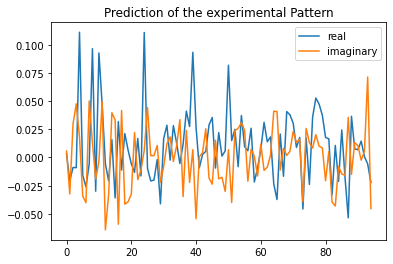

The offset applied on thickness: 0.0007827870319451094

The offset applied on Ug: -0.2643277009285424

Applied shift of unit cell origin (fractional coordinates): 0.00510102387175438 -0.005569701487705854 0.0021938842065871633
Ug[ 0 ]: 0.00327 0.0  =>  0.00327 0.0
Ug[ 1 ]: 0.0345 -2.02322  =>  0.0345 -2.00943
Ug[ 2 ]: 0.0345 2.02322  =>  0.0345 2.00943
Ug[ 3 ]: 0.04743 1.96279  =>  0.04743 1.92779
Ug[ 4 ]: 0.10083 0.02121  =>  0.10083 0.0
Ug[ 5 ]: 0.04349 -1.83347  =>  0.04349 -1.88225
Ug[ 6 ]: 0.04743 -1.96279  =>  0.04743 -1.92779
Ug[ 7 ]: 0.04349 1.83347  =>  0.04349 1.88225
Ug[ 8 ]: 0.10083 -0.02121  =>  0.10083 -0.0
Ug[ 9 ]: 0.04233 -2.47873  =>  0.04233 -2.44668
Ug[ 10 ]: 0.09908 -0.04584  =>  0.09908 0.0
Ug[ 11 ]: 0.06629 0.95983  =>  0.06629 0.9781
Ug[ 12 ]: 0.05401 -1.74199  =>  0.05401 -1.67495
Ug[ 13 ]: 0.04167 -1.95716  =>  0.04167 -1.87633
Ug[ 14 ]: 0.0444 1.15387  =>  0.0444 1.20713
Ug[ 15 ]: 0.04233 2.47873  =>  0.04233 2.44668
Ug[ 16 ]: 0.06629 -0.95983  =>  0.06629 -0.

Residual error after kinematic rocking curve fit: 0.04339803415109076



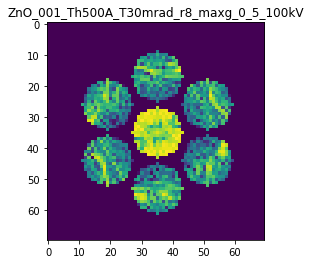

X_sim.max(): 0.9159756754322423
>>>replaced the 25. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 675ms/step - loss: 0.0043 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 665ms/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 938ms/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0045 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500


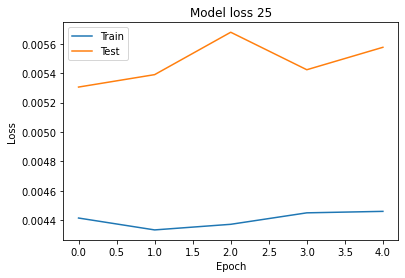

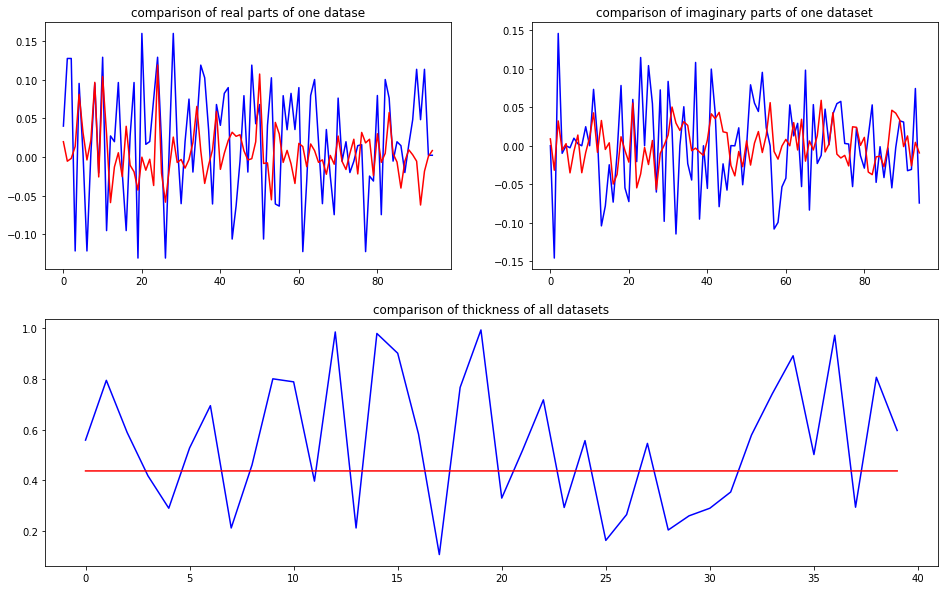

predicted thickness: 0.43726954


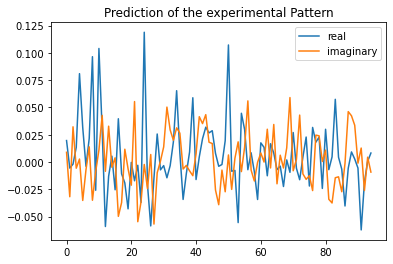

The offset applied on thickness: -5.577810258330662e-05

The offset applied on Ug: 0.14986300940425956

Applied shift of unit cell origin (fractional coordinates): 0.002248518351402559 -0.02127830825687692 -0.01110497929910553
Ug[ 0 ]: 0.01972 0.0  =>  0.01972 0.0
Ug[ 1 ]: 0.03225 -1.68297  =>  0.03225 -1.75274
Ug[ 2 ]: 0.03225 1.68297  =>  0.03225 1.75274
Ug[ 3 ]: 0.00486 0.15571  =>  0.00486 0.02202
Ug[ 4 ]: 0.09191 0.20347  =>  0.09191 -0.0
Ug[ 5 ]: 0.03623 -0.74105  =>  0.03623 -0.80498
Ug[ 6 ]: 0.00486 -0.15571  =>  0.00486 -0.02202
Ug[ 7 ]: 0.03623 0.74105  =>  0.03623 0.80498
Ug[ 8 ]: 0.09191 -0.20347  =>  0.09191 0.0
Ug[ 9 ]: 0.02634 -2.90109  =>  0.02634 -2.88696
Ug[ 10 ]: 0.11353 0.05565  =>  0.11353 0.0
Ug[ 11 ]: 0.05798 0.92131  =>  0.05798 1.00521
Ug[ 12 ]: 0.03749 2.74474  =>  0.03749 2.89256
Ug[ 13 ]: 0.03318 2.10117  =>  0.03318 2.17922
Ug[ 14 ]: 0.01079 -2.26581  =>  0.01079 -2.04821
Ug[ 15 ]: 0.02634 2.90109  =>  0.02634 2.88696
Ug[ 16 ]: 0.05798 -0.92131  =>  0.05798

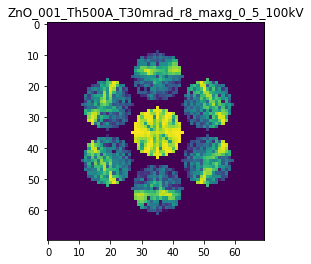

X_sim.max(): 0.9655675767927298
>>>replaced the 26. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 951ms/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 642ms/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 662ms/step - loss: 0.0043 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 956ms/step - loss: 0.0042 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0042 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500


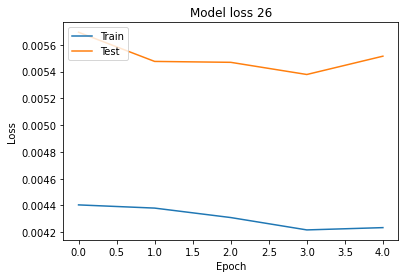

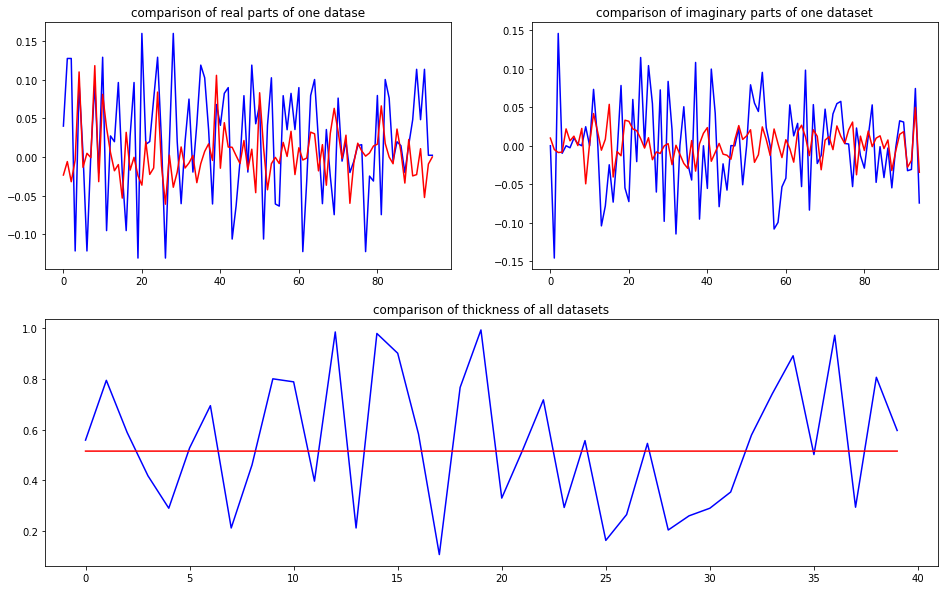

predicted thickness: 0.5155528


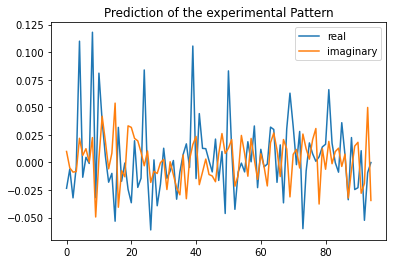

The offset applied on thickness: 0.00026074686063373356

The offset applied on Ug: -3.084598180586441

Applied shift of unit cell origin (fractional coordinates): -0.004643924661068964 0.0038220242455581734 -0.004336619346027753
Ug[ 0 ]: 0.02546 3.14159  =>  0.02546 3.14159
Ug[ 1 ]: 0.02126 2.95752  =>  0.02126 2.93027
Ug[ 2 ]: 0.02126 -2.95752  =>  0.02126 -2.93027
Ug[ 3 ]: 0.01024 -1.57849  =>  0.01024 -1.55448
Ug[ 4 ]: 0.07235 0.00323  =>  0.07235 -0.0
Ug[ 5 ]: 0.00798 2.79511  =>  0.00798 2.84637
Ug[ 6 ]: 0.01024 1.57849  =>  0.01024 1.55448
Ug[ 7 ]: 0.00798 -2.79511  =>  0.00798 -2.84637
Ug[ 8 ]: 0.07235 -0.00323  =>  0.07235 0.0
Ug[ 9 ]: 0.07314 -2.46166  =>  0.07314 -2.49084
Ug[ 10 ]: 0.06153 0.05643  =>  0.06153 0.0
Ug[ 11 ]: 0.04818 1.00806  =>  0.04818 1.00613
Ug[ 12 ]: 0.01501 2.05004  =>  0.01501 1.99685
Ug[ 13 ]: 0.01771 -2.6532  =>  0.01771 -2.73364
Ug[ 14 ]: 0.01213 2.06558  =>  0.01213 2.03963
Ug[ 15 ]: 0.07314 2.46166  =>  0.07314 2.49084
Ug[ 16 ]: 0.04818 -1.00806  =>

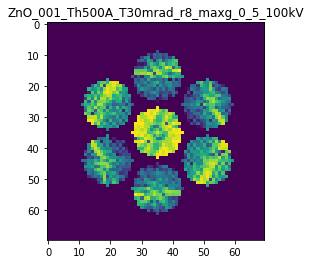

X_sim.max(): 0.9503601702023131
>>>replaced the 27. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 0.0042 - acc: 0.8400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 688ms/step - loss: 0.0043 - acc: 0.8400 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 667ms/step - loss: 0.0043 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 949ms/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0044 - acc: 0.8400 - val_loss: 0.0056 - val_acc: 0.9500


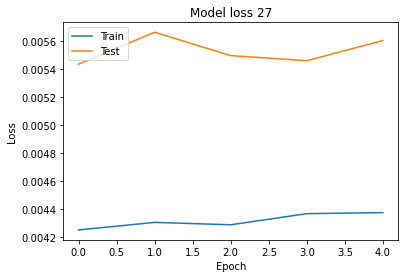

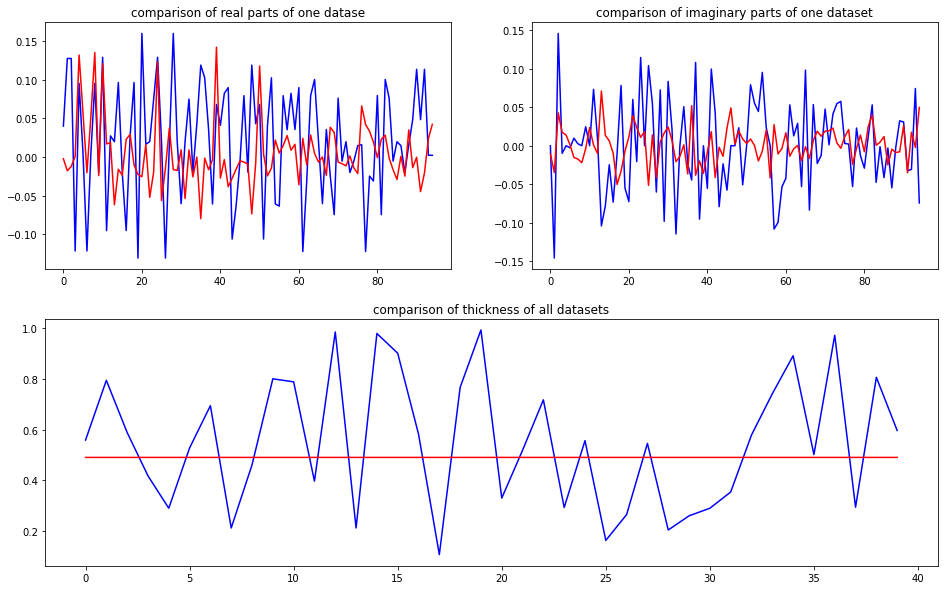

predicted thickness: 0.49068037


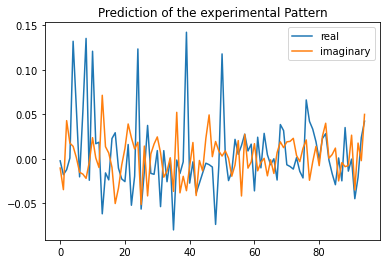

The offset applied on thickness: 0.0005861980825778455

The offset applied on Ug: -2.2180194498936245

Applied shift of unit cell origin (fractional coordinates): -0.006099199479285617 -0.03238946882791522 0.0013202495548185385
Ug[ 0 ]: 0.00265 3.14159  =>  0.00265 3.14159
Ug[ 1 ]: 0.04275 -2.03279  =>  0.04275 -2.0245
Ug[ 2 ]: 0.04275 2.03279  =>  0.04275 2.0245
Ug[ 3 ]: 0.02007 2.14392  =>  0.02007 1.94041
Ug[ 4 ]: 0.09502 0.19521  =>  0.09502 -0.0
Ug[ 5 ]: 0.04834 0.19102  =>  0.04834 -0.02078
Ug[ 6 ]: 0.02007 -2.14392  =>  0.02007 -1.94041
Ug[ 7 ]: 0.04834 -0.19102  =>  0.04834 0.02078
Ug[ 8 ]: 0.09502 -0.19521  =>  0.09502 0.0
Ug[ 9 ]: 0.02583 -2.94352  =>  0.02583 -2.98185
Ug[ 10 ]: 0.08801 0.03003  =>  0.08801 0.0
Ug[ 11 ]: 0.01958 0.28966  =>  0.01958 0.24304
Ug[ 12 ]: 0.03029 0.86722  =>  0.03029 1.0324
Ug[ 13 ]: 0.09445 2.49864  =>  0.09445 2.67212
Ug[ 14 ]: 0.02851 2.12738  =>  0.02851 2.28427
Ug[ 15 ]: 0.02583 2.94352  =>  0.02583 2.98185
Ug[ 16 ]: 0.01958 -0.28966  =>  0.0

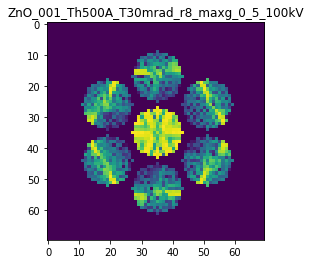

X_sim.max(): 0.9895477170813468
>>>replaced the 28. dataset and train: 
Epoch 1/5
5/5 [==============================] - 10s 1s/step - loss: 0.0043 - acc: 0.8500 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 971ms/step - loss: 0.0042 - acc: 0.8500 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0042 - acc: 0.8500 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0042 - acc: 0.8500 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0042 - acc: 0.8500 - val_loss: 0.0055 - val_acc: 0.9500


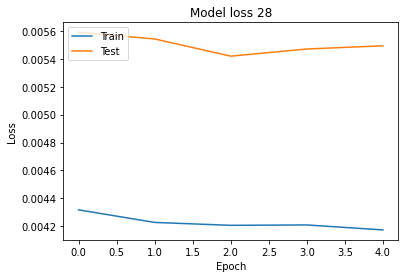

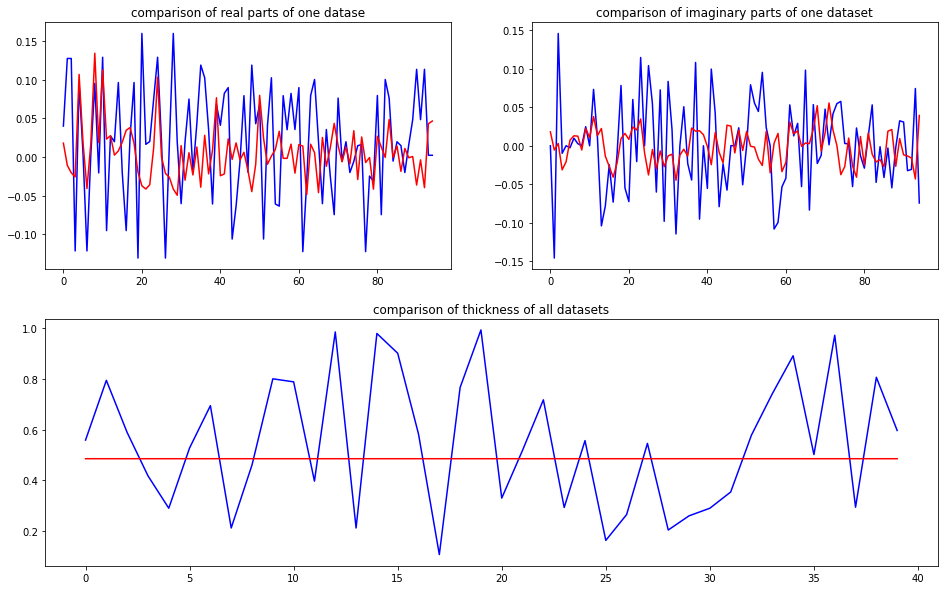

predicted thickness: 0.48550266


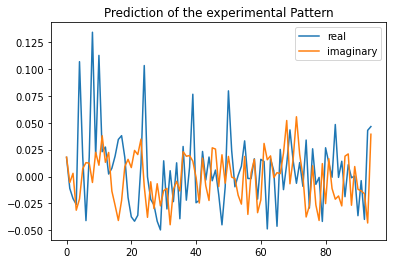

The offset applied on thickness: 0.00062560604253922

The offset applied on Ug: -0.3590445634557521

Applied shift of unit cell origin (fractional coordinates): -0.014138484911253227 0.009762623511347332 -0.0005091442898898974
Ug[ 0 ]: 0.01755 0.0  =>  0.01755 0.0
Ug[ 1 ]: 0.01644 -2.87869  =>  0.01644 -2.88189
Ug[ 2 ]: 0.01644 2.87869  =>  0.01644 2.88189
Ug[ 3 ]: 0.04058 -2.5665  =>  0.04058 -2.50516
Ug[ 4 ]: 0.11533 -0.05814  =>  0.11533 -0.0
Ug[ 5 ]: 0.0183 -0.1405  =>  0.0183 -0.07597
Ug[ 6 ]: 0.04058 2.5665  =>  0.04058 2.50516
Ug[ 7 ]: 0.0183 0.1405  =>  0.0183 0.07597
Ug[ 8 ]: 0.11533 0.05814  =>  0.11533 0.0
Ug[ 9 ]: 0.03081 0.93232  =>  0.03081 0.84348
Ug[ 10 ]: 0.10415 0.09203  =>  0.10415 0.0
Ug[ 11 ]: 0.04842 0.95585  =>  0.04842 0.87022
Ug[ 12 ]: 0.03686 0.50821  =>  0.03686 0.35803
Ug[ 13 ]: 0.03034 1.54834  =>  0.03034 1.39497
Ug[ 14 ]: 0.01699 -0.73649  =>  0.01699 -0.88347
Ug[ 15 ]: 0.03081 -0.93232  =>  0.03081 -0.84348
Ug[ 16 ]: 0.04842 -0.95585  =>  0.04842 -0.8702

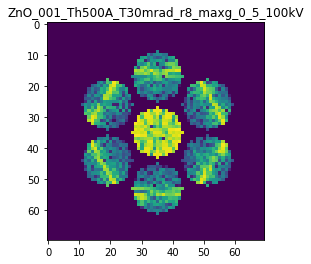

X_sim.max(): 0.960928223599789
>>>replaced the 29. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0042 - acc: 0.8600 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 760ms/step - loss: 0.0041 - acc: 0.8600 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0041 - acc: 0.8600 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0041 - acc: 0.8600 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0042 - acc: 0.8600 - val_loss: 0.0055 - val_acc: 0.9500


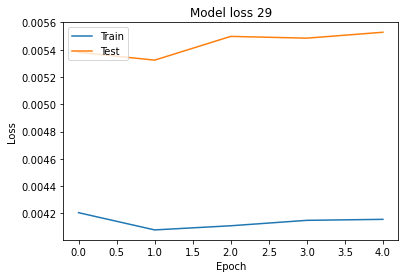

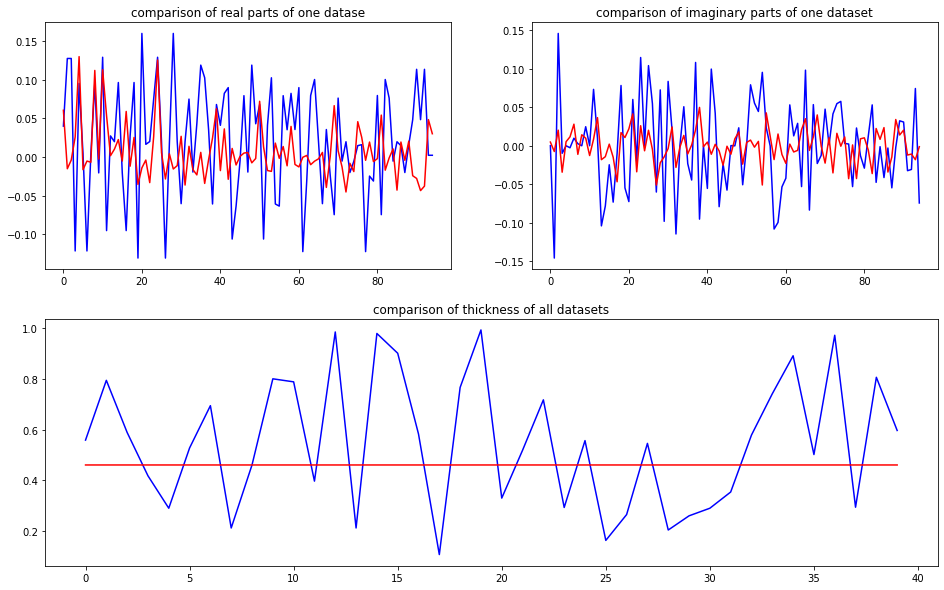

predicted thickness: 0.46080905


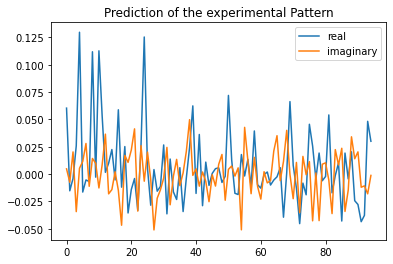

The offset applied on thickness: 0.0005697300504942337

The offset applied on Ug: 1.4649156691496692

Applied shift of unit cell origin (fractional coordinates): -0.0004521960205526702 -0.008206876631205548 0.007794281164402122
Ug[ 0 ]: 0.06571 0.0  =>  0.06571 0.0
Ug[ 1 ]: 0.01673 -2.15108  =>  0.01673 -2.1021
Ug[ 2 ]: 0.01673 2.15108  =>  0.01673 2.1021
Ug[ 3 ]: 0.03267 -1.18919  =>  0.03267 -1.24076
Ug[ 4 ]: 0.14256 0.00259  =>  0.14256 0.0
Ug[ 5 ]: 0.01611 2.34345  =>  0.01611 2.24291
Ug[ 6 ]: 0.03267 1.18919  =>  0.03267 1.24076
Ug[ 7 ]: 0.01611 -2.34345  =>  0.01611 -2.24291
Ug[ 8 ]: 0.14256 -0.00259  =>  0.14256 -0.0
Ug[ 9 ]: 0.0056 2.36293  =>  0.0056 2.36009
Ug[ 10 ]: 0.14028 -0.04613  =>  0.14028 -0.0
Ug[ 11 ]: 0.06177 0.17876  =>  0.06177 0.12695
Ug[ 12 ]: 0.04109 1.63224  =>  0.04109 1.68097
Ug[ 13 ]: 0.02086 -1.15953  =>  0.02086 -1.06183
Ug[ 14 ]: 0.02959 -0.56471  =>  0.02959 -0.56495
Ug[ 15 ]: 0.0056 -2.36293  =>  0.0056 -2.36009
Ug[ 16 ]: 0.06177 -0.17876  =>  0.06177 

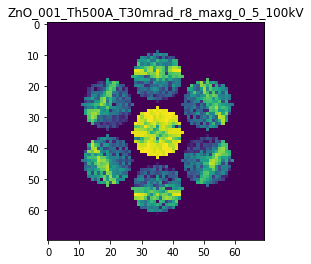

X_sim.max(): 0.9777693931952196
>>>replaced the 30. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 0.0041 - acc: 0.8600 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 618ms/step - loss: 0.0041 - acc: 0.8600 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 638ms/step - loss: 0.0041 - acc: 0.8600 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 638ms/step - loss: 0.0040 - acc: 0.8600 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 955ms/step - loss: 0.0041 - acc: 0.8600 - val_loss: 0.0055 - val_acc: 0.9500


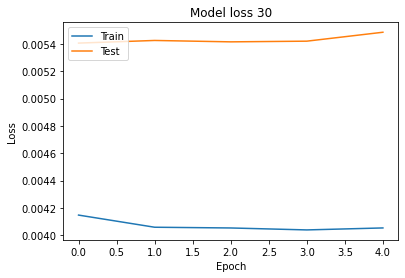

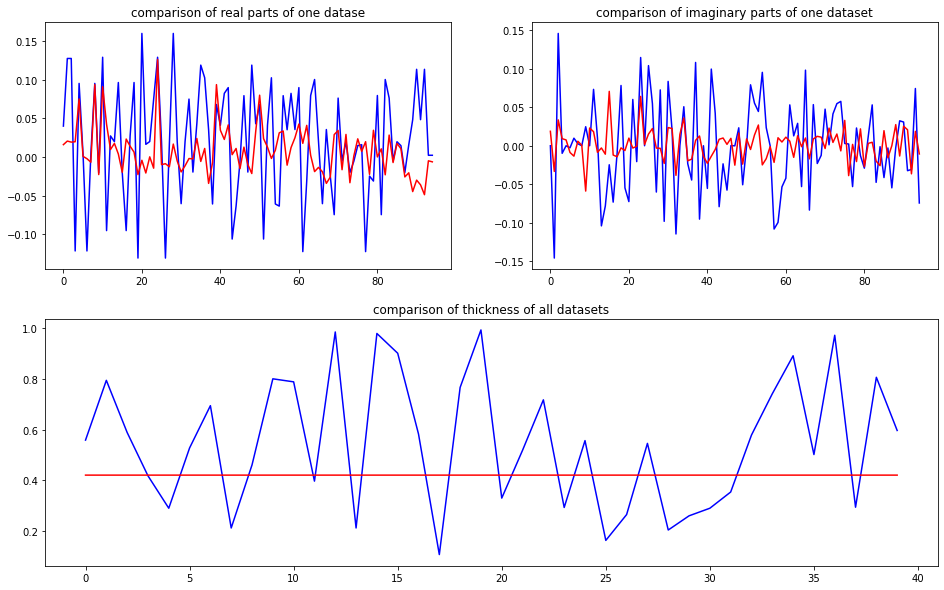

predicted thickness: 0.42071393


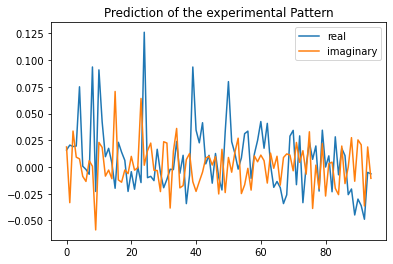

The offset applied on thickness: 0.0005167494363956357

The offset applied on Ug: 2.3642622588215865

Applied shift of unit cell origin (fractional coordinates): -0.003651586121884185 -0.0059991041793432285 0.010167565223375686
Ug[ 0 ]: 0.0173 0.0  =>  0.0173 0.0
Ug[ 1 ]: 0.04082 -0.96037  =>  0.04082 -0.89648
Ug[ 2 ]: 0.04082 0.96037  =>  0.04082 0.89648
Ug[ 3 ]: 0.01506 0.89496  =>  0.01506 0.85727
Ug[ 4 ]: 0.10143 -0.02619  =>  0.10143 0.0
Ug[ 5 ]: 0.00784 -1.94465  =>  0.00784 -2.04623
Ug[ 6 ]: 0.01506 -0.89496  =>  0.01506 -0.85727
Ug[ 7 ]: 0.00784 1.94465  =>  0.00784 2.04623
Ug[ 8 ]: 0.10143 0.02619  =>  0.10143 -0.0
Ug[ 9 ]: 0.06723 -1.72485  =>  0.06723 -1.74779
Ug[ 10 ]: 0.13779 -0.04094  =>  0.13779 0.0
Ug[ 11 ]: 0.03987 0.44928  =>  0.03987 0.36245
Ug[ 12 ]: 0.01268 0.20373  =>  0.01268 0.21848
Ug[ 13 ]: 0.01008 -1.10847  =>  0.01008 -1.02983
Ug[ 14 ]: 0.00653 -0.65743  =>  0.00653 -0.70657
Ug[ 15 ]: 0.06723 1.72485  =>  0.06723 1.74779
Ug[ 16 ]: 0.03987 -0.44928  =>  0.039

Residual error after kinematic rocking curve fit: 0.03771758382580265



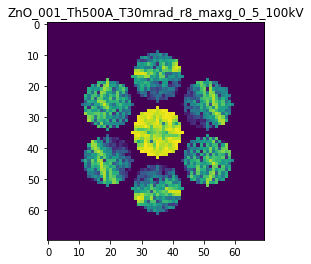

X_sim.max(): 0.9694530776785947
>>>replaced the 31. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 1s/step - loss: 0.0041 - acc: 0.8700 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0042 - acc: 0.8700 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0040 - acc: 0.8700 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 6s 1s/step - loss: 0.0040 - acc: 0.8700 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 6s 1s/step - loss: 0.0040 - acc: 0.8700 - val_loss: 0.0054 - val_acc: 0.9500


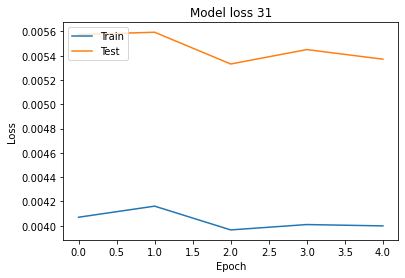

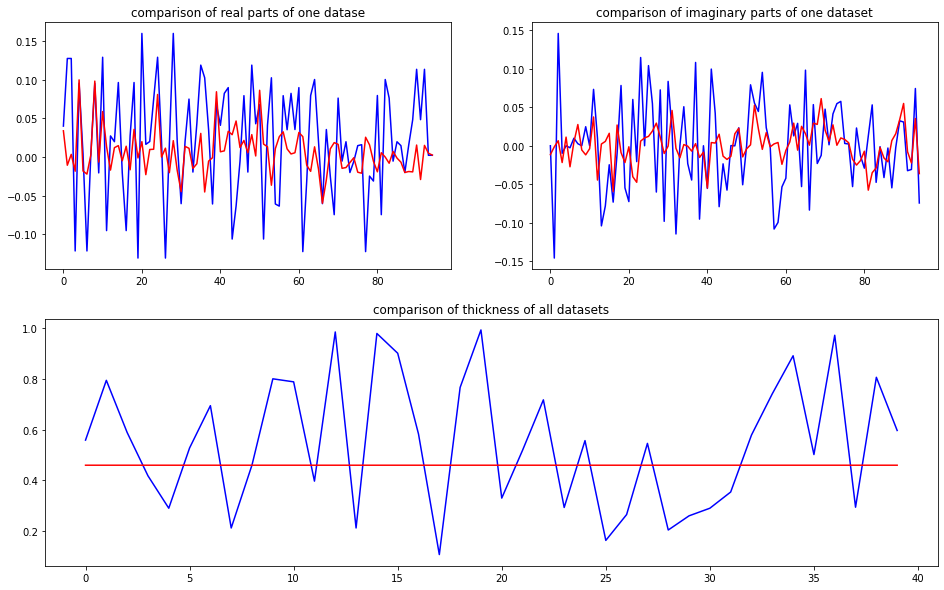

predicted thickness: 0.45984492


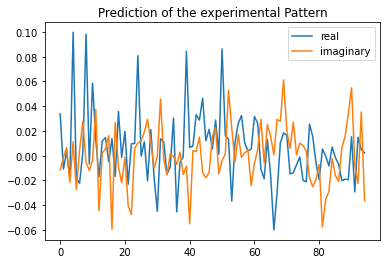

The offset applied on thickness: 0.000975043876054289

The offset applied on Ug: -2.6876104251931974

Applied shift of unit cell origin (fractional coordinates): 0.013292400769671442 -0.018286133205661966 0.0004815346392905306
Ug[ 0 ]: 0.03037 0.0  =>  0.03037 0.0
Ug[ 1 ]: 0.00569 -2.3465  =>  0.00569 -2.34347
Ug[ 2 ]: 0.00569 2.3465  =>  0.00569 2.34347
Ug[ 3 ]: 0.0261 -2.58788  =>  0.0261 -2.70278
Ug[ 4 ]: 0.07287 0.11187  =>  0.07287 -0.0
Ug[ 5 ]: 0.02985 -1.92022  =>  0.02985 -2.03814
Ug[ 6 ]: 0.0261 2.58788  =>  0.0261 2.70278
Ug[ 7 ]: 0.02985 1.92022  =>  0.02985 2.03814
Ug[ 8 ]: 0.07287 -0.11187  =>  0.07287 0.0
Ug[ 9 ]: 0.01529 -2.00704  =>  0.01529 -1.92352
Ug[ 10 ]: 0.05639 -0.08654  =>  0.05639 0.0
Ug[ 11 ]: 0.05165 1.44666  =>  0.05165 1.52716
Ug[ 12 ]: 0.04325 -2.08504  =>  0.04325 -1.88662
Ug[ 13 ]: 0.00738 -0.73858  =>  0.00738 -0.53714
Ug[ 14 ]: 0.02445 0.34988  =>  0.02445 0.54527
Ug[ 15 ]: 0.01529 2.00704  =>  0.01529 1.92352
Ug[ 16 ]: 0.05165 -1.44666  =>  0.05165 -1

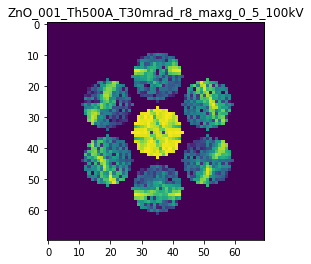

X_sim.max(): 0.9472548205066958
>>>replaced the 32. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 0.0040 - acc: 0.8700 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 630ms/step - loss: 0.0040 - acc: 0.8700 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 646ms/step - loss: 0.0040 - acc: 0.8700 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 991ms/step - loss: 0.0040 - acc: 0.8700 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0039 - acc: 0.8700 - val_loss: 0.0056 - val_acc: 0.9500


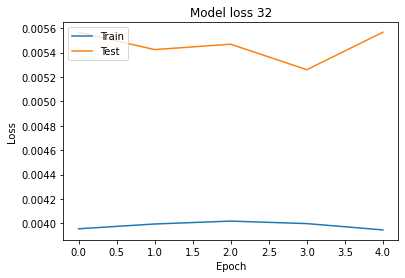

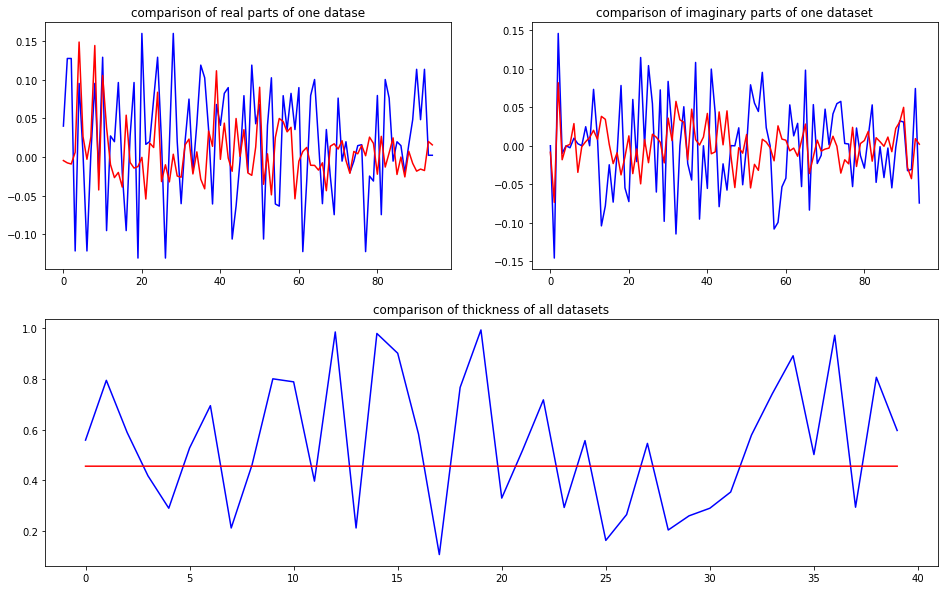

predicted thickness: 0.45600387


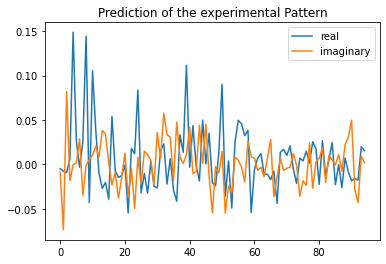

The offset applied on thickness: 0.0008090343290291909

The offset applied on Ug: -0.8926137751057922

Applied shift of unit cell origin (fractional coordinates): -0.0025240184443715476 -0.00280547805347387 0.002814442630245621
Ug[ 0 ]: 0.00482 3.14159  =>  0.00482 3.14159
Ug[ 1 ]: 0.07841 -1.74967  =>  0.07841 -1.73199
Ug[ 2 ]: 0.07841 1.74967  =>  0.07841 1.73199
Ug[ 3 ]: 0.02328 -1.53138  =>  0.02328 -1.549
Ug[ 4 ]: 0.12729 -6e-05  =>  0.12729 0.0
Ug[ 5 ]: 0.03105 0.64823  =>  0.03105 0.61292
Ug[ 6 ]: 0.02328 1.53138  =>  0.02328 1.549
Ug[ 7 ]: 0.03105 -0.64823  =>  0.03105 -0.61292
Ug[ 8 ]: 0.12729 6e-05  =>  0.12729 -0.0
Ug[ 9 ]: 0.04249 3.10334  =>  0.04249 3.08748
Ug[ 10 ]: 0.0864 -0.00182  =>  0.0864 0.0
Ug[ 11 ]: 0.04896 0.47128  =>  0.04896 0.43774
Ug[ 12 ]: 0.01231 2.35649  =>  0.01231 2.35826
Ug[ 13 ]: 0.04298 2.37656  =>  0.04298 2.39601
Ug[ 14 ]: 0.04069 2.04926  =>  0.04069 2.03335
Ug[ 15 ]: 0.04249 -3.10334  =>  0.04249 -3.08748
Ug[ 16 ]: 0.04896 -0.47128  =>  0.04896 -

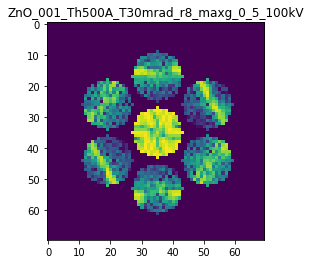

X_sim.max(): 0.9545190639458868
>>>replaced the 33. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 1s/step - loss: 0.0040 - acc: 0.8700 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 922ms/step - loss: 0.0040 - acc: 0.8700 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0039 - acc: 0.8700 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0039 - acc: 0.8700 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0039 - acc: 0.8700 - val_loss: 0.0055 - val_acc: 0.9500


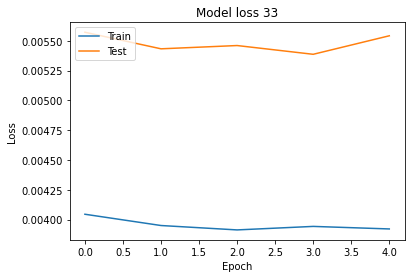

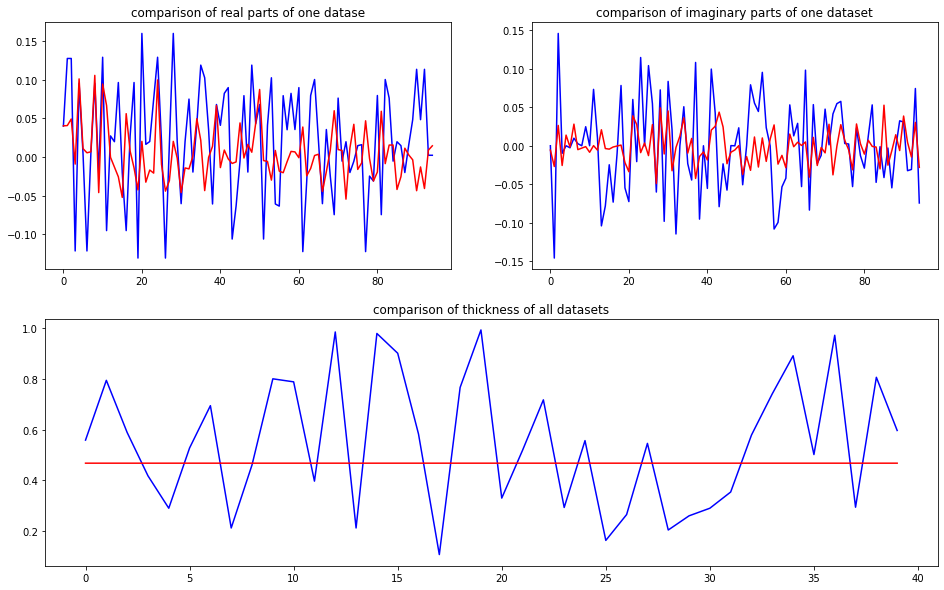

predicted thickness: 0.46787098


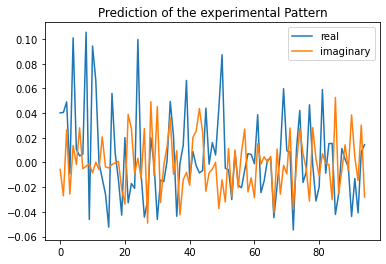

The offset applied on thickness: -0.0006718087156860282

The offset applied on Ug: -1.2726571912411595

Applied shift of unit cell origin (fractional coordinates): 0.018176762008750385 -0.007765849102886348 -0.007717101613712677
Ug[ 0 ]: 0.03811 0.0  =>  0.03811 0.0
Ug[ 1 ]: 0.049 -0.56698  =>  0.049 -0.61547
Ug[ 2 ]: 0.049 0.56698  =>  0.049 0.61547
Ug[ 3 ]: 0.027 -1.6817  =>  0.027 -1.7305
Ug[ 4 ]: 0.08997 0.09728  =>  0.08997 0.0
Ug[ 5 ]: 0.00872 0.19117  =>  0.00872 0.19086
Ug[ 6 ]: 0.027 1.6817  =>  0.027 1.7305
Ug[ 7 ]: 0.00872 -0.19117  =>  0.00872 -0.19086
Ug[ 8 ]: 0.08997 -0.09728  =>  0.08997 0.0
Ug[ 9 ]: 0.05246 3.10126  =>  0.05246 -3.06771
Ug[ 10 ]: 0.08513 -0.06572  =>  0.08513 0.0
Ug[ 11 ]: 0.05645 0.00419  =>  0.05645 0.16689
Ug[ 12 ]: 0.00436 -0.65152  =>  0.00436 -0.48852
Ug[ 13 ]: 0.02043 2.1979  =>  0.02043 2.31241
Ug[ 14 ]: 0.0207 -3.01672  =>  0.0207 -2.80523
Ug[ 15 ]: 0.05246 -3.10126  =>  0.05246 3.06771
Ug[ 16 ]: 0.05645 -0.00419  =>  0.05645 -0.16689
Ug[ 17 ]:

Residual error after kinematic rocking curve fit: 0.033878228785869255



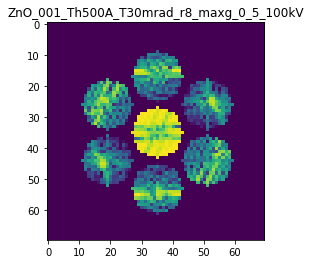

X_sim.max(): 0.9897884260558362
>>>replaced the 34. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0039 - acc: 0.8700 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 621ms/step - loss: 0.0039 - acc: 0.8700 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 671ms/step - loss: 0.0040 - acc: 0.8700 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0041 - acc: 0.8700 - val_loss: 0.0058 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0041 - acc: 0.8700 - val_loss: 0.0054 - val_acc: 0.9500


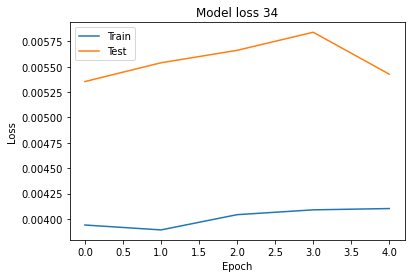

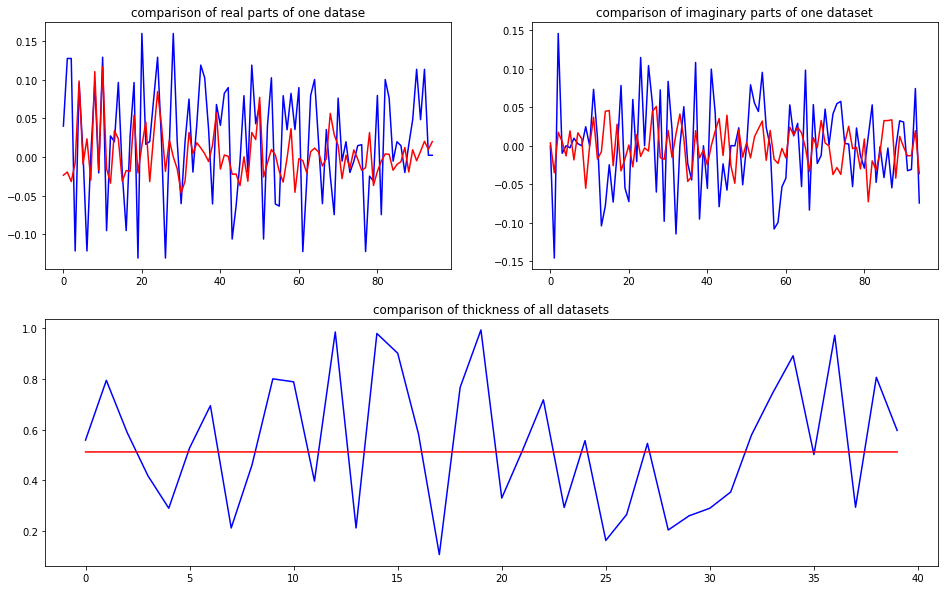

predicted thickness: 0.51229835


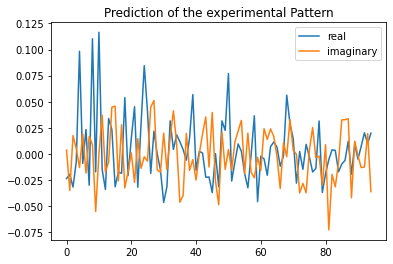

The offset applied on thickness: -0.0007877407223173197

The offset applied on Ug: 1.749817964704299

Applied shift of unit cell origin (fractional coordinates): -0.024574017178195448 0.007589852468231768 0.010907130082768357
Ug[ 0 ]: 0.02268 3.14159  =>  0.02268 3.14159
Ug[ 1 ]: 0.03483 -2.29807  =>  0.03483 -2.22954
Ug[ 2 ]: 0.03483 2.29807  =>  0.03483 2.22954
Ug[ 3 ]: 0.01412 0.905  =>  0.01412 0.95269
Ug[ 4 ]: 0.12448 -0.11622  =>  0.12448 0.0
Ug[ 5 ]: 0.01818 3.10291  =>  0.01818 3.08207
Ug[ 6 ]: 0.01412 -0.905  =>  0.01412 -0.95269
Ug[ 7 ]: 0.01818 -3.10291  =>  0.01818 -3.08207
Ug[ 8 ]: 0.12448 0.11622  =>  0.12448 -0.0
Ug[ 9 ]: 0.05353 -1.92889  =>  0.05353 -2.0833
Ug[ 10 ]: 0.11915 0.08587  =>  0.11915 0.0
Ug[ 11 ]: 0.03499 1.98454  =>  0.03499 1.76161
Ug[ 12 ]: 0.03293 -2.39051  =>  0.03293 -2.5926
Ug[ 13 ]: 0.03998 -0.02308  =>  0.03998 -0.15664
Ug[ 14 ]: 0.05775 0.69466  =>  0.05775 0.42404
Ug[ 15 ]: 0.05353 1.92889  =>  0.05353 2.0833
Ug[ 16 ]: 0.03499 -1.98454  =>  0.034

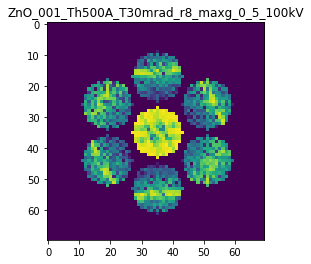

X_sim.max(): 0.9422764293270849
>>>replaced the 35. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 1s/step - loss: 0.0039 - acc: 0.8700 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 891ms/step - loss: 0.0039 - acc: 0.8700 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0039 - acc: 0.8700 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0039 - acc: 0.8700 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0040 - acc: 0.8700 - val_loss: 0.0055 - val_acc: 0.9500


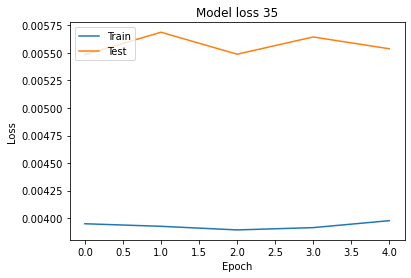

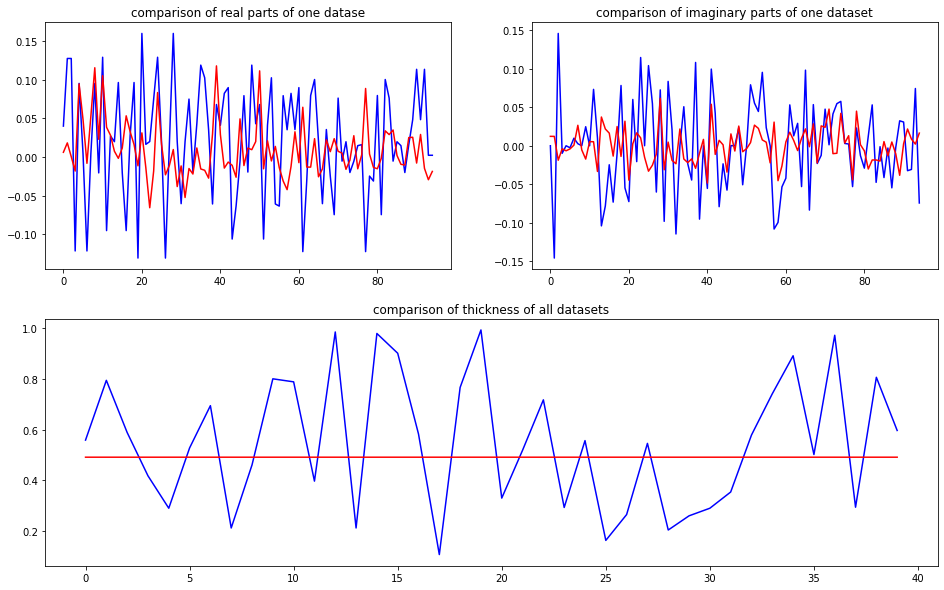

predicted thickness: 0.49150014


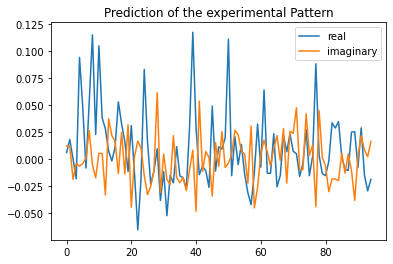

The offset applied on thickness: -7.337653900903863e-05

The offset applied on Ug: -3.2327673588678607

Applied shift of unit cell origin (fractional coordinates): -0.0031829448819908515 0.015507438144109183 -0.01771141921402434
Ug[ 0 ]: 0.00539 0.0  =>  0.00539 0.0
Ug[ 1 ]: 0.01729 1.09613  =>  0.01729 0.98485
Ug[ 2 ]: 0.01729 -1.09613  =>  0.01729 -0.98485
Ug[ 3 ]: 0.01429 -2.93584  =>  0.01429 -2.8384
Ug[ 4 ]: 0.06887 0.01385  =>  0.06887 0.0
Ug[ 5 ]: 0.04351 -0.33145  =>  0.04351 -0.12273
Ug[ 6 ]: 0.01429 2.93584  =>  0.01429 2.8384
Ug[ 7 ]: 0.04351 0.33145  =>  0.04351 0.12273
Ug[ 8 ]: 0.06887 -0.01385  =>  0.06887 -0.0
Ug[ 9 ]: 0.02307 -0.85425  =>  0.02307 -0.87425
Ug[ 10 ]: 0.06528 0.13128  =>  0.06528 -0.0
Ug[ 11 ]: 0.03996 0.27361  =>  0.03996 0.36489
Ug[ 12 ]: 0.03844 -0.87658  =>  0.03844 -0.99402
Ug[ 13 ]: 0.03571 1.36299  =>  0.03571 1.13427
Ug[ 14 ]: 0.01858 1.2644  =>  0.01858 1.25825
Ug[ 15 ]: 0.02307 0.85425  =>  0.02307 0.87425
Ug[ 16 ]: 0.03996 -0.27361  =>  0.03996

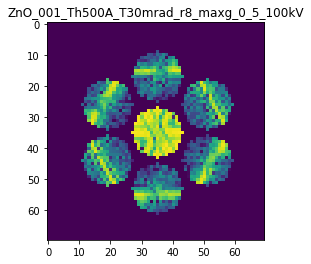

X_sim.max(): 0.9743416231365895
>>>replaced the 36. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0039 - acc: 0.8700 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 944ms/step - loss: 0.0039 - acc: 0.8700 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0038 - acc: 0.8700 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0038 - acc: 0.8700 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 889ms/step - loss: 0.0038 - acc: 0.8700 - val_loss: 0.0055 - val_acc: 0.9500


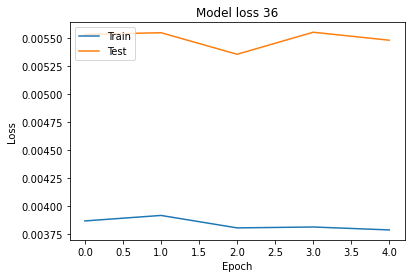

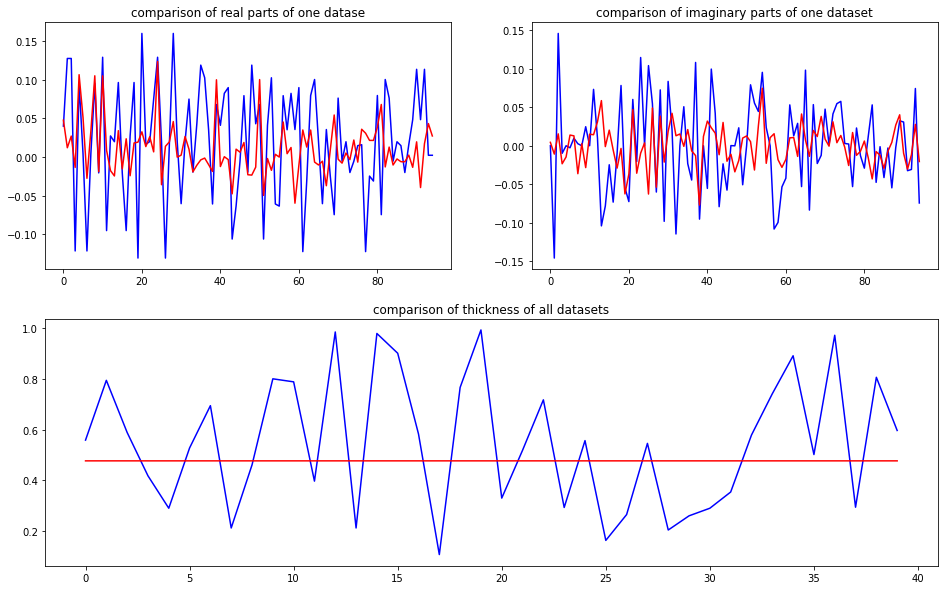

predicted thickness: 0.47703665


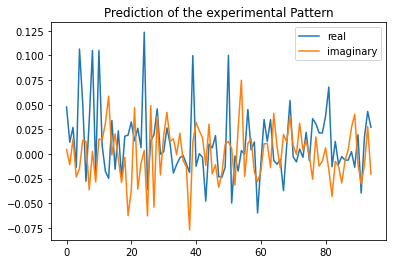

The offset applied on thickness: -0.00020735283711654584

The offset applied on Ug: -1.9188829927205058

Applied shift of unit cell origin (fractional coordinates): -0.015233851688030126 0.014638948875519956 0.002117500946854194
Ug[ 0 ]: 0.04319 0.0  =>  0.04319 0.0
Ug[ 1 ]: 0.02213 -0.6028  =>  0.02213 -0.5895
Ug[ 2 ]: 0.02213 0.6028  =>  0.02213 0.5895
Ug[ 3 ]: 0.02857 -2.46462  =>  0.02857 -2.37264
Ug[ 4 ]: 0.08452 -0.10528  =>  0.08452 0.0
Ug[ 5 ]: 0.04476 0.5919  =>  0.04476 0.67057
Ug[ 6 ]: 0.02857 2.46462  =>  0.02857 2.37264
Ug[ 7 ]: 0.04476 -0.5919  =>  0.04476 -0.67057
Ug[ 8 ]: 0.08452 0.10528  =>  0.08452 -0.0
Ug[ 9 ]: 0.03134 -2.22427  =>  0.03134 -2.31998
Ug[ 10 ]: 0.08908 0.08241  =>  0.08908 -0.0
Ug[ 11 ]: 0.01825 0.59049  =>  0.01825 0.48146
Ug[ 12 ]: 0.03839 2.2344  =>  0.03839 2.04671
Ug[ 13 ]: 0.07355 2.13337  =>  0.07355 1.95898
Ug[ 14 ]: 0.02458 0.02145  =>  0.02458 -0.17955
Ug[ 15 ]: 0.03134 2.22427  =>  0.03134 2.31998
Ug[ 16 ]: 0.01825 -0.59049  =>  0.01825 -0.4

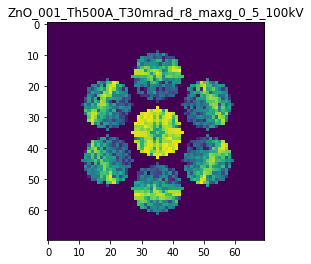

X_sim.max(): 0.9977626702539442
>>>replaced the 37. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0038 - acc: 0.8800 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 693ms/step - loss: 0.0037 - acc: 0.8800 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 4s 872ms/step - loss: 0.0037 - acc: 0.8800 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0036 - acc: 0.8800 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0037 - acc: 0.8800 - val_loss: 0.0054 - val_acc: 0.9500


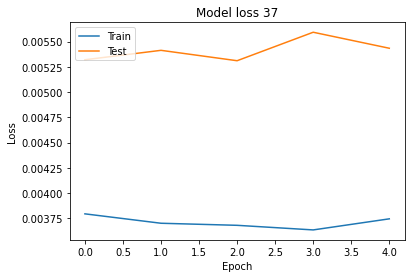

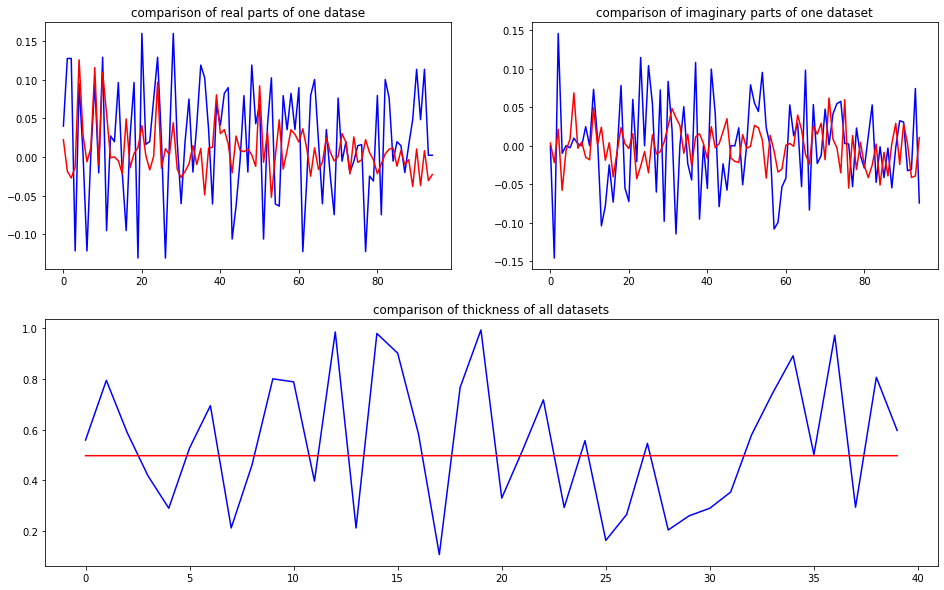

predicted thickness: 0.4974464


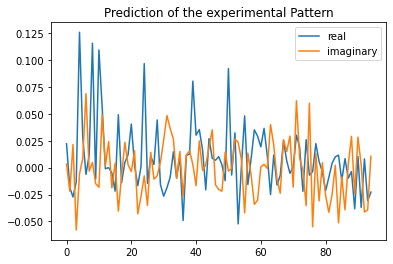

The offset applied on thickness: -0.00019118373792099443

The offset applied on Ug: -1.254610996995928

Applied shift of unit cell origin (fractional coordinates): 0.004986504019378166 0.0032036488462891064 0.006561170078716118
Ug[ 0 ]: 0.02152 0.0  =>  0.02152 0.0
Ug[ 1 ]: 0.03232 -2.41639  =>  0.03232 -2.37516
Ug[ 2 ]: 0.03232 2.41639  =>  0.03232 2.37516
Ug[ 3 ]: 0.06426 -1.8036  =>  0.06426 -1.78347
Ug[ 4 ]: 0.10248 -0.06135  =>  0.10248 0.0
Ug[ 5 ]: 0.02023 0.27252  =>  0.02023 0.25142
Ug[ 6 ]: 0.06426 1.8036  =>  0.06426 1.78347
Ug[ 7 ]: 0.02023 -0.27252  =>  0.02023 -0.25142
Ug[ 8 ]: 0.10248 0.06135  =>  0.10248 0.0
Ug[ 9 ]: 0.01919 -2.63206  =>  0.01919 -2.60073
Ug[ 10 ]: 0.08957 -0.07256  =>  0.08957 0.0
Ug[ 11 ]: 0.06416 0.75707  =>  0.06416 0.74718
Ug[ 12 ]: 0.00913 2.57984  =>  0.00913 2.59104
Ug[ 13 ]: 0.03142 1.84861  =>  0.03142 1.90104
Ug[ 14 ]: 0.02106 -1.60705  =>  0.02106 -1.63707
Ug[ 15 ]: 0.01919 2.63206  =>  0.01919 2.60073
Ug[ 16 ]: 0.06416 -0.75707  =>  0.06416 

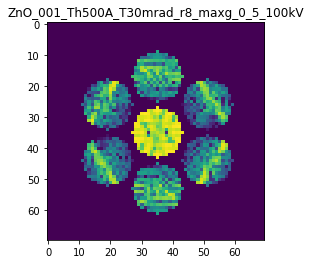

X_sim.max(): 0.9443622927628698
>>>replaced the 38. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 1s/step - loss: 0.0037 - acc: 0.8800 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 888ms/step - loss: 0.0038 - acc: 0.8800 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0039 - acc: 0.8800 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0038 - acc: 0.8800 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 3s 634ms/step - loss: 0.0038 - acc: 0.8800 - val_loss: 0.0058 - val_acc: 0.9500


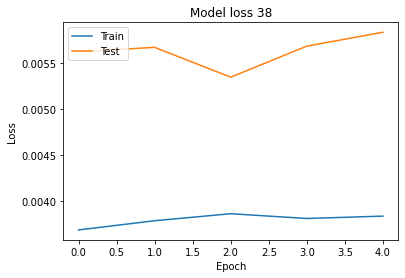

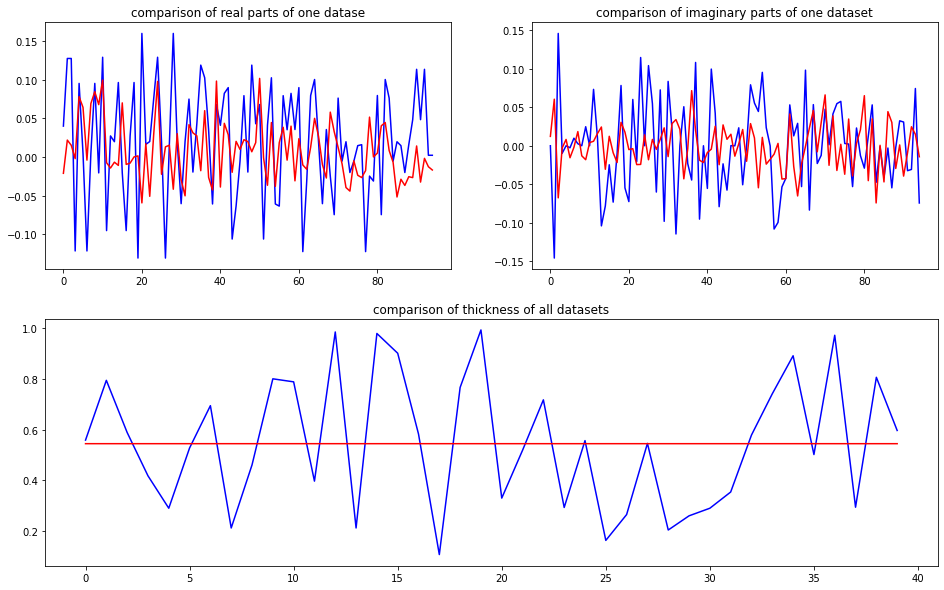

predicted thickness: 0.5448423


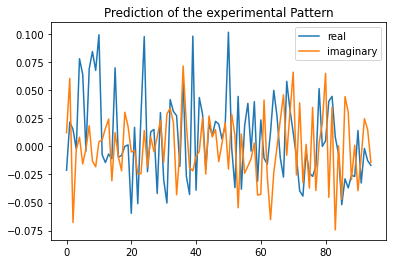

The offset applied on thickness: 0.0009000445333524167

The offset applied on Ug: 2.4606857967006013

Applied shift of unit cell origin (fractional coordinates): 0.008318722402603639 -0.0111870532418474 -0.0023118350319784944
Ug[ 0 ]: 0.01976 3.14159  =>  0.01976 3.14159
Ug[ 1 ]: 0.06984 1.13588  =>  0.06984 1.12136
Ug[ 2 ]: 0.06984 -1.13588  =>  0.06984 -1.12136
Ug[ 3 ]: 0.00319 -2.99848  =>  0.00319 -3.06877
Ug[ 4 ]: 0.0981 0.08482  =>  0.0981 0.0
Ug[ 5 ]: 0.08034 -0.23155  =>  0.08034 -0.28731
Ug[ 6 ]: 0.00319 2.99848  =>  0.00319 3.06877
Ug[ 7 ]: 0.08034 0.23155  =>  0.08034 0.28731
Ug[ 8 ]: 0.0981 -0.08482  =>  0.0981 0.0
Ug[ 9 ]: 0.08251 -0.1891  =>  0.08251 -0.13683
Ug[ 10 ]: 0.12284 -0.03774  =>  0.12284 0.0
Ug[ 11 ]: 0.01108 2.41101  =>  0.01108 2.47781
Ug[ 12 ]: 0.02119 2.06113  =>  0.02119 2.18369
Ug[ 13 ]: 0.02473 2.11721  =>  0.02473 2.22525
Ug[ 14 ]: 0.03056 -1.6709  =>  0.03056 -1.53382
Ug[ 15 ]: 0.08251 0.1891  =>  0.08251 0.13683
Ug[ 16 ]: 0.01108 -2.41101  =>  0.01108

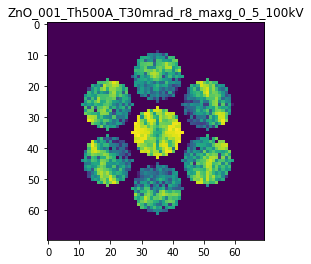

X_sim.max(): 0.9064988018669843
>>>replaced the 39. dataset and train: 
Epoch 1/5
5/5 [==============================] - 6s 927ms/step - loss: 0.0038 - acc: 0.8800 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 677ms/step - loss: 0.0037 - acc: 0.8800 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 4s 757ms/step - loss: 0.0036 - acc: 0.8800 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 935ms/step - loss: 0.0037 - acc: 0.8800 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 999ms/step - loss: 0.0036 - acc: 0.8800 - val_loss: 0.0056 - val_acc: 0.9500


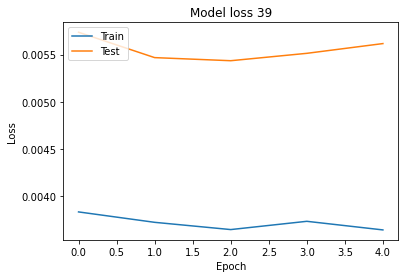

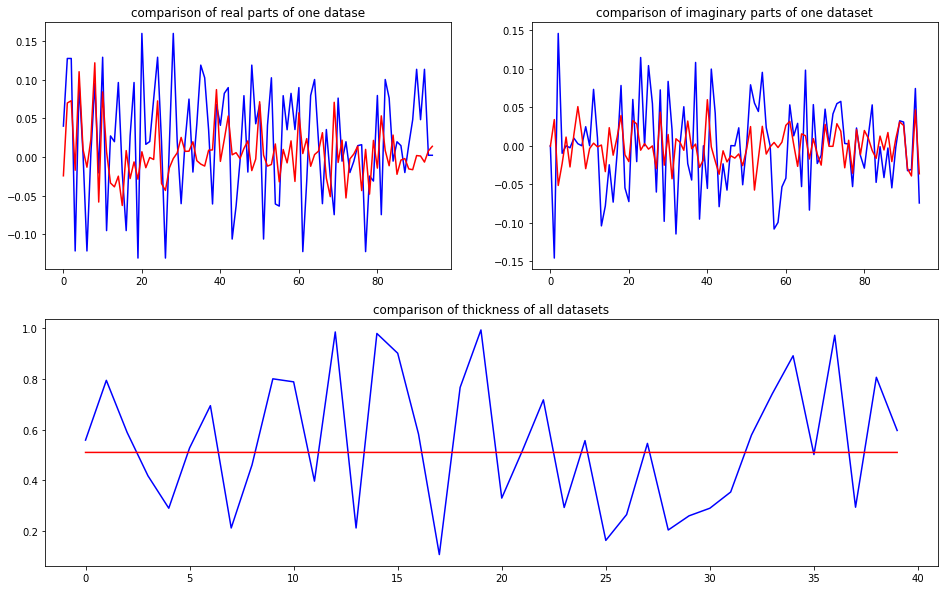

predicted thickness: 0.51035565


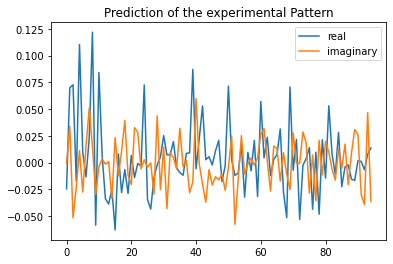

The offset applied on thickness: 6.980308296103965e-06

The offset applied on Ug: 2.6366951436667074

Applied shift of unit cell origin (fractional coordinates): -0.006225608978291474 0.005319439273743341 0.004627469624878389
Ug[ 0 ]: 0.02287 3.14159  =>  0.02287 3.14159
Ug[ 1 ]: 0.09777 0.40952  =>  0.09777 0.4386
Ug[ 2 ]: 0.09777 -0.40952  =>  0.09777 -0.4386
Ug[ 3 ]: 0.02304 -2.20542  =>  0.02304 -2.17199
Ug[ 4 ]: 0.15236 -0.0625  =>  0.15236 0.0
Ug[ 5 ]: 0.04772 -1.10591  =>  0.04772 -1.10156
Ug[ 6 ]: 0.02304 2.20542  =>  0.02304 2.17199
Ug[ 7 ]: 0.04772 1.10591  =>  0.04772 1.10156
Ug[ 8 ]: 0.15236 0.0625  =>  0.15236 0.0
Ug[ 9 ]: 0.05583 -2.64365  =>  0.05583 -2.68277
Ug[ 10 ]: 0.09463 0.01004  =>  0.09463 -0.0
Ug[ 11 ]: 0.01076 0.78231  =>  0.01076 0.71412
Ug[ 12 ]: 0.02879 -2.93585  =>  0.02879 -3.00839
Ug[ 13 ]: 0.0332 3.05342  =>  0.0332 3.00996
Ug[ 14 ]: 0.03821 -1.87135  =>  0.03821 -1.97297
Ug[ 15 ]: 0.05583 2.64365  =>  0.05583 2.68277
Ug[ 16 ]: 0.01076 -0.78231  =>  0.01

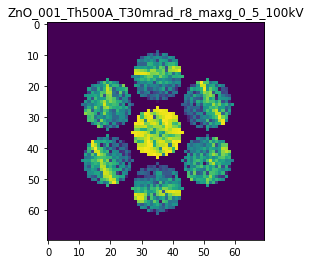

X_sim.max(): 0.9414075235567468
>>>replaced the 40. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 967ms/step - loss: 0.0037 - acc: 0.8800 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 762ms/step - loss: 0.0037 - acc: 0.8800 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 4s 815ms/step - loss: 0.0037 - acc: 0.8800 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 977ms/step - loss: 0.0037 - acc: 0.8800 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0036 - acc: 0.8800 - val_loss: 0.0055 - val_acc: 0.9500


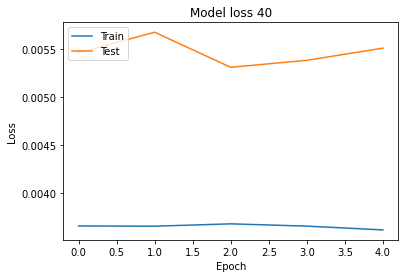

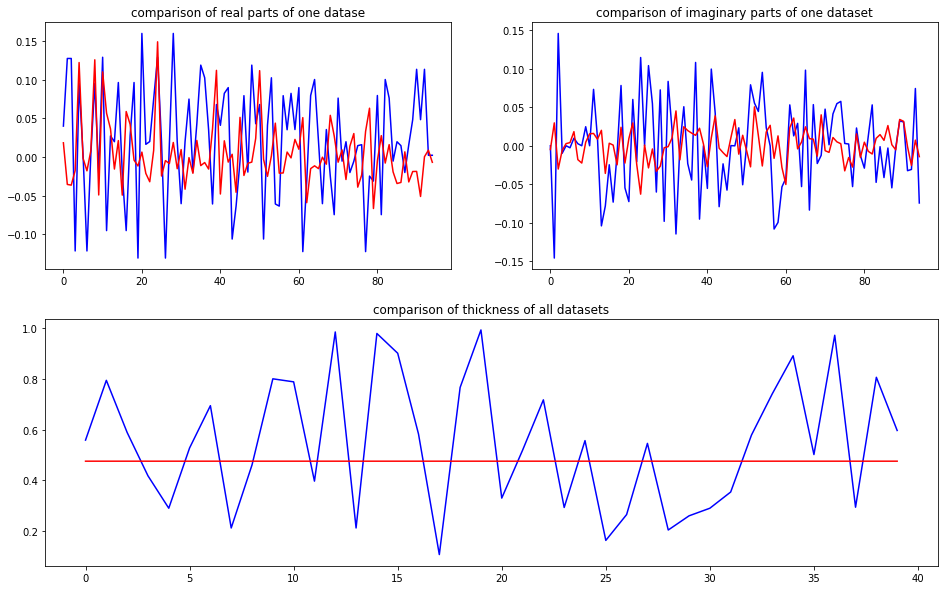

predicted thickness: 0.47575927


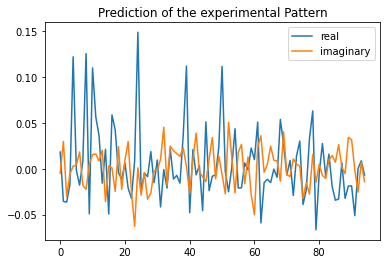

The offset applied on thickness: 0.0004887699637178949

The offset applied on Ug: 0.7646867788075926

Applied shift of unit cell origin (fractional coordinates): 0.008566532057315435 -0.0028372458671411527 -0.011141704622552696
Ug[ 0 ]: 0.01854 0.0  =>  0.01854 0.0
Ug[ 1 ]: 0.04562 2.42515  =>  0.04562 2.35515
Ug[ 2 ]: 0.04562 -2.42515  =>  0.04562 -2.35515
Ug[ 3 ]: 0.02136 -2.52571  =>  0.02136 -2.54354
Ug[ 4 ]: 0.13638 0.08783  =>  0.13638 0.0
Ug[ 5 ]: 0.01146 1.26349  =>  0.01146 1.31567
Ug[ 6 ]: 0.02136 2.52571  =>  0.02136 2.54354
Ug[ 7 ]: 0.01146 -1.26349  =>  0.01146 -1.31567
Ug[ 8 ]: 0.13638 -0.08783  =>  0.13638 -0.0
Ug[ 9 ]: 0.0475 3.12755  =>  0.0475 -3.10181
Ug[ 10 ]: 0.14275 0.01618  =>  0.14275 -0.0
Ug[ 11 ]: 0.06076 0.12495  =>  0.06076 0.24878
Ug[ 12 ]: 0.04384 0.37902  =>  0.04384 0.45068
Ug[ 13 ]: 0.03098 2.24852  =>  0.03098 2.25017
Ug[ 14 ]: 0.03096 -1.26356  =>  0.03096 -1.1219
Ug[ 15 ]: 0.0475 -3.12755  =>  0.0475 3.10181
Ug[ 16 ]: 0.06076 -0.12495  =>  0.06076 -0

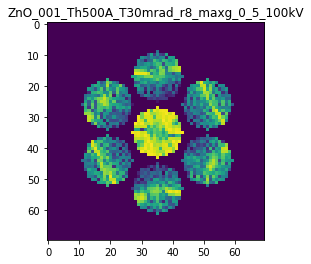

X_sim.max(): 0.9814057066163647
>>>replaced the 41. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 0.0035 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 714ms/step - loss: 0.0036 - acc: 0.8900 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 989ms/step - loss: 0.0037 - acc: 0.8900 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0036 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0035 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500


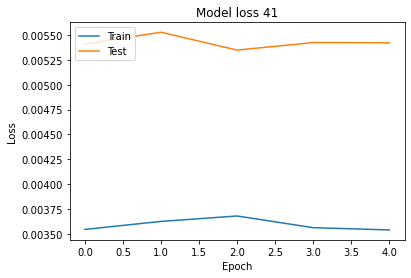

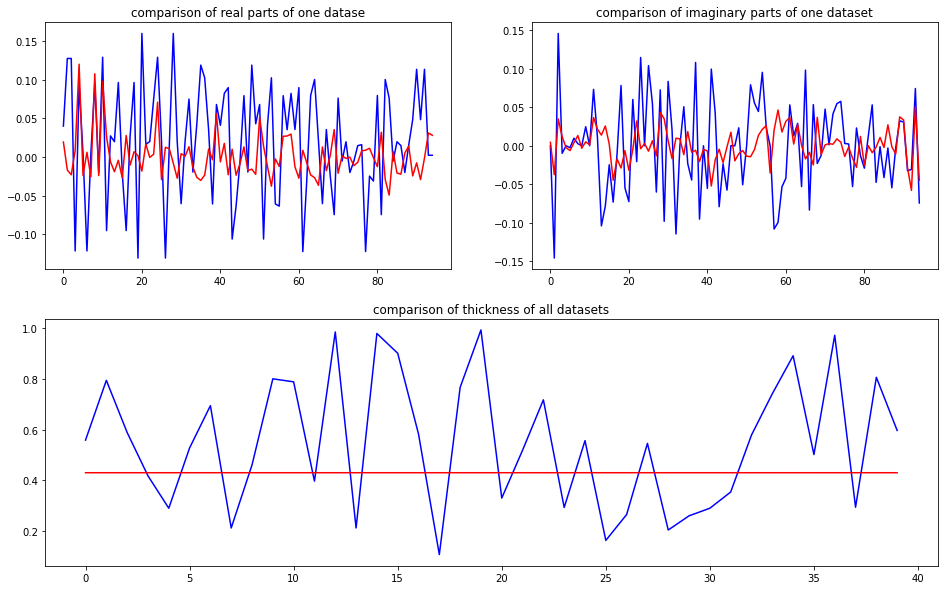

predicted thickness: 0.43017548


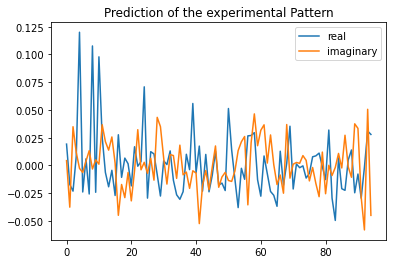

The offset applied on thickness: -0.00032086246174148835

The offset applied on Ug: 2.1361577740714695

Applied shift of unit cell origin (fractional coordinates): 0.004190134278488129 0.00872163812527958 -0.015290329898644595
Ug[ 0 ]: 0.02008 0.0  =>  0.02008 0.0
Ug[ 1 ]: 0.03977 -1.9955  =>  0.03977 -2.09157
Ug[ 2 ]: 0.03977 1.9955  =>  0.03977 2.09157
Ug[ 3 ]: 0.00847 0.50776  =>  0.00847 0.56256
Ug[ 4 ]: 0.14172 0.04127  =>  0.14172 0.0
Ug[ 5 ]: 0.0253 -2.73343  =>  0.0253 -2.58256
Ug[ 6 ]: 0.00847 -0.50776  =>  0.00847 -0.56256
Ug[ 7 ]: 0.0253 2.73343  =>  0.0253 2.58256
Ug[ 8 ]: 0.14172 -0.04127  =>  0.14172 -0.0
Ug[ 9 ]: 0.02418 3.08559  =>  0.02418 3.11192
Ug[ 10 ]: 0.10018 0.06974  =>  0.10018 -0.0
Ug[ 11 ]: 0.05104 0.896  =>  0.05104 1.0184
Ug[ 12 ]: 0.02083 1.93945  =>  0.02083 1.91097
Ug[ 13 ]: 0.02487 2.7224  =>  0.02487 2.59785
Ug[ 14 ]: 0.02721 1.46692  =>  0.02721 1.53452
Ug[ 15 ]: 0.02418 -3.08559  =>  0.02418 -3.11192
Ug[ 16 ]: 0.05104 -0.896  =>  0.05104 -1.0184
Ug[ 

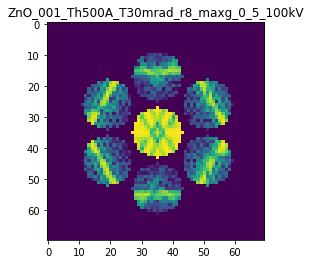

X_sim.max(): 0.9884506462729336
>>>replaced the 42. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 1s/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 749ms/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 988ms/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0036 - acc: 0.8900 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0036 - acc: 0.8900 - val_loss: 0.0055 - val_acc: 0.9500


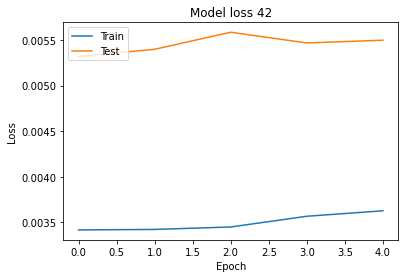

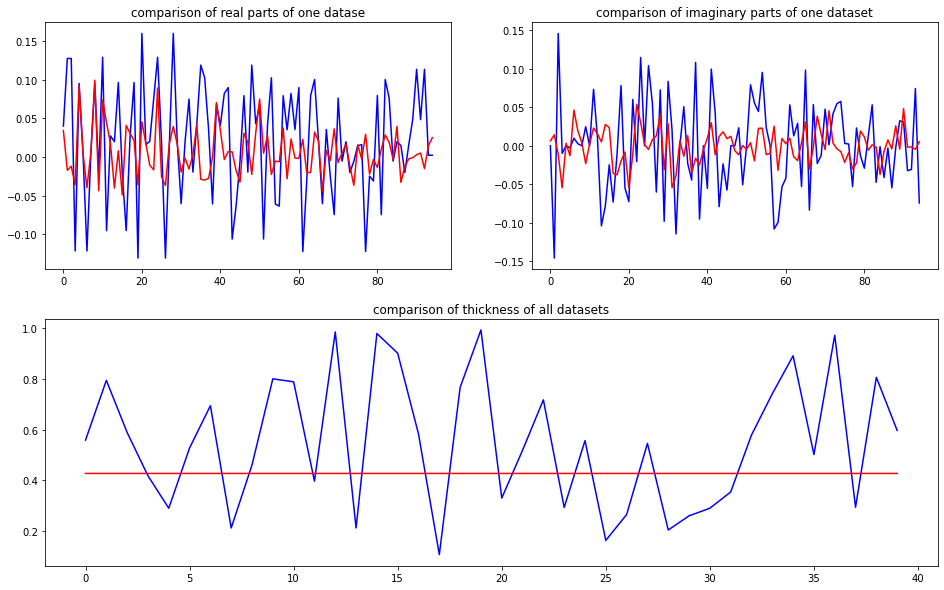

predicted thickness: 0.42727572


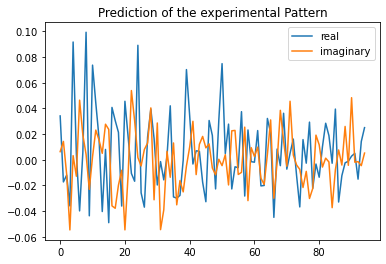

The offset applied on thickness: -0.000319834798424874

The offset applied on Ug: 2.397605211971832

Applied shift of unit cell origin (fractional coordinates): 1.792286055332227e-05 -0.00267652976421576 0.00757432023268923
Ug[ 0 ]: 0.037 0.0  =>  0.037 0.0
Ug[ 1 ]: 0.01887 2.38607  =>  0.01887 2.43366
Ug[ 2 ]: 0.01887 -2.38607  =>  0.01887 -2.43366
Ug[ 3 ]: 0.05736 -2.08693  =>  0.05736 -2.10374
Ug[ 4 ]: 0.11753 -0.03077  =>  0.11753 -0.0
Ug[ 5 ]: 0.01741 -1.22806  =>  0.01741 -1.29247
Ug[ 6 ]: 0.05736 2.08693  =>  0.05736 2.10374
Ug[ 7 ]: 0.01741 1.22806  =>  0.01741 1.29247
Ug[ 8 ]: 0.11753 0.03077  =>  0.11753 0.0
Ug[ 9 ]: 0.04645 -2.60378  =>  0.04645 -2.60366
Ug[ 10 ]: 0.0976 -0.0477  =>  0.0976 0.0
Ug[ 11 ]: 0.0569 0.53257  =>  0.0569 0.48509
Ug[ 12 ]: 0.03625 0.72344  =>  0.03625 0.74037
Ug[ 13 ]: 0.03083 2.95195  =>  0.03083 3.01647
Ug[ 14 ]: 0.02895 0.95642  =>  0.02895 0.92576
Ug[ 15 ]: 0.04645 2.60378  =>  0.04645 2.60366
Ug[ 16 ]: 0.0569 -0.53257  =>  0.0569 -0.48509
Ug[ 1

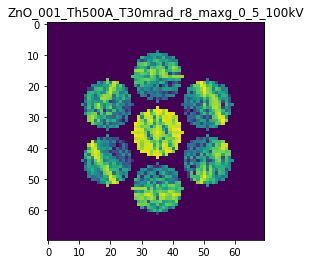

X_sim.max(): 0.8965530235212196
>>>replaced the 43. dataset and train: 
Epoch 1/5
5/5 [==============================] - 13s 2s/step - loss: 0.0035 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0035 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0055 - val_acc: 0.9500


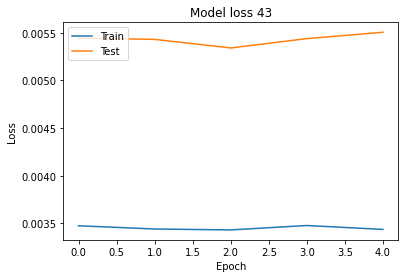

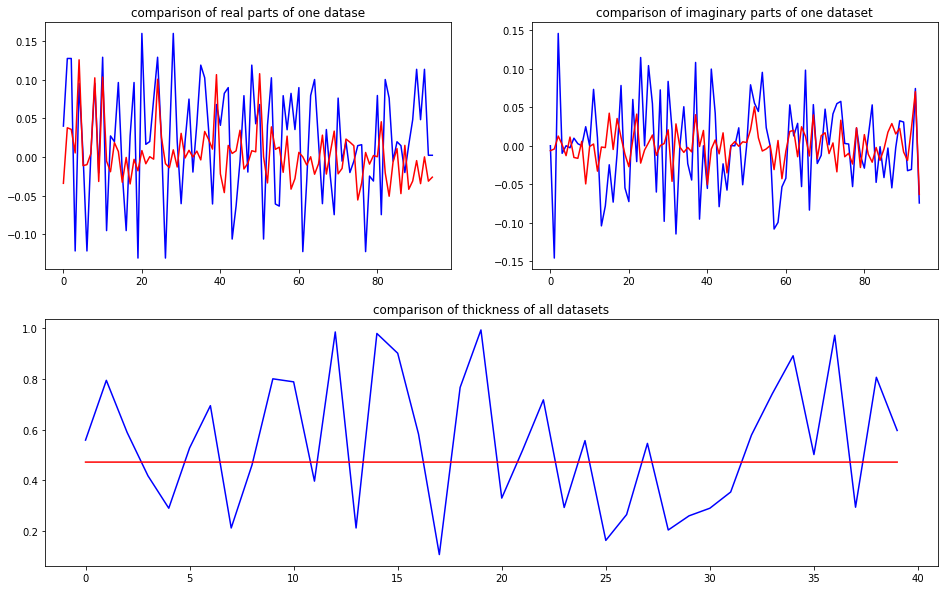

predicted thickness: 0.47213948


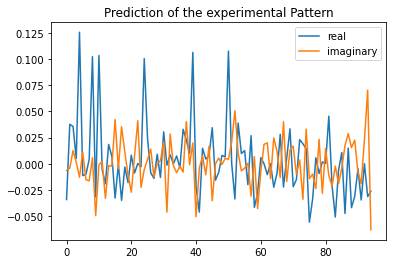

The offset applied on thickness: 0.00010311648902916115

The offset applied on Ug: 2.3959515315074804

Applied shift of unit cell origin (fractional coordinates): 0.004420986755904843 0.004940733481648445 -0.008841675015168193
Ug[ 0 ]: 0.03128 3.14159  =>  0.03128 3.14159
Ug[ 1 ]: 0.04098 -0.20568  =>  0.04098 -0.26124
Ug[ 2 ]: 0.04098 0.20568  =>  0.04098 0.26124
Ug[ 3 ]: 0.0082 1.81854  =>  0.0082 1.84958
Ug[ 4 ]: 0.14575 0.02451  =>  0.14575 0.0
Ug[ 5 ]: 0.01405 1.77437  =>  0.01405 1.86097
Ug[ 6 ]: 0.0082 -1.81854  =>  0.0082 -1.84958
Ug[ 7 ]: 0.01405 -1.77437  =>  0.01405 -1.86097
Ug[ 8 ]: 0.14575 -0.02451  =>  0.14575 -0.0
Ug[ 9 ]: 0.05159 -2.07018  =>  0.05159 -2.0424
Ug[ 10 ]: 0.12697 0.02778  =>  0.12697 0.0
Ug[ 11 ]: 0.00467 2.27541  =>  0.00467 2.35874
Ug[ 12 ]: 0.04163 -2.13789  =>  0.04163 -2.14116
Ug[ 13 ]: 0.02308 -0.13833  =>  0.02308 -0.19715
Ug[ 14 ]: 0.00713 -1.26002  =>  0.00713 -1.20773
Ug[ 15 ]: 0.05159 2.07018  =>  0.05159 2.0424
Ug[ 16 ]: 0.00467 -2.27541  =>  0

Residual error after kinematic rocking curve fit: 0.036630698051175754



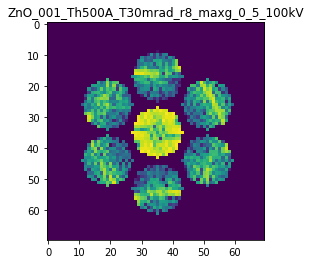

X_sim.max(): 0.98655876009692
>>>replaced the 44. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 983ms/step - loss: 0.0035 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 895ms/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0033 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500


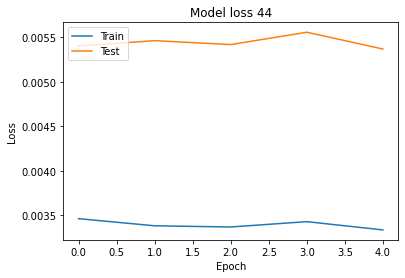

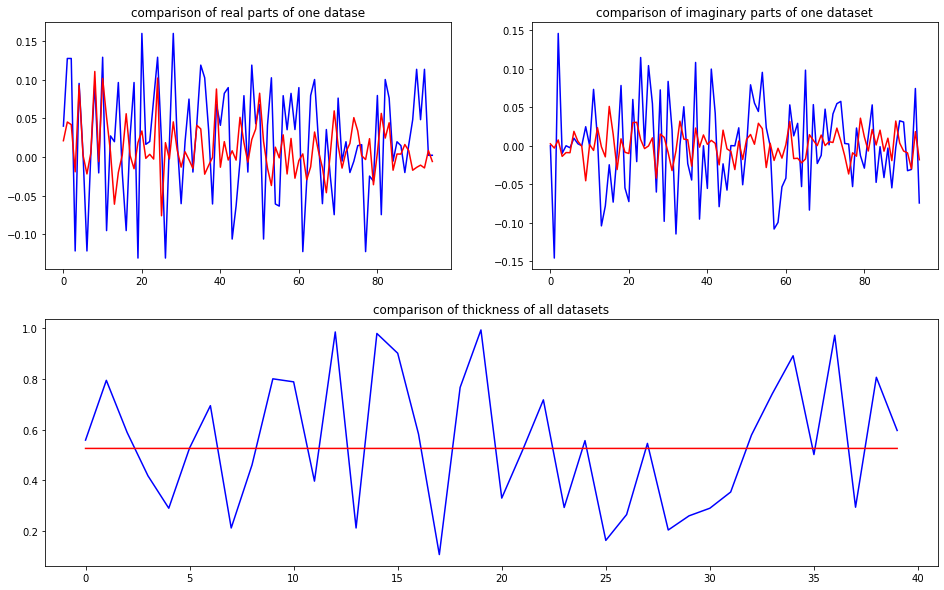

predicted thickness: 0.5261375


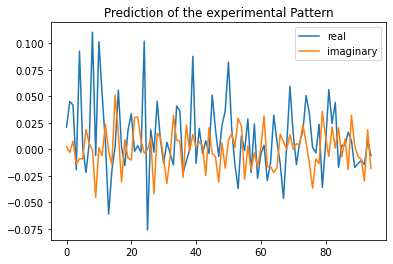

The offset applied on thickness: 0.00038797529958589405

The offset applied on Ug: 3.080474417653368

Applied shift of unit cell origin (fractional coordinates): -0.006415416221148596 0.015120009710970403 0.003731418329493363
Ug[ 0 ]: 0.02234 0.0  =>  0.02234 0.0
Ug[ 1 ]: 0.04965 -0.0949  =>  0.04965 -0.07146
Ug[ 2 ]: 0.04965 0.0949  =>  0.04965 0.07146
Ug[ 3 ]: 0.02487 -2.40982  =>  0.02487 -2.31482
Ug[ 4 ]: 0.13471 -0.11845  =>  0.13471 -0.0
Ug[ 5 ]: 0.00842 -1.07654  =>  0.00842 -1.00499
Ug[ 6 ]: 0.02487 2.40982  =>  0.02487 2.31482
Ug[ 7 ]: 0.00842 1.07654  =>  0.00842 1.00499
Ug[ 8 ]: 0.13471 0.11845  =>  0.13471 0.0
Ug[ 9 ]: 0.04963 -1.46024  =>  0.04963 -1.50055
Ug[ 10 ]: 0.13379 0.01686  =>  0.13379 0.0
Ug[ 11 ]: 0.064 -0.18995  =>  0.064 -0.25371
Ug[ 12 ]: 0.02739 1.3354  =>  0.02739 1.20009
Ug[ 13 ]: 0.05402 -3.10553  =>  0.05402 3.06579
Ug[ 14 ]: 0.01983 -2.5336  =>  0.01983 -2.69236
Ug[ 15 ]: 0.04963 1.46024  =>  0.04963 1.50055
Ug[ 16 ]: 0.064 0.18995  =>  0.064 0.25371
Ug

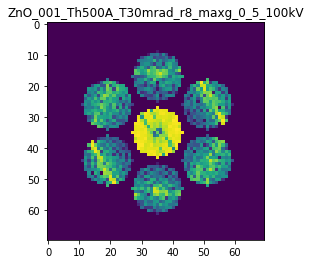

X_sim.max(): 0.9463776655284643
>>>replaced the 45. dataset and train: 
Epoch 1/5
5/5 [==============================] - 6s 923ms/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 630ms/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0036 - acc: 0.8900 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500


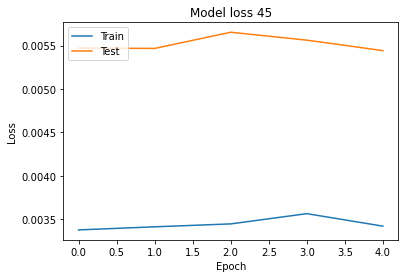

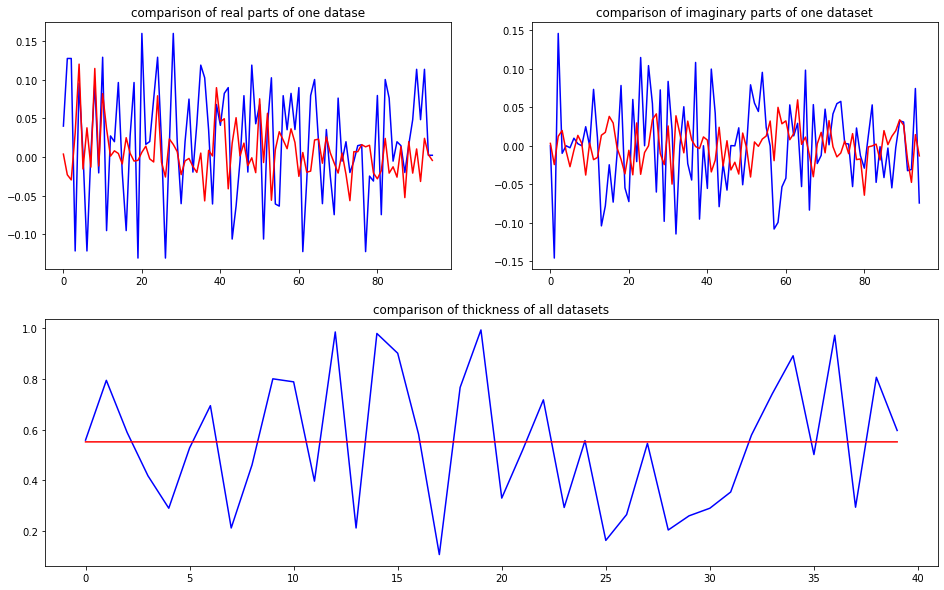

predicted thickness: 0.5519824


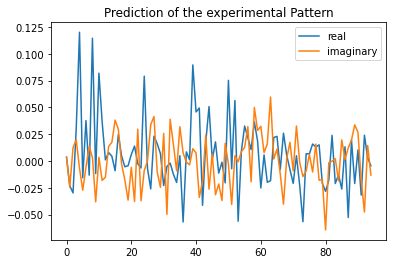

The offset applied on thickness: -0.0007687756715540053

The offset applied on Ug: 2.832424917313691

Applied shift of unit cell origin (fractional coordinates): 0.004424644136981306 0.01658537834715658 -0.015852952923777128
Ug[ 0 ]: 0.00368 0.0  =>  0.00368 0.0
Ug[ 1 ]: 0.02964 -2.48016  =>  0.02964 -2.57976
Ug[ 2 ]: 0.02964 2.48016  =>  0.02964 2.57976
Ug[ 3 ]: 0.04018 0.31589  =>  0.04018 0.4201
Ug[ 4 ]: 0.15632 -0.0046  =>  0.15632 -0.0
Ug[ 5 ]: 0.0232 -2.14069  =>  0.0232 -1.93687
Ug[ 6 ]: 0.04018 -0.31589  =>  0.04018 -0.4201
Ug[ 7 ]: 0.0232 2.14069  =>  0.0232 1.93687
Ug[ 8 ]: 0.15632 0.0046  =>  0.15632 0.0
Ug[ 9 ]: 0.03855 -1.72636  =>  0.03855 -1.69856
Ug[ 10 ]: 0.09924 0.07181  =>  0.09924 -0.0
Ug[ 11 ]: 0.04214 -0.58867  =>  0.04214 -0.46126
Ug[ 12 ]: 0.00669 -1.06454  =>  0.00669 -1.14095
Ug[ 13 ]: 0.00725 1.44939  =>  0.00725 1.27337
Ug[ 14 ]: 0.0175 1.54392  =>  0.0175 1.56712
Ug[ 15 ]: 0.03855 1.72636  =>  0.03855 1.69856
Ug[ 16 ]: 0.04214 0.58867  =>  0.04214 0.46126
U

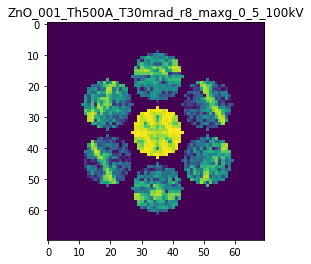

X_sim.max(): 0.9697055747701289
>>>replaced the 46. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 963ms/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 659ms/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 994ms/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0034 - acc: 0.8900 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 991ms/step - loss: 0.0035 - acc: 0.8900 - val_loss: 0.0056 - val_acc: 0.9500


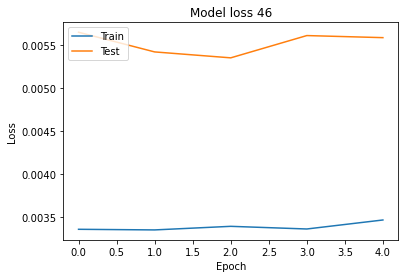

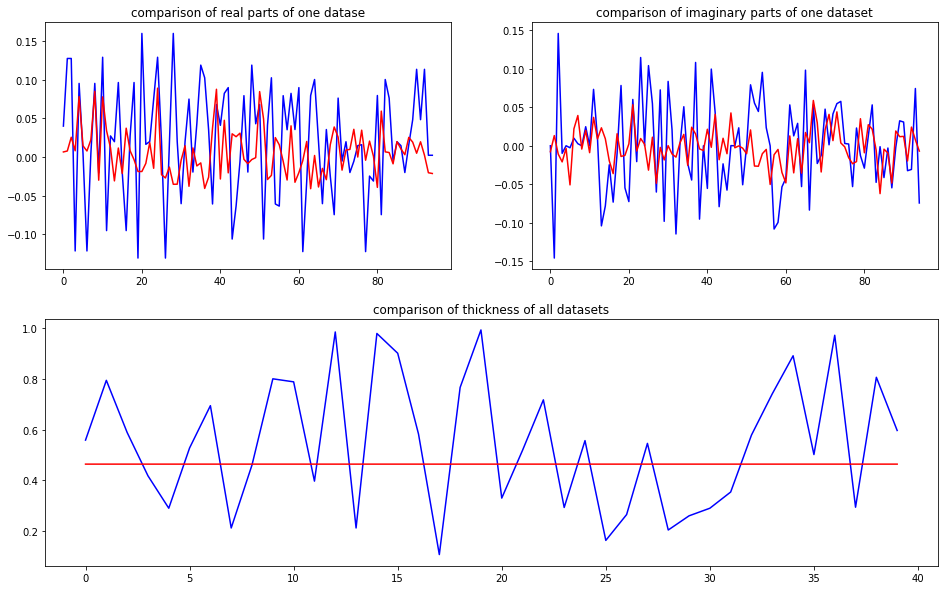

predicted thickness: 0.46413025


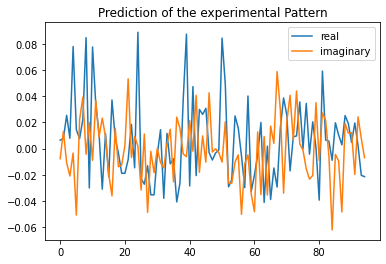

The offset applied on thickness: 0.0009467693644513607

The offset applied on Ug: -1.086804712291507

Applied shift of unit cell origin (fractional coordinates): 0.007921348523470994 -0.0040148983430444785 0.0020766787577311393
Ug[ 0 ]: 0.00633 0.0  =>  0.00633 0.0
Ug[ 1 ]: 0.02018 0.65496  =>  0.02018 0.668
Ug[ 2 ]: 0.02018 -0.65496  =>  0.02018 -0.668
Ug[ 3 ]: 0.02267 -1.24724  =>  0.02267 -1.27247
Ug[ 4 ]: 0.07423 0.01218  =>  0.07423 0.0
Ug[ 5 ]: 0.04812 -1.23976  =>  0.04812 -1.27804
Ug[ 6 ]: 0.02267 1.24724  =>  0.02267 1.27247
Ug[ 7 ]: 0.04812 1.23976  =>  0.04812 1.27804
Ug[ 8 ]: 0.07423 -0.01218  =>  0.07423 -0.0
Ug[ 9 ]: 0.03325 2.51646  =>  0.03325 2.56623
Ug[ 10 ]: 0.07587 -0.06282  =>  0.07587 0.0
Ug[ 11 ]: 0.04908 0.84264  =>  0.04908 0.87937
Ug[ 12 ]: 0.01016 -0.33749  =>  0.01016 -0.26249
Ug[ 13 ]: 0.03973 2.37705  =>  0.03973 2.46509
Ug[ 14 ]: 0.01212 1.25748  =>  0.01212 1.31943
Ug[ 15 ]: 0.03325 -2.51646  =>  0.03325 -2.56623
Ug[ 16 ]: 0.04908 -0.84264  =>  0.04908 -

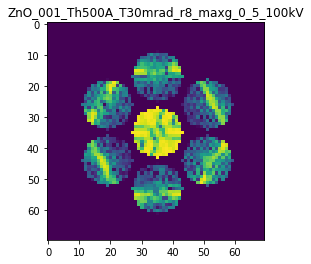

X_sim.max(): 0.9727631414512974
>>>replaced the 47. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 963ms/step - loss: 0.0033 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 725ms/step - loss: 0.0033 - acc: 0.8900 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0033 - acc: 0.8900 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0033 - acc: 0.8900 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0033 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500


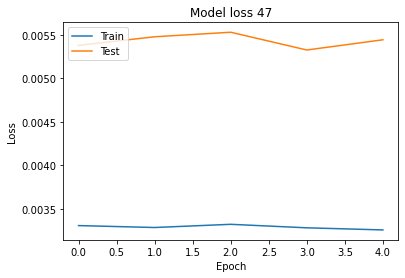

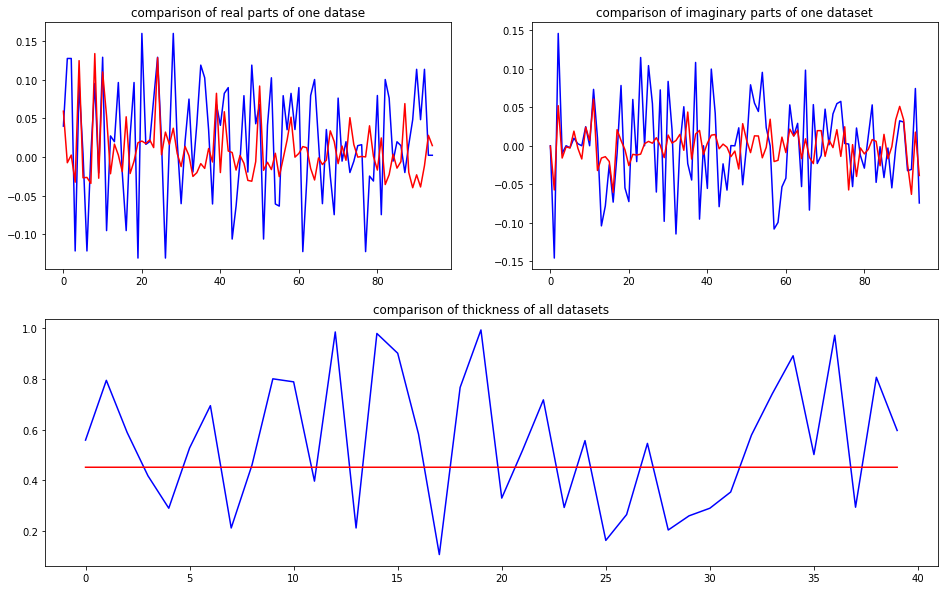

predicted thickness: 0.45180458


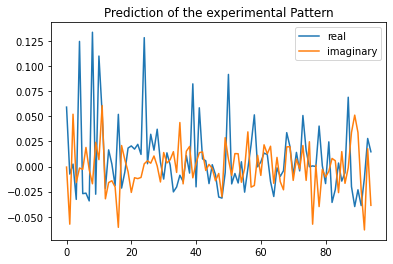

The offset applied on thickness: -0.00048283924308787165

The offset applied on Ug: -1.6413986358035946

Applied shift of unit cell origin (fractional coordinates): -0.005231219992120271 -0.01277601194383903 -0.0010859962772854536
Ug[ 0 ]: 0.05341 0.0  =>  0.05341 0.0
Ug[ 1 ]: 0.05589 -1.70668  =>  0.05589 -1.7135
Ug[ 2 ]: 0.05589 1.70668  =>  0.05589 1.7135
Ug[ 3 ]: 0.03624 -2.63058  =>  0.03624 -2.71085
Ug[ 4 ]: 0.10188 0.0871  =>  0.10188 0.0
Ug[ 5 ]: 0.03223 3.12374  =>  0.03223 3.05029
Ug[ 6 ]: 0.03624 2.63058  =>  0.03624 2.71085
Ug[ 7 ]: 0.03223 -3.12374  =>  0.03223 -3.05029
Ug[ 8 ]: 0.10188 -0.0871  =>  0.10188 0.0
Ug[ 9 ]: 0.03315 2.42792  =>  0.03315 2.39505
Ug[ 10 ]: 0.09575 0.03969  =>  0.09575 0.0
Ug[ 11 ]: 0.07359 0.96646  =>  0.07359 0.94042
Ug[ 12 ]: 0.03593 -2.28841  =>  0.03593 -2.241
Ug[ 13 ]: 0.01449 -0.8835  =>  0.01449 -0.84292
Ug[ 14 ]: 0.01079 -1.73661  =>  0.01079 -1.68238
Ug[ 15 ]: 0.03315 -2.42792  =>  0.03315 -2.39505
Ug[ 16 ]: 0.07359 -0.96646  =>  0.07359

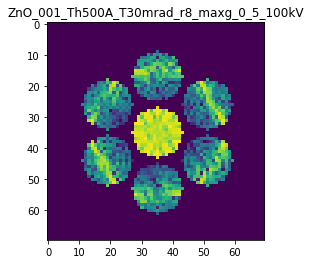

X_sim.max(): 0.940047733883752
>>>replaced the 48. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 952ms/step - loss: 0.0032 - acc: 0.8900 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 625ms/step - loss: 0.0032 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 4s 985ms/step - loss: 0.0031 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0032 - acc: 0.8900 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0032 - acc: 0.8900 - val_loss: 0.0055 - val_acc: 0.9500


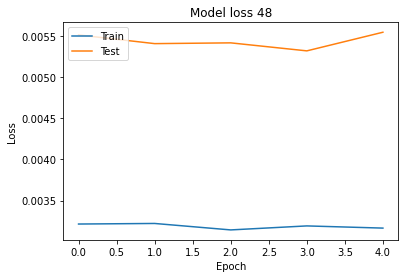

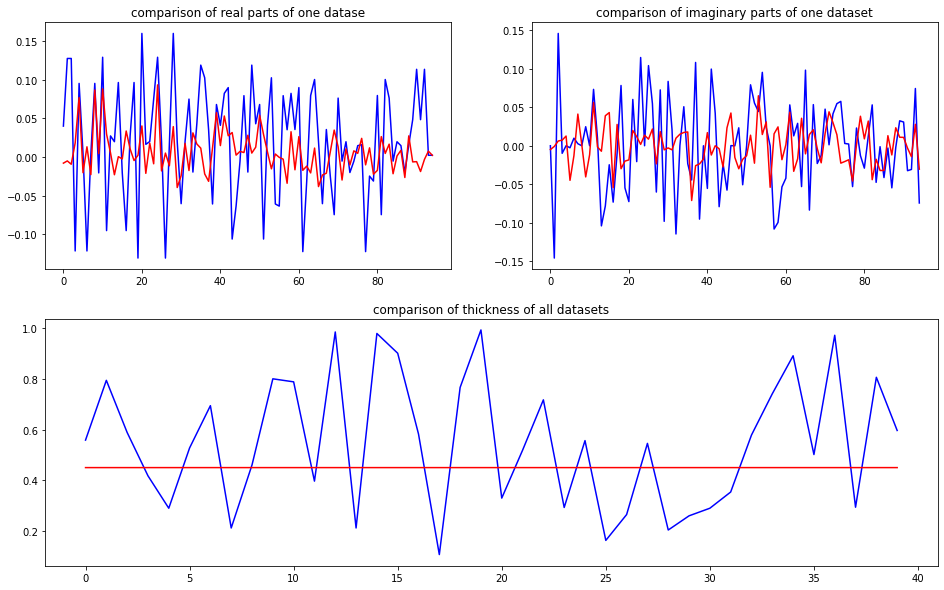

predicted thickness: 0.45039895


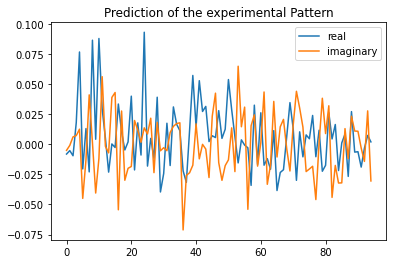

The offset applied on thickness: 0.0007341602263387614

The offset applied on Ug: -2.2759530793891583

Applied shift of unit cell origin (fractional coordinates): 0.016718126173845868 -0.02541184362217769 0.010081592210541663
Ug[ 0 ]: 0.00828 3.14159  =>  0.00828 3.14159
Ug[ 1 ]: 0.00827 -2.7157  =>  0.00827 -2.65235
Ug[ 2 ]: 0.00827 2.7157  =>  0.00827 2.65235
Ug[ 3 ]: 0.01787 0.59811  =>  0.01787 0.43844
Ug[ 4 ]: 0.06658 0.09632  =>  0.06658 0.0
Ug[ 5 ]: 0.05101 -2.12783  =>  0.05101 -2.35084
Ug[ 6 ]: 0.01787 -0.59811  =>  0.01787 -0.43844
Ug[ 7 ]: 0.05101 2.12783  =>  0.05101 2.35084
Ug[ 8 ]: 0.06658 -0.09632  =>  0.06658 -0.0
Ug[ 9 ]: 0.04162 -1.6477  =>  0.04162 -1.54265
Ug[ 10 ]: 0.07257 -0.16839  =>  0.07257 -0.0
Ug[ 11 ]: 0.05962 1.18842  =>  0.05962 1.23012
Ug[ 12 ]: 0.01533 -1.11019  =>  0.01533 -0.84548
Ug[ 13 ]: 0.02317 -2.78482  =>  0.02317 -2.45677
Ug[ 14 ]: 0.03412 1.71624  =>  0.03412 1.91761
Ug[ 15 ]: 0.04162 1.6477  =>  0.04162 1.54265
Ug[ 16 ]: 0.05962 -1.18842  =>  

Residual error after kinematic rocking curve fit: 0.020359858983274946



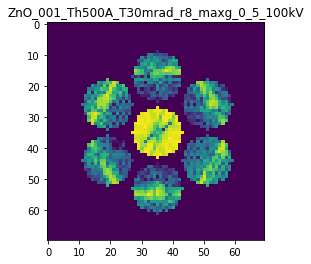

X_sim.max(): 0.9515598391348488
>>>replaced the 49. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 0.0031 - acc: 0.8900 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 658ms/step - loss: 0.0031 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 4s 970ms/step - loss: 0.0031 - acc: 0.8900 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 993ms/step - loss: 0.0031 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0031 - acc: 0.8900 - val_loss: 0.0054 - val_acc: 0.9500


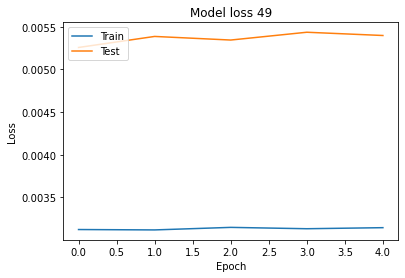

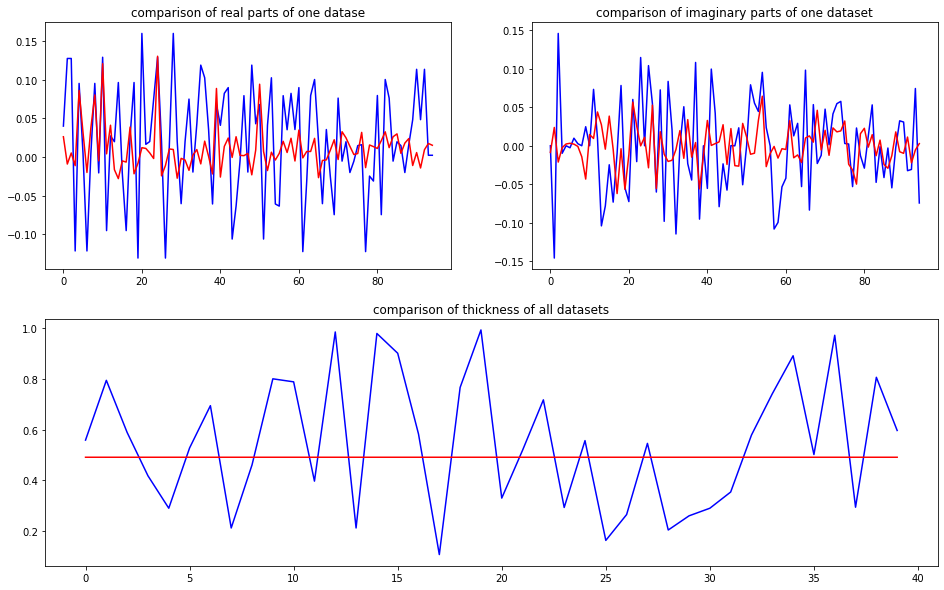

predicted thickness: 0.4912993


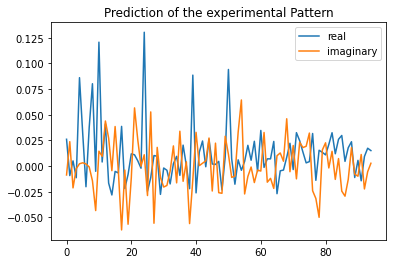

The offset applied on thickness: -0.0004404295795386717

The offset applied on Ug: 1.709247793546006

Applied shift of unit cell origin (fractional coordinates): -0.0014007965005694118 -0.01872518086099796 0.003226507799828873
Ug[ 0 ]: 0.0274 0.0  =>  0.0274 0.0
Ug[ 1 ]: 0.02265 1.62025  =>  0.02265 1.64052
Ug[ 2 ]: 0.02265 -1.62025  =>  0.02265 -1.64052
Ug[ 3 ]: 0.01546 -2.97814  =>  0.01546 -3.09579
Ug[ 4 ]: 0.09561 0.09738  =>  0.09561 0.0
Ug[ 5 ]: 0.03677 0.04408  =>  0.03677 -0.09385
Ug[ 6 ]: 0.01546 2.97814  =>  0.01546 3.09579
Ug[ 7 ]: 0.03677 -0.04408  =>  0.03677 0.09385
Ug[ 8 ]: 0.09561 -0.09738  =>  0.09561 0.0
Ug[ 9 ]: 0.04064 -1.62506  =>  0.04064 -1.63386
Ug[ 10 ]: 0.15274 -0.01147  =>  0.15274 0.0
Ug[ 11 ]: 0.00724 1.73743  =>  0.00724 1.70835
Ug[ 12 ]: 0.06994 0.82403  =>  0.06994 0.93288
Ug[ 13 ]: 0.03326 2.15779  =>  0.03326 2.28691
Ug[ 14 ]: 0.02386 -3.13978  =>  0.02386 -3.0512
Ug[ 15 ]: 0.04064 1.62506  =>  0.04064 1.63386
Ug[ 16 ]: 0.00724 -1.73743  =>  0.00724 -1

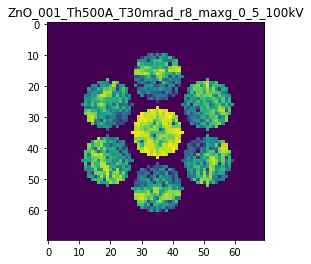

X_sim.max(): 0.9166041457266921
>>>replaced the 50. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 956ms/step - loss: 0.0031 - acc: 0.9000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 683ms/step - loss: 0.0031 - acc: 0.9000 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0031 - acc: 0.9000 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0032 - acc: 0.9000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0031 - acc: 0.9000 - val_loss: 0.0055 - val_acc: 0.9500


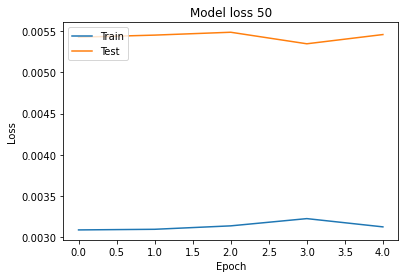

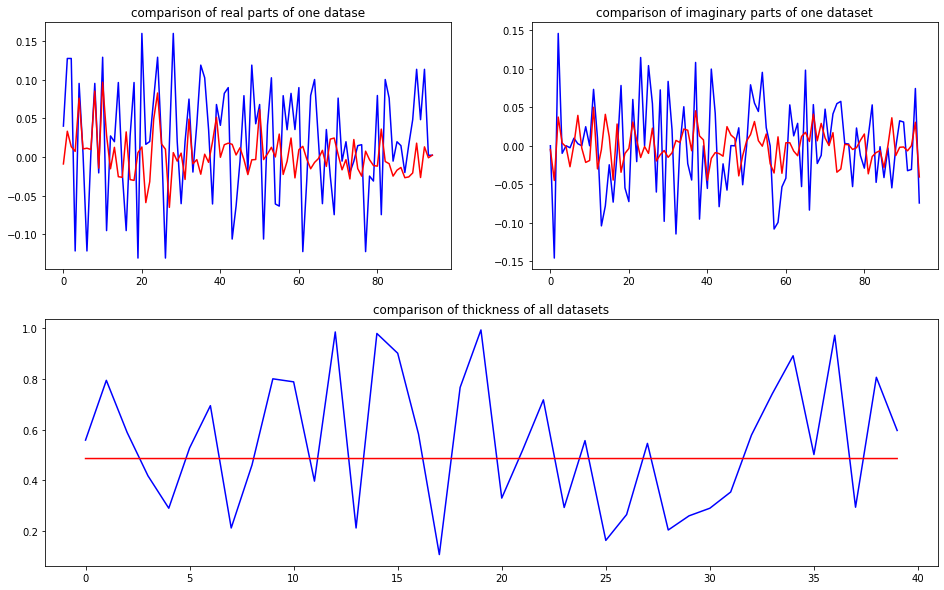

predicted thickness: 0.48618627


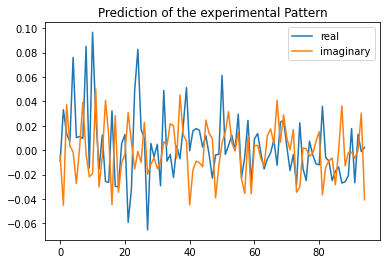

The offset applied on thickness: 0.0009270050556632241

The offset applied on Ug: -0.37564356233640317

Applied shift of unit cell origin (fractional coordinates): 0.01111336740008245 -0.008581300349309227 0.00641332270987322
Ug[ 0 ]: 0.00914 3.14159  =>  0.00914 3.14159
Ug[ 1 ]: 0.04711 -1.07653  =>  0.04711 -1.03624
Ug[ 2 ]: 0.04711 1.07653  =>  0.04711 1.03624
Ug[ 3 ]: 0.0092 0.09736  =>  0.0092 0.04344
Ug[ 4 ]: 0.07819 0.01362  =>  0.07819 -0.0
Ug[ 5 ]: 0.03457 -1.29101  =>  0.03457 -1.38522
Ug[ 6 ]: 0.0092 -0.09736  =>  0.0092 -0.04344
Ug[ 7 ]: 0.03457 1.29101  =>  0.03457 1.38522
Ug[ 8 ]: 0.07819 -0.01362  =>  0.07819 0.0
Ug[ 9 ]: 0.02658 -2.46654  =>  0.02658 -2.39671
Ug[ 10 ]: 0.08713 -0.11012  =>  0.08713 -0.0
Ug[ 11 ]: 0.05539 1.02164  =>  0.05539 1.05117
Ug[ 12 ]: 0.037 -2.23807  =>  0.037 -2.11432
Ug[ 13 ]: 0.01473 0.17422  =>  0.01473 0.33826
Ug[ 14 ]: 0.0474 2.22531  =>  0.0474 2.30875
Ug[ 15 ]: 0.02658 2.46654  =>  0.02658 2.39671
Ug[ 16 ]: 0.05539 -1.02164  =>  0.05539 

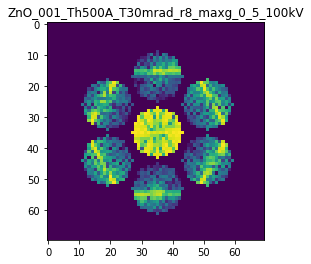

X_sim.max(): 0.9872793881361485
>>>replaced the 51. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 944ms/step - loss: 0.0030 - acc: 0.9000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 631ms/step - loss: 0.0031 - acc: 0.9000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0031 - acc: 0.9000 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0031 - acc: 0.9000 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0031 - acc: 0.9000 - val_loss: 0.0054 - val_acc: 0.9500


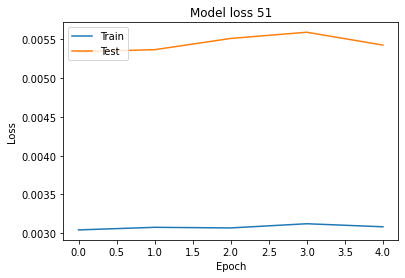

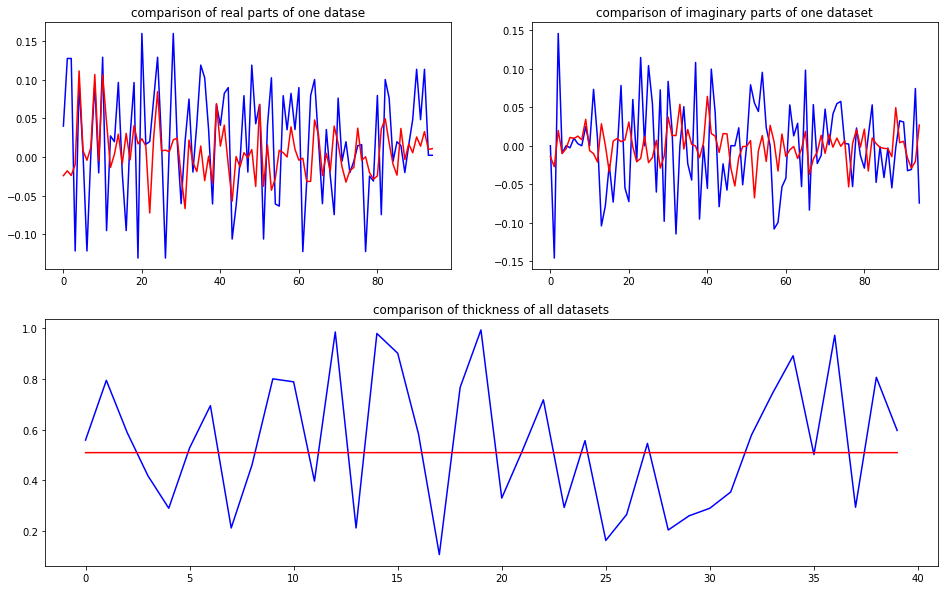

predicted thickness: 0.50948685


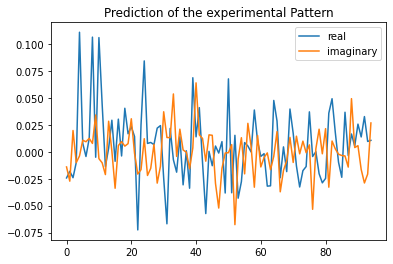

The offset applied on thickness: -7.012025825671641e-05

The offset applied on Ug: -1.3465263720796141

Applied shift of unit cell origin (fractional coordinates): 0.00795342086823395 -0.0024697958572803343 0.01309532785236748
Ug[ 0 ]: 0.02529 3.14159  =>  0.02529 3.14159
Ug[ 1 ]: 0.03256 -2.3303  =>  0.03256 -2.24802
Ug[ 2 ]: 0.03256 2.3303  =>  0.03256 2.24802
Ug[ 3 ]: 0.01218 -2.21077  =>  0.01218 -2.22628
Ug[ 4 ]: 0.09313 -0.06676  =>  0.09313 0.0
Ug[ 5 ]: 0.00997 -0.07839  =>  0.00997 -0.17619
Ug[ 6 ]: 0.01218 2.21077  =>  0.01218 2.22628
Ug[ 7 ]: 0.00997 0.07839  =>  0.00997 0.17619
Ug[ 8 ]: 0.09313 0.06676  =>  0.09313 -0.0
Ug[ 9 ]: 0.03514 1.81569  =>  0.03514 1.86567
Ug[ 10 ]: 0.08361 -0.13225  =>  0.08361 0.0
Ug[ 11 ]: 0.03635 -0.24097  =>  0.03635 -0.27328
Ug[ 12 ]: 0.01821 -2.10259  =>  0.01821 -2.03709
Ug[ 13 ]: 0.02547 1.38488  =>  0.02547 1.53266
Ug[ 14 ]: 0.03333 -0.05505  =>  0.03333 -0.07184
Ug[ 15 ]: 0.03514 -1.81569  =>  0.03514 -1.86567
Ug[ 16 ]: 0.03635 0.24097  =

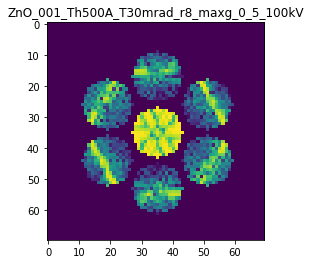

X_sim.max(): 0.9758185092988629
>>>replaced the 52. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 961ms/step - loss: 0.0032 - acc: 0.9100 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 656ms/step - loss: 0.0030 - acc: 0.9100 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0031 - acc: 0.9100 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0031 - acc: 0.9100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0030 - acc: 0.9100 - val_loss: 0.0054 - val_acc: 0.9500


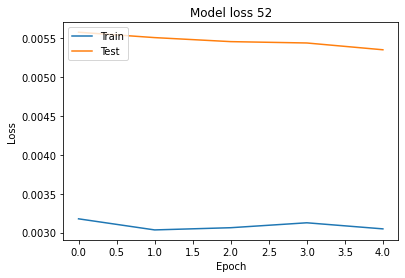

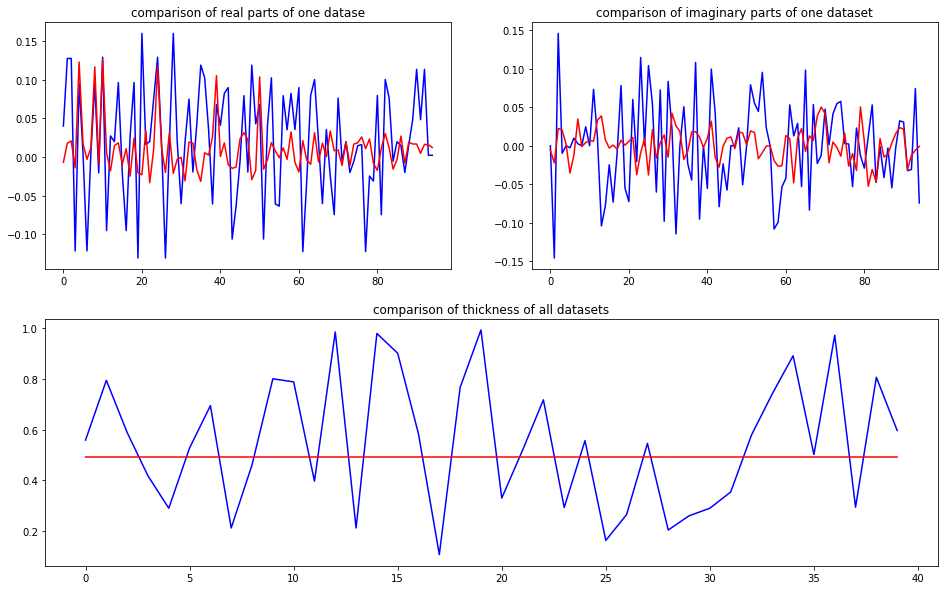

predicted thickness: 0.49224126


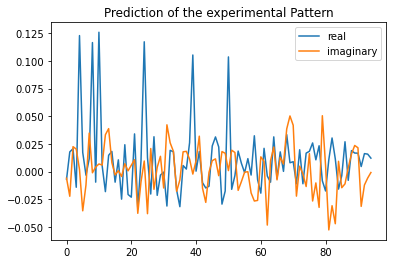

The offset applied on thickness: 0.0003202240940436707

The offset applied on Ug: 0.5438963358642015

Applied shift of unit cell origin (fractional coordinates): 0.0006100605090639843 -0.0027107936401661644 0.00021199349218299223
Ug[ 0 ]: 0.0069 3.14159  =>  0.0069 3.14159
Ug[ 1 ]: 0.02984 -0.8505  =>  0.02984 -0.84917
Ug[ 2 ]: 0.02984 0.8505  =>  0.02984 0.84917
Ug[ 3 ]: 0.0184 2.04987  =>  0.0184 2.03284
Ug[ 4 ]: 0.12747 0.0157  =>  0.12747 -0.0
Ug[ 5 ]: 0.03818 -1.16138  =>  0.03818 -1.17974
Ug[ 6 ]: 0.0184 -2.04987  =>  0.0184 -2.03284
Ug[ 7 ]: 0.03818 1.16138  =>  0.03818 1.17974
Ug[ 8 ]: 0.12747 -0.0157  =>  0.12747 0.0
Ug[ 9 ]: 0.01012 2.78502  =>  0.01012 2.78885
Ug[ 10 ]: 0.1296 -0.00517  =>  0.1296 0.0
Ug[ 11 ]: 0.00837 0.30694  =>  0.00837 0.30944
Ug[ 12 ]: 0.0283 2.40299  =>  0.0283 2.42386
Ug[ 13 ]: 0.04109 1.20886  =>  0.04109 1.23106
Ug[ 14 ]: 0.0215 0.0182  =>  0.0215 0.03774
Ug[ 15 ]: 0.01012 -2.78502  =>  0.01012 -2.78885
Ug[ 16 ]: 0.00837 -0.30694  =>  0.00837 -0.309

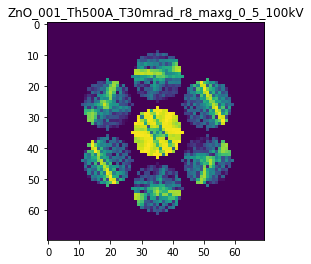

X_sim.max(): 0.9887529027203931
>>>replaced the 53. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 941ms/step - loss: 0.0029 - acc: 0.9100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 612ms/step - loss: 0.0029 - acc: 0.9100 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 4s 917ms/step - loss: 0.0028 - acc: 0.9100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0029 - acc: 0.9100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 6s 1s/step - loss: 0.0030 - acc: 0.9100 - val_loss: 0.0053 - val_acc: 0.9500


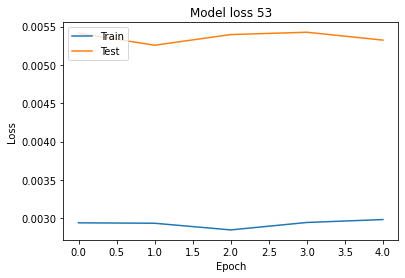

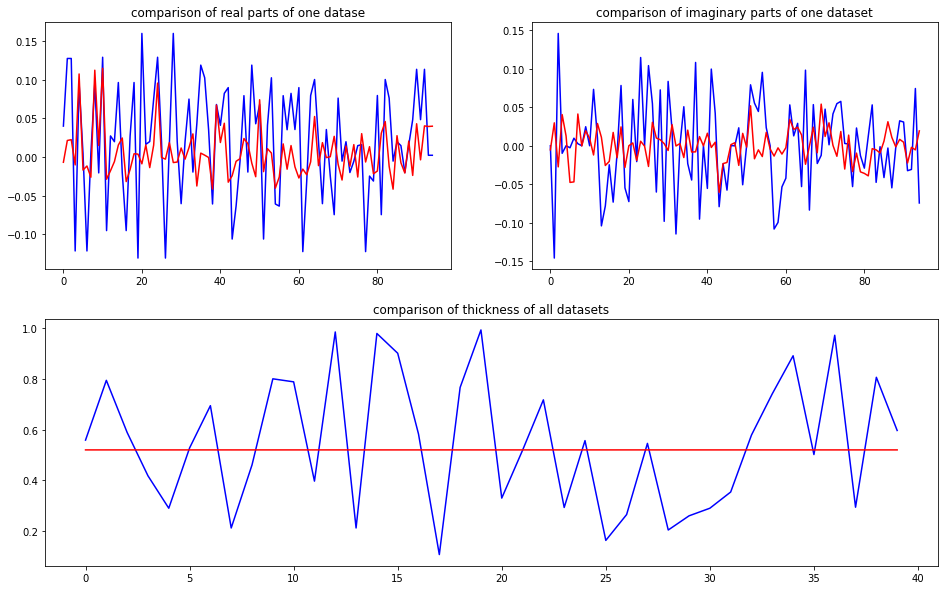

predicted thickness: 0.52026457


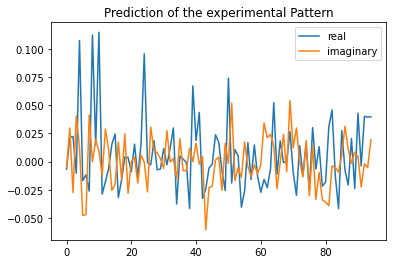

The offset applied on thickness: -8.035549585512137e-05

The offset applied on Ug: 2.352229444109024

Applied shift of unit cell origin (fractional coordinates): -0.006843767912329056 0.0049742807496670535 -0.010023529097828799
Ug[ 0 ]: 0.00671 3.14159  =>  0.00671 3.14159
Ug[ 1 ]: 0.03796 0.85804  =>  0.03796 0.79506
Ug[ 2 ]: 0.03796 -0.85804  =>  0.03796 -0.79506
Ug[ 3 ]: 0.04353 1.71485  =>  0.04353 1.74611
Ug[ 4 ]: 0.13839 0.03173  =>  0.13839 0.0
Ug[ 5 ]: 0.04689 -1.91417  =>  0.04689 -1.81994
Ug[ 6 ]: 0.04353 -1.71485  =>  0.04353 -1.74611
Ug[ 7 ]: 0.04689 1.91417  =>  0.04689 1.81994
Ug[ 8 ]: 0.13839 -0.03173  =>  0.13839 0.0
Ug[ 9 ]: 0.02889 0.73192  =>  0.02889 0.68892
Ug[ 10 ]: 0.13221 0.10598  =>  0.13221 0.0
Ug[ 11 ]: 0.03148 -2.64644  =>  0.03148 -2.62647
Ug[ 12 ]: 0.02748 2.15187  =>  0.02748 2.07762
Ug[ 13 ]: 0.01846 1.70078  =>  0.01846 1.56354
Ug[ 14 ]: 0.02722 -1.13524  =>  0.02722 -1.14651
Ug[ 15 ]: 0.02889 -0.73192  =>  0.02889 -0.68892
Ug[ 16 ]: 0.03148 2.64644  =>

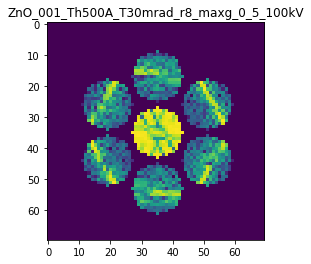

X_sim.max(): 0.9608080843651381
>>>replaced the 54. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 949ms/step - loss: 0.0029 - acc: 0.9100 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 626ms/step - loss: 0.0030 - acc: 0.9100 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0030 - acc: 0.9100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0029 - acc: 0.9100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0030 - acc: 0.9100 - val_loss: 0.0054 - val_acc: 0.9500


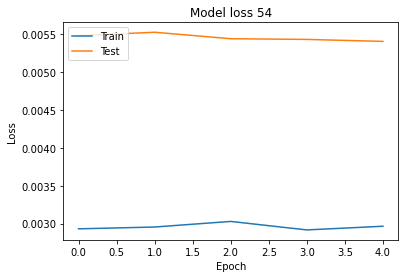

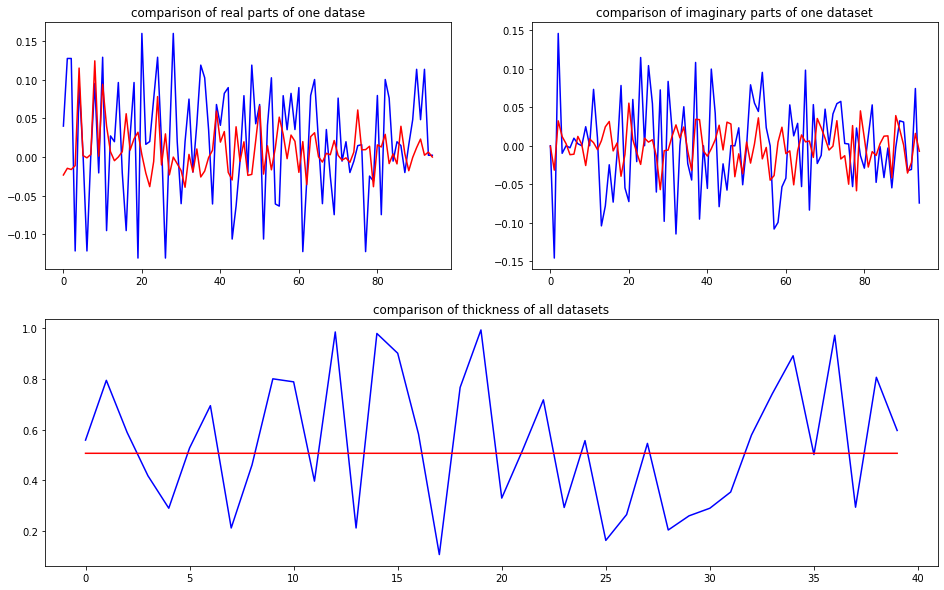

predicted thickness: 0.5068538


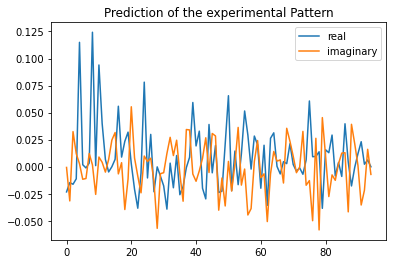

The offset applied on thickness: -0.000736894756764362

The offset applied on Ug: -0.133668935146882

Applied shift of unit cell origin (fractional coordinates): -0.006384478031218543 -0.008457448532198432 0.00757420435764553
Ug[ 0 ]: 0.02344 3.14159  =>  0.02344 3.14159
Ug[ 1 ]: 0.03568 -2.02667  =>  0.03568 -1.97908
Ug[ 2 ]: 0.03568 2.02667  =>  0.03568 1.97908
Ug[ 3 ]: 0.01307 2.07015  =>  0.01307 2.01701
Ug[ 4 ]: 0.11772 0.00555  =>  0.11772 0.0
Ug[ 5 ]: 0.01215 -1.36361  =>  0.01215 -1.46434
Ug[ 6 ]: 0.01307 -2.07015  =>  0.01307 -2.01701
Ug[ 7 ]: 0.01215 1.36361  =>  0.01215 1.46434
Ug[ 8 ]: 0.11772 -0.00555  =>  0.11772 -0.0
Ug[ 9 ]: 0.02883 -1.44059  =>  0.02883 -1.48071
Ug[ 10 ]: 0.08507 -0.00748  =>  0.08507 -0.0
Ug[ 11 ]: 0.04784 0.11444  =>  0.04784 0.02673
Ug[ 12 ]: 0.00886 -0.51263  =>  0.00886 -0.49961
Ug[ 13 ]: 0.00776 3.01984  =>  0.00776 3.08045
Ug[ 14 ]: 0.03421 1.22794  =>  0.03421 1.19337
Ug[ 15 ]: 0.02883 1.44059  =>  0.02883 1.48071
Ug[ 16 ]: 0.04784 -0.11444  =>

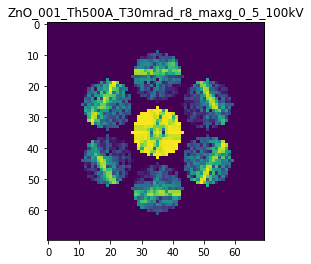

X_sim.max(): 0.982291730923396
>>>replaced the 55. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 0.0029 - acc: 0.9100 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 610ms/step - loss: 0.0029 - acc: 0.9100 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0029 - acc: 0.9100 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0029 - acc: 0.9100 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0029 - acc: 0.9100 - val_loss: 0.0054 - val_acc: 0.9500


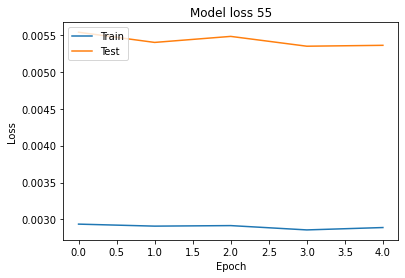

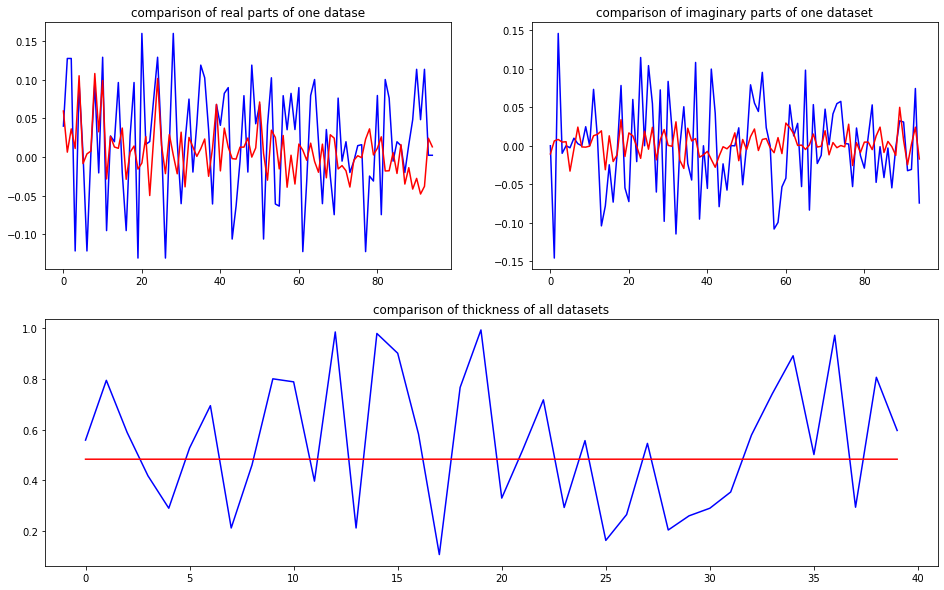

predicted thickness: 0.4835356


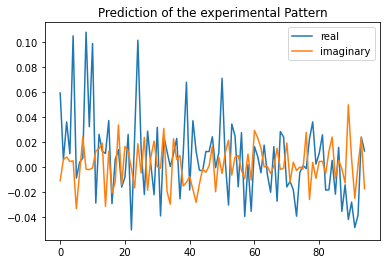

The offset applied on thickness: -0.0006509345355599551

The offset applied on Ug: -2.426085611541708

Applied shift of unit cell origin (fractional coordinates): 0.008746747322520811 -0.017801753319899624 0.010512595609318894
Ug[ 0 ]: 0.05056 0.0  =>  0.05056 0.0
Ug[ 1 ]: 0.01944 0.01787  =>  0.01944 0.08392
Ug[ 2 ]: 0.01944 -0.01787  =>  0.01944 -0.08392
Ug[ 3 ]: 0.00845 0.55231  =>  0.00845 0.44046
Ug[ 4 ]: 0.07901 0.0458  =>  0.07901 0.0
Ug[ 5 ]: 0.02946 -1.66213  =>  0.02946 -1.84003
Ug[ 6 ]: 0.00845 -0.55231  =>  0.00845 -0.44046
Ug[ 7 ]: 0.02946 1.66213  =>  0.02946 1.84003
Ug[ 8 ]: 0.07901 -0.0458  =>  0.07901 -0.0
Ug[ 9 ]: 0.03247 -0.21352  =>  0.03247 -0.15856
Ug[ 10 ]: 0.07597 -0.12101  =>  0.07597 -0.0
Ug[ 11 ]: 0.03585 2.64224  =>  0.03585 2.63114
Ug[ 12 ]: 0.01955 0.70057  =>  0.01955 0.86737
Ug[ 13 ]: 0.01748 0.72654  =>  0.01748 0.9594
Ug[ 14 ]: 0.03367 -1.28001  =>  0.03367 -1.17925
Ug[ 15 ]: 0.03247 0.21352  =>  0.03247 0.15856
Ug[ 16 ]: 0.03585 -2.64224  =>  0.03585 

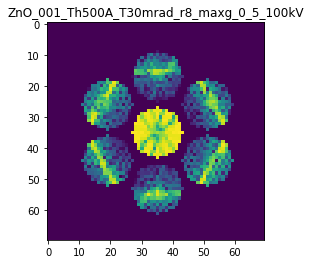

X_sim.max(): 0.9893804047754092
>>>replaced the 56. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 957ms/step - loss: 0.0029 - acc: 0.9200 - val_loss: 0.0057 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 619ms/step - loss: 0.0028 - acc: 0.9200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0029 - acc: 0.9200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0028 - acc: 0.9200 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0029 - acc: 0.9200 - val_loss: 0.0055 - val_acc: 0.9500


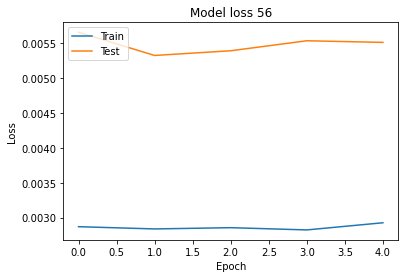

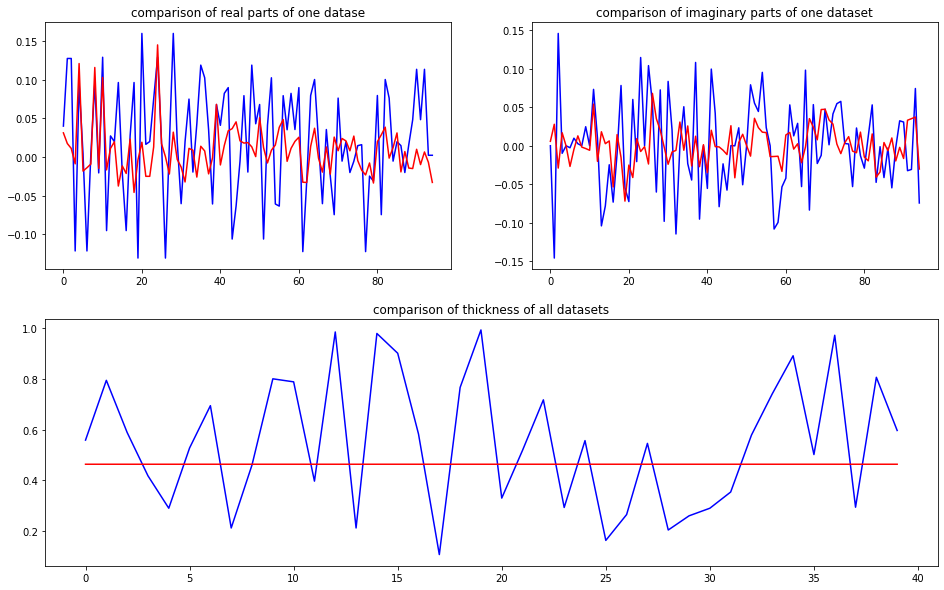

predicted thickness: 0.46367985


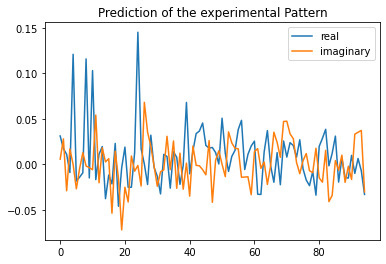

The offset applied on thickness: -0.00032316591869799494

The offset applied on Ug: 1.3052889829581522

Applied shift of unit cell origin (fractional coordinates): 0.01102740319225833 -0.005396058009568832 0.003065745851767471
Ug[ 0 ]: 0.03245 0.0  =>  0.03245 0.0
Ug[ 1 ]: 0.03248 1.07422  =>  0.03248 1.09348
Ug[ 2 ]: 0.03248 -1.07422  =>  0.03248 -1.09348
Ug[ 3 ]: 0.01557 2.36716  =>  0.01557 2.33325
Ug[ 4 ]: 0.13657 0.01464  =>  0.13657 0.0
Ug[ 5 ]: 0.02327 -2.15876  =>  0.02327 -2.21193
Ug[ 6 ]: 0.01557 -2.36716  =>  0.01557 -2.33325
Ug[ 7 ]: 0.02327 2.15876  =>  0.02327 2.21193
Ug[ 8 ]: 0.13657 -0.01464  =>  0.13657 -0.0
Ug[ 9 ]: 0.01392 -2.78173  =>  0.01392 -2.71244
Ug[ 10 ]: 0.14517 -0.08855  =>  0.14517 0.0
Ug[ 11 ]: 0.05581 1.83991  =>  0.05581 1.88994
Ug[ 12 ]: 0.02503 -0.77541  =>  0.02503 -0.67222
Ug[ 13 ]: 0.02846 0.82274  =>  0.02846 0.9452
Ug[ 14 ]: 0.04025 2.93142  =>  0.04025 3.01535
Ug[ 15 ]: 0.01392 2.78173  =>  0.01392 2.71244
Ug[ 16 ]: 0.05581 -1.83991  =>  0.05581

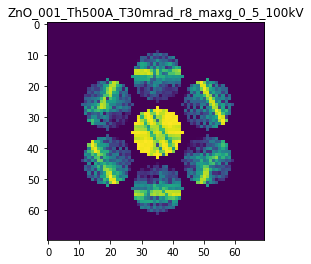

X_sim.max(): 0.9696824601728626
>>>replaced the 57. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 966ms/step - loss: 0.0028 - acc: 0.9200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 761ms/step - loss: 0.0028 - acc: 0.9200 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0027 - acc: 0.9200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0027 - acc: 0.9200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0028 - acc: 0.9200 - val_loss: 0.0053 - val_acc: 0.9500


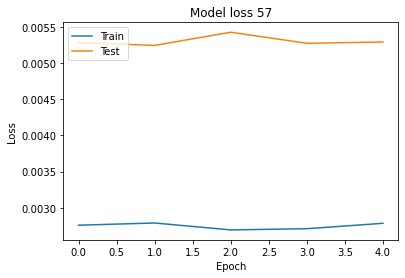

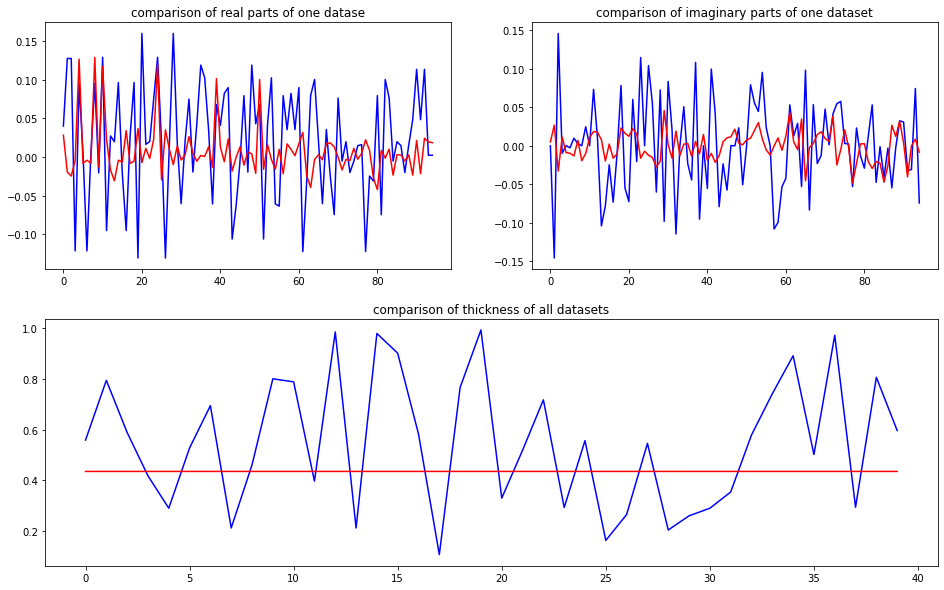

predicted thickness: 0.43526748


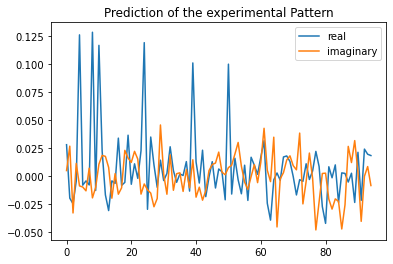

The offset applied on thickness: 0.0006772032911189803

The offset applied on Ug: 1.761154777924454

Applied shift of unit cell origin (fractional coordinates): 0.00022552544238546804 0.005145761276738188 -0.009219649831398804
Ug[ 0 ]: 0.02956 0.0  =>  0.02956 0.0
Ug[ 1 ]: 0.03548 2.16235  =>  0.03548 2.10442
Ug[ 2 ]: 0.03548 -2.16235  =>  0.03548 -2.10442
Ug[ 3 ]: 0.0129 1.89396  =>  0.0129 1.92629
Ug[ 4 ]: 0.15679 0.0256  =>  0.15679 -0.0
Ug[ 5 ]: 0.01145 -2.31921  =>  0.01145 -2.22895
Ug[ 6 ]: 0.0129 -1.89396  =>  0.0129 -1.92629
Ug[ 7 ]: 0.01145 2.31921  =>  0.01145 2.22895
Ug[ 8 ]: 0.15679 -0.0256  =>  0.15679 0.0
Ug[ 9 ]: 0.01112 -2.57847  =>  0.01112 -2.57705
Ug[ 10 ]: 0.14329 0.05651  =>  0.14329 0.0
Ug[ 11 ]: 0.03443 0.50792  =>  0.03443 0.56727
Ug[ 12 ]: 0.01871 2.25924  =>  0.01871 2.22833
Ug[ 13 ]: 0.03021 2.80379  =>  0.03021 2.71495
Ug[ 14 ]: 0.02193 -1.75854  =>  0.02193 -1.73152
Ug[ 15 ]: 0.01112 2.57847  =>  0.01112 2.57705
Ug[ 16 ]: 0.03443 -0.50792  =>  0.03443 -0.56

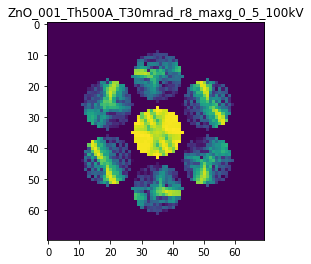

X_sim.max(): 0.9776773277501697
>>>replaced the 58. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 967ms/step - loss: 0.0026 - acc: 0.9200 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 622ms/step - loss: 0.0027 - acc: 0.9200 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0026 - acc: 0.9200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0027 - acc: 0.9200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0026 - acc: 0.9200 - val_loss: 0.0055 - val_acc: 0.9500


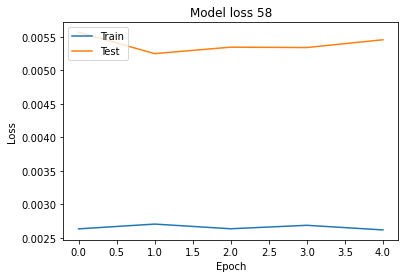

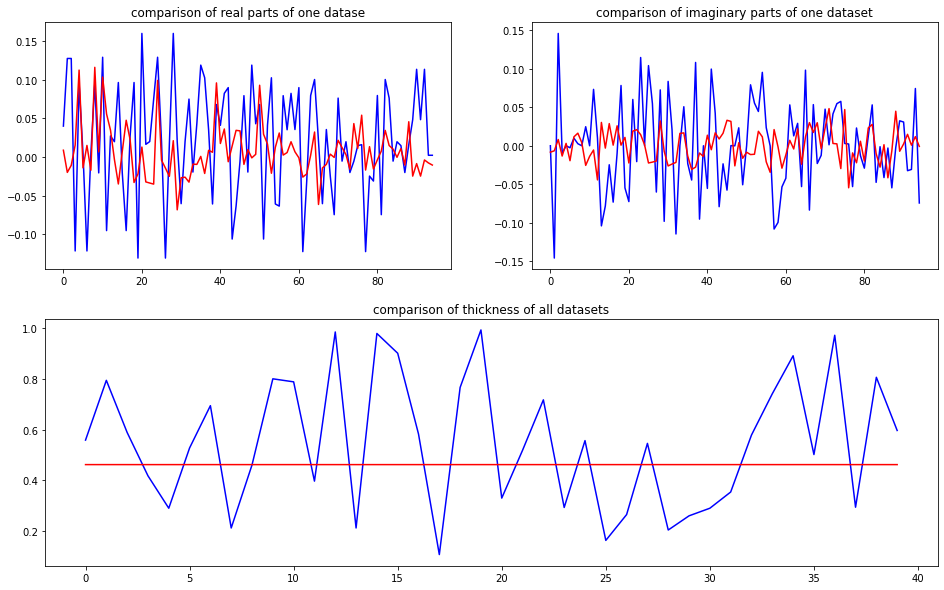

predicted thickness: 0.46221


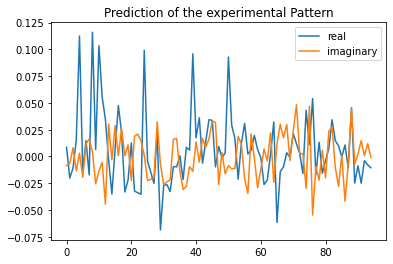

The offset applied on thickness: -0.0005211960837736128

The offset applied on Ug: 1.706141849365981

Applied shift of unit cell origin (fractional coordinates): 0.0017757156352589524 -0.004487133183422008 0.006427692553149852
Ug[ 0 ]: 0.00891 0.0  =>  0.00891 0.0
Ug[ 1 ]: 0.01656 -2.69629  =>  0.01656 -2.6559
Ug[ 2 ]: 0.01656 2.69629  =>  0.01656 2.6559
Ug[ 3 ]: 0.02007 -0.66778  =>  0.02007 -0.69597
Ug[ 4 ]: 0.13642 -0.01219  =>  0.13642 -0.0
Ug[ 5 ]: 0.02313 -2.25824  =>  0.02313 -2.32682
Ug[ 6 ]: 0.02007 0.66778  =>  0.02007 0.69597
Ug[ 7 ]: 0.02313 2.25824  =>  0.02313 2.32682
Ug[ 8 ]: 0.13642 0.01219  =>  0.13642 0.0
Ug[ 9 ]: 0.0285 -1.28023  =>  0.0285 -1.26908
Ug[ 10 ]: 0.11901 -0.05154  =>  0.11901 0.0
Ug[ 11 ]: 0.0561 -0.0396  =>  0.0561 -0.06883
Ug[ 12 ]: 0.04622 -0.80061  =>  0.04622 -0.76126
Ug[ 13 ]: 0.02682 1.66757  =>  0.02682 1.74731
Ug[ 14 ]: 0.03213 -3.08543  =>  0.03213 -3.08647
Ug[ 15 ]: 0.0285 1.28023  =>  0.0285 1.26908
Ug[ 16 ]: 0.0561 0.0396  =>  0.0561 0.06883

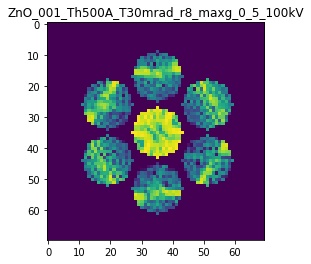

X_sim.max(): 0.9829471314881869
>>>replaced the 59. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 971ms/step - loss: 0.0027 - acc: 0.9200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 647ms/step - loss: 0.0028 - acc: 0.9200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 4s 872ms/step - loss: 0.0027 - acc: 0.9200 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0028 - acc: 0.9200 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0027 - acc: 0.9200 - val_loss: 0.0052 - val_acc: 0.9500


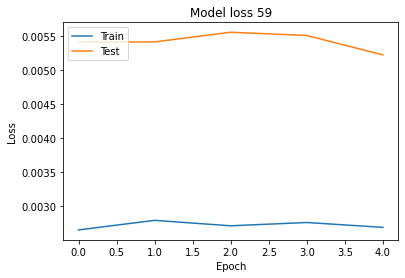

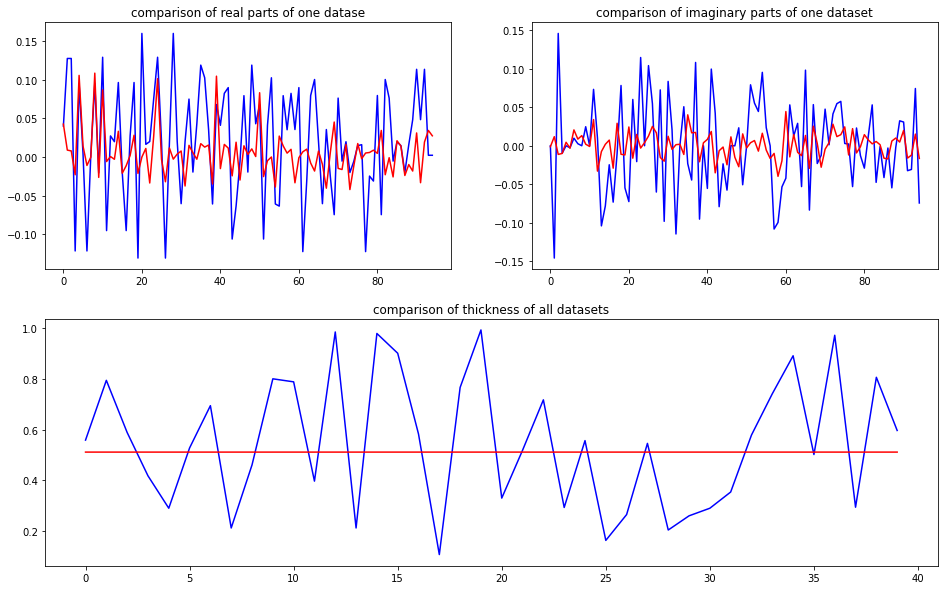

predicted thickness: 0.51161003


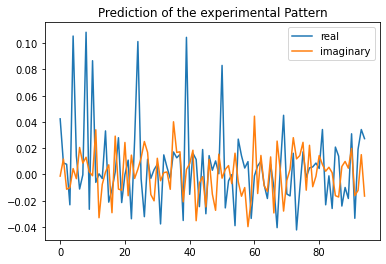

The offset applied on thickness: 0.0005327959160930738

The offset applied on Ug: 0.27773185204782674

Applied shift of unit cell origin (fractional coordinates): 0.0024594551371775737 0.0040372193332326375 0.0023764557380752307
Ug[ 0 ]: 0.0429 0.0  =>  0.0429 0.0
Ug[ 1 ]: 0.01422 0.94471  =>  0.01422 0.95964
Ug[ 2 ]: 0.01422 -0.94471  =>  0.01422 -0.95964
Ug[ 3 ]: 0.02281 -2.40695  =>  0.02281 -2.38158
Ug[ 4 ]: 0.11024 -0.0403  =>  0.11024 0.0
Ug[ 5 ]: 0.00915 -0.70031  =>  0.00915 -0.68987
Ug[ 6 ]: 0.02281 2.40695  =>  0.02281 2.38158
Ug[ 7 ]: 0.00915 0.70031  =>  0.00915 0.68987
Ug[ 8 ]: 0.11024 0.0403  =>  0.11024 0.0
Ug[ 9 ]: 0.02379 -3.03147  =>  0.02379 -3.01601
Ug[ 10 ]: 0.09651 -0.03038  =>  0.09651 -0.0
Ug[ 11 ]: 0.03272 1.83047  =>  0.03272 1.83099
Ug[ 12 ]: 0.0311 -1.52516  =>  0.0311 -1.53508
Ug[ 13 ]: 0.01057 -1.87177  =>  0.01057 -1.86675
Ug[ 14 ]: 0.03157 0.20821  =>  0.03157 0.18337
Ug[ 15 ]: 0.02379 3.03147  =>  0.02379 3.01601
Ug[ 16 ]: 0.03272 -1.83047  =>  0.03272 

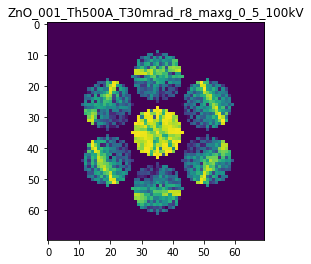

X_sim.max(): 0.967491065061724
>>>replaced the 60. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0026 - acc: 0.9200 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 994ms/step - loss: 0.0026 - acc: 0.9200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1000ms/step - loss: 0.0025 - acc: 0.9200 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 867ms/step - loss: 0.0026 - acc: 0.9200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 827ms/step - loss: 0.0027 - acc: 0.9200 - val_loss: 0.0054 - val_acc: 0.9500


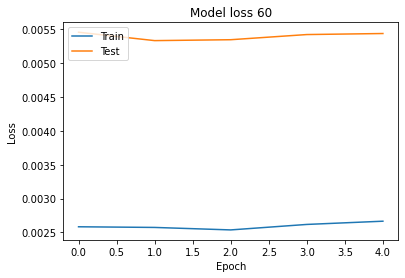

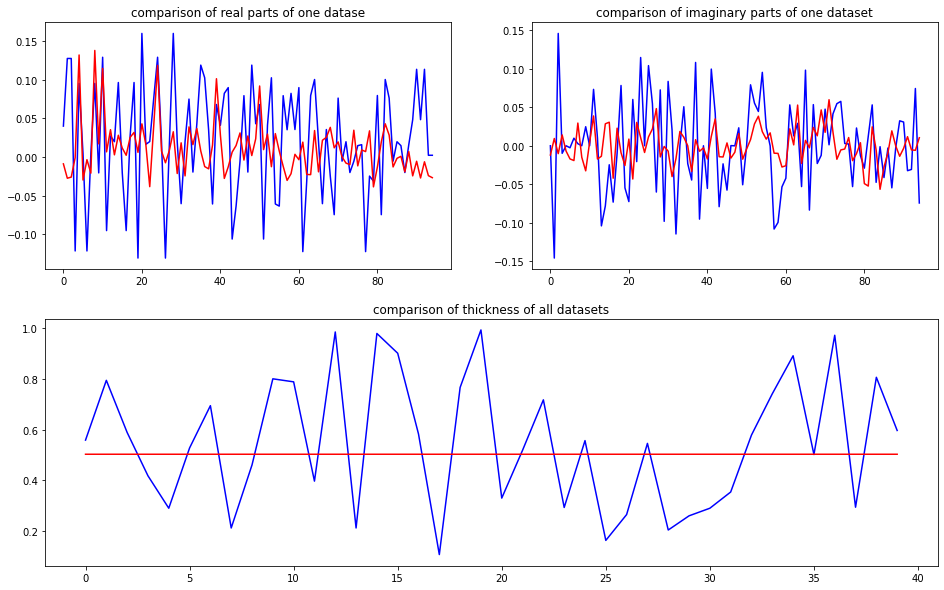

predicted thickness: 0.50317055


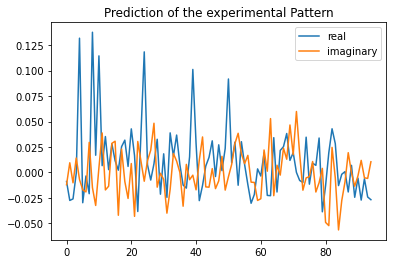

The offset applied on thickness: 0.0009502038454967201

The offset applied on Ug: -2.3049361732542675

Applied shift of unit cell origin (fractional coordinates): -0.002767242877657966 0.0024686114874181166 -0.010388283432200374
Ug[ 0 ]: 0.00951 3.14159  =>  0.00951 3.14159
Ug[ 1 ]: 0.03037 2.81443  =>  0.03037 2.74915
Ug[ 2 ]: 0.03037 -2.81443  =>  0.03037 -2.74915
Ug[ 3 ]: 0.01711 1.73939  =>  0.01711 1.7549
Ug[ 4 ]: 0.09271 0.04976  =>  0.09271 -0.0
Ug[ 5 ]: 0.03662 -2.45454  =>  0.03662 -2.37376
Ug[ 6 ]: 0.01711 -1.73939  =>  0.01711 -1.7549
Ug[ 7 ]: 0.03662 2.45454  =>  0.03662 2.37376
Ug[ 8 ]: 0.09271 -0.04976  =>  0.09271 0.0
Ug[ 9 ]: 0.03381 -1.22792  =>  0.03381 -1.24531
Ug[ 10 ]: 0.08538 0.08266  =>  0.08538 0.0
Ug[ 11 ]: 0.04079 1.55809  =>  0.04079 1.60598
Ug[ 12 ]: 0.03393 -0.64382  =>  0.03393 -0.67672
Ug[ 13 ]: 0.0134 -1.21731  =>  0.0134 -1.31548
Ug[ 14 ]: 0.03238 0.59791  =>  0.03238 0.63029
Ug[ 15 ]: 0.03381 1.22792  =>  0.03381 1.24531
Ug[ 16 ]: 0.04079 -1.55809  => 

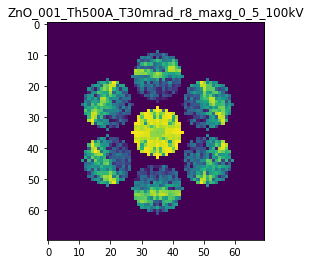

X_sim.max(): 0.9815994160922763
>>>replaced the 61. dataset and train: 
Epoch 1/5
5/5 [==============================] - 10s 2s/step - loss: 0.0027 - acc: 0.9200 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 986ms/step - loss: 0.0027 - acc: 0.9200 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0026 - acc: 0.9200 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0026 - acc: 0.9200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0026 - acc: 0.9200 - val_loss: 0.0054 - val_acc: 0.9500


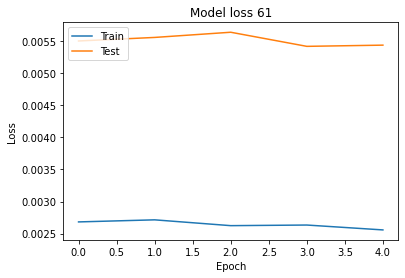

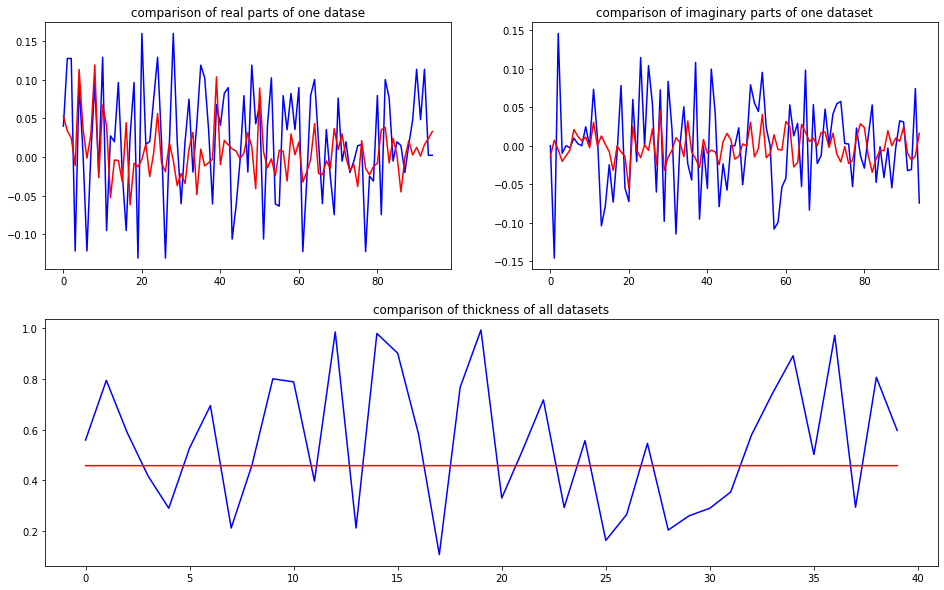

predicted thickness: 0.45806494


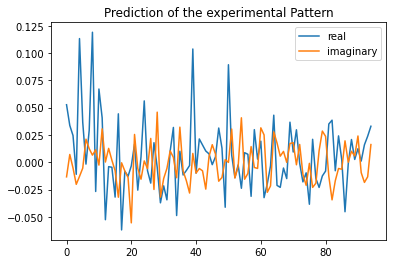

The offset applied on thickness: 0.00023452399419347935

The offset applied on Ug: 2.071407030546969

Applied shift of unit cell origin (fractional coordinates): -0.000545889305633218 0.012928486505473628 0.0003921540492334061
Ug[ 0 ]: 0.05876 0.0  =>  0.05876 0.0
Ug[ 1 ]: 0.03167 0.21863  =>  0.03167 0.22109
Ug[ 2 ]: 0.03167 -0.21863  =>  0.03167 -0.22109
Ug[ 3 ]: 0.0213 -1.82612  =>  0.0213 -1.74489
Ug[ 4 ]: 0.14477 -0.0837  =>  0.14477 -0.0
Ug[ 5 ]: 0.03641 -0.23425  =>  0.03641 -0.15548
Ug[ 6 ]: 0.0213 1.82612  =>  0.0213 1.74489
Ug[ 7 ]: 0.03641 0.23425  =>  0.03641 0.15548
Ug[ 8 ]: 0.14477 0.0837  =>  0.14477 0.0
Ug[ 9 ]: 0.02893 2.81125  =>  0.02893 2.80782
Ug[ 10 ]: 0.06951 0.00097  =>  0.06951 0.0
Ug[ 11 ]: 0.05718 0.56727  =>  0.05718 0.56138
Ug[ 12 ]: 0.05046 -3.13378  =>  0.05046 3.06474
Ug[ 13 ]: 0.0109 2.10794  =>  0.0109 2.02574
Ug[ 14 ]: 0.00794 2.48609  =>  0.00794 2.39897
Ug[ 15 ]: 0.02893 -2.81125  =>  0.02893 -2.80782
Ug[ 16 ]: 0.05718 -0.56727  =>  0.05718 -0.56138

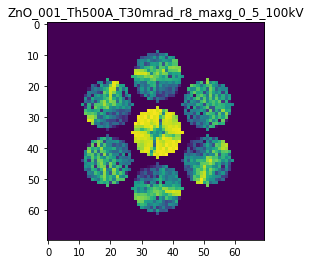

X_sim.max(): 0.9719347388852532
>>>replaced the 62. dataset and train: 
Epoch 1/5
5/5 [==============================] - 10s 1s/step - loss: 0.0025 - acc: 0.9200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0024 - acc: 0.9200 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0025 - acc: 0.9200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0025 - acc: 0.9200 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 6s 1s/step - loss: 0.0025 - acc: 0.9200 - val_loss: 0.0054 - val_acc: 0.9500


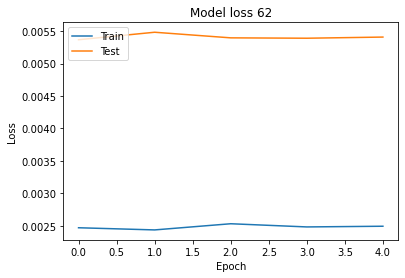

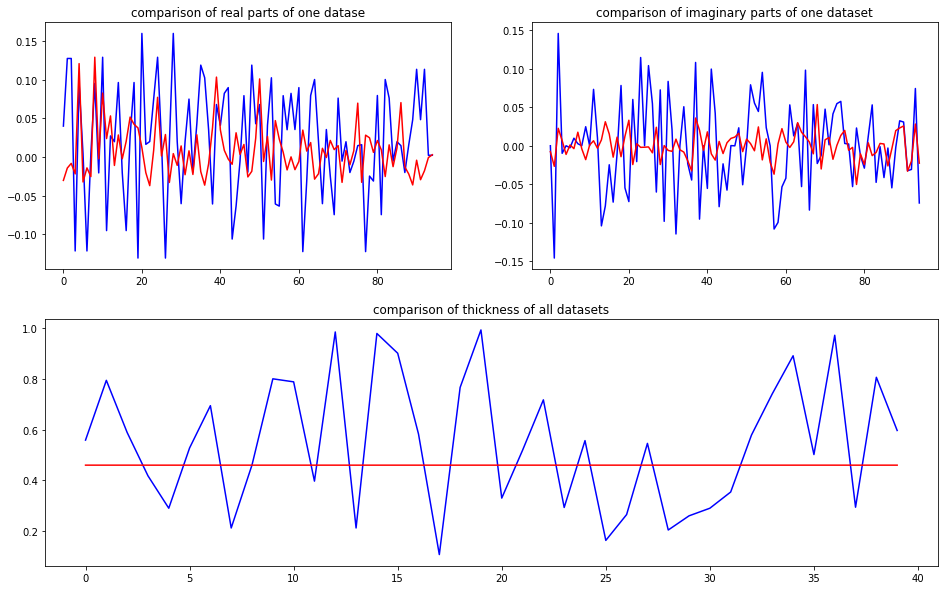

predicted thickness: 0.460063


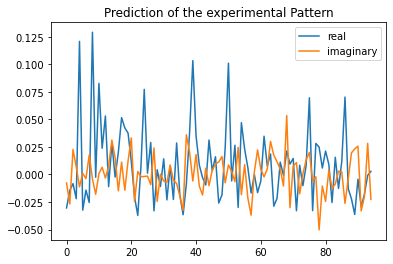

The offset applied on thickness: -0.000714178629322928

The offset applied on Ug: -0.1546615939135976

Applied shift of unit cell origin (fractional coordinates): -0.009364205305826328 -0.0022300751694008278 0.006783628210038869
Ug[ 0 ]: 0.03054 3.14159  =>  0.03054 3.14159
Ug[ 1 ]: 0.02729 -2.00685  =>  0.02729 -1.96423
Ug[ 2 ]: 0.02729 2.00685  =>  0.02729 1.96423
Ug[ 3 ]: 0.01888 2.86304  =>  0.01888 2.84903
Ug[ 4 ]: 0.12251 -0.02861  =>  0.12251 0.0
Ug[ 5 ]: 0.03024 -2.8624  =>  0.03024 -2.91903
Ug[ 6 ]: 0.01888 -2.86304  =>  0.01888 -2.84903
Ug[ 7 ]: 0.03024 2.8624  =>  0.03024 2.91903
Ug[ 8 ]: 0.12251 0.02861  =>  0.12251 -0.0
Ug[ 9 ]: 0.0168 -1.72057  =>  0.0168 -1.7794
Ug[ 10 ]: 0.07893 0.01621  =>  0.07893 0.0
Ug[ 11 ]: 0.02434 0.45278  =>  0.02434 0.35132
Ug[ 12 ]: 0.05236 -0.13849  =>  0.05236 -0.18332
Ug[ 13 ]: 0.00671 2.4027  =>  0.00671 2.4005
Ug[ 14 ]: 0.04176 0.57577  =>  0.04176 0.48832
Ug[ 15 ]: 0.0168 1.72057  =>  0.0168 1.7794
Ug[ 16 ]: 0.02434 -0.45278  =>  0.02434

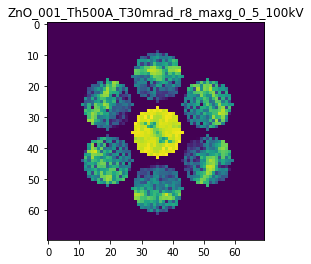

X_sim.max(): 0.975463368999255
>>>replaced the 63. dataset and train: 
Epoch 1/5
5/5 [==============================] - 11s 2s/step - loss: 0.0024 - acc: 0.9300 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0025 - acc: 0.9300 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0025 - acc: 0.9300 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0025 - acc: 0.9300 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0024 - acc: 0.9300 - val_loss: 0.0054 - val_acc: 0.9500


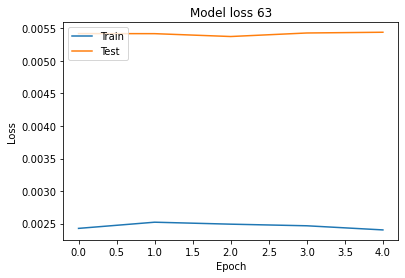

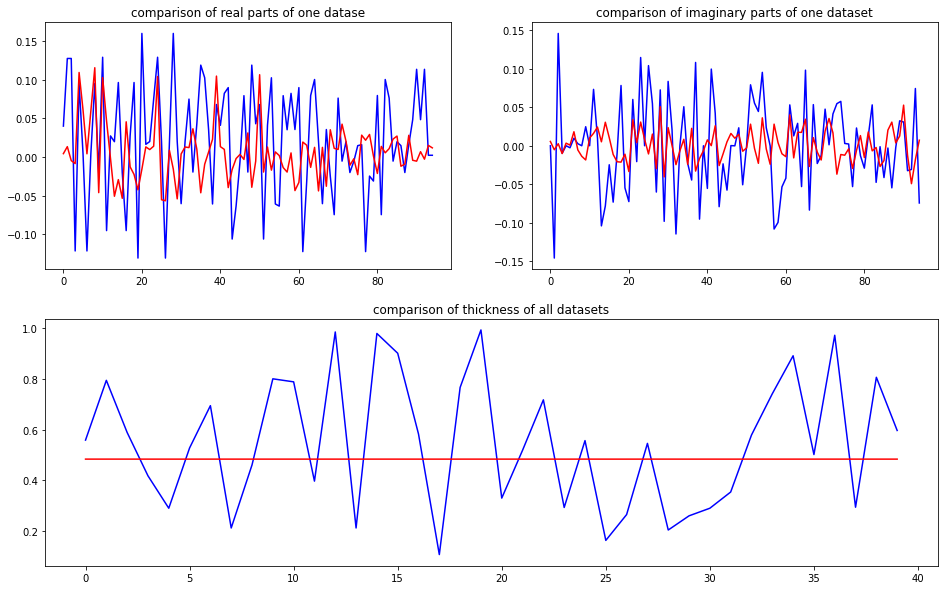

predicted thickness: 0.48389176


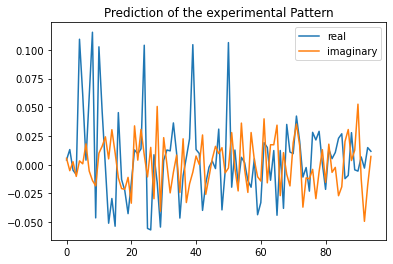

The offset applied on thickness: 0.0005403563351010745

The offset applied on Ug: -0.9290478407622603

Applied shift of unit cell origin (fractional coordinates): 0.004994929980871592 -0.007822950025595389 -0.006471947159210054
Ug[ 0 ]: 0.00417 0.0  =>  0.00417 0.0
Ug[ 1 ]: 0.00573 -0.76935  =>  0.00573 -0.81001
Ug[ 2 ]: 0.00573 0.76935  =>  0.00573 0.81001
Ug[ 3 ]: 0.01434 -1.74968  =>  0.01434 -1.79883
Ug[ 4 ]: 0.10094 0.08982  =>  0.10094 0.0
Ug[ 5 ]: 0.05695 0.0544  =>  0.05695 0.04591
Ug[ 6 ]: 0.01434 1.74968  =>  0.01434 1.79883
Ug[ 7 ]: 0.05695 -0.0544  =>  0.05695 -0.04591
Ug[ 8 ]: 0.10094 -0.08982  =>  0.10094 0.0
Ug[ 9 ]: 0.05435 -2.87763  =>  0.05435 -2.84625
Ug[ 10 ]: 0.09339 0.00928  =>  0.09339 0.0
Ug[ 11 ]: 0.04581 0.30254  =>  0.04581 0.37459
Ug[ 12 ]: 0.02391 1.90885  =>  0.02391 1.98939
Ug[ 13 ]: 0.0565 2.99667  =>  0.0565 3.03655
Ug[ 14 ]: 0.03739 2.39072  =>  0.03739 2.51192
Ug[ 15 ]: 0.05435 2.87763  =>  0.05435 2.84625
Ug[ 16 ]: 0.04581 -0.30254  =>  0.04581 -0.37

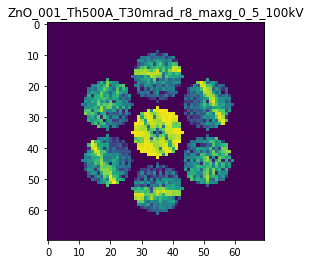

X_sim.max(): 0.9875367785369302
>>>replaced the 64. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0024 - acc: 0.9300 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0024 - acc: 0.9300 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0024 - acc: 0.9300 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0023 - acc: 0.9300 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0023 - acc: 0.9300 - val_loss: 0.0055 - val_acc: 0.9500


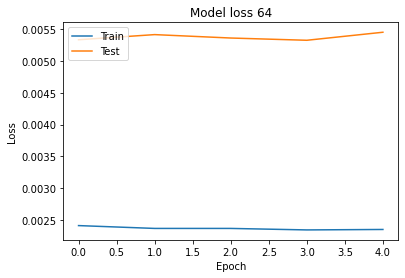

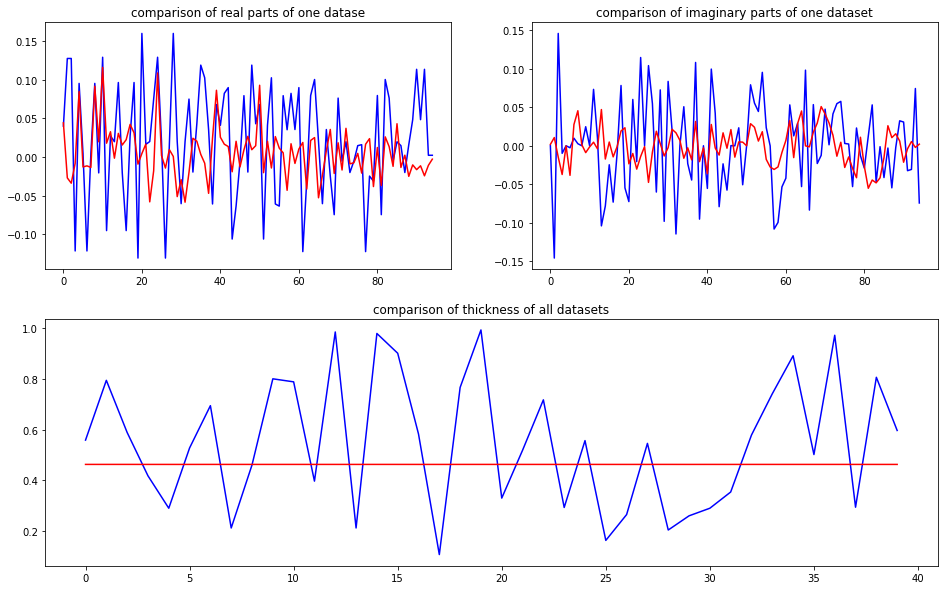

predicted thickness: 0.46301877


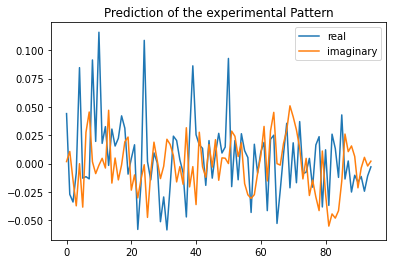

The offset applied on thickness: -0.0007636919080525163

The offset applied on Ug: -0.8104343253420997

Applied shift of unit cell origin (fractional coordinates): -0.0008265442292111467 -0.001066284399263538 0.0019299640722028036
Ug[ 0 ]: 0.04249 0.0  =>  0.04249 0.0
Ug[ 1 ]: 0.03405 2.75371  =>  0.03405 2.76584
Ug[ 2 ]: 0.03405 -2.75371  =>  0.03405 -2.76584
Ug[ 3 ]: 0.03445 -1.89263  =>  0.03445 -1.89933
Ug[ 4 ]: 0.08175 -0.00543  =>  0.08175 0.0
Ug[ 5 ]: 0.04431 -1.91256  =>  0.04431 -1.93139
Ug[ 6 ]: 0.03445 1.89263  =>  0.03445 1.89933
Ug[ 7 ]: 0.04431 1.91256  =>  0.04431 1.93139
Ug[ 8 ]: 0.08175 0.00543  =>  0.08175 0.0
Ug[ 9 ]: 0.01855 -0.3846  =>  0.01855 -0.38979
Ug[ 10 ]: 0.10208 -0.00693  =>  0.10208 0.0
Ug[ 11 ]: 0.02187 0.45834  =>  0.02187 0.44102
Ug[ 12 ]: 0.03619 -0.03119  =>  0.03619 -0.02968
Ug[ 13 ]: 0.04735 1.60929  =>  0.04735 1.62292
Ug[ 14 ]: 0.0349 -0.54801  =>  0.0349 -0.55863
Ug[ 15 ]: 0.01855 0.3846  =>  0.01855 0.38979
Ug[ 16 ]: 0.02187 -0.45834  =>  0.021

Residual error after kinematic rocking curve fit: 0.028225259868211727



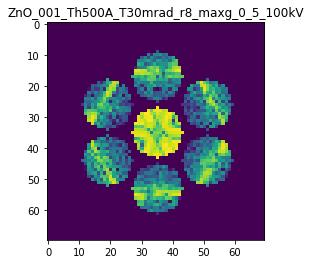

X_sim.max(): 0.9816077701143714
>>>replaced the 65. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 1s/step - loss: 0.0023 - acc: 0.9300 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 6s 1s/step - loss: 0.0023 - acc: 0.9300 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0022 - acc: 0.9300 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0022 - acc: 0.9300 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0023 - acc: 0.9300 - val_loss: 0.0053 - val_acc: 0.9500


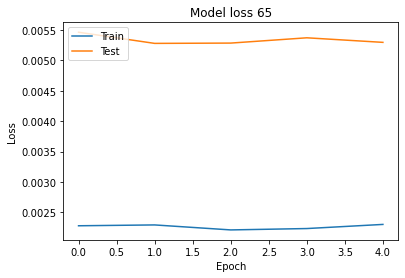

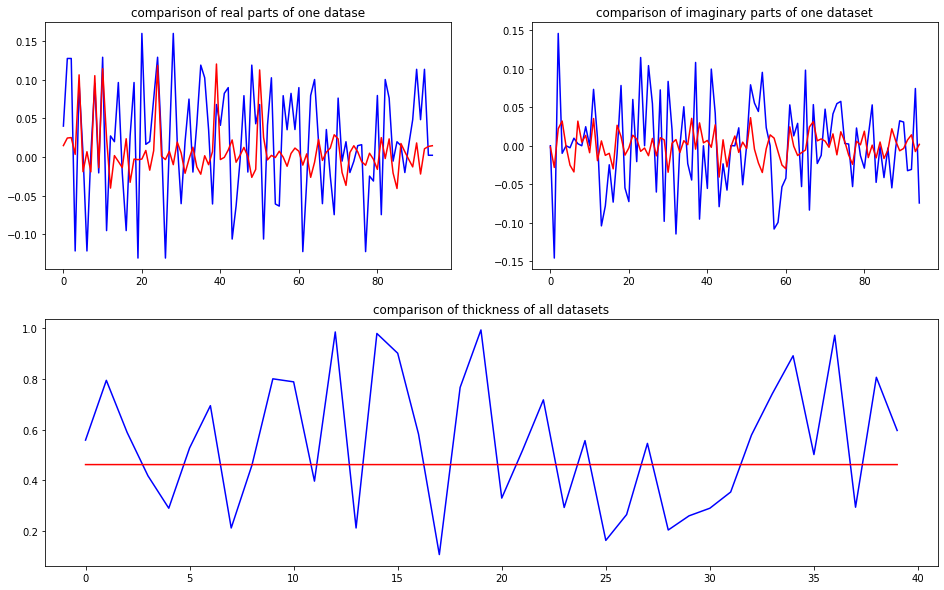

predicted thickness: 0.46226186


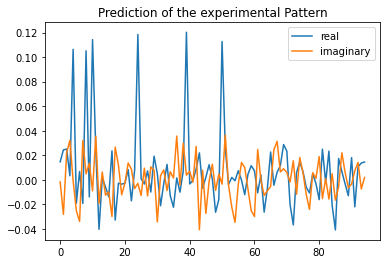

The offset applied on thickness: -0.0005106460556544015

The offset applied on Ug: 1.3820868790181624

Applied shift of unit cell origin (fractional coordinates): 0.003986553711029127 0.0025487767119103098 0.0007728482054183806
Ug[ 0 ]: 0.01493 0.0  =>  0.01493 0.0
Ug[ 1 ]: 0.03633 -0.75705  =>  0.03633 -0.75219
Ug[ 2 ]: 0.03633 0.75705  =>  0.03633 0.75219
Ug[ 3 ]: 0.03357 1.37543  =>  0.03357 1.39145
Ug[ 4 ]: 0.12116 -0.02087  =>  0.12116 0.0
Ug[ 5 ]: 0.03381 -2.11683  =>  0.03381 -2.10567
Ug[ 6 ]: 0.03357 -1.37543  =>  0.03357 -1.39145
Ug[ 7 ]: 0.03381 2.11683  =>  0.03381 2.10567
Ug[ 8 ]: 0.12116 0.02087  =>  0.12116 -0.0
Ug[ 9 ]: 0.01786 2.42398  =>  0.01786 2.44902
Ug[ 10 ]: 0.13513 -0.0299  =>  0.13513 0.0
Ug[ 11 ]: 0.04205 0.9019  =>  0.04205 0.92209
Ug[ 12 ]: 0.04097 -2.55017  =>  0.04097 -2.54114
Ug[ 13 ]: 0.00957 1.42416  =>  0.00957 1.43805
Ug[ 14 ]: 0.01288 -1.89703  =>  0.01288 -1.89285
Ug[ 15 ]: 0.01786 -2.42398  =>  0.01786 -2.44902
Ug[ 16 ]: 0.04205 -0.9019  =>  0.0420

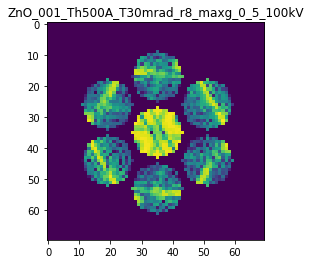

X_sim.max(): 0.9888254496766663
>>>replaced the 66. dataset and train: 
Epoch 1/5
5/5 [==============================] - 10s 2s/step - loss: 0.0023 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 897ms/step - loss: 0.0023 - acc: 0.9400 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0023 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0024 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0024 - acc: 0.9400 - val_loss: 0.0055 - val_acc: 0.9500


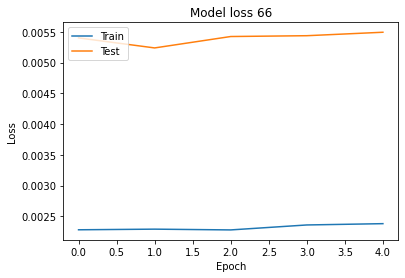

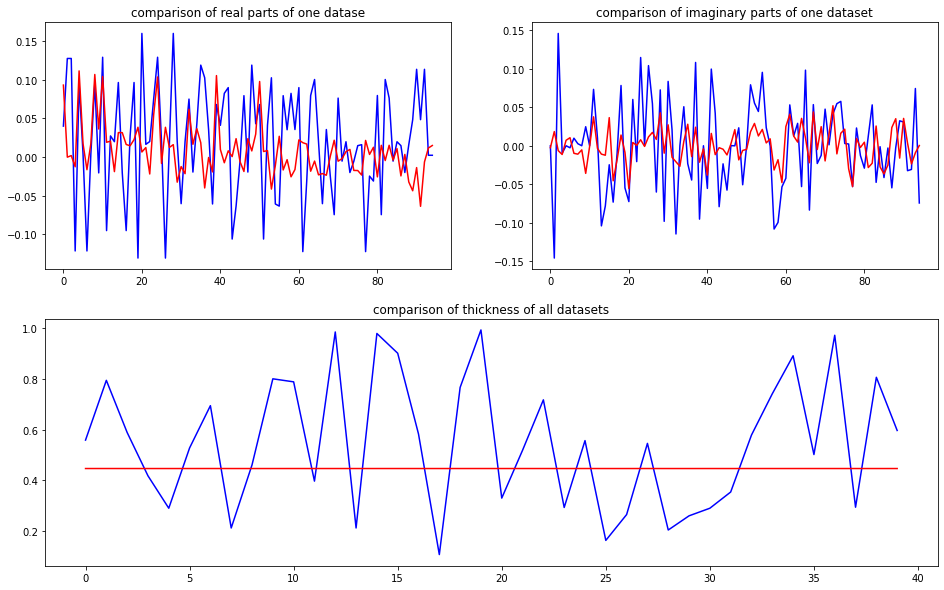

predicted thickness: 0.44671097


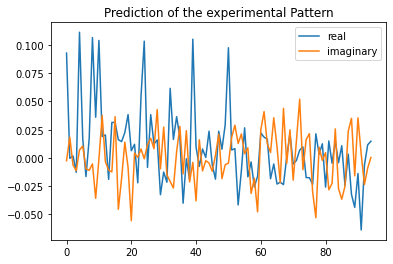

The offset applied on thickness: -0.0007035467071110615

The offset applied on Ug: -1.6344112177369086

Applied shift of unit cell origin (fractional coordinates): 0.004868738477317809 -0.005509507448827094 -0.004717445482484729
Ug[ 0 ]: 0.07879 0.0  =>  0.07879 0.0
Ug[ 1 ]: 0.01213 1.54284  =>  0.01213 1.5132
Ug[ 2 ]: 0.01213 -1.54284  =>  0.01213 -1.5132
Ug[ 3 ]: 0.01526 -3.09472  =>  0.01526 -3.12933
Ug[ 4 ]: 0.0897 0.06426  =>  0.0897 0.0
Ug[ 5 ]: 0.01973 0.57401  =>  0.01973 0.56903
Ug[ 6 ]: 0.01526 3.09472  =>  0.01526 3.12933
Ug[ 7 ]: 0.01973 -0.57401  =>  0.01973 -0.56903
Ug[ 8 ]: 0.0897 -0.06426  =>  0.0897 0.0
Ug[ 9 ]: 0.04694 -0.88552  =>  0.04694 -0.85493
Ug[ 10 ]: 0.08618 -0.00095  =>  0.08618 0.0
Ug[ 11 ]: 0.04434 1.24553  =>  0.04434 1.30576
Ug[ 12 ]: 0.01821 0.42347  =>  0.01821 0.48868
Ug[ 13 ]: 0.01836 -2.46532  =>  0.01836 -2.42975
Ug[ 14 ]: 0.02872 -0.48736  =>  0.02872 -0.39251
Ug[ 15 ]: 0.04694 0.88552  =>  0.04694 0.85493
Ug[ 16 ]: 0.04434 -1.24553  =>  0.04434 -

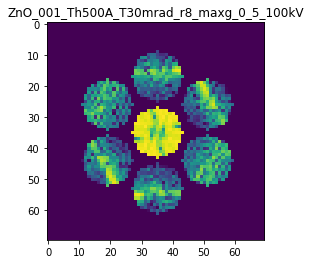

X_sim.max(): 0.9690688932723354
>>>replaced the 67. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 0.0023 - acc: 0.9400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 892ms/step - loss: 0.0023 - acc: 0.9400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 974ms/step - loss: 0.0023 - acc: 0.9400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0023 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0023 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500


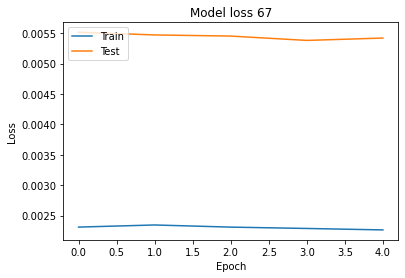

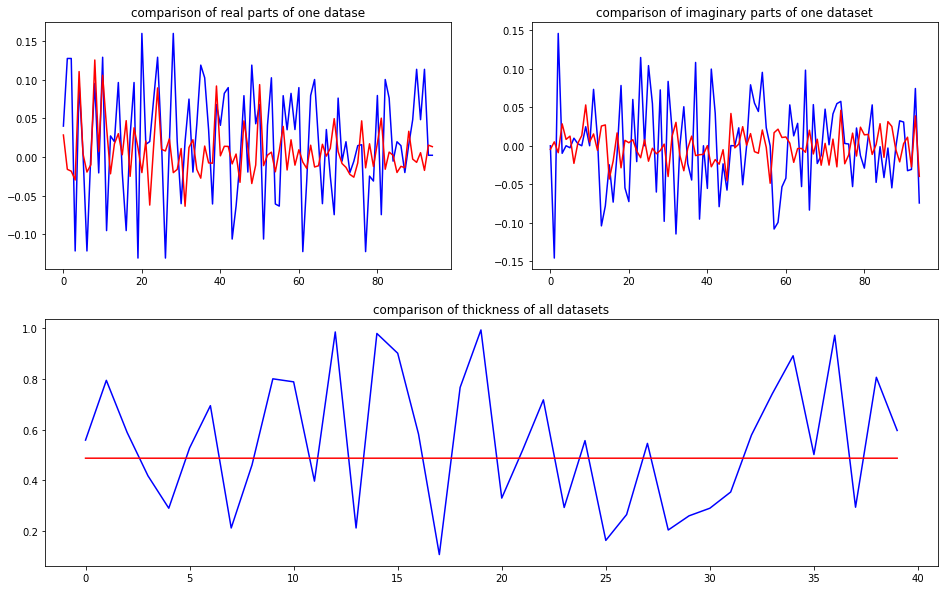

predicted thickness: 0.48750332


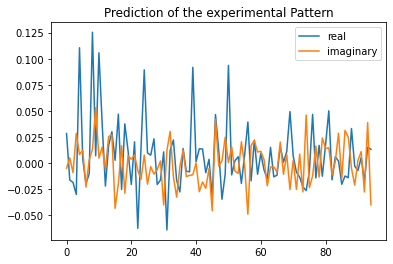

The offset applied on thickness: 0.0007837160303868227

The offset applied on Ug: -1.8049195041813553

Applied shift of unit cell origin (fractional coordinates): -0.003938429798281442 -0.008063564499691664 0.00983628191276196
Ug[ 0 ]: 0.02686 0.0  =>  0.02686 0.0
Ug[ 1 ]: 0.0193 2.76056  =>  0.0193 2.82236
Ug[ 2 ]: 0.0193 -2.76056  =>  0.0193 -2.82236
Ug[ 3 ]: 0.03678 2.40024  =>  0.03678 2.34957
Ug[ 4 ]: 0.09252 -0.01114  =>  0.09252 -0.0
Ug[ 5 ]: 0.00561 2.2083  =>  0.00561 2.09584
Ug[ 6 ]: 0.03678 -2.40024  =>  0.03678 -2.34957
Ug[ 7 ]: 0.00561 -2.2083  =>  0.00561 -2.09584
Ug[ 8 ]: 0.09252 0.01114  =>  0.09252 0.0
Ug[ 9 ]: 0.04728 1.55667  =>  0.04728 1.53192
Ug[ 10 ]: 0.08022 -0.03706  =>  0.08022 0.0
Ug[ 11 ]: 0.04271 0.44164  =>  0.04271 0.35509
Ug[ 12 ]: 0.02707 -2.72858  =>  0.02707 -2.70266
Ug[ 13 ]: 0.02547 1.07804  =>  0.02547 1.16576
Ug[ 14 ]: 0.04154 0.75057  =>  0.04154 0.71469
Ug[ 15 ]: 0.04728 -1.55667  =>  0.04728 -1.53192
Ug[ 16 ]: 0.04271 -0.44164  =>  0.04271 -0.3

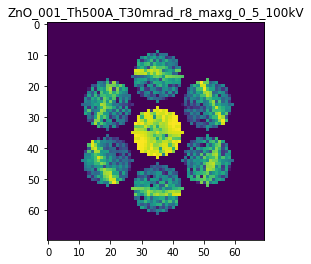

X_sim.max(): 0.9807938823496821
>>>replaced the 68. dataset and train: 
Epoch 1/5
5/5 [==============================] - 10s 2s/step - loss: 0.0022 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0022 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0022 - acc: 0.9400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0022 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 6s 1s/step - loss: 0.0021 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500


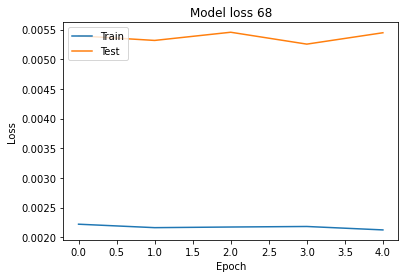

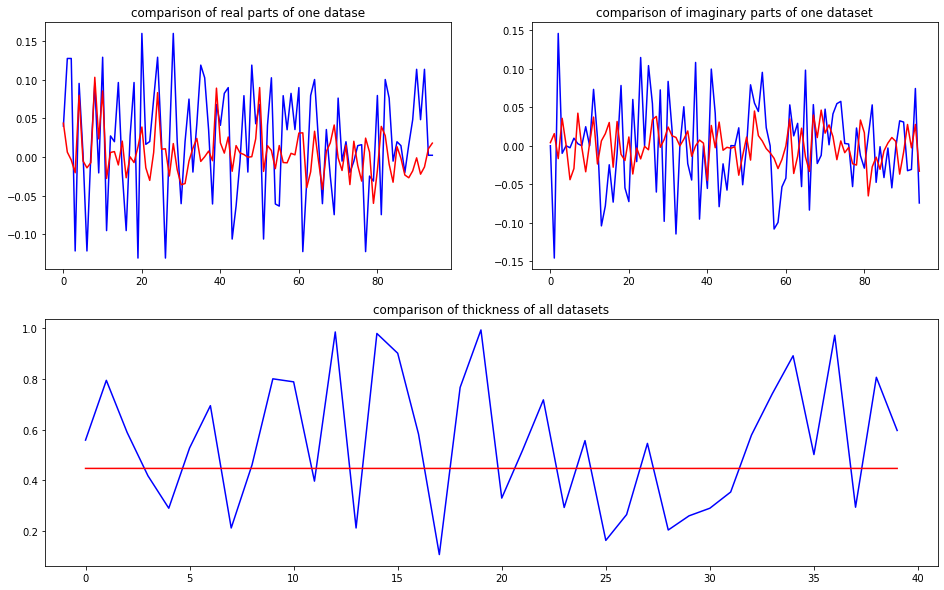

predicted thickness: 0.447212


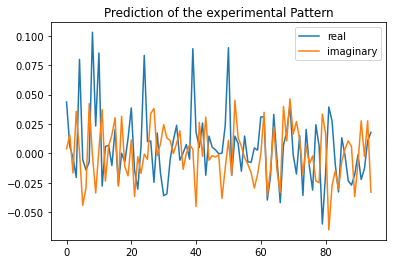

The offset applied on thickness: -0.0002949846450835962

The offset applied on Ug: 1.2320900211336796

Applied shift of unit cell origin (fractional coordinates): -0.0068396107600367075 0.00030897777620547966 0.0029106524051267044
Ug[ 0 ]: 0.04599 0.0  =>  0.04599 0.0
Ug[ 1 ]: 0.01629 1.4832  =>  0.01629 1.50149
Ug[ 2 ]: 0.01629 -1.4832  =>  0.01629 -1.50149
Ug[ 3 ]: 0.03651 2.01283  =>  0.03651 2.01477
Ug[ 4 ]: 0.10189 -0.02023  =>  0.10189 0.0
Ug[ 5 ]: 0.04334 -1.6615  =>  0.04334 -1.67785
Ug[ 6 ]: 0.03651 -2.01283  =>  0.03651 -2.01477
Ug[ 7 ]: 0.04334 1.6615  =>  0.04334 1.67785
Ug[ 8 ]: 0.10189 0.02023  =>  0.10189 0.0
Ug[ 9 ]: 0.03963 -0.93016  =>  0.03963 -0.97313
Ug[ 10 ]: 0.09312 0.02469  =>  0.09312 0.0
Ug[ 11 ]: 0.04146 2.22279  =>  0.04146 2.16152
Ug[ 12 ]: 0.0281 -1.43102  =>  0.0281 -1.47594
Ug[ 13 ]: 0.01028 0.5897  =>  0.01028 0.56307
Ug[ 14 ]: 0.01598 2.13453  =>  0.01598 2.07133
Ug[ 15 ]: 0.03963 0.93016  =>  0.03963 0.97313
Ug[ 16 ]: 0.04146 -2.22279  =>  0.04146 -2.

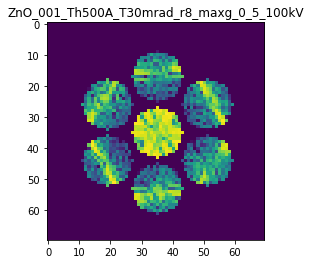

X_sim.max(): 0.9235514666244101
>>>replaced the 69. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 1s/step - loss: 0.0020 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0021 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0021 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0021 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0021 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500


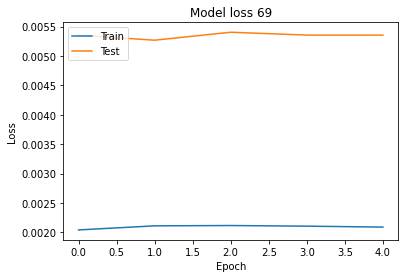

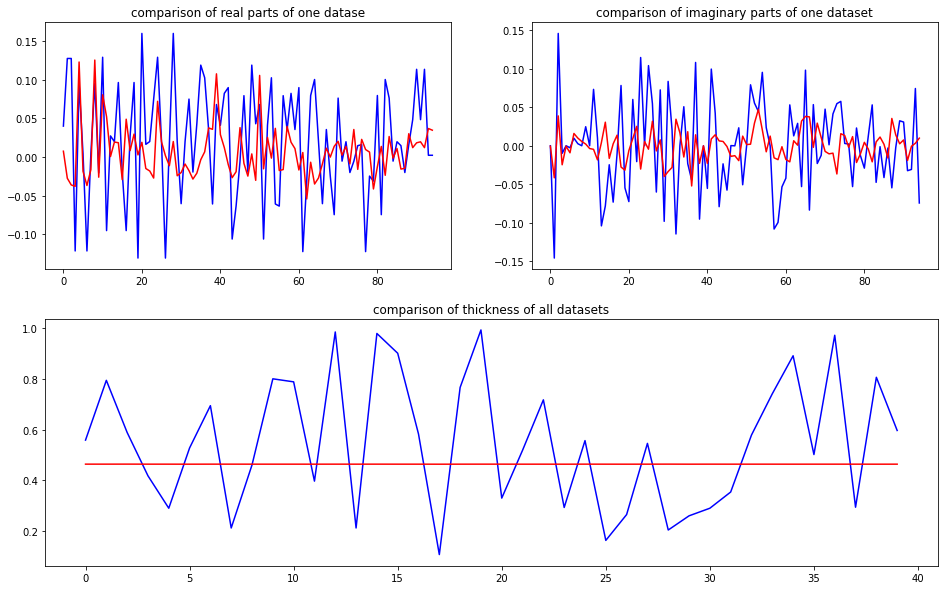

predicted thickness: 0.46406856


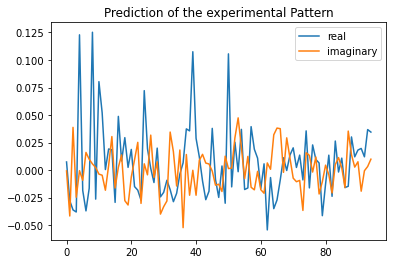

The offset applied on thickness: -0.0003173939411492797

The offset applied on Ug: -0.3218788772245646

Applied shift of unit cell origin (fractional coordinates): 0.0025548891244744037 -0.0038650009969277348 0.007845448139932671
Ug[ 0 ]: 0.00733 0.0  =>  0.00733 0.0
Ug[ 1 ]: 0.05196 -2.2565  =>  0.05196 -2.20721
Ug[ 2 ]: 0.05196 2.2565  =>  0.05196 2.20721
Ug[ 3 ]: 0.04333 -2.65047  =>  0.04333 -2.67476
Ug[ 4 ]: 0.11913 -0.02501  =>  0.11913 -0.0
Ug[ 5 ]: 0.0201 -2.64372  =>  0.0201 -2.7173
Ug[ 6 ]: 0.04333 2.65047  =>  0.04333 2.67476
Ug[ 7 ]: 0.0201 2.64372  =>  0.0201 2.7173
Ug[ 8 ]: 0.11913 0.02501  =>  0.11913 0.0
Ug[ 9 ]: 0.0297 2.8211  =>  0.0297 2.83715
Ug[ 10 ]: 0.07452 -0.06535  =>  0.07452 -0.0
Ug[ 11 ]: 0.04971 -0.07336  =>  0.04971 -0.1066
Ug[ 12 ]: 0.01661 -1.3125  =>  0.01661 -1.27216
Ug[ 13 ]: 0.0196 0.21759  =>  0.0196 0.30722
Ug[ 14 ]: 0.03744 0.89327  =>  0.03744 0.88432
Ug[ 15 ]: 0.0297 -2.8211  =>  0.0297 -2.83715
Ug[ 16 ]: 0.04971 0.07336  =>  0.04971 0.1066
Ug[ 

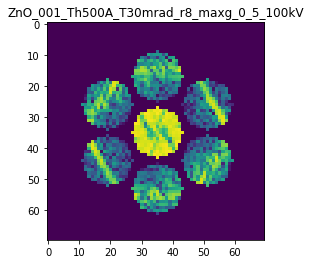

X_sim.max(): 0.9740998084853572
>>>replaced the 70. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 954ms/step - loss: 0.0021 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 921ms/step - loss: 0.0020 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0021 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0020 - acc: 0.9400 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0021 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500


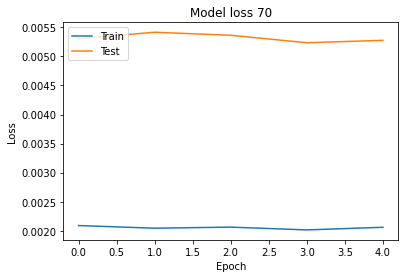

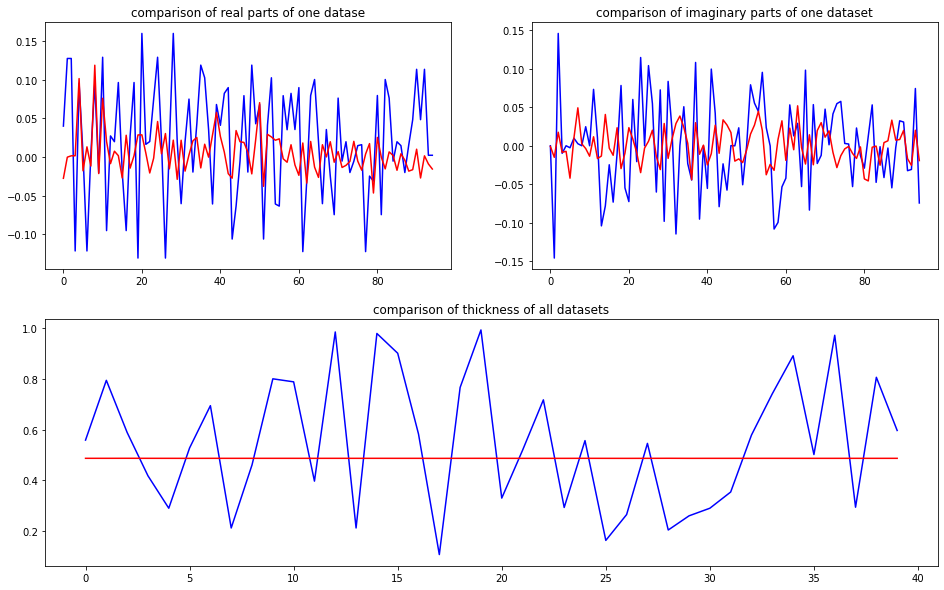

predicted thickness: 0.48715502


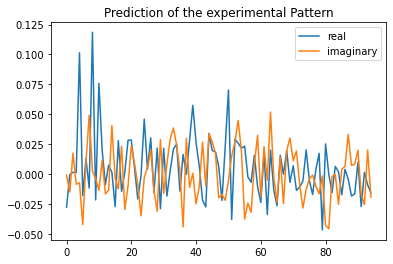

The offset applied on thickness: -2.242465768845059e-05

The offset applied on Ug: 0.11188771582398659

Applied shift of unit cell origin (fractional coordinates): 0.006836523886849892 0.0008700440434884712 0.0064889162791481655
Ug[ 0 ]: 0.02761 3.14159  =>  0.02761 3.14159
Ug[ 1 ]: 0.01631 -1.53756  =>  0.01631 -1.49679
Ug[ 2 ]: 0.01631 1.53756  =>  0.01631 1.49679
Ug[ 3 ]: 0.01182 -0.90879  =>  0.01182 -0.90332
Ug[ 4 ]: 0.11149 -0.04624  =>  0.11149 0.0
Ug[ 5 ]: 0.04804 -1.87906  =>  0.04804 -1.91437
Ug[ 6 ]: 0.01182 0.90879  =>  0.01182 0.90332
Ug[ 7 ]: 0.04804 1.87906  =>  0.04804 1.91437
Ug[ 8 ]: 0.11149 0.04624  =>  0.11149 0.0
Ug[ 9 ]: 0.02436 -3.13013  =>  0.02436 -3.08718
Ug[ 10 ]: 0.06159 -0.08373  =>  0.06159 -0.0
Ug[ 11 ]: 0.02685 0.46398  =>  0.02685 0.46616
Ug[ 12 ]: 0.02314 -2.09266  =>  0.02314 -2.05517
Ug[ 13 ]: 0.01116 -1.03809  =>  0.01116 -0.95983
Ug[ 14 ]: 0.03526 1.52123  =>  0.03526 1.51795
Ug[ 15 ]: 0.02436 3.13013  =>  0.02436 3.08718
Ug[ 16 ]: 0.02685 -0.46398

Residual error after kinematic rocking curve fit: 0.029308919455908248



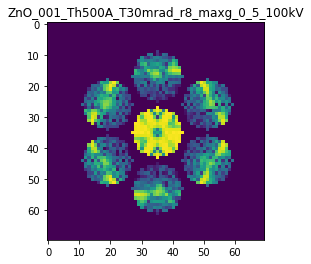

X_sim.max(): 0.9899426409818706
>>>replaced the 71. dataset and train: 
Epoch 1/5
5/5 [==============================] - 11s 2s/step - loss: 0.0021 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0021 - acc: 0.9400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0021 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 879ms/step - loss: 0.0021 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0020 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500


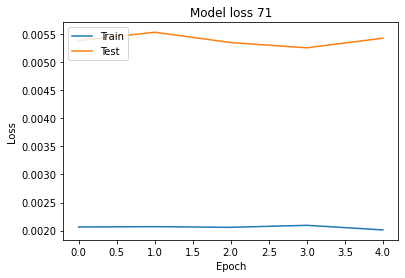

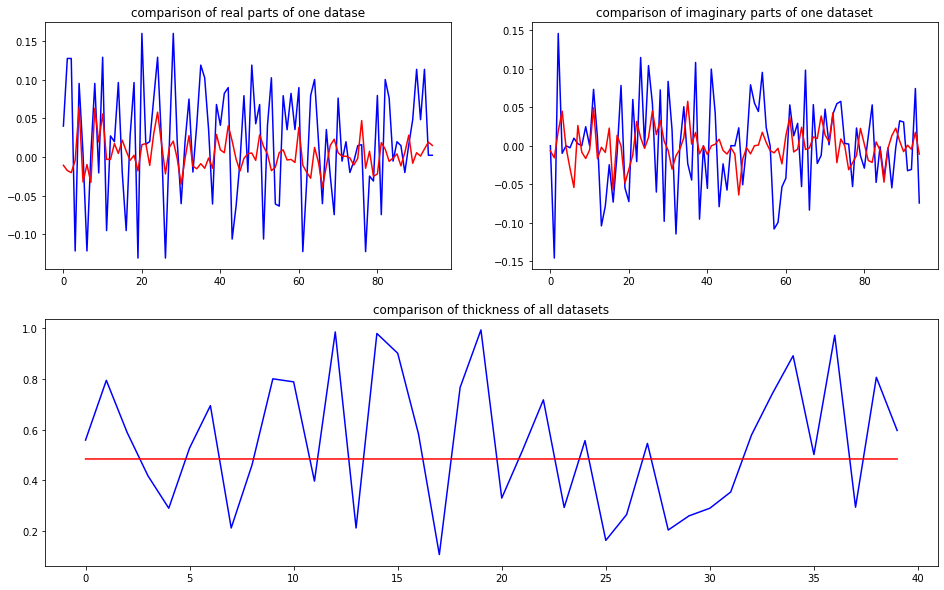

predicted thickness: 0.48449525


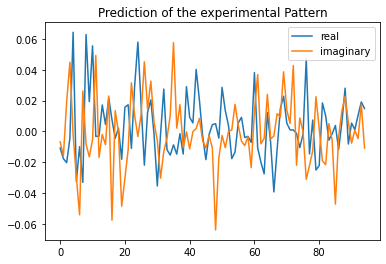

The offset applied on thickness: 0.00046250224169519917

The offset applied on Ug: 1.3910029221140723

Applied shift of unit cell origin (fractional coordinates): 0.008390334414414885 -0.0021236021164520325 -0.005111511670029716
Ug[ 0 ]: 0.01061 3.14159  =>  0.01061 3.14159
Ug[ 1 ]: 0.02515 -2.37486  =>  0.02515 -2.40698
Ug[ 2 ]: 0.02515 2.37486  =>  0.02515 2.40698
Ug[ 3 ]: 0.04906 1.64666  =>  0.04906 1.63332
Ug[ 4 ]: 0.06944 0.04546  =>  0.06944 0.0
Ug[ 5 ]: 0.04108 -2.3966  =>  0.04108 -2.37783
Ug[ 6 ]: 0.04906 -1.64666  =>  0.04906 -1.63332
Ug[ 7 ]: 0.04108 2.3966  =>  0.04108 2.37783
Ug[ 8 ]: 0.06944 -0.04546  =>  0.06944 -0.0
Ug[ 9 ]: 0.02948 -0.74615  =>  0.02948 -0.69343
Ug[ 10 ]: 0.06131 -0.0206  =>  0.06131 -0.0
Ug[ 11 ]: 0.05314 1.45308  =>  0.05314 1.53791
Ug[ 12 ]: 0.0155 -1.79398  =>  0.0155 -1.72792
Ug[ 13 ]: 0.01887 -0.35192  =>  0.01887 -0.31797
Ug[ 14 ]: 0.00531 -0.88442  =>  0.00531 -0.78624
Ug[ 15 ]: 0.02948 0.74615  =>  0.02948 0.69343
Ug[ 16 ]: 0.05314 -1.45308  

Residual error after kinematic rocking curve fit: 0.027507452614614916



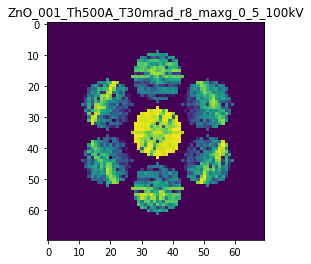

X_sim.max(): 0.9824673163370782
>>>replaced the 72. dataset and train: 
Epoch 1/5
5/5 [==============================] - 11s 2s/step - loss: 0.0019 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0020 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0020 - acc: 0.9400 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0019 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0020 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500


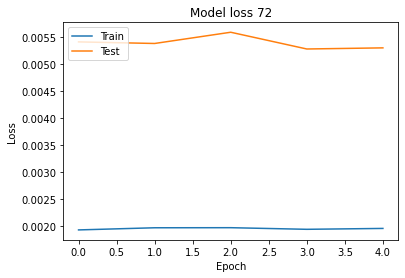

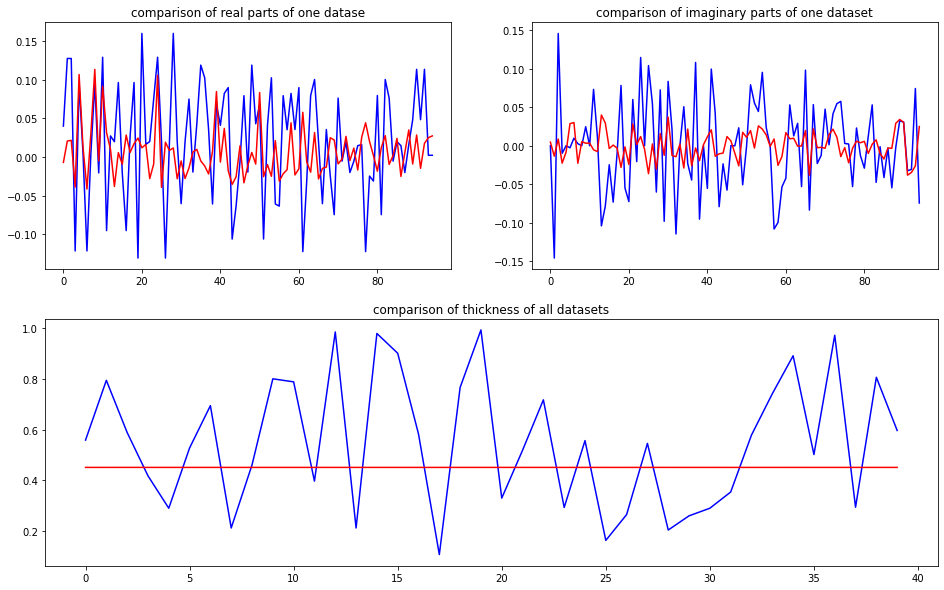

predicted thickness: 0.45121753


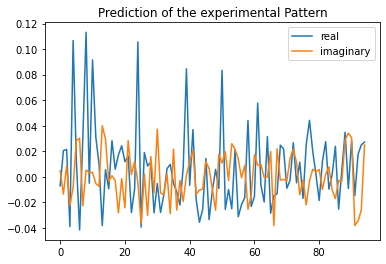

The offset applied on thickness: -0.0004827036958961042

The offset applied on Ug: 1.9063468575733187

Applied shift of unit cell origin (fractional coordinates): -0.008980765451013242 0.0013724905125570206 0.009467366207350248
Ug[ 0 ]: 0.00696 3.14159  =>  0.00696 3.14159
Ug[ 1 ]: 0.02465 -0.46473  =>  0.02465 -0.40525
Ug[ 2 ]: 0.02465 0.46473  =>  0.02465 0.40525
Ug[ 3 ]: 0.04484 -2.49828  =>  0.04484 -2.48966
Ug[ 4 ]: 0.13341 -0.06811  =>  0.13341 0.0
Ug[ 5 ]: 0.03455 0.81443  =>  0.03455 0.76357
Ug[ 6 ]: 0.04484 2.49828  =>  0.04484 2.48966
Ug[ 7 ]: 0.03455 -0.81443  =>  0.03455 -0.76357
Ug[ 8 ]: 0.13341 0.06811  =>  0.13341 0.0
Ug[ 9 ]: 0.00791 2.69707  =>  0.00791 2.64065
Ug[ 10 ]: 0.11719 -0.00306  =>  0.11719 -0.0
Ug[ 11 ]: 0.03162 -0.089  =>  0.03162 -0.20491
Ug[ 12 ]: 0.0083 -0.26678  =>  0.0083 -0.33183
Ug[ 13 ]: 0.05065 2.28529  =>  0.05065 2.27973
Ug[ 14 ]: 0.03152 1.13726  =>  0.03152 1.01272
Ug[ 15 ]: 0.00791 -2.69707  =>  0.00791 -2.64065
Ug[ 16 ]: 0.03162 0.089  =>  0.

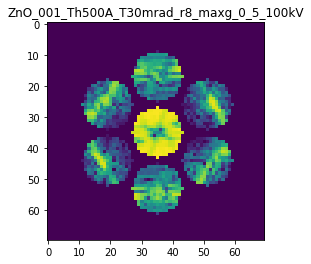

X_sim.max(): 0.9869138885314499
>>>replaced the 73. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 958ms/step - loss: 0.0019 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 971ms/step - loss: 0.0019 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0019 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0019 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0019 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500


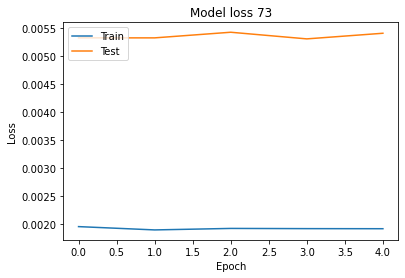

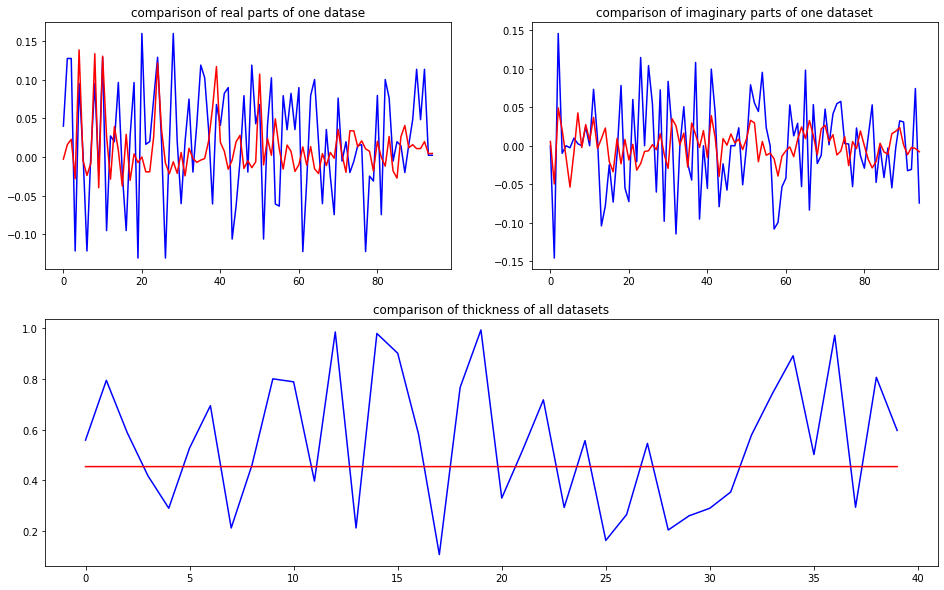

predicted thickness: 0.45437953


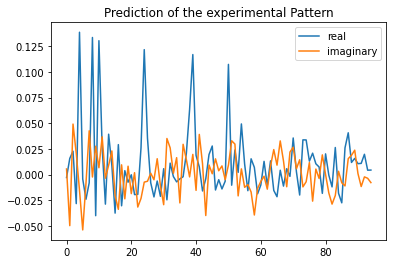

The offset applied on thickness: -0.00018627025281195954

The offset applied on Ug: -1.8508573234774652

Applied shift of unit cell origin (fractional coordinates): -0.00690005627643187 0.014259059012002149 -0.003267083309310846
Ug[ 0 ]: 0.00291 3.14159  =>  0.00291 3.14159
Ug[ 1 ]: 0.05128 -1.29397  =>  0.05128 -1.3145
Ug[ 2 ]: 0.05128 1.29397  =>  0.05128 1.3145
Ug[ 3 ]: 0.03118 2.67645  =>  0.03118 2.76604
Ug[ 4 ]: 0.1018 -0.06906  =>  0.1018 0.0
Ug[ 5 ]: 0.05034 -1.78212  =>  0.05034 -1.672
Ug[ 6 ]: 0.03118 -2.67645  =>  0.03118 -2.76604
Ug[ 7 ]: 0.05034 1.78212  =>  0.05034 1.672
Ug[ 8 ]: 0.1018 0.06906  =>  0.1018 -0.0
Ug[ 9 ]: 0.04865 2.63918  =>  0.04865 2.59583
Ug[ 10 ]: 0.0967 0.06388  =>  0.0967 -0.0
Ug[ 11 ]: 0.04272 0.96911  =>  0.04272 0.94628
Ug[ 12 ]: 0.03192 -2.94231  =>  0.03192 -3.07525
Ug[ 13 ]: 0.03547 0.21433  =>  0.03547 0.06085
Ug[ 14 ]: 0.02384 1.35455  =>  0.02384 1.24213
Ug[ 15 ]: 0.04865 -2.63918  =>  0.04865 -2.59583
Ug[ 16 ]: 0.04272 -0.96911  =>  0.04272 

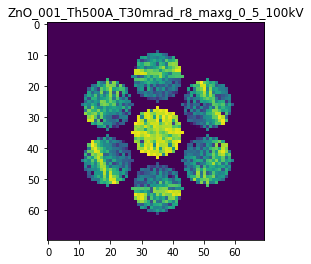

X_sim.max(): 0.9563957643838489
>>>replaced the 74. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 0.0019 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 4s 991ms/step - loss: 0.0019 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 999ms/step - loss: 0.0019 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0019 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0019 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500


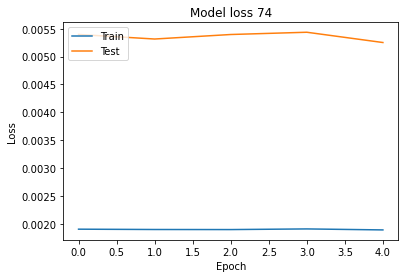

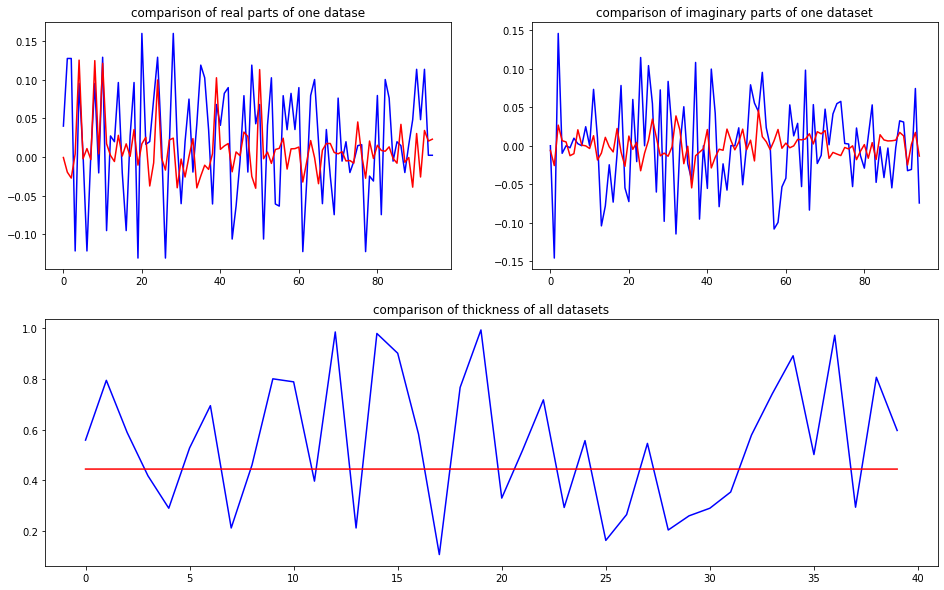

predicted thickness: 0.44458556


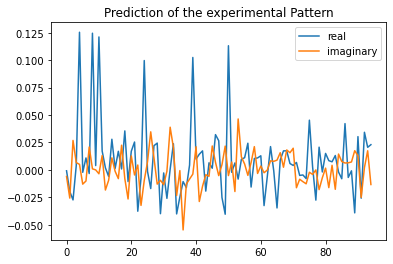

The offset applied on thickness: 0.000849734782037834

The offset applied on Ug: 0.9021598626625797

Applied shift of unit cell origin (fractional coordinates): -0.0029887514172073173 0.0020490463791021235 -0.004564347771304162
Ug[ 0 ]: 0.00084 3.14159  =>  0.00084 3.14159
Ug[ 1 ]: 0.0347 -2.27486  =>  0.0347 -2.30354
Ug[ 2 ]: 0.0347 2.27486  =>  0.0347 2.30354
Ug[ 3 ]: 0.01118 0.83803  =>  0.01118 0.8509
Ug[ 4 ]: 0.13907 0.0158  =>  0.13907 0.0
Ug[ 5 ]: 0.01723 -1.71998  =>  0.01723 -1.67842
Ug[ 6 ]: 0.01118 -0.83803  =>  0.01118 -0.8509
Ug[ 7 ]: 0.01723 1.71998  =>  0.01723 1.67842
Ug[ 8 ]: 0.13907 -0.0158  =>  0.13907 0.0
Ug[ 9 ]: 0.00264 0.2433  =>  0.00264 0.22452
Ug[ 10 ]: 0.12163 0.04746  =>  0.12163 0.0
Ug[ 11 ]: 0.02033 0.54645  =>  0.02033 0.55635
Ug[ 12 ]: 0.02056 -1.48874  =>  0.02056 -1.52039
Ug[ 13 ]: 0.00908 -1.97654  =>  0.00908 -2.03687
Ug[ 14 ]: 0.03397 0.27738  =>  0.03397 0.27441
Ug[ 15 ]: 0.00264 -0.2433  =>  0.00264 -0.22452
Ug[ 16 ]: 0.02033 -0.54645  =>  0.02033

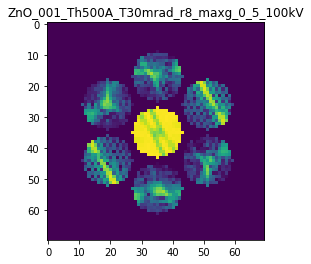

X_sim.max(): 0.9929952787386265
>>>replaced the 75. dataset and train: 
Epoch 1/5
5/5 [==============================] - 10s 2s/step - loss: 0.0017 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0018 - acc: 0.9400 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0018 - acc: 0.9400 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 868ms/step - loss: 0.0018 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 989ms/step - loss: 0.0018 - acc: 0.9400 - val_loss: 0.0053 - val_acc: 0.9500


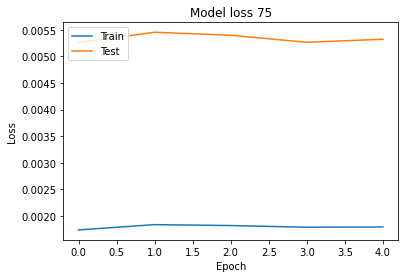

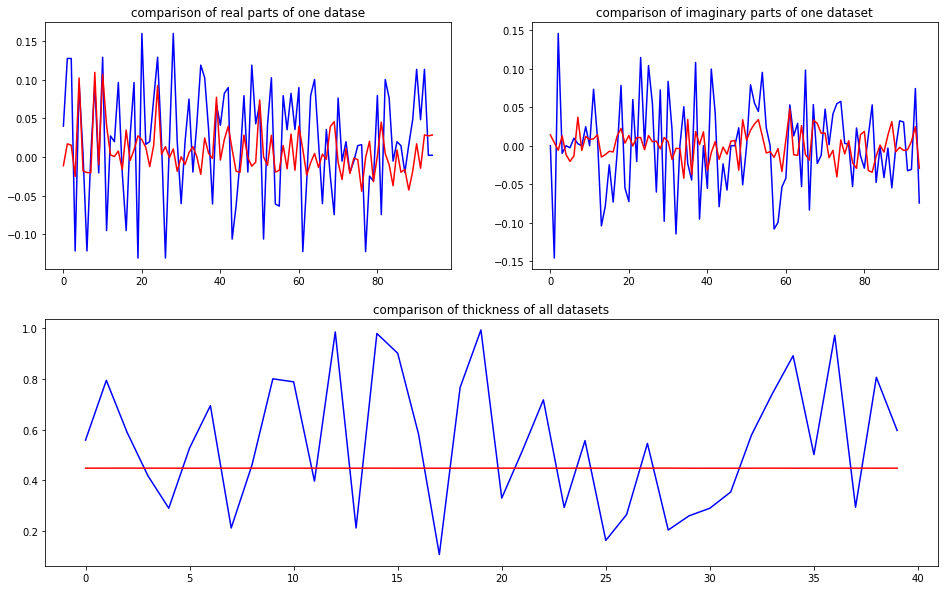

predicted thickness: 0.44837227


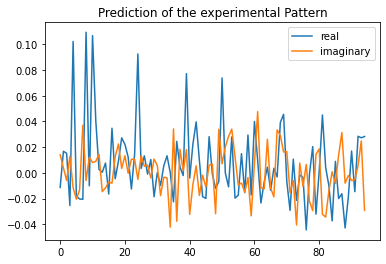

The offset applied on thickness: 0.0005882573757181453

The offset applied on Ug: -1.9461228827346984

Applied shift of unit cell origin (fractional coordinates): -0.0009361791221648622 0.013456497599833438 -0.00931645734056313
Ug[ 0 ]: 0.01198 3.14159  =>  0.01198 3.14159
Ug[ 1 ]: 0.0162 0.3086  =>  0.0162 0.25007
Ug[ 2 ]: 0.0162 -0.3086  =>  0.0162 -0.25007
Ug[ 3 ]: 0.02735 2.6555  =>  0.02735 2.74005
Ug[ 4 ]: 0.08383 -0.02601  =>  0.08383 0.0
Ug[ 5 ]: 0.03521 -2.23918  =>  0.03521 -2.09609
Ug[ 6 ]: 0.02735 -2.6555  =>  0.02735 -2.74005
Ug[ 7 ]: 0.03521 2.23918  =>  0.03521 2.09609
Ug[ 8 ]: 0.08383 0.02601  =>  0.08383 0.0
Ug[ 9 ]: 0.01689 2.52775  =>  0.01689 2.52187
Ug[ 10 ]: 0.08028 0.06442  =>  0.08028 -0.0
Ug[ 11 ]: 0.03563 0.23091  =>  0.03563 0.28357
Ug[ 12 ]: 0.00164 2.58572  =>  0.00164 2.49528
Ug[ 13 ]: 0.01411 -1.46258  =>  0.01411 -1.61154
Ug[ 14 ]: 0.01836 -1.14175  =>  0.01836 -1.17365
Ug[ 15 ]: 0.01689 -2.52775  =>  0.01689 -2.52187
Ug[ 16 ]: 0.03563 -0.23091  =>  0.03

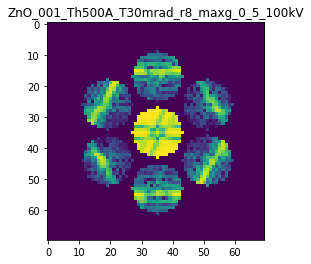

X_sim.max(): 0.9903456776037369
>>>replaced the 76. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0017 - acc: 0.9500 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0017 - acc: 0.9500 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0017 - acc: 0.9500 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0017 - acc: 0.9500 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0018 - acc: 0.9500 - val_loss: 0.0055 - val_acc: 0.9500


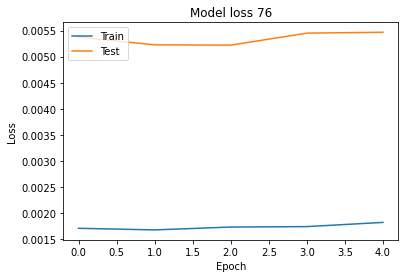

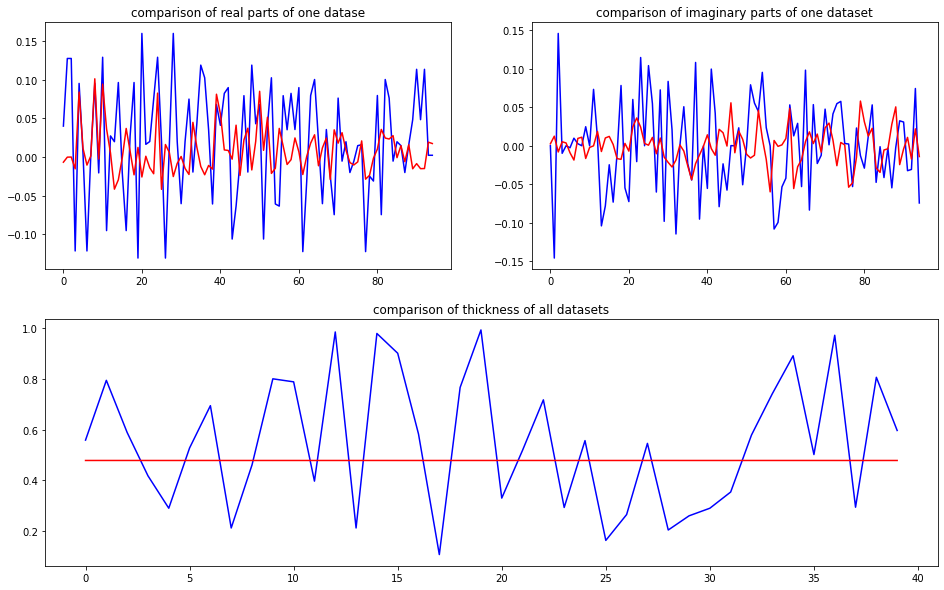

predicted thickness: 0.47856787


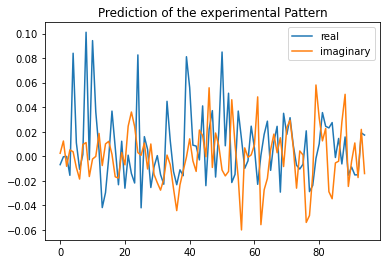

The offset applied on thickness: -0.00020779716780422165

The offset applied on Ug: 1.1884720409821017

Applied shift of unit cell origin (fractional coordinates): -4.806505051425649e-05 0.0082181683450112 0.0016559509964005263
Ug[ 0 ]: 0.00675 3.14159  =>  0.00675 3.14159
Ug[ 1 ]: 0.01035 1.58258  =>  0.01035 1.59298
Ug[ 2 ]: 0.01035 -1.58258  =>  0.01035 -1.59298
Ug[ 3 ]: 0.01726 2.39131  =>  0.01726 2.44295
Ug[ 4 ]: 0.10303 -0.06204  =>  0.10303 -0.0
Ug[ 5 ]: 0.01128 -0.9673  =>  0.01128 -0.92607
Ug[ 6 ]: 0.01726 -2.39131  =>  0.01726 -2.44295
Ug[ 7 ]: 0.01128 0.9673  =>  0.01128 0.92607
Ug[ 8 ]: 0.10303 0.06204  =>  0.10303 0.0
Ug[ 9 ]: 0.01435 -1.68898  =>  0.01435 -1.68929
Ug[ 10 ]: 0.09774 -0.0101  =>  0.09774 -0.0
Ug[ 11 ]: 0.03809 -0.02306  =>  0.03809 -0.03377
Ug[ 12 ]: 0.01888 1.21279  =>  0.01888 1.16085
Ug[ 13 ]: 0.03997 -3.03749  =>  0.03997 -3.07903
Ug[ 14 ]: 0.0289 2.63706  =>  0.0289 2.57472
Ug[ 15 ]: 0.01435 1.68898  =>  0.01435 1.68929
Ug[ 16 ]: 0.03809 0.02306  =>  

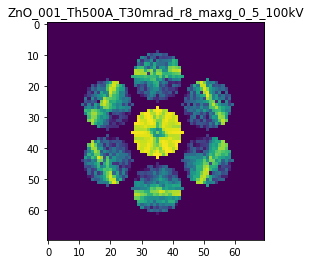

X_sim.max(): 0.975014703919444
>>>replaced the 77. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0018 - acc: 0.9500 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0017 - acc: 0.9500 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0018 - acc: 0.9500 - val_loss: 0.0056 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0018 - acc: 0.9500 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0017 - acc: 0.9500 - val_loss: 0.0052 - val_acc: 0.9500


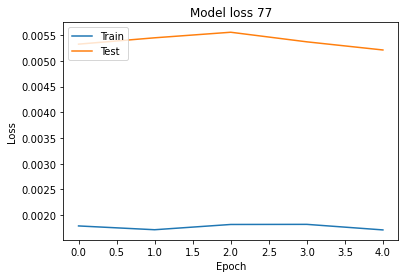

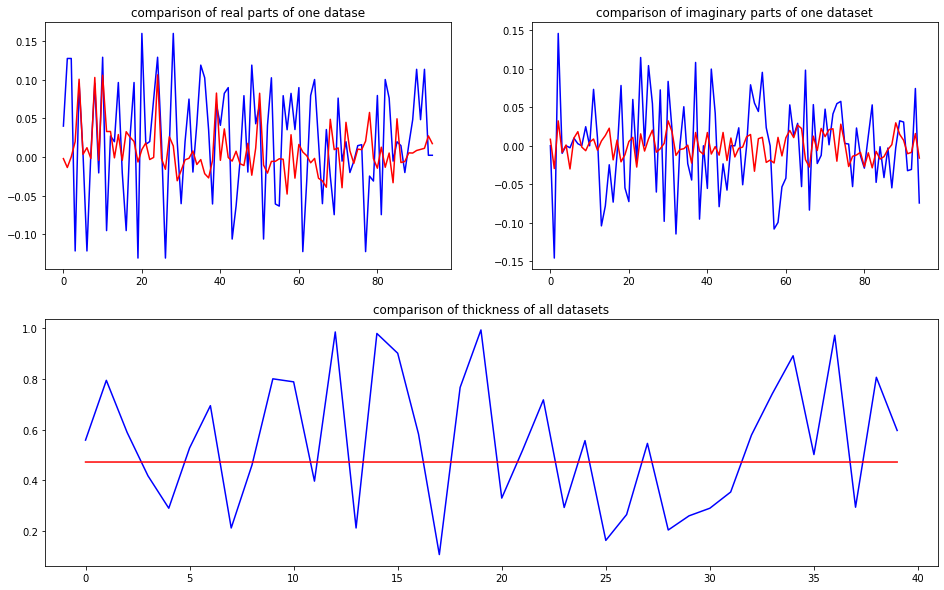

predicted thickness: 0.4723777


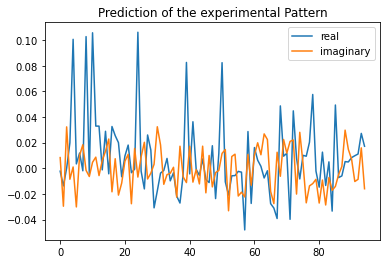

The offset applied on thickness: -0.0007668125465291189

The offset applied on Ug: 0.09249688506152032

Applied shift of unit cell origin (fractional coordinates): -0.014110102202295752 -0.007548711341644218 0.005541339738935551
Ug[ 0 ]: 0.00226 3.14159  =>  0.00226 3.14159
Ug[ 1 ]: 0.03168 -1.78481  =>  0.03168 -1.75
Ug[ 2 ]: 0.03168 1.78481  =>  0.03168 1.75
Ug[ 3 ]: 0.01843 -0.53079  =>  0.01843 -0.57822
Ug[ 4 ]: 0.10266 0.01261  =>  0.10266 0.0
Ug[ 5 ]: 0.02424 -1.53865  =>  0.02424 -1.6209
Ug[ 6 ]: 0.01843 0.53079  =>  0.01843 0.57822
Ug[ 7 ]: 0.02424 1.53865  =>  0.02424 1.6209
Ug[ 8 ]: 0.10266 -0.01261  =>  0.10266 0.0
Ug[ 9 ]: 0.01528 -1.86079  =>  0.01528 -1.94944
Ug[ 10 ]: 0.10714 0.05384  =>  0.10714 -0.0
Ug[ 11 ]: 0.03554 0.39016  =>  0.03554 0.26669
Ug[ 12 ]: 0.02998 -0.22069  =>  0.02998 -0.26192
Ug[ 13 ]: 0.00224 -2.46894  =>  0.00224 -2.47535
Ug[ 14 ]: 0.02992 0.60981  =>  0.02992 0.53376
Ug[ 15 ]: 0.01528 1.86079  =>  0.01528 1.94944
Ug[ 16 ]: 0.03554 -0.39016  =>  0.0

Residual error after kinematic rocking curve fit: 0.026677767850338638



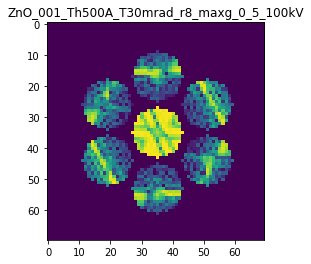

X_sim.max(): 0.9827766043942862
>>>replaced the 78. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 0.0016 - acc: 0.9500 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0016 - acc: 0.9500 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0016 - acc: 0.9500 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0016 - acc: 0.9500 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 887ms/step - loss: 0.0016 - acc: 0.9500 - val_loss: 0.0052 - val_acc: 0.9500


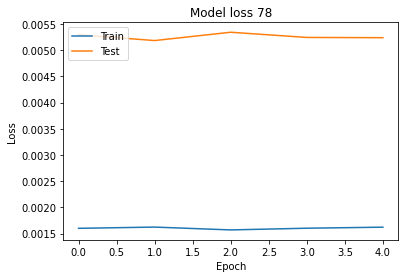

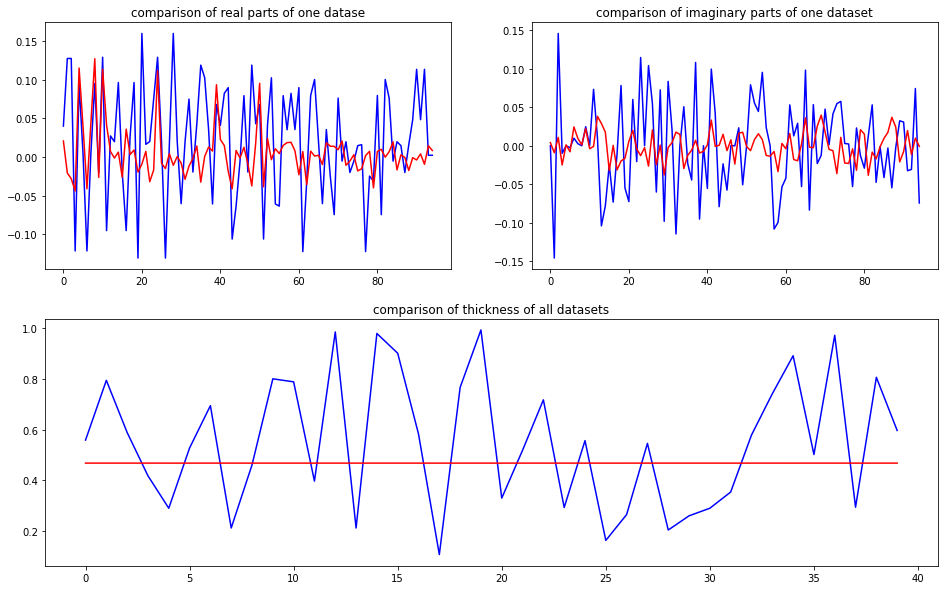

predicted thickness: 0.46813926


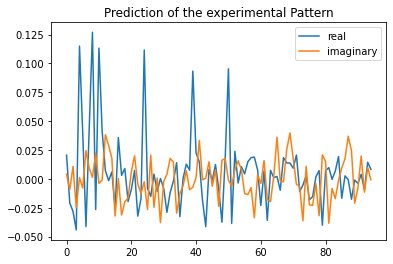

The offset applied on thickness: -0.000955577384299489

The offset applied on Ug: -2.2418946557119774

Applied shift of unit cell origin (fractional coordinates): -0.0013327036447294944 -0.004913198002510921 0.00302415104132809
Ug[ 0 ]: 0.01961 0.0  =>  0.01961 0.0
Ug[ 1 ]: 0.02782 -2.79482  =>  0.02782 -2.77582
Ug[ 2 ]: 0.02782 2.79482  =>  0.02782 2.77582
Ug[ 3 ]: 0.05437 -2.66108  =>  0.05437 -2.69195
Ug[ 4 ]: 0.0881 0.01187  =>  0.0881 0.0
Ug[ 5 ]: 0.03843 -0.22046  =>  0.03843 -0.27033
Ug[ 6 ]: 0.05437 2.66108  =>  0.05437 2.69195
Ug[ 7 ]: 0.03843 0.22046  =>  0.03843 0.27033
Ug[ 8 ]: 0.0881 -0.01187  =>  0.0881 0.0
Ug[ 9 ]: 0.04069 2.38706  =>  0.04069 2.37869
Ug[ 10 ]: 0.08409 -0.01063  =>  0.08409 0.0
Ug[ 11 ]: 0.0352 -0.02714  =>  0.0352 -0.05452
Ug[ 12 ]: 0.03428 1.50424  =>  0.03428 1.52674
Ug[ 13 ]: 0.02838 1.80429  =>  0.02838 1.84579
Ug[ 14 ]: 0.02006 1.23513  =>  0.02006 1.23863
Ug[ 15 ]: 0.04069 -2.38706  =>  0.04069 -2.37869
Ug[ 16 ]: 0.0352 0.02714  =>  0.0352 0.05452

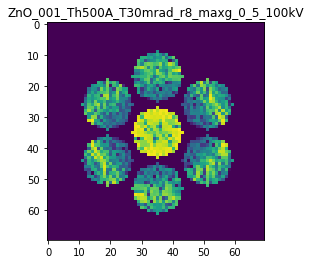

X_sim.max(): 0.9341080174939833
>>>replaced the 79. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 973ms/step - loss: 0.0016 - acc: 0.9500 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0016 - acc: 0.9500 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0016 - acc: 0.9500 - val_loss: 0.0051 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 851ms/step - loss: 0.0015 - acc: 0.9500 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 911ms/step - loss: 0.0016 - acc: 0.9500 - val_loss: 0.0052 - val_acc: 0.9500


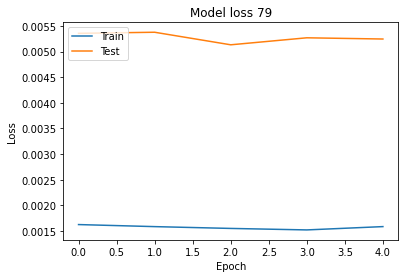

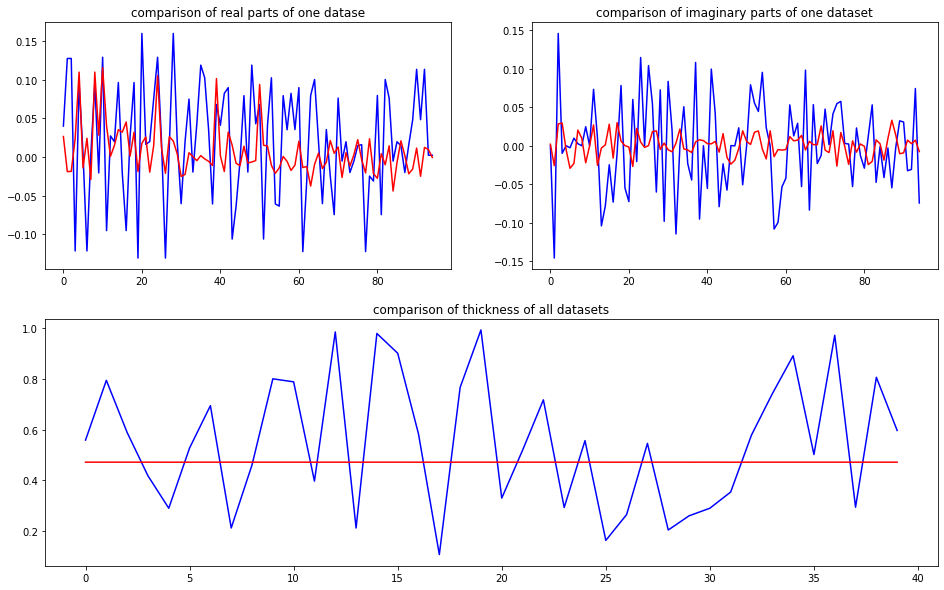

predicted thickness: 0.471829


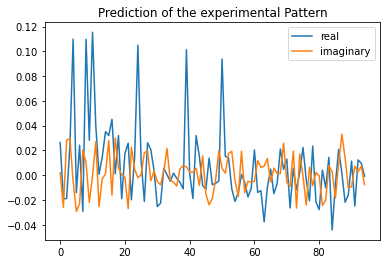

The offset applied on thickness: 0.00015394447811288713

The offset applied on Ug: 2.194799023791251

Applied shift of unit cell origin (fractional coordinates): -0.005376210147673607 0.009838941213309282 -0.0011759623592356788
Ug[ 0 ]: 0.02781 0.0  =>  0.02781 0.0
Ug[ 1 ]: 0.03185 -2.1177  =>  0.03185 -2.12508
Ug[ 2 ]: 0.03185 2.1177  =>  0.03185 2.12508
Ug[ 3 ]: 0.03772 0.7823  =>  0.03772 0.84412
Ug[ 4 ]: 0.13655 -0.05443  =>  0.13655 0.0
Ug[ 5 ]: 0.0315 -2.22269  =>  0.0315 -2.15348
Ug[ 6 ]: 0.03772 -0.7823  =>  0.03772 -0.84412
Ug[ 7 ]: 0.0315 2.22269  =>  0.0315 2.15348
Ug[ 8 ]: 0.13655 0.05443  =>  0.13655 0.0
Ug[ 9 ]: 0.04228 -0.65428  =>  0.04228 -0.68806
Ug[ 10 ]: 0.13702 0.04117  =>  0.13702 0.0
Ug[ 11 ]: 0.05233 0.42511  =>  0.05233 0.39871
Ug[ 12 ]: 0.02813 -1.47719  =>  0.02813 -1.57279
Ug[ 13 ]: 0.01369 -0.11188  =>  0.01369 -0.21486
Ug[ 14 ]: 0.03618 -0.05996  =>  0.03618 -0.14817
Ug[ 15 ]: 0.04228 0.65428  =>  0.04228 0.68806
Ug[ 16 ]: 0.05233 -0.42511  =>  0.05233 -0.

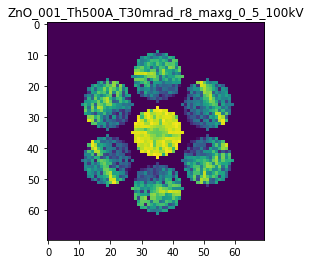

X_sim.max(): 0.9533838631560337
>>>replaced the 80. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 2s/step - loss: 0.0015 - acc: 0.9500 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0015 - acc: 0.9500 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0015 - acc: 0.9500 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 969ms/step - loss: 0.0015 - acc: 0.9500 - val_loss: 0.0051 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0015 - acc: 0.9500 - val_loss: 0.0053 - val_acc: 0.9500


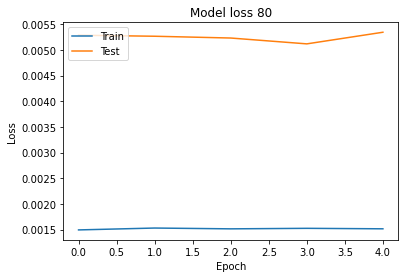

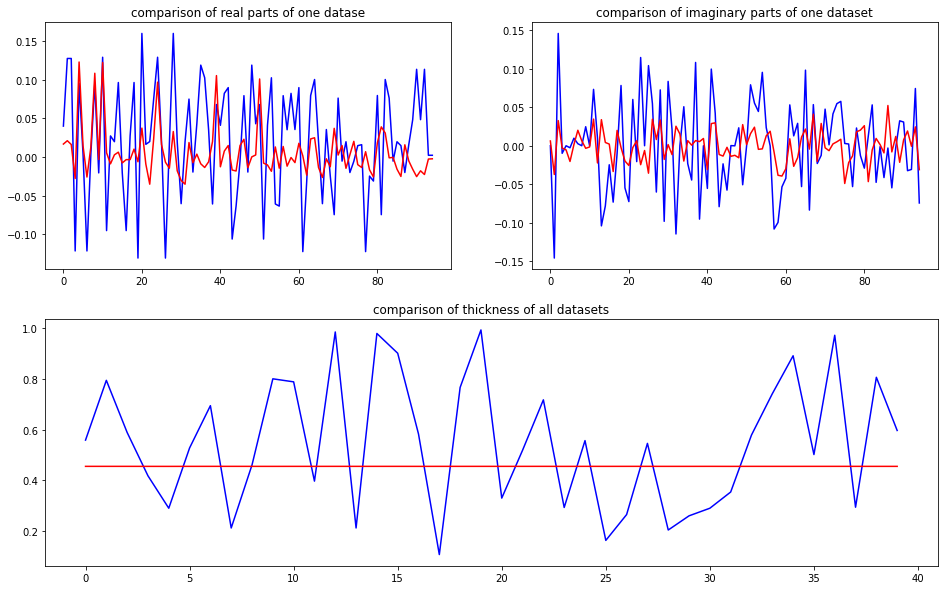

predicted thickness: 0.4552695


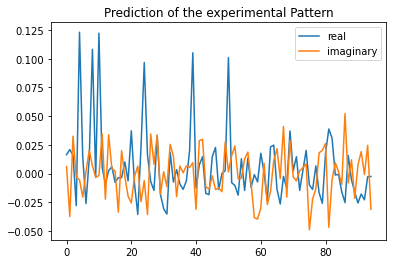

The offset applied on thickness: 0.0004010690064098952

The offset applied on Ug: 2.2034518709222968

Applied shift of unit cell origin (fractional coordinates): -0.003532401987265719 0.010928648601536597 -0.012248121097882463
Ug[ 0 ]: 0.01718 0.0  =>  0.01718 0.0
Ug[ 1 ]: 0.04075 -1.00198  =>  0.04075 -1.07893
Ug[ 2 ]: 0.04075 1.00198  =>  0.04075 1.07893
Ug[ 3 ]: 0.02546 -3.05335  =>  0.02546 -2.98468
Ug[ 4 ]: 0.14523 0.00829  =>  0.14523 -0.0
Ug[ 5 ]: 0.02524 -0.93583  =>  0.02524 -0.79021
Ug[ 6 ]: 0.02546 3.05335  =>  0.02546 2.98468
Ug[ 7 ]: 0.02524 0.93583  =>  0.02524 0.79021
Ug[ 8 ]: 0.14523 -0.00829  =>  0.14523 0.0
Ug[ 9 ]: 0.00606 -2.6705  =>  0.00606 -2.69269
Ug[ 10 ]: 0.13696 0.09915  =>  0.13696 0.0
Ug[ 11 ]: 0.03439 1.46894  =>  0.03439 1.5237
Ug[ 12 ]: 0.02159 -1.81331  =>  0.02159 -1.90417
Ug[ 13 ]: 0.0363 1.22515  =>  0.0363 1.05733
Ug[ 14 ]: 0.00889 0.38406  =>  0.00889 0.37016
Ug[ 15 ]: 0.00606 2.6705  =>  0.00606 2.69269
Ug[ 16 ]: 0.03439 -1.46894  =>  0.03439 -1.5

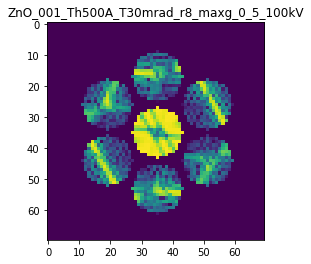

X_sim.max(): 0.9886047404684628
>>>replaced the 81. dataset and train: 
Epoch 1/5
5/5 [==============================] - 11s 2s/step - loss: 0.0015 - acc: 0.9600 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0015 - acc: 0.9600 - val_loss: 0.0055 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0016 - acc: 0.9600 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0015 - acc: 0.9600 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0015 - acc: 0.9600 - val_loss: 0.0053 - val_acc: 0.9500


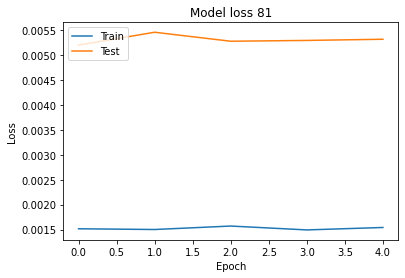

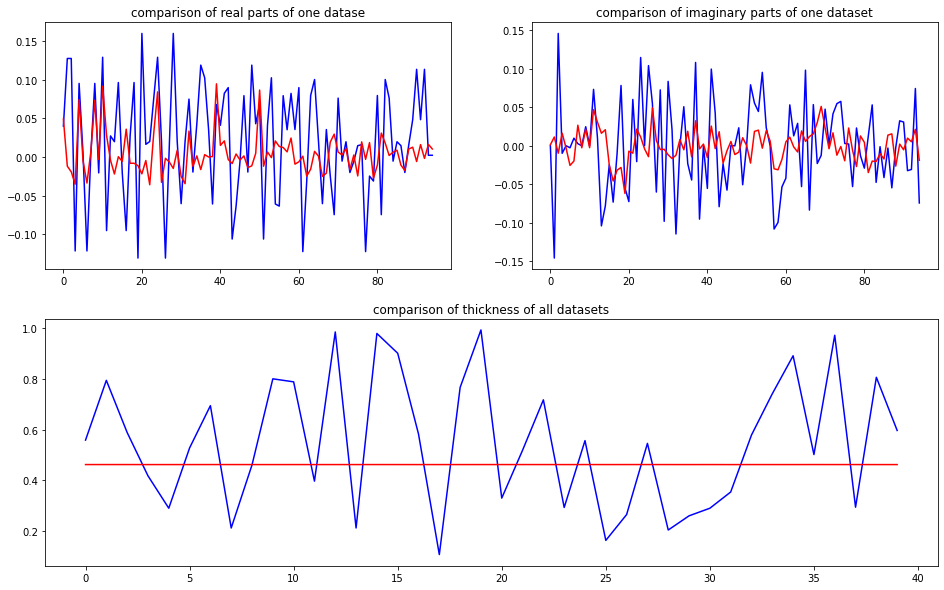

predicted thickness: 0.46237752


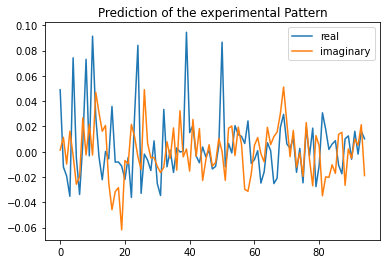

The offset applied on thickness: 0.0002672871235292833

The offset applied on Ug: 1.6919774185350667

Applied shift of unit cell origin (fractional coordinates): 0.00035931633661901195 0.003891101365565254 -0.0038805818189713774
Ug[ 0 ]: 0.05301 0.0  =>  0.05301 0.0
Ug[ 1 ]: 0.01832 2.53634  =>  0.01832 2.51196
Ug[ 2 ]: 0.01832 -2.53634  =>  0.01832 -2.51196
Ug[ 3 ]: 0.03671 2.62974  =>  0.03671 2.65419
Ug[ 4 ]: 0.08289 -7e-05  =>  0.08289 -0.0
Ug[ 5 ]: 0.02646 -1.48364  =>  0.02646 -1.43481
Ug[ 6 ]: 0.03671 -2.62974  =>  0.03671 -2.65419
Ug[ 7 ]: 0.02646 1.48364  =>  0.02646 1.43481
Ug[ 8 ]: 0.08289 7e-05  =>  0.08289 0.0
Ug[ 9 ]: 0.02323 1.72239  =>  0.02323 1.72465
Ug[ 10 ]: 0.10088 0.02212  =>  0.10088 0.0
Ug[ 11 ]: 0.05908 0.8902  =>  0.05908 0.91684
Ug[ 12 ]: 0.0314 1.71611  =>  0.0314 1.69391
Ug[ 13 ]: 0.02976 2.62359  =>  0.02976 2.57701
Ug[ 14 ]: 0.02444 1.6887  =>  0.02444 1.69089
Ug[ 15 ]: 0.02323 -1.72239  =>  0.02323 -1.72465
Ug[ 16 ]: 0.05908 -0.8902  =>  0.05908 -0.91684

Residual error after kinematic rocking curve fit: 0.03664845072363524



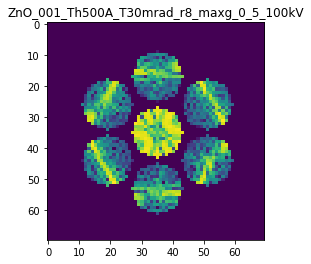

X_sim.max(): 0.9693651737003441
>>>replaced the 82. dataset and train: 
Epoch 1/5
5/5 [==============================] - 8s 1s/step - loss: 0.0015 - acc: 0.9600 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0015 - acc: 0.9600 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 6s 1s/step - loss: 0.0014 - acc: 0.9600 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0015 - acc: 0.9600 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0015 - acc: 0.9600 - val_loss: 0.0052 - val_acc: 0.9500


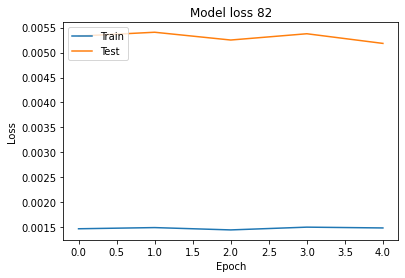

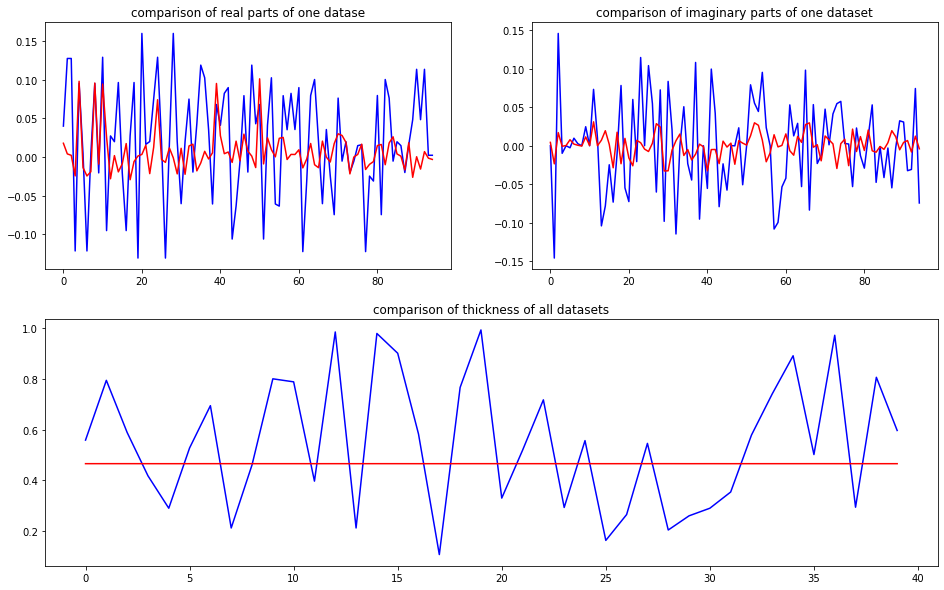

predicted thickness: 0.46591195


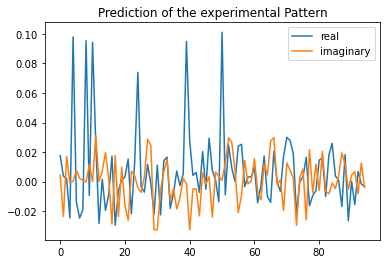

The offset applied on thickness: 5.8783673538222784e-05

The offset applied on Ug: 1.8195732011173262

Applied shift of unit cell origin (fractional coordinates): -0.006851791637444746 0.0029974080145079313 -0.00433386803906939
Ug[ 0 ]: 0.0182 0.0  =>  0.0182 0.0
Ug[ 1 ]: 0.02034 -1.38665  =>  0.02034 -1.41388
Ug[ 2 ]: 0.02034 1.38665  =>  0.02034 1.41388
Ug[ 3 ]: 0.02355 -3.07762  =>  0.02355 -3.05879
Ug[ 4 ]: 0.11373 0.0084  =>  0.11373 0.0
Ug[ 5 ]: 0.01622 2.93275  =>  0.01622 2.97882
Ug[ 6 ]: 0.02355 3.07762  =>  0.02355 3.05879
Ug[ 7 ]: 0.01622 -2.93275  =>  0.01622 -2.97882
Ug[ 8 ]: 0.11373 -0.0084  =>  0.11373 -0.0
Ug[ 9 ]: 0.01009 2.6232  =>  0.01009 2.58015
Ug[ 10 ]: 0.09749 0.07028  =>  0.09749 0.0
Ug[ 11 ]: 0.03872 0.9045  =>  0.03872 0.88868
Ug[ 12 ]: 0.02862 -2.81849  =>  0.02862 -2.88038
Ug[ 13 ]: 0.00725 1.67451  =>  0.00725 1.58539
Ug[ 14 ]: 0.02453 2.0572  =>  0.02453 2.02254
Ug[ 15 ]: 0.01009 -2.6232  =>  0.01009 -2.58015
Ug[ 16 ]: 0.03872 -0.9045  =>  0.03872 -0.8886

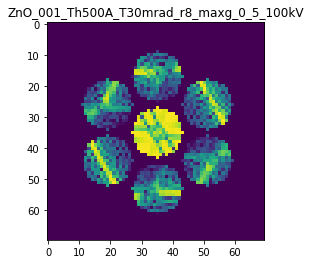

X_sim.max(): 0.9871615372337261
>>>replaced the 83. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 1s/step - loss: 0.0014 - acc: 0.9700 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0013 - acc: 0.9700 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0013 - acc: 0.9700 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0014 - acc: 0.9700 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 0.0014 - acc: 0.9700 - val_loss: 0.0054 - val_acc: 0.9500


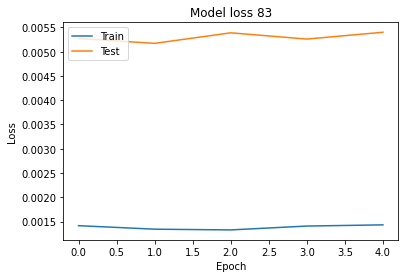

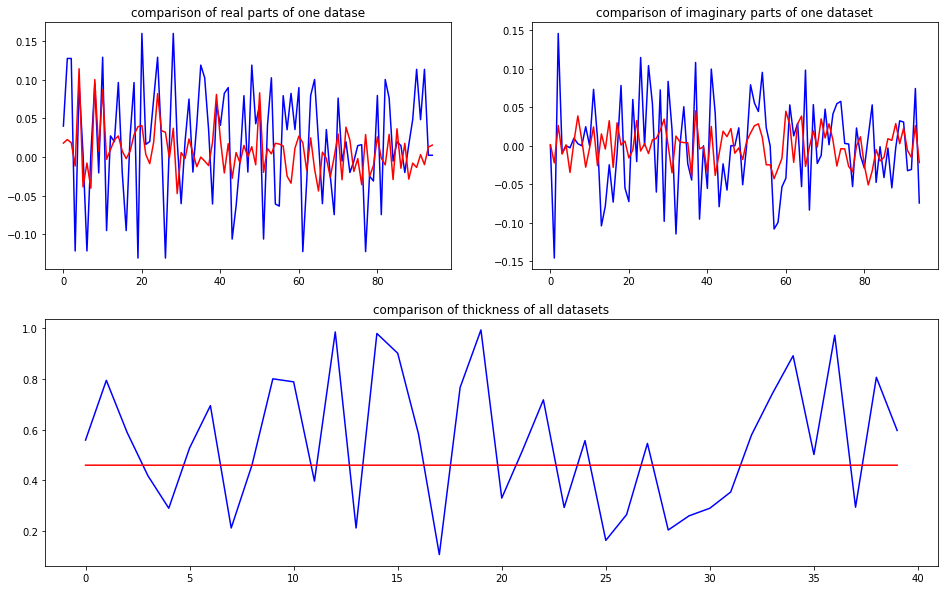

predicted thickness: 0.45986843


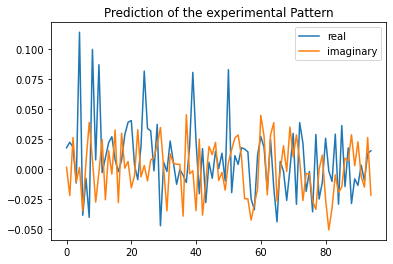

The offset applied on thickness: 0.0007731353854115039

The offset applied on Ug: 1.736432751853501

Applied shift of unit cell origin (fractional coordinates): -0.0014150700971940686 -0.00549508160054374 0.00411313999202392
Ug[ 0 ]: 0.01825 0.0  =>  0.01825 0.0
Ug[ 1 ]: 0.03278 -0.8334  =>  0.03278 -0.80756
Ug[ 2 ]: 0.03278 0.8334  =>  0.03278 0.80756
Ug[ 3 ]: 0.01236 -2.44818  =>  0.01236 -2.4827
Ug[ 4 ]: 0.12722 0.00868  =>  0.12722 -0.0
Ug[ 5 ]: 0.05076 -2.31831  =>  0.05076 -2.37868
Ug[ 6 ]: 0.01236 2.44818  =>  0.01236 2.4827
Ug[ 7 ]: 0.05076 2.31831  =>  0.05076 2.37868
Ug[ 8 ]: 0.12722 -0.00868  =>  0.12722 0.0
Ug[ 9 ]: 0.03186 -1.27351  =>  0.03186 -1.2824
Ug[ 10 ]: 0.09695 -0.01695  =>  0.09695 -0.0
Ug[ 11 ]: 0.02622 1.625  =>  0.02622 1.59026
Ug[ 12 ]: 0.02967 -1.23237  =>  0.02967 -1.20673
Ug[ 13 ]: 0.03203 0.38725  =>  0.03203 0.43873
Ug[ 14 ]: 0.02928 -0.08655  =>  0.02928 -0.08676
Ug[ 15 ]: 0.03186 1.27351  =>  0.03186 1.2824
Ug[ 16 ]: 0.02622 -1.625  =>  0.02622 -1.5902

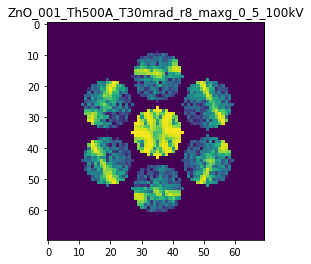

X_sim.max(): 0.9576258663058433
>>>replaced the 84. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 1s/step - loss: 0.0015 - acc: 0.9700 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0014 - acc: 0.9700 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0014 - acc: 0.9700 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 6s 1s/step - loss: 0.0014 - acc: 0.9700 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 6s 1s/step - loss: 0.0014 - acc: 0.9700 - val_loss: 0.0052 - val_acc: 0.9500


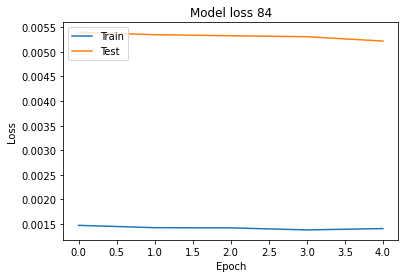

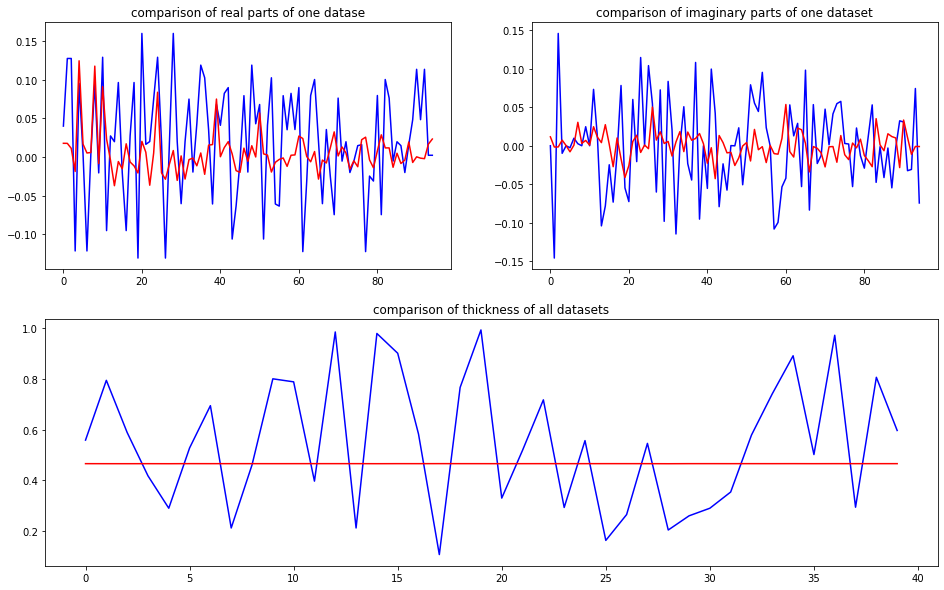

predicted thickness: 0.46575114


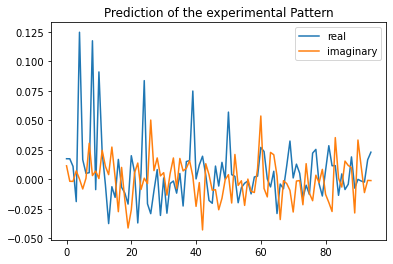

The offset applied on thickness: -0.0005411943854756645

The offset applied on Ug: -1.6560650250190432

Applied shift of unit cell origin (fractional coordinates): -0.0036800951685793 -0.001810953350143548 0.005403582543814181
Ug[ 0 ]: 0.01677 0.0  =>  0.01677 0.0
Ug[ 1 ]: 0.01389 -0.00746  =>  0.01389 0.02649
Ug[ 2 ]: 0.01389 0.00746  =>  0.01389 -0.02649
Ug[ 3 ]: 0.00772 2.76798  =>  0.00772 2.7566
Ug[ 4 ]: 0.09671 -0.02257  =>  0.09671 0.0
Ug[ 5 ]: 0.02137 -1.07772  =>  0.02137 -1.12305
Ug[ 6 ]: 0.00772 -2.76798  =>  0.00772 -2.7566
Ug[ 7 ]: 0.02137 1.07772  =>  0.02137 1.12305
Ug[ 8 ]: 0.09671 0.02257  =>  0.09671 0.0
Ug[ 9 ]: 0.01253 2.92495  =>  0.01253 2.90182
Ug[ 10 ]: 0.07465 -0.01083  =>  0.07465 0.0
Ug[ 11 ]: 0.0317 0.95775  =>  0.0317 0.90067
Ug[ 12 ]: 0.00578 3.05539  =>  0.00578 3.04364
Ug[ 13 ]: 0.0307 3.04791  =>  0.0307 3.07011
Ug[ 14 ]: 0.0241 1.99229  =>  0.0241 1.9466
Ug[ 15 ]: 0.01253 -2.92495  =>  0.01253 -2.90182
Ug[ 16 ]: 0.0317 -0.95775  =>  0.0317 -0.90067
Ug[

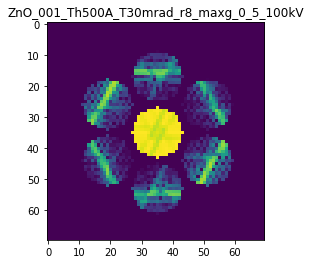

X_sim.max(): 0.9952049462867439
>>>replaced the 85. dataset and train: 
Epoch 1/5
5/5 [==============================] - 10s 1s/step - loss: 0.0013 - acc: 0.9800 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 0.0013 - acc: 0.9800 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 1s/step - loss: 0.0012 - acc: 0.9800 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 5s 1s/step - loss: 0.0013 - acc: 0.9800 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 3s 636ms/step - loss: 0.0014 - acc: 0.9800 - val_loss: 0.0054 - val_acc: 0.9500


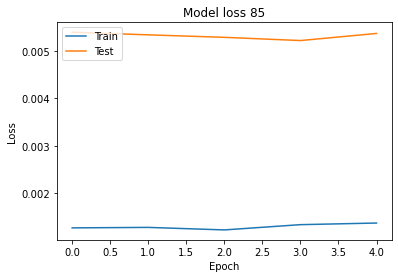

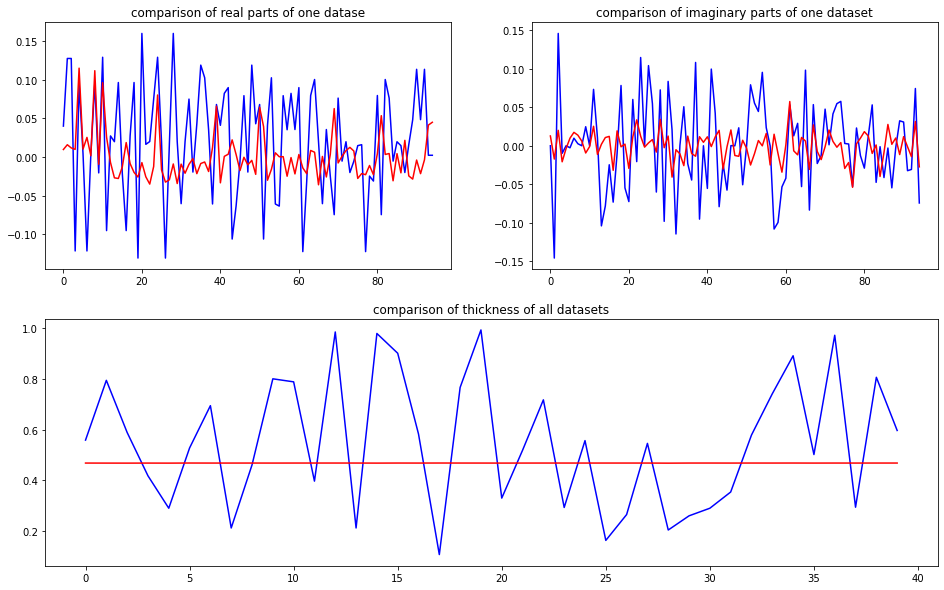

predicted thickness: 0.46804637


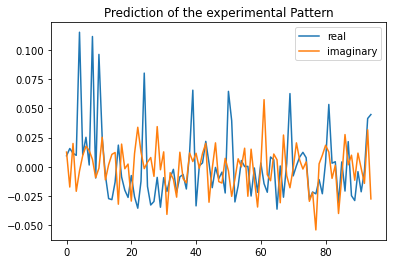

The offset applied on thickness: -0.0004342097011986004

The offset applied on Ug: 0.9698311913647537

Applied shift of unit cell origin (fractional coordinates): 0.00030048871035823785 0.009101136556509263 -0.0035109432575934755
Ug[ 0 ]: 0.00969 0.0  =>  0.00969 0.0
Ug[ 1 ]: 0.02337 -0.92138  =>  0.02337 -0.94344
Ug[ 2 ]: 0.02337 0.92138  =>  0.02337 0.94344
Ug[ 3 ]: 0.02667 -0.81824  =>  0.02667 -0.76105
Ug[ 4 ]: 0.12573 -0.03512  =>  0.12573 0.0
Ug[ 5 ]: 0.00644 -0.33584  =>  0.00644 -0.2566
Ug[ 6 ]: 0.02667 0.81824  =>  0.02667 0.76105
Ug[ 7 ]: 0.00644 0.33584  =>  0.00644 0.2566
Ug[ 8 ]: 0.12573 0.03512  =>  0.12573 -0.0
Ug[ 9 ]: 0.01545 -2.36862  =>  0.01545 -2.36674
Ug[ 10 ]: 0.0957 0.02017  =>  0.0957 0.0
Ug[ 11 ]: 0.03694 0.88529  =>  0.03694 0.90924
Ug[ 12 ]: 0.01724 -2.03433  =>  0.01724 -2.08962
Ug[ 13 ]: 0.02152 -3.10166  =>  0.02152 3.10417
Ug[ 14 ]: 0.02426 2.87637  =>  0.02426 2.84313
Ug[ 15 ]: 0.01545 2.36862  =>  0.01545 2.36674
Ug[ 16 ]: 0.03694 -0.88529  =>  0.03694

Residual error after kinematic rocking curve fit: 0.020354824415332557



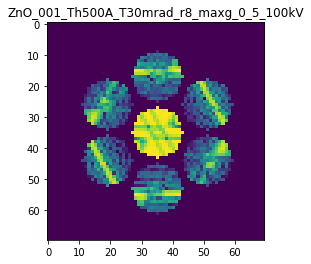

X_sim.max(): 0.9738773346746251
>>>replaced the 86. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 0.0012 - acc: 0.9800 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 619ms/step - loss: 0.0012 - acc: 0.9800 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 636ms/step - loss: 0.0012 - acc: 0.9800 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 963ms/step - loss: 0.0012 - acc: 0.9800 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 957ms/step - loss: 0.0012 - acc: 0.9800 - val_loss: 0.0052 - val_acc: 0.9500


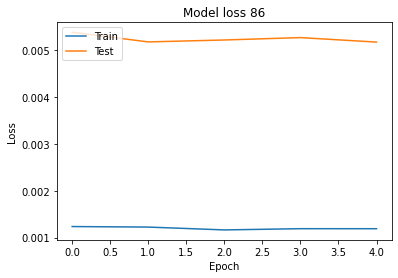

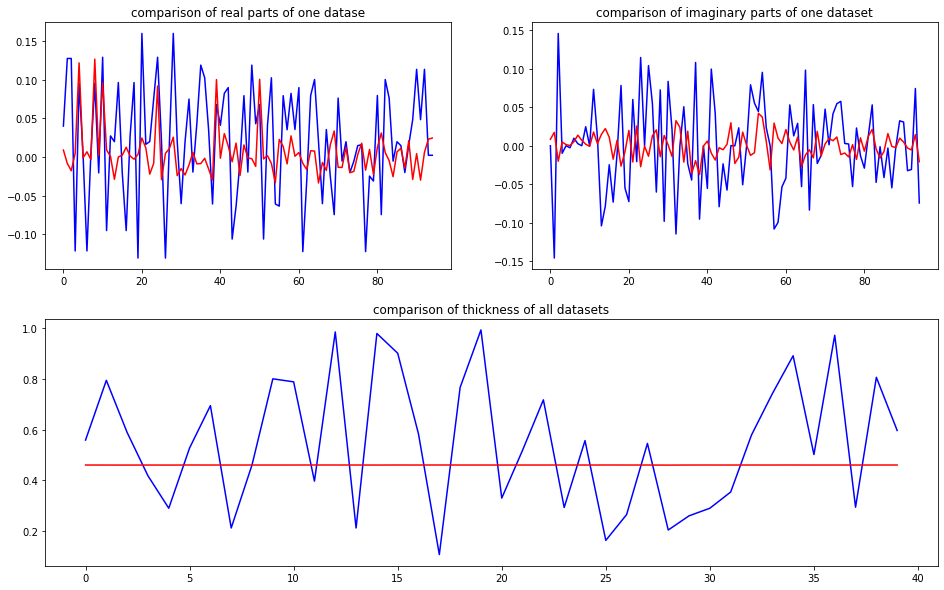

predicted thickness: 0.46030706


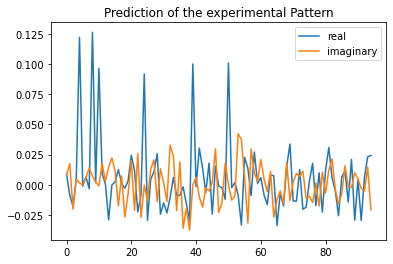

The offset applied on thickness: 0.0009650678060374006

The offset applied on Ug: -0.6218604702808429

Applied shift of unit cell origin (fractional coordinates): -0.0015621326514542939 0.0011160568442763472 0.0025706620076184593
Ug[ 0 ]: 0.00858 0.0  =>  0.00858 0.0
Ug[ 1 ]: 0.02334 2.1955  =>  0.02334 2.21165
Ug[ 2 ]: 0.02334 -2.1955  =>  0.02334 -2.21165
Ug[ 3 ]: 0.00569 -0.07258  =>  0.00569 -0.06556
Ug[ 4 ]: 0.11451 -0.02316  =>  0.11451 0.0
Ug[ 5 ]: 0.00727 -1.88905  =>  0.00727 -1.89819
Ug[ 6 ]: 0.00569 0.07258  =>  0.00569 0.06556
Ug[ 7 ]: 0.00727 1.88905  =>  0.00727 1.89819
Ug[ 8 ]: 0.11451 0.02316  =>  0.11451 0.0
Ug[ 9 ]: 0.00479 -1.14473  =>  0.00479 -1.15454
Ug[ 10 ]: 0.08853 -0.00634  =>  0.08853 -0.0
Ug[ 11 ]: 0.02057 1.03295  =>  0.02057 1.00698
Ug[ 12 ]: 0.00238 -1.19913  =>  0.00238 -1.21595
Ug[ 13 ]: 0.03301 2.70576  =>  0.03301 2.70508
Ug[ 14 ]: 0.0247 1.65131  =>  0.0247 1.61833
Ug[ 15 ]: 0.00479 1.14473  =>  0.00479 1.15454
Ug[ 16 ]: 0.02057 -1.03295  =>  0.02057

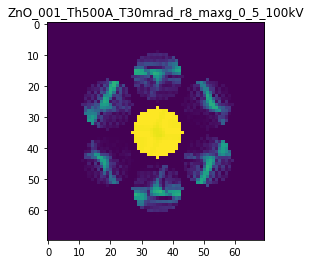

X_sim.max(): 0.9986361116397781
>>>replaced the 87. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 961ms/step - loss: 0.0011 - acc: 0.9900 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 623ms/step - loss: 0.0012 - acc: 0.9900 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 632ms/step - loss: 0.0012 - acc: 0.9900 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 643ms/step - loss: 0.0011 - acc: 0.9900 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 837ms/step - loss: 0.0012 - acc: 0.9900 - val_loss: 0.0053 - val_acc: 0.9500


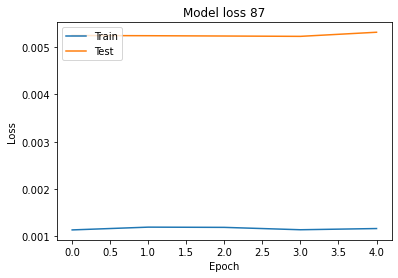

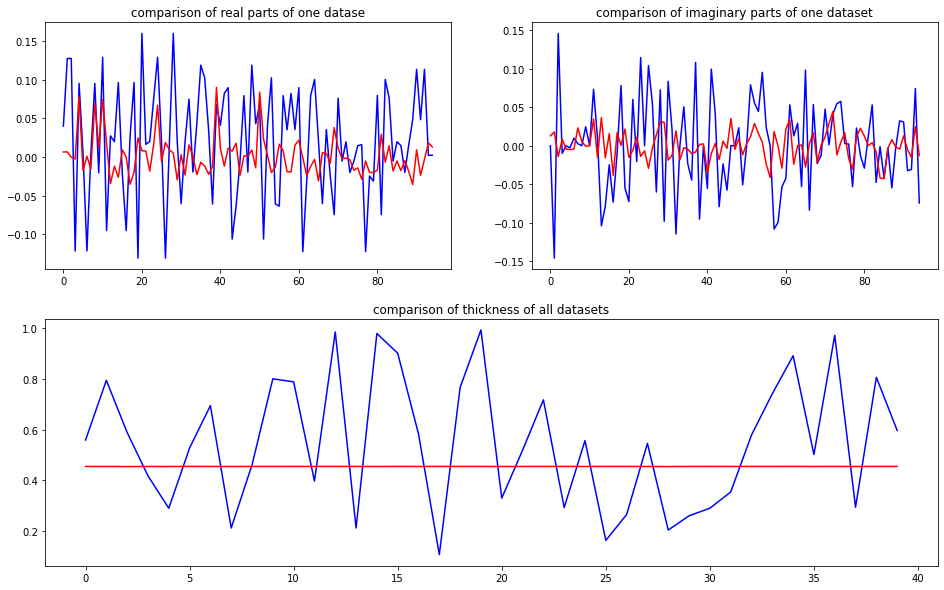

predicted thickness: 0.45458528


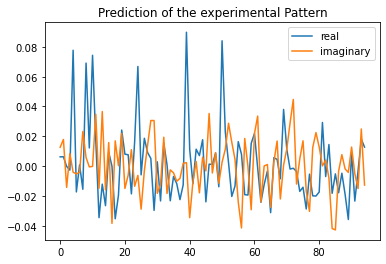

The offset applied on thickness: -0.00042991640385230335

The offset applied on Ug: 0.8389578753739801

Applied shift of unit cell origin (fractional coordinates): -0.007812112701195287 0.008470537159029068 0.0003097023394562338
Ug[ 0 ]: 0.00637 0.0  =>  0.00637 0.0
Ug[ 1 ]: 0.01647 1.3722  =>  0.01647 1.37415
Ug[ 2 ]: 0.01647 -1.3722  =>  0.01647 -1.37415
Ug[ 3 ]: 0.00633 1.71114  =>  0.00633 1.76437
Ug[ 4 ]: 0.07811 -0.05517  =>  0.07811 0.0
Ug[ 5 ]: 0.02153 -2.40728  =>  0.02153 -2.356
Ug[ 6 ]: 0.00633 -1.71114  =>  0.00633 -1.76437
Ug[ 7 ]: 0.02153 2.40728  =>  0.02153 2.356
Ug[ 8 ]: 0.07811 0.05517  =>  0.07811 -0.0
Ug[ 9 ]: 0.01368 -0.6466  =>  0.01368 -0.69568
Ug[ 10 ]: 0.07489 0.04714  =>  0.07489 0.0
Ug[ 11 ]: 0.03794 1.30774  =>  0.03794 1.25671
Ug[ 12 ]: 0.03733 -2.69965  =>  0.03733 -2.80196
Ug[ 13 ]: 0.03395 1.80899  =>  0.03395 1.70863
Ug[ 14 ]: 0.02384 -2.80492  =>  0.02384 -2.90917
Ug[ 15 ]: 0.01368 0.6466  =>  0.01368 0.69568
Ug[ 16 ]: 0.03794 -1.30774  =>  0.03794 -1.

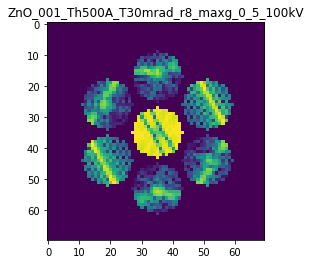

X_sim.max(): 0.9851003512416016
>>>replaced the 88. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 951ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 626ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 727ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 793ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 752ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500


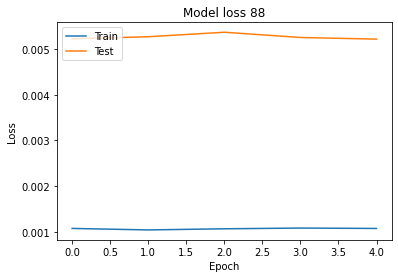

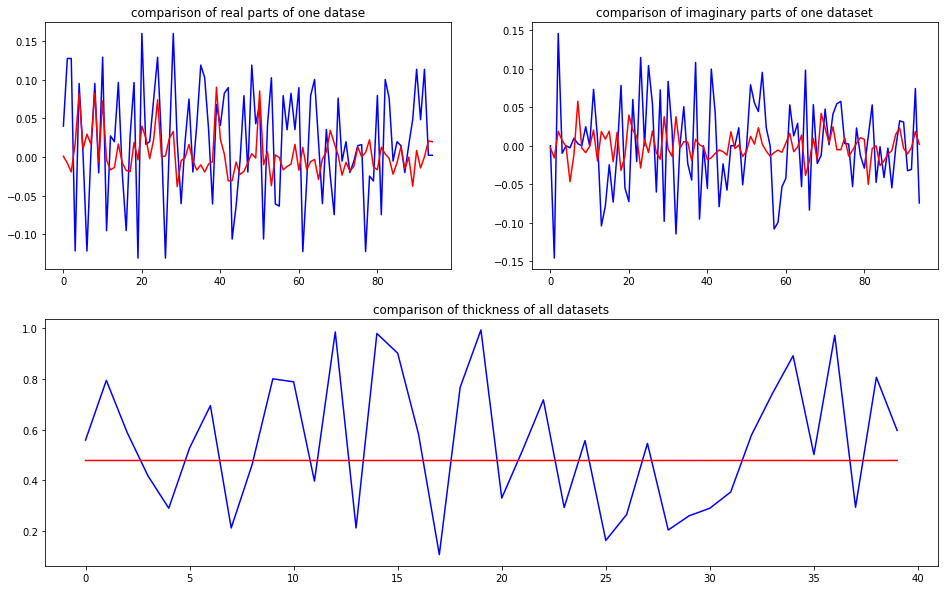

predicted thickness: 0.4785267


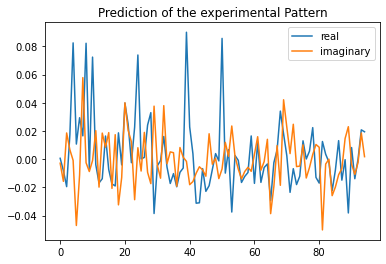

The offset applied on thickness: 7.179294597029528e-05

The offset applied on Ug: -1.3462394495720587

Applied shift of unit cell origin (fractional coordinates): 0.00865314297422529 -0.0038330184086128012 0.0020099755363200294
Ug[ 0 ]: 0.0006 0.0  =>  0.0006 0.0
Ug[ 1 ]: 0.02225 -2.2818  =>  0.02225 -2.26917
Ug[ 2 ]: 0.02225 2.2818  =>  0.02225 2.26917
Ug[ 3 ]: 0.0244 0.39168  =>  0.0244 0.3676
Ug[ 4 ]: 0.0732 0.01145  =>  0.0732 0.0
Ug[ 5 ]: 0.05251 -1.38664  =>  0.05251 -1.42335
Ug[ 6 ]: 0.0244 -0.39168  =>  0.0244 -0.3676
Ug[ 7 ]: 0.05251 1.38664  =>  0.05251 1.42335
Ug[ 8 ]: 0.0732 -0.01145  =>  0.0732 -0.0
Ug[ 9 ]: 0.01554 -2.07675  =>  0.01554 -2.02238
Ug[ 10 ]: 0.06603 -0.067  =>  0.06603 0.0
Ug[ 11 ]: 0.02369 2.07816  =>  0.02369 2.1199
Ug[ 12 ]: 0.02649 -2.36304  =>  0.02649 -2.28459
Ug[ 13 ]: 0.015 2.07549  =>  0.015 2.16657
Ug[ 14 ]: 0.02671 0.91109  =>  0.02671 0.97691
Ug[ 15 ]: 0.01554 2.07675  =>  0.01554 2.02238
Ug[ 16 ]: 0.02369 -2.07816  =>  0.02369 -2.1199
Ug[ 17 ]: 

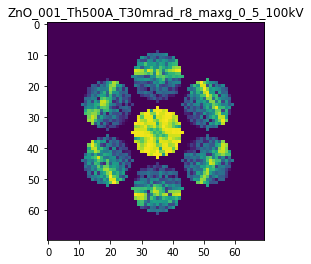

X_sim.max(): 0.963975422690337
>>>replaced the 89. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 949ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 615ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 653ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 637ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 806ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500


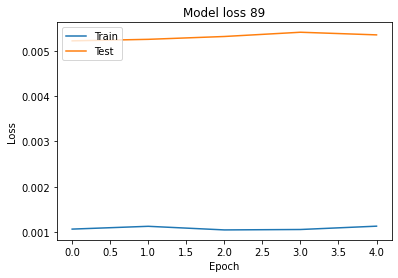

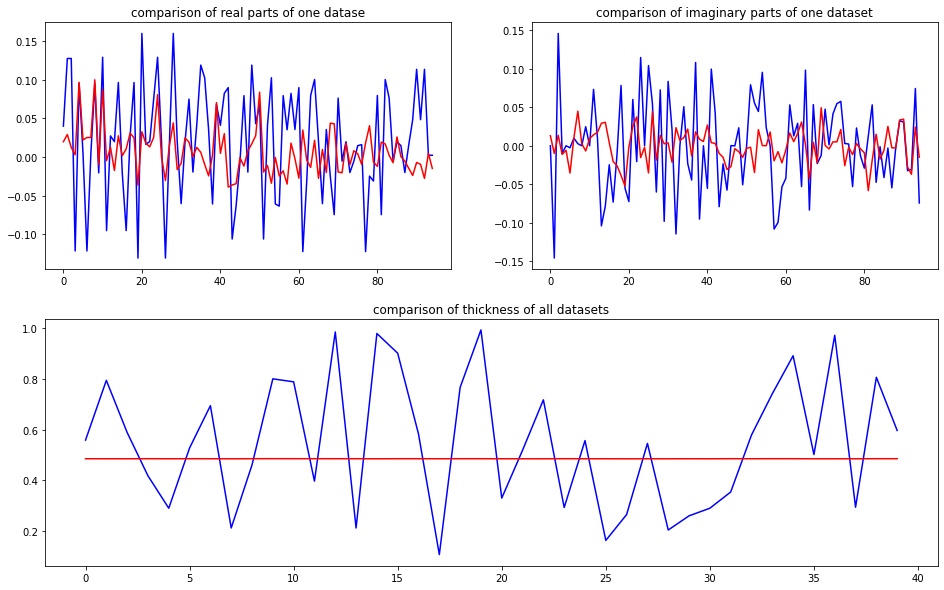

predicted thickness: 0.4852862


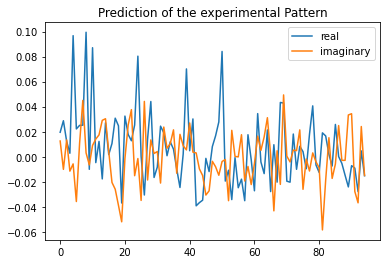

The offset applied on thickness: 3.788993586908607e-05

The offset applied on Ug: 1.931250726398642

Applied shift of unit cell origin (fractional coordinates): -0.00788137422460443 0.0106867214099289 -0.003590512695689008
Ug[ 0 ]: 0.02057 0.0  =>  0.02057 0.0
Ug[ 1 ]: 0.0244 -0.47159  =>  0.0244 -0.49415
Ug[ 2 ]: 0.0244 0.47159  =>  0.0244 0.49415
Ug[ 3 ]: 0.01891 -0.67519  =>  0.01891 -0.60804
Ug[ 4 ]: 0.11685 -0.04459  =>  0.11685 0.0
Ug[ 5 ]: 0.04996 -0.97636  =>  0.04996 -0.88666
Ug[ 6 ]: 0.01891 0.67519  =>  0.01891 0.60804
Ug[ 7 ]: 0.04996 0.97636  =>  0.04996 0.88666
Ug[ 8 ]: 0.11685 0.04459  =>  0.11685 -0.0
Ug[ 9 ]: 0.0066 -2.2274  =>  0.0066 -2.27692
Ug[ 10 ]: 0.09762 0.07208  =>  0.09762 -0.0
Ug[ 11 ]: 0.01739 1.35987  =>  0.01739 1.33291
Ug[ 12 ]: 0.03113 0.71476  =>  0.03113 0.59809
Ug[ 13 ]: 0.03249 1.76881  =>  0.03249 1.62958
Ug[ 14 ]: 0.04512 0.85688  =>  0.04512 0.76278
Ug[ 15 ]: 0.0066 2.2274  =>  0.0066 2.27692
Ug[ 16 ]: 0.01739 -1.35987  =>  0.01739 -1.33291
Ug[ 1

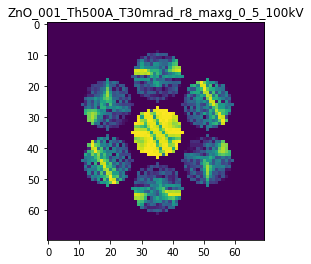

X_sim.max(): 0.9860983111089887
>>>replaced the 90. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 941ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 634ms/step - loss: 9.9679e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 638ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 643ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 893ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500


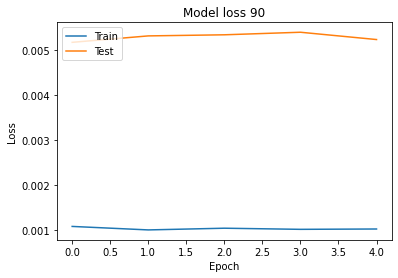

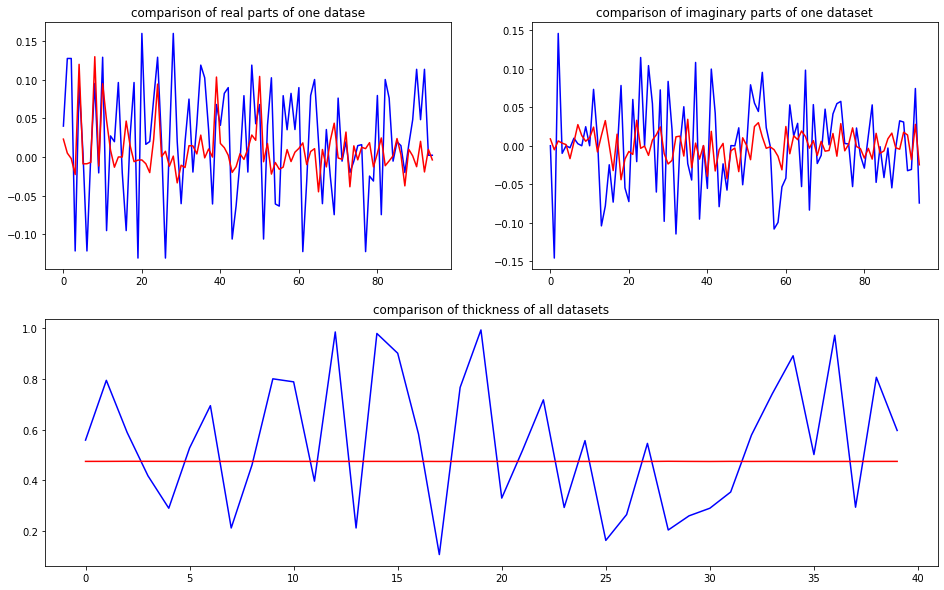

predicted thickness: 0.4752786


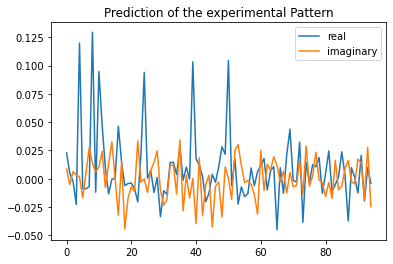

The offset applied on thickness: 0.000706215705561013

The offset applied on Ug: 1.6622643450646974

Applied shift of unit cell origin (fractional coordinates): -0.009270782291098078 0.008850429634330815 0.0012067332763201976
Ug[ 0 ]: 0.02381 0.0  =>  0.02381 0.0
Ug[ 1 ]: 0.00584 -1.3388  =>  0.00584 -1.33122
Ug[ 2 ]: 0.00584 1.3388  =>  0.00584 1.33122
Ug[ 3 ]: 0.01535 -3.11174  =>  0.01535 -3.05613
Ug[ 4 ]: 0.15108 -0.06319  =>  0.15108 0.0
Ug[ 5 ]: 0.02364 -1.86675  =>  0.02364 -1.81872
Ug[ 6 ]: 0.01535 3.11174  =>  0.01535 3.05613
Ug[ 7 ]: 0.02364 1.86675  =>  0.02364 1.81872
Ug[ 8 ]: 0.15108 0.06319  =>  0.15108 0.0
Ug[ 9 ]: 0.00652 2.67097  =>  0.00652 2.61272
Ug[ 10 ]: 0.10942 0.05067  =>  0.10942 0.0
Ug[ 11 ]: 0.05873 0.4924  =>  0.05873 0.42656
Ug[ 12 ]: 0.01703 -0.76484  =>  0.01703 -0.8787
Ug[ 13 ]: 0.01427 2.01593  =>  0.01427 1.90965
Ug[ 14 ]: 0.03775 1.58909  =>  0.03775 1.46765
Ug[ 15 ]: 0.00652 -2.67097  =>  0.00652 -2.61272
Ug[ 16 ]: 0.05873 -0.4924  =>  0.05873 -0.426

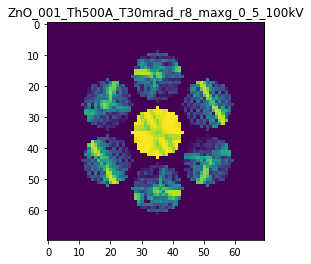

X_sim.max(): 0.9945667650743644
>>>replaced the 91. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 937ms/step - loss: 9.8325e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 620ms/step - loss: 9.6103e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 633ms/step - loss: 9.3425e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 637ms/step - loss: 9.6012e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 828ms/step - loss: 9.5810e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500


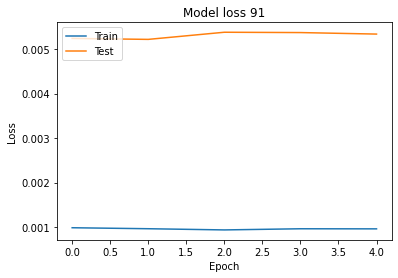

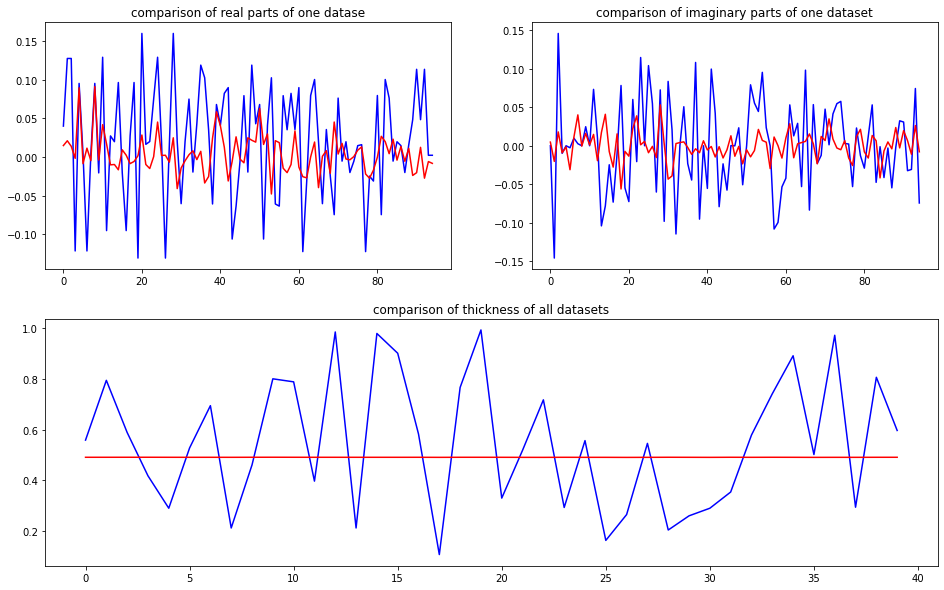

predicted thickness: 0.4912271


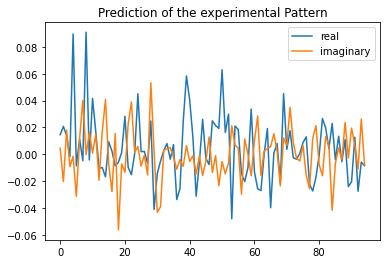

The offset applied on thickness: -0.0006448916054103788

The offset applied on Ug: -0.16553289710455937

Applied shift of unit cell origin (fractional coordinates): 0.011854872728689335 0.0040044542188604326 -0.0028709105043054793
Ug[ 0 ]: 0.0145 0.0  =>  0.0145 0.0
Ug[ 1 ]: 0.02568 -0.84089  =>  0.02568 -0.85893
Ug[ 2 ]: 0.02568 0.84089  =>  0.02568 0.85893
Ug[ 3 ]: 0.01139 -1.14444  =>  0.01139 -1.11928
Ug[ 4 ]: 0.0889 -0.00712  =>  0.0889 -0.0
Ug[ 5 ]: 0.03637 -1.76256  =>  0.03637 -1.71936
Ug[ 6 ]: 0.01139 1.14444  =>  0.01139 1.11928
Ug[ 7 ]: 0.03637 1.76256  =>  0.03637 1.71936
Ug[ 8 ]: 0.0889 0.00712  =>  0.0889 0.0
Ug[ 9 ]: 0.01213 1.36661  =>  0.01213 1.4411
Ug[ 10 ]: 0.04312 -0.05645  =>  0.04312 0.0
Ug[ 11 ]: 0.02322 1.15438  =>  0.02322 1.24691
Ug[ 12 ]: 0.01983 -2.07412  =>  0.01983 -2.02479
Ug[ 13 ]: 0.0135 1.87423  =>  0.0135 1.90552
Ug[ 14 ]: 0.05009 1.80842  =>  0.05009 1.87578
Ug[ 15 ]: 0.01213 -1.36661  =>  0.01213 -1.4411
Ug[ 16 ]: 0.02322 -1.15438  =>  0.02322 -1.2

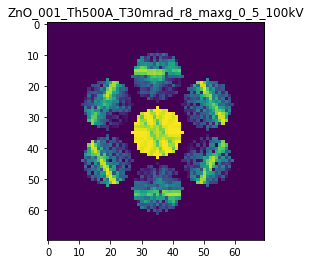

X_sim.max(): 0.9801309823015361
>>>replaced the 92. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 9.1973e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 704ms/step - loss: 9.1768e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 657ms/step - loss: 8.8406e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 823ms/step - loss: 8.7774e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 3s 632ms/step - loss: 8.8454e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500


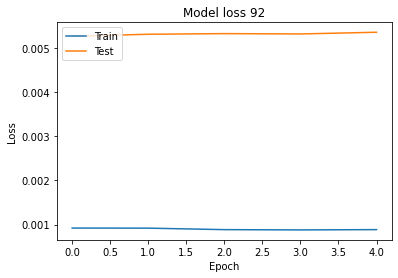

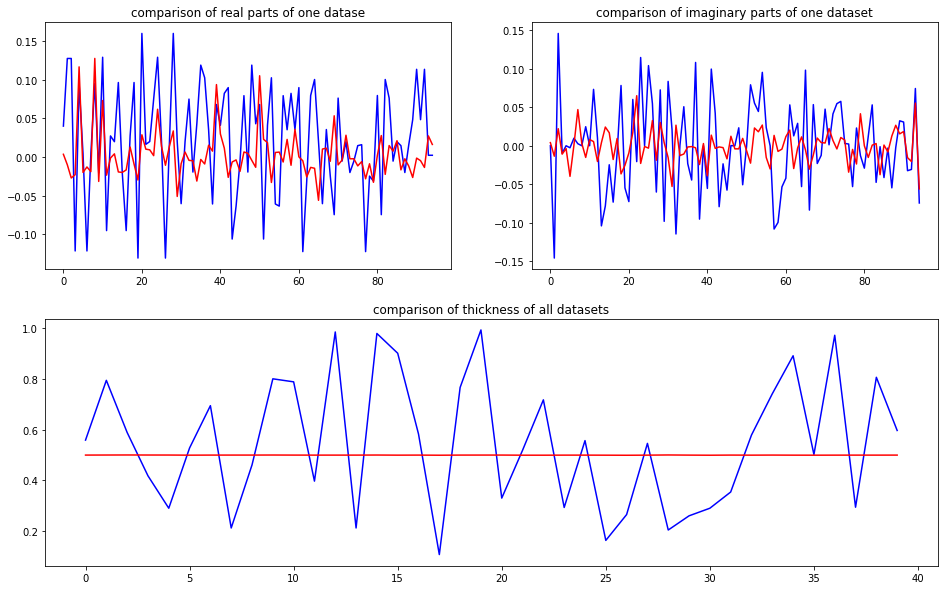

predicted thickness: 0.50024045


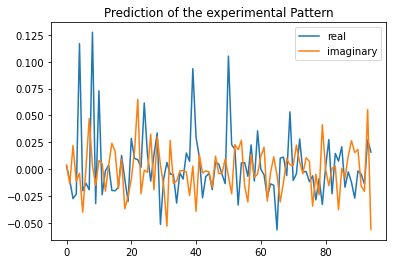

The offset applied on thickness: 0.0004821518494833899

The offset applied on Ug: -1.091057391674695

Applied shift of unit cell origin (fractional coordinates): -0.001679562300800481 0.011938241294776174 -0.007903974029427423
Ug[ 0 ]: 0.00308 0.0  =>  0.00308 0.0
Ug[ 1 ]: 0.02618 -2.42045  =>  0.02618 -2.47011
Ug[ 2 ]: 0.02618 2.42045  =>  0.02618 2.47011
Ug[ 3 ]: 0.01952 -2.81567  =>  0.01952 -2.74066
Ug[ 4 ]: 0.10577 -0.02535  =>  0.10577 -0.0
Ug[ 5 ]: 0.04842 -2.04215  =>  0.04842 -1.91748
Ug[ 6 ]: 0.01952 2.81567  =>  0.01952 2.74066
Ug[ 7 ]: 0.04842 2.04215  =>  0.04842 1.91748
Ug[ 8 ]: 0.10577 0.02535  =>  0.10577 0.0
Ug[ 9 ]: 0.03151 -2.59922  =>  0.03151 -2.60977
Ug[ 10 ]: 0.06238 0.06022  =>  0.06238 0.0
Ug[ 11 ]: 0.02387 2.63486  =>  0.02387 2.67397
Ug[ 12 ]: 0.01583 -1.23138  =>  0.01583 -1.31695
Ug[ 13 ]: 0.00921 0.37384  =>  0.00921 0.23861
Ug[ 14 ]: 0.03452 2.04762  =>  0.03452 2.01172
Ug[ 15 ]: 0.03151 2.59922  =>  0.03151 2.60977
Ug[ 16 ]: 0.02387 -2.63486  =>  0.02387

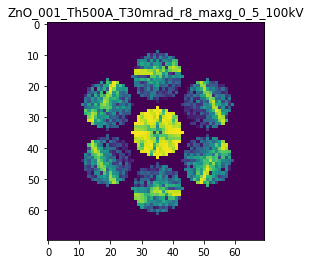

X_sim.max(): 0.9874045687581169
>>>replaced the 93. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 8.3683e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 645ms/step - loss: 8.2633e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 648ms/step - loss: 8.2632e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 659ms/step - loss: 8.2654e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 8.3201e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500


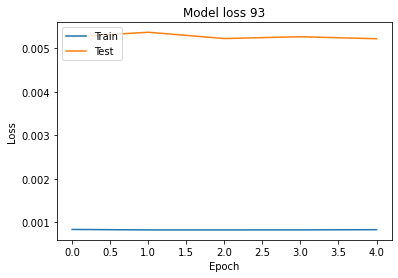

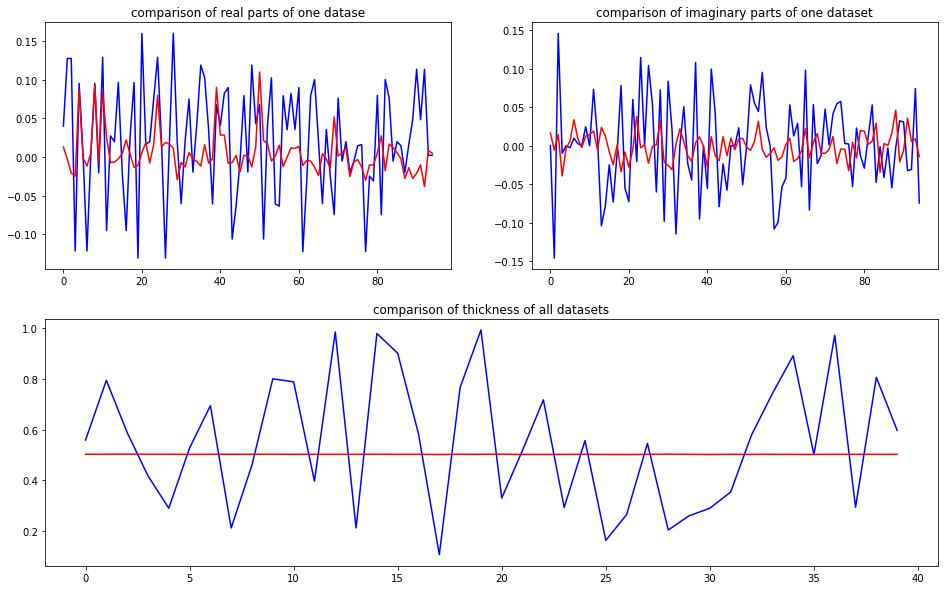

predicted thickness: 0.5035163


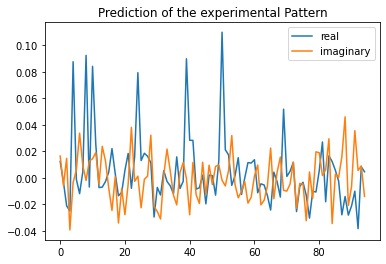

The offset applied on thickness: -0.0003590240556921016

The offset applied on Ug: 0.9871578435729118

Applied shift of unit cell origin (fractional coordinates): -0.008884508534443756 0.006051500483845184 -0.0039658822290393305
Ug[ 0 ]: 0.01286 0.0  =>  0.01286 0.0
Ug[ 1 ]: 0.01572 -2.40914  =>  0.01572 -2.43406
Ug[ 2 ]: 0.01572 2.40914  =>  0.01572 2.43406
Ug[ 3 ]: 0.03984 -2.005  =>  0.03984 -1.96698
Ug[ 4 ]: 0.09811 -0.0131  =>  0.09811 0.0
Ug[ 5 ]: 0.00249 -0.7196  =>  0.00249 -0.65666
Ug[ 6 ]: 0.03984 2.005  =>  0.03984 1.96698
Ug[ 7 ]: 0.00249 0.7196  =>  0.00249 0.65666
Ug[ 8 ]: 0.09811 0.0131  =>  0.09811 -0.0
Ug[ 9 ]: 0.01036 1.67973  =>  0.01036 1.62391
Ug[ 10 ]: 0.0888 0.08074  =>  0.0888 0.0
Ug[ 11 ]: 0.033 0.72168  =>  0.033 0.69078
Ug[ 12 ]: 0.00344 -2.18812  =>  0.00344 -2.28196
Ug[ 13 ]: 0.02344 1.41394  =>  0.02344 1.29518
Ug[ 14 ]: 0.02397 1.88429  =>  0.02397 1.81536
Ug[ 15 ]: 0.01036 -1.67973  =>  0.01036 -1.62391
Ug[ 16 ]: 0.033 -0.72168  =>  0.033 -0.69078
Ug[ 17

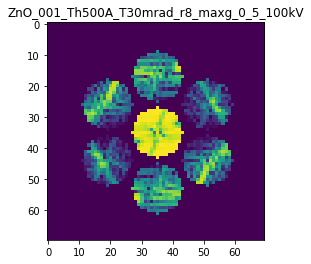

X_sim.max(): 0.981765731775459
>>>replaced the 94. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 941ms/step - loss: 7.9069e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 618ms/step - loss: 7.8900e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 633ms/step - loss: 7.7049e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 652ms/step - loss: 8.1339e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 826ms/step - loss: 7.6385e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500


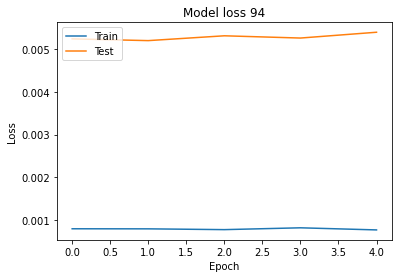

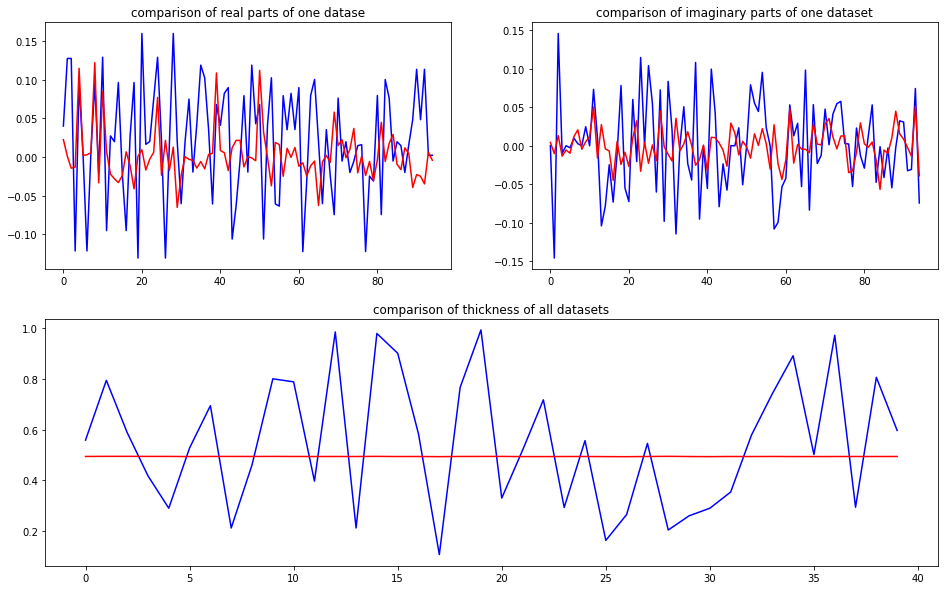

predicted thickness: 0.49483734


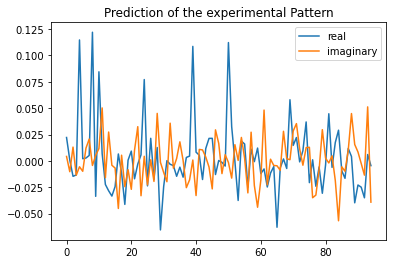

The offset applied on thickness: -0.00016208491399863535

The offset applied on Ug: 1.6066608050385263

Applied shift of unit cell origin (fractional coordinates): -0.006040721882129229 0.006203246509118724 -0.0029424730361789254
Ug[ 0 ]: 0.02301 0.0  =>  0.02301 0.0
Ug[ 1 ]: 0.01353 -2.06975  =>  0.01353 -2.08824
Ug[ 2 ]: 0.01353 2.06975  =>  0.01353 2.08824
Ug[ 3 ]: 0.01358 -1.9378  =>  0.01358 -1.89883
Ug[ 4 ]: 0.14094 -0.02049  =>  0.14094 0.0
Ug[ 5 ]: 0.0161 -1.31417  =>  0.0161 -1.2567
Ug[ 6 ]: 0.01358 1.9378  =>  0.01358 1.89883
Ug[ 7 ]: 0.0161 1.31417  =>  0.0161 1.2567
Ug[ 8 ]: 0.14094 0.02049  =>  0.14094 -0.0
Ug[ 9 ]: 0.02824 2.91458  =>  0.02824 2.87663
Ug[ 10 ]: 0.0916 0.05644  =>  0.0916 -0.0
Ug[ 11 ]: 0.0492 1.35614  =>  0.0492 1.33667
Ug[ 12 ]: 0.01913 -2.5766  =>  0.01913 -2.65354
Ug[ 13 ]: 0.03485 2.32602  =>  0.03485 2.2306
Ug[ 14 ]: 0.03577 2.87748  =>  0.03577 2.81904
Ug[ 15 ]: 0.02824 -2.91458  =>  0.02824 -2.87663
Ug[ 16 ]: 0.0492 -1.35614  =>  0.0492 -1.33667
Ug

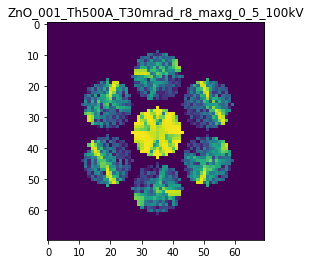

X_sim.max(): 0.9913852053954023
>>>replaced the 95. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 929ms/step - loss: 7.4836e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 618ms/step - loss: 7.5192e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 632ms/step - loss: 8.2615e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 682ms/step - loss: 7.9849e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 5s 1s/step - loss: 8.0254e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500


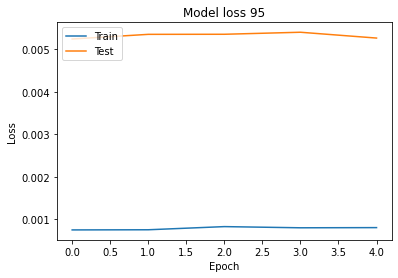

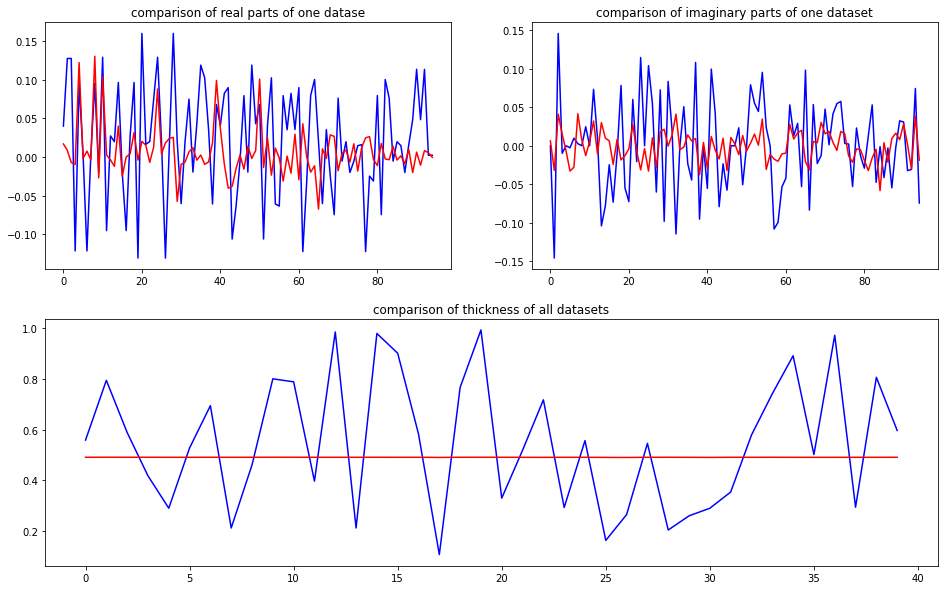

predicted thickness: 0.49121502


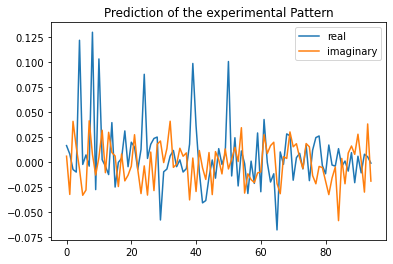

The offset applied on thickness: 0.0008431881564584332

The offset applied on Ug: -1.5400948349456192

Applied shift of unit cell origin (fractional coordinates): -0.0027104882117752016 0.013327509186838145 -0.0030415485399130143
Ug[ 0 ]: 0.01623 0.0  =>  0.01623 0.0
Ug[ 1 ]: 0.03605 -1.61616  =>  0.03605 -1.63527
Ug[ 2 ]: 0.03605 1.61616  =>  0.03605 1.63527
Ug[ 3 ]: 0.02196 1.66497  =>  0.02196 1.7487
Ug[ 4 ]: 0.10174 -0.06463  =>  0.10174 0.0
Ug[ 5 ]: 0.0371 -1.70976  =>  0.0371 -1.60691
Ug[ 6 ]: 0.02196 -1.66497  =>  0.02196 -1.7487
Ug[ 7 ]: 0.0371 1.70976  =>  0.0371 1.60691
Ug[ 8 ]: 0.10174 0.06463  =>  0.10174 0.0
Ug[ 9 ]: 0.02892 -2.79825  =>  0.02892 -2.81528
Ug[ 10 ]: 0.08157 0.03614  =>  0.08157 0.0
Ug[ 11 ]: 0.02782 1.57051  =>  0.02782 1.57259
Ug[ 12 ]: 0.0094 -1.57808  =>  0.0094 -1.67885
Ug[ 13 ]: 0.03193 1.75443  =>  0.03193 1.63455
Ug[ 14 ]: 0.03607 0.39815  =>  0.03607 0.31649
Ug[ 15 ]: 0.02892 2.79825  =>  0.02892 2.81528
Ug[ 16 ]: 0.02782 -1.57051  =>  0.02782 -1.57

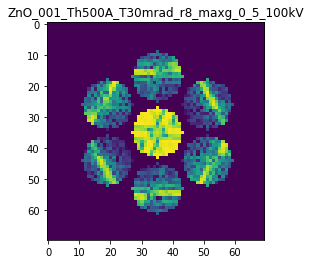

X_sim.max(): 0.9913617031471369
>>>replaced the 96. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 934ms/step - loss: 7.2150e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 621ms/step - loss: 7.0789e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 631ms/step - loss: 6.8163e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 636ms/step - loss: 7.1933e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 750ms/step - loss: 6.6258e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500


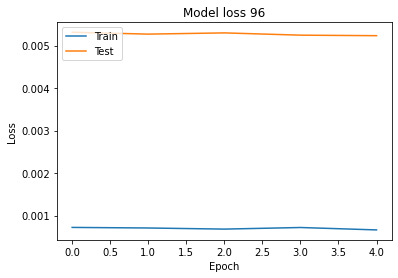

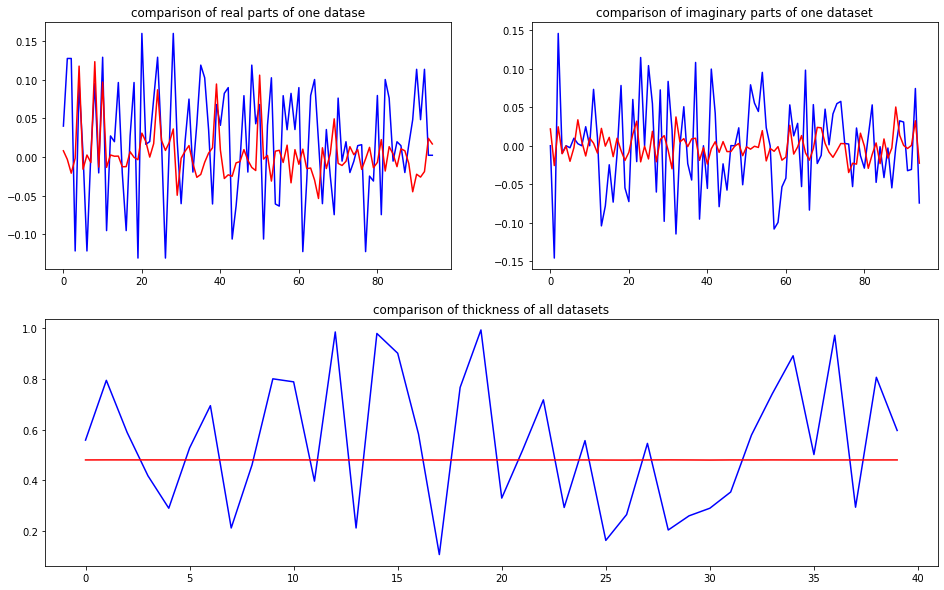

predicted thickness: 0.48081645


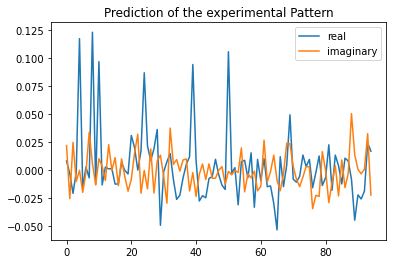

The offset applied on thickness: 3.397935786604722e-05

The offset applied on Ug: -1.0852854912982657

Applied shift of unit cell origin (fractional coordinates): -0.005955380625332486 0.006524274248031268 -0.0027420257555237386
Ug[ 0 ]: 0.00732 0.0  =>  0.00732 0.0
Ug[ 1 ]: 0.02817 -2.05436  =>  0.02817 -2.07159
Ug[ 2 ]: 0.02817 2.05436  =>  0.02817 2.07159
Ug[ 3 ]: 0.00405 -1.50212  =>  0.00405 -1.46113
Ug[ 4 ]: 0.10464 -0.02376  =>  0.10464 0.0
Ug[ 5 ]: 0.02945 -2.01033  =>  0.02945 -1.95211
Ug[ 6 ]: 0.00405 1.50212  =>  0.00405 1.46113
Ug[ 7 ]: 0.02945 2.01033  =>  0.02945 1.95211
Ug[ 8 ]: 0.10464 0.02376  =>  0.10464 0.0
Ug[ 9 ]: 0.01801 -2.40212  =>  0.01801 -2.43954
Ug[ 10 ]: 0.08278 0.05465  =>  0.08278 0.0
Ug[ 11 ]: 0.01601 2.55811  =>  0.01601 2.53792
Ug[ 12 ]: 0.01063 -1.13875  =>  0.01063 -1.21716
Ug[ 13 ]: 0.02249 1.08863  =>  0.02249 0.99299
Ug[ 14 ]: 0.00283 1.49095  =>  0.00283 1.42977
Ug[ 15 ]: 0.01801 2.40212  =>  0.01801 2.43954
Ug[ 16 ]: 0.01601 -2.55811  =>  0.0160

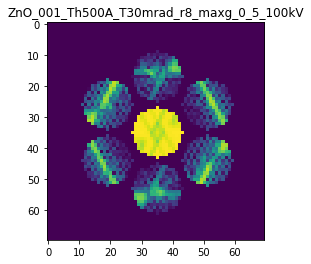

X_sim.max(): 0.9955178753383183
>>>replaced the 97. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 946ms/step - loss: 6.1879e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 617ms/step - loss: 6.4437e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 623ms/step - loss: 6.4161e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 636ms/step - loss: 6.5770e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 815ms/step - loss: 6.5769e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500


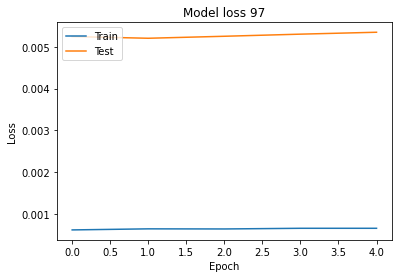

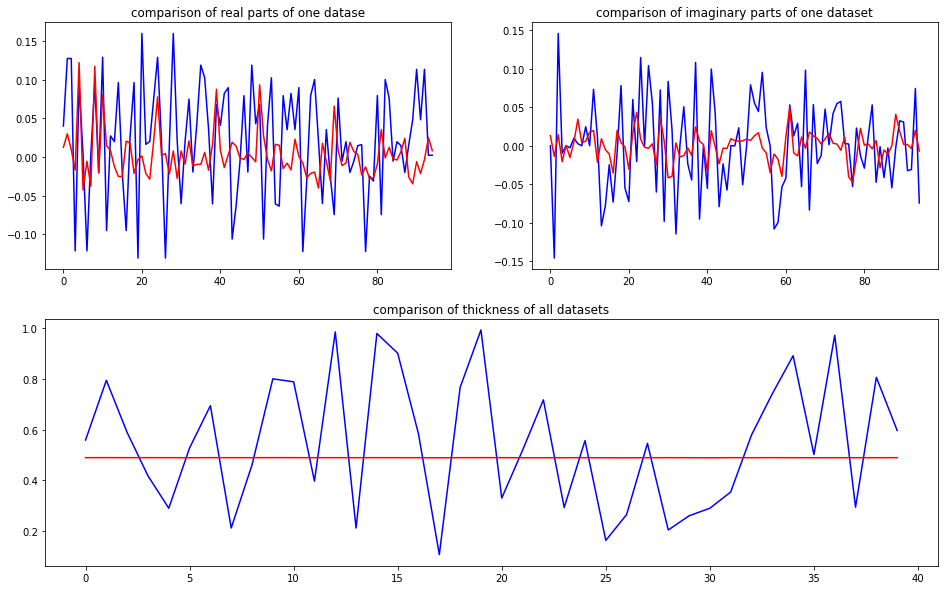

predicted thickness: 0.4895908


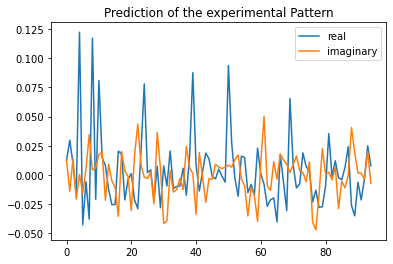

The offset applied on thickness: -0.0005920219824077841

The offset applied on Ug: -1.2472668112304555

Applied shift of unit cell origin (fractional coordinates): -0.015116813862153439 0.00903295816053971 -0.005438613696691716
Ug[ 0 ]: 0.0121 0.0  =>  0.0121 0.0
Ug[ 1 ]: 0.02373 -0.65814  =>  0.02373 -0.69231
Ug[ 2 ]: 0.02373 0.65814  =>  0.02373 0.69231
Ug[ 3 ]: 0.01788 -2.30133  =>  0.01788 -2.24458
Ug[ 4 ]: 0.10174 -0.02258  =>  0.10174 -0.0
Ug[ 5 ]: 0.04966 -2.62294  =>  0.04966 -2.53201
Ug[ 6 ]: 0.01788 2.30133  =>  0.01788 2.24458
Ug[ 7 ]: 0.04966 2.62294  =>  0.04966 2.53201
Ug[ 8 ]: 0.10174 0.02258  =>  0.10174 0.0
Ug[ 9 ]: 0.02535 2.79471  =>  0.02535 2.69973
Ug[ 10 ]: 0.07189 0.12915  =>  0.07189 0.0
Ug[ 11 ]: 0.03246 1.0518  =>  0.03246 0.99099
Ug[ 12 ]: 0.02405 -1.03966  =>  0.02405 -1.19139
Ug[ 13 ]: 0.00801 2.31599  =>  0.00801 2.13008
Ug[ 14 ]: 0.02445 -2.95839  =>  0.02445 -3.07596
Ug[ 15 ]: 0.02535 -2.79471  =>  0.02535 -2.69973
Ug[ 16 ]: 0.03246 -1.0518  =>  0.03246 

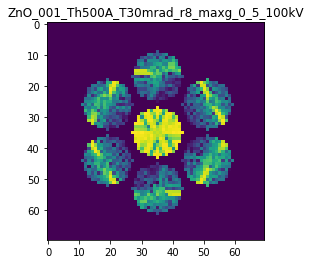

X_sim.max(): 0.993465078446931
>>>replaced the 98. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 1s/step - loss: 6.1673e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 615ms/step - loss: 6.0534e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 623ms/step - loss: 5.4683e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 624ms/step - loss: 5.6063e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 4s 847ms/step - loss: 5.8188e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500


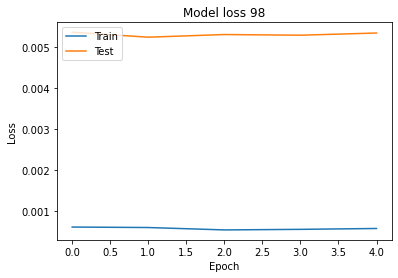

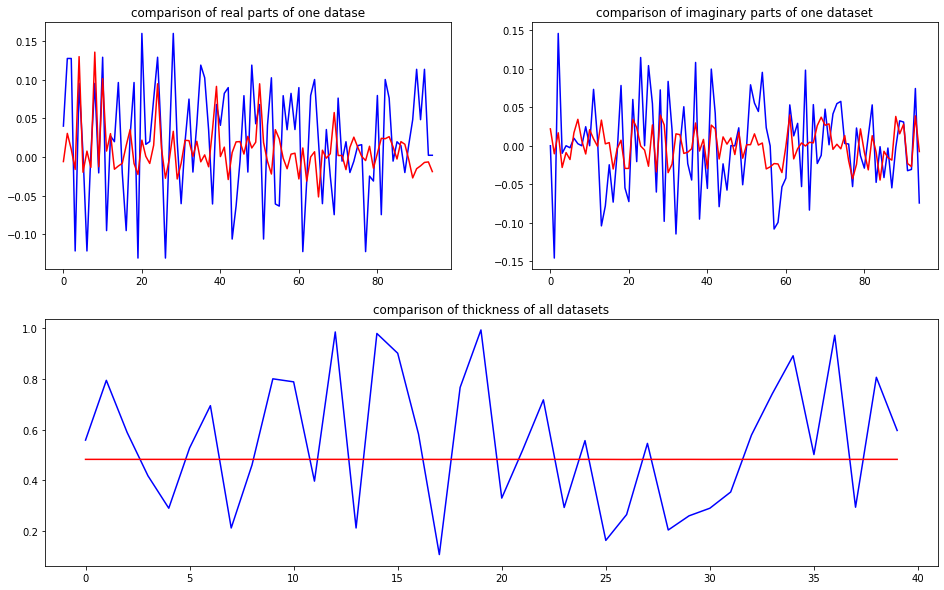

predicted thickness: 0.48283216


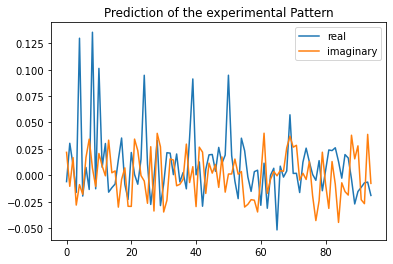

The offset applied on thickness: 0.0004001353423860561

The offset applied on Ug: -0.500885728287554

Applied shift of unit cell origin (fractional coordinates): -0.012362269681805453 0.01883258649638971 -0.009188231210762425
Ug[ 0 ]: 0.00625 3.14159  =>  0.00625 3.14159
Ug[ 1 ]: 0.02408 -0.60813  =>  0.02408 -0.66586
Ug[ 2 ]: 0.02408 0.60813  =>  0.02408 0.66586
Ug[ 3 ]: 0.02318 -1.77495  =>  0.02318 -1.65662
Ug[ 4 ]: 0.12403 -0.0606  =>  0.12403 0.0
Ug[ 5 ]: 0.03108 -2.152  =>  0.03108 -1.97594
Ug[ 6 ]: 0.02318 1.77495  =>  0.02318 1.65662
Ug[ 7 ]: 0.03108 2.152  =>  0.03108 1.97594
Ug[ 8 ]: 0.12403 0.0606  =>  0.12403 0.0
Ug[ 9 ]: 0.01297 -2.53119  =>  0.01297 -2.60887
Ug[ 10 ]: 0.09393 0.13541  =>  0.09393 0.0
Ug[ 11 ]: 0.02255 1.06914  =>  0.02255 1.04919
Ug[ 12 ]: 0.03222 0.05615  =>  0.03222 -0.13985
Ug[ 13 ]: 0.02992 1.67838  =>  0.02992 1.42464
Ug[ 14 ]: 0.01049 -2.91809  =>  0.01049 -3.05636
Ug[ 15 ]: 0.01297 2.53119  =>  0.01297 2.60887
Ug[ 16 ]: 0.02255 -1.06914  =>  0.0225

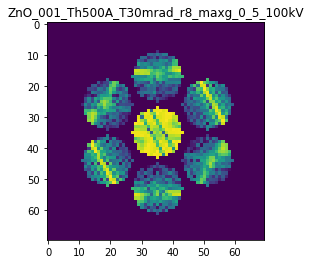

X_sim.max(): 0.9933873925391156
>>>replaced the 99. dataset and train: 
Epoch 1/5
5/5 [==============================] - 7s 937ms/step - loss: 5.4316e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 3s 623ms/step - loss: 4.9813e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 3s 646ms/step - loss: 4.9604e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 4s 858ms/step - loss: 4.9589e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 3s 625ms/step - loss: 5.1406e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500


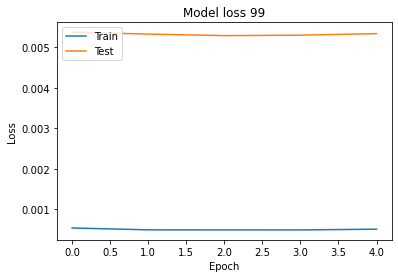

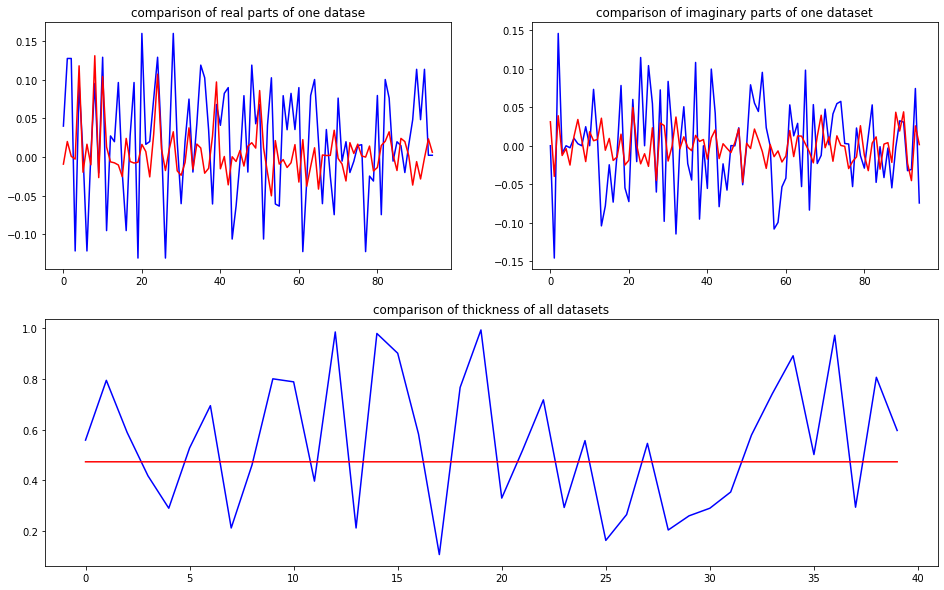

predicted thickness: 0.4732109


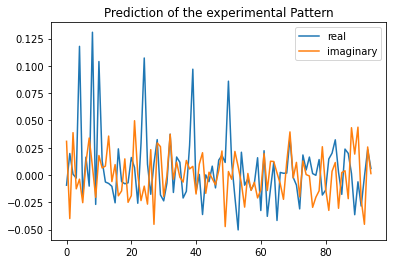

The offset applied on thickness: -0.0005213709156483033

The offset applied on Ug: 0.1895711688603058

Applied shift of unit cell origin (fractional coordinates): -0.011839578817002474 0.016230243290384496 -0.008692782048001323
Ug[ 0 ]: 0.00909 3.14159  =>  0.00909 3.14159
Ug[ 1 ]: 0.04071 -1.30745  =>  0.04071 -1.36207
Ug[ 2 ]: 0.04071 1.30745  =>  0.04071 1.36207
Ug[ 3 ]: 0.014 -1.05549  =>  0.014 -0.95351
Ug[ 4 ]: 0.12747 -0.04736  =>  0.12747 0.0
Ug[ 5 ]: 0.03307 -2.02927  =>  0.03307 -1.87268
Ug[ 6 ]: 0.014 1.05549  =>  0.014 0.95351
Ug[ 7 ]: 0.03307 2.02927  =>  0.03307 1.87268
Ug[ 8 ]: 0.12747 0.04736  =>  0.12747 -0.0
Ug[ 9 ]: 0.02997 -2.61891  =>  0.02997 -2.6933
Ug[ 10 ]: 0.10869 0.12901  =>  0.10869 0.0
Ug[ 11 ]: 0.02248 0.59887  =>  0.02248 0.5791
Ug[ 12 ]: 0.01292 2.06431  =>  0.01292 1.88795
Ug[ 13 ]: 0.03126 1.52724  =>  0.03126 1.29625
Ug[ 14 ]: 0.01384 -2.28923  =>  0.01384 -2.41097
Ug[ 15 ]: 0.02997 2.61891  =>  0.02997 2.6933
Ug[ 16 ]: 0.02248 -0.59887  =>  0.02248 -

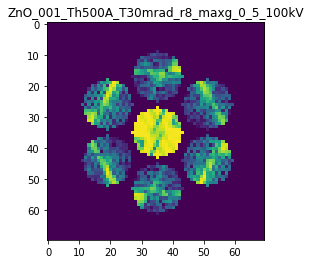

X_sim.max(): 0.9881984735843644
>>>replaced the 100. dataset and train: 
Epoch 1/5
5/5 [==============================] - 9s 1s/step - loss: 4.8174e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 2/5
5/5 [==============================] - 5s 1s/step - loss: 4.7650e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 3/5
5/5 [==============================] - 5s 982ms/step - loss: 4.8105e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500
Epoch 4/5
5/5 [==============================] - 3s 620ms/step - loss: 4.8569e-04 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 0.9500
Epoch 5/5
5/5 [==============================] - 3s 626ms/step - loss: 4.8712e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9500


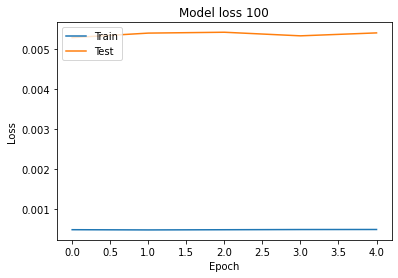

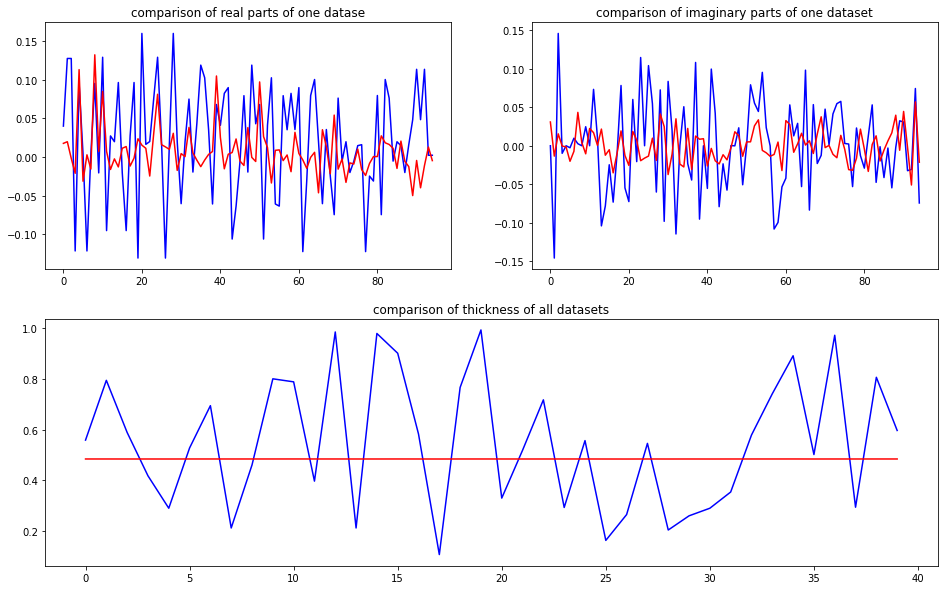

predicted thickness: 0.48434687


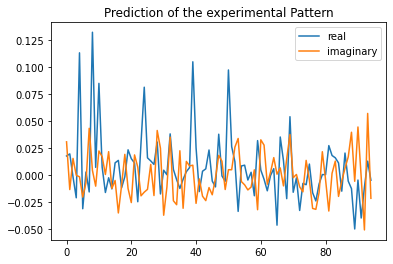

The offset applied on thickness: 0.00010167855619985788

The offset applied on Ug: -1.1329350661245983

Applied shift of unit cell origin (fractional coordinates): -0.019142360008374378 0.021768711038753243 -0.019854978305734572
Ug[ 0 ]: 0.01616 0.0  =>  0.01616 0.0
Ug[ 1 ]: 0.01683 -1.04652  =>  0.01683 -1.17127
Ug[ 2 ]: 0.01683 1.04652  =>  0.01683 1.17127
Ug[ 3 ]: 0.01001 2.81264  =>  0.01001 2.94942
Ug[ 4 ]: 0.10542 -0.01202  =>  0.10542 -0.0
Ug[ 5 ]: 0.04041 -2.25118  =>  0.04041 -1.98965
Ug[ 6 ]: 0.01001 -2.81264  =>  0.01001 -2.94942
Ug[ 7 ]: 0.04041 2.25118  =>  0.04041 1.98965
Ug[ 8 ]: 0.10542 0.01202  =>  0.10542 0.0
Ug[ 9 ]: 0.00936 -0.28304  =>  0.00936 -0.40331
Ug[ 10 ]: 0.07706 0.24503  =>  0.07706 -0.0
Ug[ 11 ]: 0.02824 1.23127  =>  0.02824 1.23575
Ug[ 12 ]: 0.01515 2.80425  =>  0.01515 2.5472
Ug[ 13 ]: 0.01846 1.23192  =>  0.01846 0.85012
Ug[ 14 ]: 0.01749 -2.0212  =>  0.01749 -2.1535
Ug[ 15 ]: 0.00936 0.28304  =>  0.00936 0.40331
Ug[ 16 ]: 0.02824 -1.23127  =>  0.02824

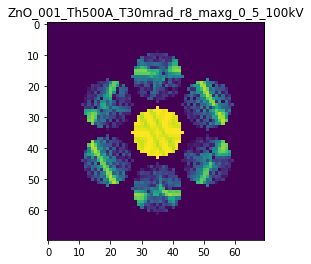

X_sim.max(): 0.9826803219185859
Time:  3966.8343948190004


In [25]:
Ug_t_exp_pred_matrix = [] #matrix to save the predicted {Ug,t} of the experimental pattern
Ug_exp_pred_matrix = [] #matrix to save the predicted Ug of the experimental pattern
t_exp_pred_matrix = [] #matrix to save the predicted t of the experimental pattern
simulation_pattern = [] #matrix to save the simulation pattern produced by predicted {Ug,t}
scale = 5 # scale of random offset 

DoDiverse = True

start = timeit.default_timer()
for i in range(0,trainsize+1):
    
    if i == 0:
        print('>>>train the initial training set:')
        Epochs = 20
        
    else:
        print('>>>replaced the {0:d}. dataset and train: '.format(i))
        Epochs = 5
    
    # load and compile the model
    model = load_model(name+'.h5')

    # invert the 1 channel image Array to 3 Channel, to use ResNet50
    X_train_3C = np.concatenate((X_train,X_train,X_train),axis=3) #same value for every channel
    X_test_3C = np.concatenate((X_test,X_test,X_test),axis=3)
    

    # train the model
    model.fit(X_train_3C, Y_train, validation_data=(X_test_3C, Y_test), batch_size=20, epochs=Epochs)
        
    # save the trained weigths of the model, delete the existing model
    model.save(name + ".h5")


    # plot the model loss
    plt.plot(model.history.history['loss'])
    plt.plot(model.history.history['val_loss'])
    plt.title('Model loss {0:d}'.format(i))
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    #plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Model_Loss' + '/' + 'Model_Loss{0:d}.png'.format(i))
    plt.show()
    plt.close()
    

    # Prediction of the testing set
    Y_test_pred = model.predict(X_test_3C)    
    Ug_test_pred_complex = Y_test_pred[:,:2*numUg].reshape(-1,numUg,2)
    Ug_test_complex = Y_test[:,:2*numUg].reshape(-1,numUg,2)    
    t_test_pred = Y_test_pred[:,2*numUg]
    t_test = Y_test[:,2*numUg]
    
    # plot the comparison of imaginary parts, real parts and thickness
    gs = gridspec.GridSpec(2, 2)
    fig = plt.figure(figsize=(16,10))
    
    ax1 = fig.add_subplot(gs[0, 0]) 
    ax1.plot(Ug_test_complex[2,:,0],'b')
    ax1.plot(Ug_test_pred_complex[2,:,0],'r')
    ax1.set_title('comparison of real parts of one datase')
    
    ax2 = fig.add_subplot(gs[0, 1]) 
    ax2.plot(Ug_test_complex[2,:,1],'b')
    ax2.plot(Ug_test_pred_complex[2,:,1],'r')
    ax2.set_title('comparison of imaginary parts of one dataset')
    
    ax3 = fig.add_subplot(gs[1, :])
    ax3.plot(t_test[:],'b')
    ax3.plot(t_test_pred[:],'r')
    ax3.set_title('comparison of thickness of all datasets')
    plt.show()
    plt.close()
    
    
    # Prediction of the experimental Pattern
    X_exp_3C = np.concatenate((nlogf_X_exp,nlogf_X_exp,nlogf_X_exp),axis=3)
    Y_exp_pred = model.predict(X_exp_3C)
    
    Ug_t_exp_pred = Y_exp_pred[0,:] 
    Ug_exp_pred = Ug_t_exp_pred[0:2*numUg] 
    t_exp_pred = Ug_t_exp_pred[-1] 
    
    Ug_t_exp_pred_matrix.append(Ug_t_exp_pred)
    Ug_exp_pred_matrix.append(Ug_exp_pred)
    t_exp_pred_matrix.append(t_exp_pred)
    print("predicted thickness:", t_exp_pred)
 
    
    # plot the results
    plt.plot(Ug_exp_pred[0:2*numUg:2],label='real')
    plt.plot(Ug_exp_pred[1:2*numUg:2],label='imaginary')
    plt.legend()
    plt.title('Prediction of the experimental Pattern')
    plt.show()
    plt.close()
    
    # diverse the predicted Ug and thickness
    if DoDiverse == True:
        # scale will be reduced by iterations
        scale *= 0.99
        Ug_t_diverse = diverse_Ug_t(Ug_t_exp_pred, scale_Ug=scale)
        Ug_t_exp_pred = Ug_t_diverse
                        

    # normalization --> normalized complex Ug
    Ug_pred = np.array(range( np.int((Ug_t_exp_pred.size - 1)/2) ), dtype=complex)
    Ug_pred.real = Ug_t_exp_pred[0:-1:2]
    Ug_pred.imag = Ug_t_exp_pred[1:-1:2]
    Ug_pred_normalized = nf.normalization(file=File, origin_Ug=Ug_pred)
    Ug_pred_normalized = np.asarray(Ug_pred_normalized)
    
    # Make unique Ug
    if makeUniqueUgVector == True:
        UgUnique, r0 = mu_3D.makeUniqueUgVector(Ug_pred_normalized,beam1,beam2,beam3,file = File)
        Ug_pred_normalized = UgUnique
    

    # reshape
    Ug_pred_normalized_2real = np.concatenate((np.array(Ug_pred_normalized.real,ndmin=2).T, np.array(Ug_pred_normalized.imag,ndmin=2).T),axis=1)  
    Ug_pred_normalized_2real = np.asarray(Ug_pred_normalized_2real)
    Ug_t_pred_normalized_2real = np.append(Ug_pred_normalized_2real.reshape(numUg*2), Ug_t_exp_pred[-1])
    #Ug_t_pred_normalized_2real = np.append(Ug_pred_normalized_2real.reshape(numUg*2), thickness)
        
    
    # Compute the LARBED pattern: X_sim, from the predicted {Ug,t}: Y_exp_pred
    file = File+".qed"
    X_sim = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=Ug_t_pred_normalized_2real, InputUgdoFlip=False)
    X_sim = X_sim.reshape(Nx,Nx,1)
    #nlogf_X_sim = nlogf(X_sim)
    
    simulation_pattern.append(X_sim)
    print("X_sim.max():",X_sim.max())
        
    
    # replace the training set & testing set with new training set
    if i < trainsize:
        #X_train[i] = nlogf_X_sim               
        X_train[i] = X_sim               
        Y_train[i] = Ug_t_pred_normalized_2real

        #if i < testsize: 
        #    X_test = X_train[:testsize]
        #    Y_test = Y_train[:testsize]
        #else:
        #    X_test = X_train[i+1-testsize:i+1]
        #    Y_test = Y_train[i+1-testsize:i+1]

stop = timeit.default_timer()
print('Time: ', stop - start)

-------------------------------------------------------------------------------------------------------------------

# V. Compare the Prediction with the true value

1. diffraction pattern:

In [26]:
simulation_pattern = np.asarray(simulation_pattern)
print('the shape of the simulated pattern', simulation_pattern.shape)
print('the shape of the experimental pattern', X_exp.shape)

the shape of the simulated pattern (101, 70, 70, 1)
the shape of the experimental pattern (1, 70, 70, 1)


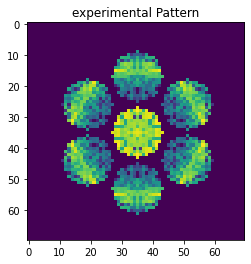

In [27]:
# plot the experimental Pattern:
plt.imshow(nlogf_X_exp[0])
plt.title('experimental Pattern')
plt.savefig("/Users/chenjie/Desktop/master_thesis_data/"+save_name+"/experimental_pattern.jpg")
plt.savefig("/Users/chenjie/Desktop/master_thesis_data/"+save_name+"/experimental_pattern.png")

Text(0.5, 1.0, 'simulation pattern')

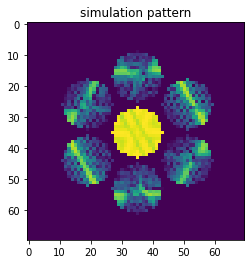

In [28]:
# plot the final simulated Pattern:
plt.imshow(nlogf(simulation_pattern[-1]))
plt.title("simulation pattern")

2. thickness:

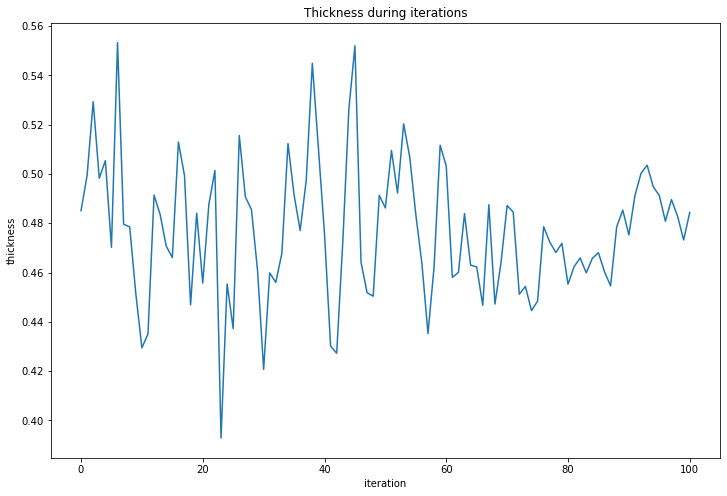

In [29]:
# plot the prediction of thickness during iterations:
plt.figure(figsize=(12,8))
plt.plot(t_exp_pred_matrix)
plt.title("Thickness during iterations")
plt.ylabel("thickness")
plt.xlabel("iteration")
plt.savefig("/Users/chenjie/Desktop/master_thesis_data/"+save_name+"/CNN_thickness.jpg")
plt.savefig("/Users/chenjie/Desktop/master_thesis_data/"+save_name+"/CNN_thickness.png")

3. R-factors:

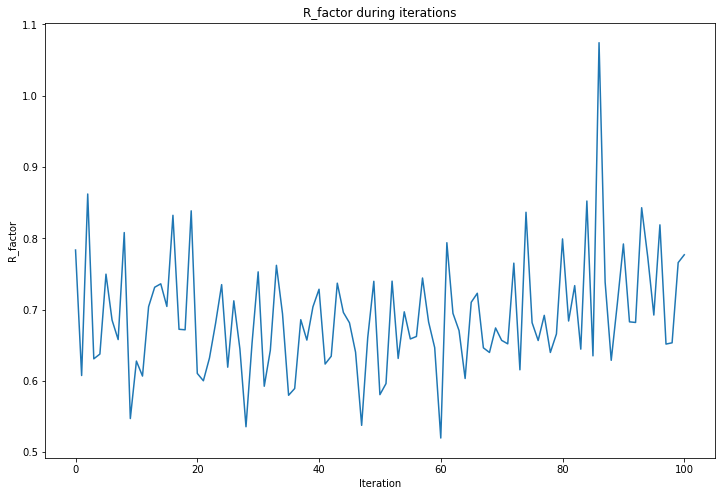

In [30]:
# plot the R-factors during iterations
exp_Intensity = X_exp.reshape(-1)
sim_Intensities = []
R_factors = []
for i in range(len(simulation_pattern)):
    sim_Intensity = simulation_pattern[i].reshape(-1)
    R = np.sum(np.abs(sim_Intensity - exp_Intensity))/np.sum(exp_Intensity)
    R_factors = np.append(R_factors, R)

plt.figure(figsize=(12,8))
plt.plot(R_factors[:])
plt.title('R_factor during iterations')
plt.ylabel('R_factor')
plt.xlabel('Iteration')
plt.savefig("/Users/chenjie/Desktop/master_thesis_data/"+save_name+"/CNN_R_iteration.jpg")
plt.savefig("/Users/chenjie/Desktop/master_thesis_data/"+save_name+"/CNN_R_iteration.png")

R_min: 0.519644771745941


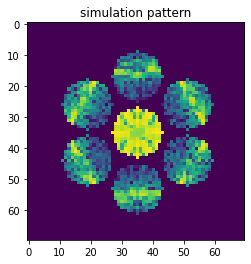

In [31]:
R_argmin = R_factors.argmin()
R_min = R_factors.min()
print("R_min:", R_min)
plt.imshow(nlogf(simulation_pattern[R_argmin].reshape(Nx,Nx,1)))
plt.title("simulation pattern")
plt.savefig("/Users/chenjie/Desktop/master_thesis_data/"+save_name+"/CNN_simulation.jpg")
plt.savefig("/Users/chenjie/Desktop/master_thesis_data/"+save_name+"/CNN_simulation.png")

In [32]:
t_exp_pred_matrix[R_argmin]

0.50317055

R-factor:  0.519644771745941


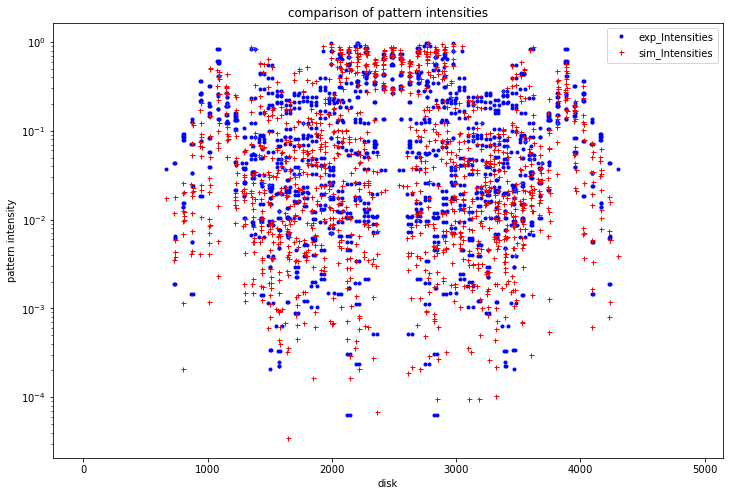

In [33]:
exp_Intensities = X_exp[0].reshape(Nx*Nx)
sim_Intensities = simulation_pattern[R_argmin].reshape(Nx*Nx)
R = np.sum(np.abs(sim_Intensities - exp_Intensities))/np.sum(exp_Intensities)
print("R-factor: ", R)    
plt.figure(figsize=(12,8))
plt.axes(yscale = "log")
plt.plot(exp_Intensities, "bo", markersize=3, label="exp_Intensities")
plt.plot(sim_Intensities, "r+", markersize=5, label="sim_Intensities")
plt.legend()
plt.xlabel("disk")
plt.ylabel("pattern intensity")
plt.title("comparison of pattern intensities")
plt.show()

In [34]:
testUg = Y_train[R_argmin][:]
testUg

array([-9.51449852e-03,  0.00000000e+00, -2.80580562e-02,  1.16134659e-02,
       -2.80580562e-02, -1.16134659e-02, -3.13266188e-03,  1.68233402e-02,
        9.27123344e-02, -8.67361738e-19, -2.63452750e-02, -2.54357488e-02,
       -3.13266188e-03, -1.68233402e-02, -2.63452750e-02,  2.54357488e-02,
        9.27123344e-02,  8.67361738e-19,  1.08124782e-02, -3.20380679e-02,
        8.53817108e-02,  0.00000000e+00, -1.43468043e-03,  4.07627679e-02,
        2.64529897e-02, -2.12483083e-02,  3.38356743e-03, -1.29633823e-02,
        2.61597760e-02,  1.90849823e-02,  1.08124782e-02,  3.20380679e-02,
       -1.43468043e-03, -4.07627679e-02,  2.64529897e-02,  2.12483083e-02,
        2.61597760e-02, -1.90849823e-02,  8.45897839e-04, -2.39716043e-02,
        3.20189598e-02,  1.59059057e-02,  1.23487636e-02, -4.42637017e-02,
       -4.05687199e-02,  3.04285931e-02,  3.35276293e-02,  1.71453995e-02,
        8.53817108e-02,  0.00000000e+00,  3.38356743e-03,  1.29633823e-02,
        8.45897839e-04,  

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//ZnO_001_Th500A_T30mrad_r8_maxg_0_5_100kV/ZnO_001_Th500A_T30mrad_r8_maxg_0_5_100kV/ZnO_001_Th500A_T30mrad_r8_maxg_0_5_100kV.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=504.12076711654663
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.0095145 +0.00000000e+00j -0.02805806+1.16134659e-02j
 -0.02805806-1.16134659e-02j -0.00313266+1.68233

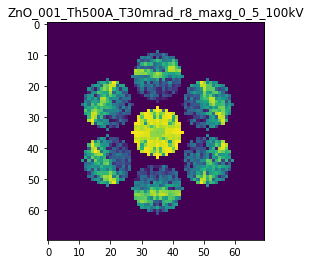

In [35]:
test_sim = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=testUg, InputUgdoFlip=False)

In [36]:
filepath = "/Users/chenjie/pyQEDA/pyQEDA_simulations/" + File + "/" + File + "_experimental_data" +'/'
beamfilename = '_BeamList.txt'
beamfile = filepath + beamfilename
beams = np.asarray(np.loadtxt(beamfile,skiprows=1, usecols= range(1, 4)  ), dtype=int )



InputUg into Potential = [-9.51449852e-03  0.00000000e+00 -2.80580562e-02  1.16134659e-02
 -2.80580562e-02 -1.16134659e-02 -3.13266188e-03  1.68233402e-02
  9.27123344e-02 -8.67361738e-19 -2.63452750e-02 -2.54357488e-02
 -3.13266188e-03 -1.68233402e-02 -2.63452750e-02  2.54357488e-02
  9.27123344e-02  8.67361738e-19  1.08124782e-02 -3.20380679e-02
  8.53817108e-02  0.00000000e+00 -1.43468043e-03  4.07627679e-02
  2.64529897e-02 -2.12483083e-02  3.38356743e-03 -1.29633823e-02
  2.61597760e-02  1.90849823e-02  1.08124782e-02  3.20380679e-02
 -1.43468043e-03 -4.07627679e-02  2.64529897e-02  2.12483083e-02
  2.61597760e-02 -1.90849823e-02  8.45897839e-04 -2.39716043e-02
  3.20189598e-02  1.59059057e-02  1.23487636e-02 -4.42637017e-02
 -4.05687199e-02  3.04285931e-02  3.35276293e-02  1.71453995e-02
  8.53817108e-02  0.00000000e+00  3.38356743e-03  1.29633823e-02
  8.45897839e-04  2.39716043e-02  1.23487636e-02  4.42637017e-02
  3.20189598e-02 -1.59059057e-02 -2.17817642e-02 -8.19032179e-0

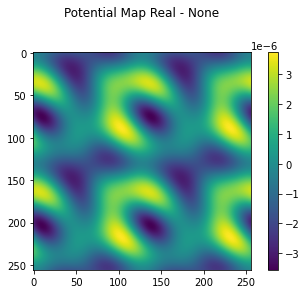

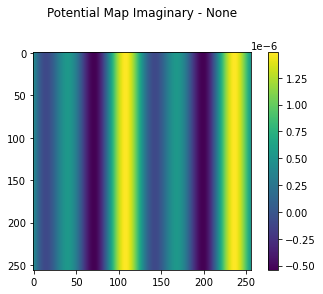

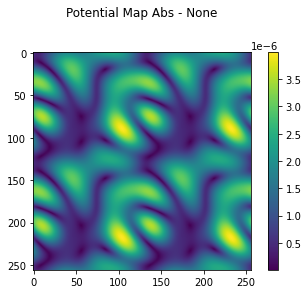

In [37]:
[UgList, potMapSim, InputBeams] = pqp.displayPotentialFromUg(folder=None,\
                                       potSize=([256,256]), \
                                       Ncells=([2,2]),     \
                                       showImag=True,      \
                                       doFlip=False,       \
                                       thresh = 0.1,     \
                                       beta = 0.9,\
                                       InputUg=testUg,\
                                       InputBeams = beams, \
                                       returnComplexUg=True,\
                                       scaling=1,\
                                       scaleImag=0)

R-factor:  0.519644771745941


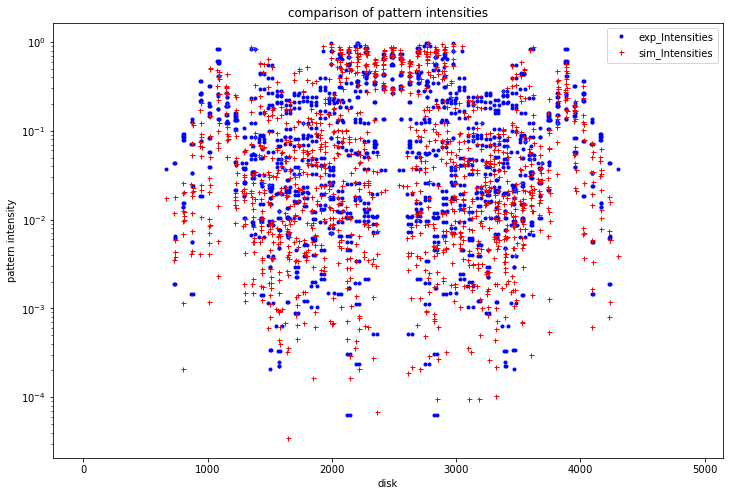

In [38]:
exp_Intensities = X_exp[0].reshape(Nx*Nx)
sim_Intensities = simulation_pattern[R_argmin].reshape(Nx*Nx)
R = np.sum(np.abs(sim_Intensities - exp_Intensities))/np.sum(exp_Intensities)
print("R-factor: ", R)    
plt.figure(figsize=(12,8))
plt.axes(yscale = "log")
plt.plot(exp_Intensities, "bo", markersize=3, label="exp_Intensities")
plt.plot(sim_Intensities, "r+", markersize=5, label="sim_Intensities")
plt.legend()
plt.xlabel("disk")
plt.ylabel("pattern intensity")
plt.title("comparison of pattern intensities")
plt.show()